## SBMOO  approach for Dealing with Deep Uncertainty in Environmental Problems:


- Solve scenario-based MOOP (i.e. simultaneously consider the selected scenarios and generate the solutions for an SBMOOP)
    [For the time being, we use the previous scenario selected methods in the literature (Particularly use one proposed in Eker & Kwakkel (2018).]
- Use ASF as a posteriori decision-making approach [a more smart way of generating reference point should be considered; e.g. surrogate ASF]  

- Finally, we need to analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)
- The classical lake problem has been used to test the idea.

##### Objectives in Lake problem(4 objectives):
- Max expected economic benefits(Utility)
- Min worst-case average P concentration(Pollution)
- Max average Inertia of control policy(Inertia)
- Max reliability of policy in staying below the lake's critical P threshold(Reliability)

##### Constraints:
- P emissions range between 0.0001 and 0.1(decision variables bounds)

##### Observations:
- Utility and reliability are the most conflicting objectives
- There is no feasible solution with the reliability of higher than 85% (or even 10%) for all scenarios. 

In [1]:
import numpy as np
from scipy.optimize import brentq
import math
from scipy.optimize import minimize
import random

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

import csv
import plotly.express as px
import plotly.graph_objects as go

In [2]:
def lake_problem(decisions,
                 b, #= 0.42,          # decay rate for P in lake (0.42 = irreversible)
                 q, #= 2.0,           # recycling exponent
                 mean, #= 0.02,       # mean of natural inflows
                 stdev, #= 0.001,     # future utility discount rate
                 delta, #= 0.98,      # standard deviation of natural inflows
                 alpha, #= 0.4,       # utility from pollution
                 nsamples = 100    # Monte Carlo sampling of natural inflows
                 ): #**kwargs):   
    #decisions = [kwargs[str(i)] for i in range(100)]
    
    Pcrit = brentq(lambda x: x**q/(1+x**q) - b*x, 0.01, 1.5)
    nvars = len(decisions)
    X = np.zeros((nvars,))
    average_daily_P = np.zeros((nvars,))
    decisions = np.array(decisions)
    reliability = 0.0

    for _ in range(nsamples):
        X[0] = 0.0
        
        natural_inflows = np.random.lognormal(
                math.log(mean**2 / math.sqrt(stdev**2 + mean**2)),
                math.sqrt(math.log(1.0 + stdev**2 / mean**2)),
                size = nvars)
        
        for t in range(1,nvars):
            X[t] = (1-b)*X[t-1] + X[t-1]**q/(1+X[t-1]**q) + decisions[t-1] +\
                    natural_inflows[t-1]
            average_daily_P[t] += X[t]/float(nsamples)
    
        reliability += np.sum(X < Pcrit)/float(nsamples*nvars)
      
    max_P = np.max(average_daily_P)
    utility = np.sum(alpha*decisions*np.power(delta,np.arange(nvars)))#/100
    inertia = np.sum(np.absolute(np.diff(decisions)) < 0.02)/float(nvars-1)
    
    
    return -utility, max_P, -inertia, -reliability  # Negative signs describe the Maximization objectives

In [3]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
s = 1
#Number of objectives 
k = 4
# Number of meta-criteria
mc = s*k

In [4]:
"""
 Utilizing 4 diverse scenarios + 1 ref scenario from 
 
 Eker, S. and Kwakkel, J.H., 2018. Including robustness considerations in the search phase of Many-Objective 
 Robust Decision Making. Environmental Modelling & Software, 105, pp.201-216.
 
 4 selected scenarios + 1 reference scenario:
              b           delta          mean           q             std
 A(#77)  0.19330981   0.953092397    0.017430754    3.049281843    0.002061759
 B(#96)  0.141181536  0.950441986    0.012044268    2.584491318    0.00243013
 C(#130) 0.111640212  0.956457199    0.010126115    2.968733539    0.003692125
 D(#181) 0.272280522  0.931232823    0.03300274     2.971857894    0.004599415
 Ref     0.42         0.98           0.02           2              0.0017
 
+ 4 scenarios from

Bartholomew, E. & Kwakkel, J. H. (2020), ‘On considering robustness in thesearch phase of robust decision making:  
A comparison of many-objective ro-bust decision making, multi-scenario many-objective robust decision making,
and many objective robust optimization’,Environmental Modelling & Soft-warep. 104699.

Used the same algorithm as Eker 2018, but ended up with the following scenarios:

4 selected scenarios + 1 reference scenario:

    b        q      mean      std     delta
1 0.2760   3.0490   0.0039   0.0039   0.9310
2 0.1350   2.0255   0.0407   0.0030   0.9613
3 0.2704   2.4783   0.0169   0.0039   0.9631
4 0.1009   3.6789   0.0187   0.0037   0.9317

Ref the same as the above
"""

b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42, 0.2760, 0.1350, 0.2704, 0.1009] # b = [0.42, 0.1, 0.2, 0.3]
q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2, 3.0490, 2.0255, 2.4783, 3.6789] # q = [2.0, 3, 4, 4.5]
mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02, 0.0039, 0.0407, 0.0169, 0.0187]   # mean = [0.02, 0.01, 0.03, 0.05]
stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017, 0.0039, 0.0030, 0.0039, 0.0037]   # stdev = [0.001, 0.0006, 0.001, 0.005]
delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98, 0.9310, 0.9613, 0.9631, 0.9317]    

## Finding the ideal points (the optimal values for objectives in each scenario) by solving a single-scenario single-objective problem for all objectives and 5 considered scenarios.

In [5]:
# 4 objectives and 9 scenarios
# So the indices must change between 0-8, each demonstrates a scenario

def single_objective_single_scenario(decisions):
    """
    single-objective (obj) single-scenario (scen) model
    """        
    f = []                     
    f = lake_problem(decisions, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
                     
    return f[obj]

In [6]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [9]:
# Solving the single-scenario single objective problems to get the ideal points for each objective in each scenario

ideal_Utility = [] 
ideal_Pollution = [] 
ideal_Inertia = [] 
ideal_Reliability = [] 
scen = 3
ind_temp = 0
extreme_dec = []
extreme_refp = np.zeros((mc,k))

for obj in range(k):
    print('k=',obj)
    
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    """
    
    print('s=', scen)
    ind_temp += 1
        
    sol = minimize(single_objective_single_scenario,
            x0,
            method = "SLSQP",
            bounds = bnds,
            #constraints = cons
            )  
        
    # Decision variables (solutions)
    extreme_dec.append(sol.x)
    
    F = lake_problem(sol.x, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
    #print(' Scenario ',scen+1,': b = ', b[scen], ', q = ', q[scen], ', mean = ', mean[scen], ', stdev = ', stdev[scen], ',delta = ', delta[scen])
    #print('f_{obj+1}',scen+1,' =', F[obj])

    # Store Objective values for scenario S_i
    extreme_refp[ind_temp-1] = np.array([-F[0],F[1],-F[2],-F[3]])
        
    if obj == 0:
        ideal_Utility.append(-F[obj])
    elif obj == 1:
        ideal_Pollution.append(F[obj])
    elif obj == 2:
        ideal_Inertia.append(-F[obj])
    else:
        ideal_Reliability.append(-F[obj])
        

#print('Ideal points for Utility in different scenarios =',ideal_Utility)
#print('Ideal points for Plution in different scenarios =',ideal_Pollution)
#print('Ideal points for Inertia in different scenarios =',ideal_Inertia)
#print('Ideal points for Reliability in different scenarios =',ideal_Reliability)

k= 0
s= 3
k= 1
s= 3
k= 2
s= 3
k= 3
s= 3


In [10]:
# Write ideal points

with open('obective_values_4obj_s4(EkerBarth)_ideal points.csv', 'w', newline='') as f:
    objectives = ['ideal_Utility', 'ideal_Pollution', 'ideal_Inertia', 'ideal_Reliability', 'Scenario'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(s):
        thewriter.writerow({'ideal_Utility' : ideal_Utility[i], 'ideal_Pollution' : ideal_Pollution[i], 'ideal_Inertia' : ideal_Inertia[i], 'ideal_Reliability' : ideal_Reliability[i], 'Scenario' : i
                               })
        
with open('extreme_rf_points(EkerBarth)s4.csv', 'w', newline='') as f:
    objectives = ['extreme_rf_points', 'extreme_rf_points_dec'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(mc):
        thewriter.writerow({'extreme_rf_points' : extreme_refp[i], 'extreme_rf_points_dec' : extreme_dec[i]
                               })    

In [5]:
Lake45_ideals = pd.read_csv('obective_values_4obj_s4(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.581198,0.133186,1.0,1.0,0


In [6]:
# Extreme points (decision space)
import re
extreme_rf_points = pd.read_csv('extreme_rf_points(EkerBarth)s4.csv')
extreme_rfp_dec = np.zeros((mc,100))
for i in range(mc):
    rfpt = re.findall(r"[-+]?\d*\.\d+|\d+", extreme_rf_points['extreme_rf_points_dec'][i])
    for j in range(100):
        extreme_rfp_dec[i][j] = float(rfpt[j])

#extreme_rfp_dec

In [7]:
# Calculate the extreme points in objective space

extreme_rfp = [s * [None] for i in range(mc)]  #np.zeros((mc,mc))

for j in range(mc):
    f_temp = np.zeros((k,))
    F = lake_problem(extreme_rfp_dec[j], b = b[3], q = q[3], mean = mean[3], stdev = stdev[3], delta = delta[3], alpha = 0.4, nsamples = 100)
    for i in range(k):
        if i==1:
            f_temp[i] = F[i]
        else:
            f_temp[i] = -F[i]
                
    extreme_rfp[j][0] = f_temp
                
extreme_rfp

[[array([0.58119772, 4.10805767, 1.        , 0.0608    ])],
 [array([0.0022419 , 0.13275088, 1.        , 1.        ])],
 [array([5.81204572e-04, 1.31635362e-01, 1.00000000e+00, 1.00000000e+00])],
 [array([5.81204572e-04, 1.31749646e-01, 1.00000000e+00, 1.00000000e+00])]]

In [8]:
Lake45_ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_9scen(EkerBarth)_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.096717,1.0,1.0000,0
1,0.802129,0.110756,1.0,1.0000,1
2,0.907929,0.102940,1.0,1.0000,2
3,0.581198,0.131598,1.0,1.0000,3
4,1.734761,0.057112,1.0,1.0000,4
5,0.579248,0.017281,1.0,1.0000,5
6,1.013628,7.592178,1.0,0.0416,6
7,1.058766,0.069357,1.0,1.0000,7
8,0.585153,0.231929,1.0,1.0000,8


In [9]:
"""
Achievement Scalarizing Function (ASF) approach: transfer the multi-objective problem into a single objective one.
Then the following problem will be solved:

  min_x  max_{i=1,..,k} [w_i(f_i - g_i)] + \epsilon sum_{i=1}^n  w_i(f_i - g_i)
  
   s.t. x \in S(feasible region)
  
  where w_i are the weights and can be set bu the decision maker(DM) (e.g. w_i = 1/(z_i^{ideal} - z_i^{nadir} which is also normalize the objective functions)
  k : number of objective functions
  g_i: aspiration levels to be set by the DM (one for each objective function is needed)

When we have multiple scenarios the above formulation have an additional dimension:

   min_x  max_{i=1,..,k; p=1,...,s} [w_{ip}(f_{ip} - g_{ip})] + \epsilon sum_{i=1}^n [sum_{p=1}^s  w_{ip}(f_{ip} - g_{ip}) ]
  
     s.t. x \in S(feasible region in all scenarios)

"""


def objective(decisions):
    """
    ASF
    """     
    phi = np.zeros((s,k))
    w = np.ones((s,k)) # weight vectors
    eps = 0.0001
    f = [[None] for i in range(s)] 
    
    # Setting weights, the same weight for each objective in all scenarios
    for p in range(s):
        for i in range(k): 
            if i==0:
                w[p,i] = 1/(Lake45_ideals.loc[3,'ideal_Utility'])  #2
            elif i==1:
                w[p,i] = 1/(15-(Lake45_ideals.loc[3,'ideal_Pollution']))
            elif i==2:
                w[p,i] = 1/Lake45_ideals.loc[3,'ideal_Inertia']                
            else:
                w[p,i] = 1/Lake45_ideals.loc[3,'ideal_Reliability']
                       
    for p in range(s):
        f[p] = lake_problem(decisions, b = b[3], q = q[3], mean = mean[3], stdev = stdev[3], delta = delta[3], alpha = 0.4, nsamples = 100)
        phi[p] = w[p]*(f[p] - g[p])
        aug = eps * (phi[p]).sum()  
    
    return phi.max() + aug


In [10]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)  

In [11]:
"""
  Setting the goals/ reference points - selected
"""
# number of solution to be generated 
n = 50

ig=[5 * [None] for i in range(n)] 

"""
Selected weights for more diverse solutions
"""      
#extremes
for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

# generating some evenly distributed weights
cc = 0
W = []
for i1 in range(5):#s*k+1):
    for i2 in range(i1+1):
        for i3 in range(i2+1):
            w1 = (4-i1)/4
            w2 = (i1-i2)/4
            w3 = (i2-i3)/4
            w4 = 1 - (w1 + w2 + w3)
            W.append(np.array([w1,w2,w3,w4]))
            #print(w1, w2, w3, w4)
            cc += 1

# generate evenly distributed reference points
ig[4][0] = np.array([ig[0][0][0], ig[3][0][1], ig[0][0][2], ig[1][0][3]])

for i in range(np.shape(W)[0]):
    ig[5+i][0] = ig[4][0]*W[i]

# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS
                     
xlimits4 = np.array([[-Lake45_ideals.loc[0,'ideal_Utility']*10,-0.0005], # Utility 
                    [-5,15], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1*5, -0.04]  # Reliability 
                   ])

sampling4 = LHS(xlimits=xlimits4)

num = n#-40

x4 = sampling4(num)
                     
for i in range(num):
    ig[i][0] = x4[i]#+40
                           
                     
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][0] 
    return g

# Use ASF as a posteriori decision-making approach

In [12]:
"""
Solving the problem
 
""" 
n = 50 # number of solutions to be generated

import time
start_time = time.time()

ait = [[None] for i in range(n)] 
goals = [[None] for i in range(n) ] 
nfe = [] 

Utility = [[None] for i in range (n)] 
Pollution = [[None] for i in range (n)] 
Inertia = [[None] for i in range (n)] 
Reliability = [[None] for i in range (n)] 

# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds) 

for j in range(n):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    
    """
    #tait = [[None] for i in range (5)] 
    
    print(j)
    g = selected_goals(ig, j, s, k)
    
    #print('1.ASF')
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
                options={'disp': True}
               )

    print(sol.message)
    print('iterations', sol.nit)
    print('NFE', sol.nfev)

    # Decision variables (solutions)
    ait[j] = sol.x
    goals[j] = g
    nfe.append(sol.nfev)
                    
    
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    p=3
    F = lake_problem(sol.x, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
    print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
    print('f_1',p+1,' (Utility) =', -F[0])
    print('f_2',p+1,' (max_P) =', F[1])
    print('f_3',p+1,' (inertia) =', -F[2])
    print('f_4',p+1,' (reliability) =', -F[3])
       
    # Store Objective values for scenario S_i
    temp_Utility.append(-F[0])
    temp_Pollution.append(F[1])
    temp_Inertia.append(-F[2])
    temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    Utility[j] = temp_Utility
    Pollution[j] = temp_Pollution
    Inertia[j] = temp_Inertia
    Reliability[j] = temp_Reliability
         
                    
print("--- %s seconds ---" % (time.time() - start_time))  
print('nfe =', np.sum(nfe))

0
Iteration limit exceeded    (Exit mode 9)
            Current function value: 12.101989726382191
            Iterations: 101
            Function evaluations: 11068
            Gradient evaluations: 99
Iteration limit exceeded
iterations 101
NFE 11068
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.3252989044958111
f_2 4  (max_P) = 3.9299370646581333
f_3 4  (inertia) = 0.7878787878787878
f_4 4  (reliability) = 0.06410000000000009
1
Iteration limit exceeded    (Exit mode 9)
            Current function value: 7.7175851912244555
            Iterations: 101
            Function evaluations: 11180
            Gradient evaluations: 100
Iteration limit exceeded
iterations 101
NFE 11180
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5052705647595372
f_2 4  (max_P) = 4.0572561422021485
f_3 4  (inertia) = 0.5757575

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 3.4929061428268886
            Iterations: 13
            Function evaluations: 988
            Gradient evaluations: 9
Optimization terminated successfully.
iterations 13
NFE 988
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4402113044521282
f_2 4  (max_P) = 4.060991884969275
f_3 4  (inertia) = 0.43434343434343436
f_4 4  (reliability) = 0.06900000000000002
17
Optimization terminated successfully.    (Exit mode 0)
            Current function value: 7.095048999827033
            Iterations: 13
            Function evaluations: 1447
            Gradient evaluations: 13
Optimization terminated successfully.
iterations 13
NFE 1447
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.35962448534912667
f_2 4  (max_P) = 3.853858

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 6.730850209897455
            Iterations: 81
            Function evaluations: 8949
            Gradient evaluations: 80
Optimization terminated successfully.
iterations 81
NFE 8949
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.40205288686752777
f_2 4  (max_P) = 3.966088073425814
f_3 4  (inertia) = 0.5656565656565656
f_4 4  (reliability) = 0.06200000000000011
33
Iteration limit exceeded    (Exit mode 9)
            Current function value: 3.3652056109933413
            Iterations: 101
            Function evaluations: 10956
            Gradient evaluations: 98
Iteration limit exceeded
iterations 101
NFE 10956
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4975784013379268
f_2 4  (max_P) = 4.059332940410567
f_3 4  (in

Iteration limit exceeded    (Exit mode 9)
            Current function value: 1.492937224515614
            Iterations: 101
            Function evaluations: 10956
            Gradient evaluations: 98
Iteration limit exceeded
iterations 101
NFE 10956
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.570627102804785
f_2 4  (max_P) = 4.102927869132052
f_3 4  (inertia) = 0.7272727272727273
f_4 4  (reliability) = 0.06150000000000014
49
Iteration limit exceeded    (Exit mode 9)
            Current function value: 6.375374049751124
            Iterations: 101
            Function evaluations: 11068
            Gradient evaluations: 99
Iteration limit exceeded
iterations 101
NFE 11068
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.43974247185823334
f_2 4  (max_P) = 4.008925358588098
f_3 4  (inertia) = 0.5252525252525

In [13]:
"""
Writing the results into a csv file
"""


# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s4.csv', 'w', newline='') as f:
    meta_objectives = ['U in s4', 
                  'Po  in s4', 
                  'In  in s4', 
                  'Re  in s4' 
                       , 'group', 'decisions', 'goals'
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in range(n):
        thewriter.writerow({'U in s4' : Utility[j][0], 
                  'Po  in s4' : Pollution[j][0], 
                  'In  in s4' : Inertia[j][0], 
                  'Re  in s4' : Reliability[j][0], 
                   'group' : j, 'decisions' : ait[j], 'goals' : goals[j],
                   })

In [14]:
Lake4550_meta_data = pd.read_csv('meta_obective_values_4obj_1scen_50sol_random_rfps(20.11.2020)s4.csv')
Lake4550_meta_data.describe()

,U in s4,Po in s4,In in s4,Re in s4,group
count,50.000000,50.000000,50.000000,50.000000,50.00000
mean,0.392160,3.464400,0.678586,0.204042,24.50000
std,0.175329,1.352632,0.170466,0.330704,14.57738
min,0.000624,0.131207,0.434343,0.060500,0.00000
25%,0.344950,3.892261,0.545455,0.061200,12.25000
50%,0.437246,4.007178,0.631313,0.062400,24.50000
75%,0.512679,4.065717,0.785354,0.069750,36.75000
max,0.578373,4.108165,1.000000,1.000000,49.00000


In [16]:
# needs new assignment for different # of scenarios
Signed_sol = np.array([Lake4550_meta_data['U in s4']*(-1), Lake4550_meta_data['Po  in s4'], Lake4550_meta_data['In  in s4']*(-1), Lake4550_meta_data['Re  in s4']*(-1)])
#Signed_sol.T

In [17]:
n=50
solutions = np.zeros((n,s*k))
for j in range(n):
    solutions[j] = Signed_sol.T[0] #Lake4550_meta_data.values[j][0:s*k]

#solutions  

In [18]:
# Faster than is_pareto_efficient_simple, but less readable.
def is_pareto_efficient(costs, return_mask = True):
    """
    Find the pareto-efficient points
    :param costs: An (n_points, n_costs) array
    :param return_mask: True to return a mask
    :return: An array of indices of pareto-efficient points.
        If return_mask is True, this will be an (n_points, ) boolean array
        Otherwise it will be a (n_efficient_points, ) integer array of indices.
    """
    is_efficient = np.arange(costs.shape[0])
    n_points = costs.shape[0]
    next_point_index = 0  # Next index in the is_efficient array to search for
    while next_point_index<len(costs):
        nondominated_point_mask = np.any(costs<costs[next_point_index], axis=1)
        nondominated_point_mask[next_point_index] = True
        is_efficient = is_efficient[nondominated_point_mask]  # Remove dominated points
        costs = costs[nondominated_point_mask]
        next_point_index = np.sum(nondominated_point_mask[:next_point_index])+1
    if return_mask:
        is_efficient_mask = np.zeros(n_points, dtype = bool)
        is_efficient_mask[is_efficient] = True
        return is_efficient_mask
    else:
        return is_efficient

In [19]:
is_pareto_efficient(Signed_sol.T)

array([False,  True,  True,  True,  True,  True, False,  True, False,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True, False, False,
       False,  True,  True,  True,  True,  True,  True,  True,  True,
       False,  True,  True,  True,  True])

In [20]:
# Identifyling dominated points
num_dominated_sol = 0
dominated_sol = []

for j in range(n):
    if is_pareto_efficient(Signed_sol.T)[j] == False:
        num_dominated_sol += 1
        dominated_sol.append(j)
           
print('Number of dominated solutions =', num_dominated_sol)  
print('dominated solutions =', dominated_sol)     

Number of dominated solutions = 9
dominated solutions = [0, 6, 8, 21, 30, 34, 35, 36, 45]


In [21]:
# Removing dominated points
temp_non_dominated = Lake4550_meta_data
for j in dominated_sol:
    temp_non_dominated = temp_non_dominated.drop([j], axis=0)
    
non_dominated_sol = temp_non_dominated
#for i in reliable_scenarios.Scenario_num:
#    print(reliable_scenarios.Scenario_num[i-1])
non_dominated_sol

,U in s4,Po in s4,In in s4,Re in s4,group,decisions,goals
1,0.505271,4.057256,0.575758,0.0615,1,[0.09963392 0.09784602 0.09964536 0.09887502 0...,[[-4.99014652 -2.4 -0.862 -1.3792 ...
2,0.381216,3.828333,0.737374,0.0608,2,[0.0992802 0.09979515 0.09996883 0.0995193 0...,[[-6.00498988 5.6 -0.718 -4.6528 ...
3,0.523750,4.075576,0.616162,0.0605,3,[0.09999998 0.09985748 0.09999998 0.09999998 0...,[[-4.6518654 8.8 -0.73 -0.288 ]]
4,0.518784,4.067110,0.474747,0.0613,4,[0.09961003 0.09926596 0.09954316 0.09953923 0...,[[-3.12960036 12.4 -0.586 -4.4544 ...
5,0.424310,3.963409,0.545455,0.0624,5,[0.09927016 0.09902434 0.09819076 0.09955246 0...,[[-2.9604598 4. -0.598 -1.28 ]]
7,0.568320,4.102175,0.737374,0.0612,7,[0.09963672 0.09935696 0.09926069 0.09980649 0...,[[-6.68155212 -0.4 -0.49 -1.9744 ...
9,0.576302,4.105644,0.858586,0.0614,9,[0.1 0.1 0.1 0.1 0...,[[-3.97530316 14.8 -0.838 -1.1808 ...
10,0.430829,3.969562,0.525253,0.0632,10,[0.09906412 0.09795593 0.0970795 0.09785199 0...,[[-7.86553604 11.2 -0.646 -2.5696 ...
11,0.464404,3.992339,0.525253,0.0619,11,[0.09934769 0.09893481 0.09918192 0.09853103 0...,[[-8.20381716 6. -0.742 -3.4624 ...
12,0.431244,4.013630,0.565657,0.0722,12,[0.09969731 0.09797425 0.09868395 0.09736608 0...,[[-3.63702204 14. -0.958 -2.272 ...


In [22]:
# Describing all meta-objectives (4 objectives in 4+1 scenarios)
#Each line shows one solution
import plotly.graph_objects as go

df = non_dominated_sol

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color =  df['U in s4'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s4', values = df['U in s4']),
        
            dict(range = [0,10],
                label = 'Pol_s4', values = df['Po  in s4']),
            
            dict(range = [0,1],
                label = 'In_s4', values = df['In  in s4']),
                        
            dict(range = [0,1],
                label = 'Re_s4', values = df['Re  in s4']),
            
            #dict(range = [0,40],
                #constraintrange = [0.8,1],
            #    label = 'Solution', values = df['group'])
     
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

# Analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)

## Randomly generate 995 more scenarios to re-evaluate the solutions in them

In [23]:
gen_scenarios = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\scenarios_991_9(EkerBart)10.10.2020.csv')
b = gen_scenarios.b
q = gen_scenarios.q
mean = gen_scenarios['meann'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
stdev = gen_scenarios['stdev']
delta = gen_scenarios.delta

## Analyze the performances in other 4 scenarios (s1,s2,s3 and s4)

In [24]:
"""
Re-evaluate the solutions in other 4 scenarios s1, s2, s3 and s4
"""
start_time = time.time()

nn = 50 - num_dominated_sol
ss = [0, 1, 2, 4] # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (100)] 
nPollution = [[None] for i in range (100)] 
nInertia = [[None] for i in range (100)] 
nReliability = [[None] for i in range (100)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in ss:
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

1
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.6821277287993391
f_2 1  (max_P) = 5.643079044238211
f_3 1  (inertia) = 0.5757575757575758
f_4 1  (reliability) = 0.05320000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6544487702113349
f_2 2  (max_P) = 7.64205063182686
f_3 2  (inertia) = 0.5757575757575758
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7207515070386827
f_2 3  (max_P) = 9.632836833626268
f_3 3  (inertia) = 0.5757575757575758
f_4 3  (reliability) = 0.03989999999999998
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.17606692260551
f_2 5  (max_P) = 2.2453574521773123
f_3 5  (inertia) = 0.5757575

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.571007208993646
f_2 1  (max_P) = 5.583223850373539
f_3 1  (inertia) = 0.5656565656565656
f_4 1  (reliability) = 0.05560000000000009
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5493659840359558
f_2 2  (max_P) = 7.5317404821513305
f_3 2  (inertia) = 0.5656565656565656
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.6011055377123886
f_2 3  (max_P) = 9.494540105124518
f_3 3  (inertia) = 0.5656565656565656
f_4 3  (reliability) = 0.03999999999999998
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.9521718882550041
f_2 5  (max_P) = 2.2087648130473023
f_3 5  (inertia) = 0.565656

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.566842773119892
f_2 3  (max_P) = 9.333394396566662
f_3 3  (inertia) = 0.6262626262626263
f_4 3  (reliability) = 0.03999999999999998
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.8035320549572076
f_2 5  (max_P) = 2.214199229157658
f_3 5  (inertia) = 0.6262626262626263
f_4 5  (reliability) = 0.07
22
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.6601667244311659
f_2 1  (max_P) = 5.610538877150293
f_3 1  (inertia) = 0.5555555555555556
f_4 1  (reliability) = 0.05360000000000006
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6354367084895499
f_2 2  (max_P) = 7.514957073209789
f_3 2  (inertia) = 0.5555555555555556
f_4 

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7921767946974027
f_2 1  (max_P) = 5.7348234552413
f_3 1  (inertia) = 0.6363636363636364
f_4 1  (reliability) = 0.05060000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7537275003539621
f_2 2  (max_P) = 7.786653427082512
f_3 2  (inertia) = 0.6363636363636364
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8466912225895367
f_2 3  (max_P) = 9.83986973970166
f_3 3  (inertia) = 0.6363636363636364
f_4 3  (reliability) = 0.03999999999999998
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.5518297955896219
f_2 5  (max_P) = 2.2797708704289525
f_3 5  (inertia) = 0.636363636

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.41755794991366446
f_2 5  (max_P) = 0.20520548347684572
f_3 5  (inertia) = 0.7777777777777778
f_4 5  (reliability) = 1.0000000000000007
43
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.827048249050986
f_2 1  (max_P) = 5.750889074352065
f_3 1  (inertia) = 0.8282828282828283
f_4 1  (reliability) = 0.051100000000000055
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7856574183276753
f_2 2  (max_P) = 7.820240502333021
f_3 2  (inertia) = 0.8282828282828283
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8858754430172886
f_2 3  (max_P) = 9.898434436883203
f_3 3  (inertia) = 0.82

In [25]:
nn

41

In [26]:

"""
Writing the results into a csv file
"""
import csv

# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_1scen_re-evaluate_5(20.11.2020)s4.csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 'U in s2', 'U in s3','U in s4', 'U in s5',
                  'Po  in s1', 'Po  in s2', 'Po  in s3','Po  in s4', 'Po  in s5',
                  'In  in s1', 'In  in s2', 'In  in s3', 'In  in s4', 'In  in s5',
                  'Re  in s1', 'Re  in s2', 'Re  in s3', 'Re  in s4', 'Re  in s5', 
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in non_dominated_sol.index:
        thewriter.writerow({'U in s1' : nUtility[j][0], 'U in s2' : nUtility[j][1], 'U in s3' : nUtility[j][2],'U in s4' : Utility[j][0], 'U in s5' : nUtility[j][3],
                  'Po  in s1' : nPollution[j][0], 'Po  in s2' : nPollution[j][1], 'Po  in s3' : nPollution[j][2],'Po  in s4' : Pollution[j][0],'Po  in s5' : nPollution[j][3],
                  'In  in s1' : nInertia[j][0], 'In  in s2' : nInertia[j][1], 'In  in s3' : nInertia[j][2], 'In  in s4' : Inertia[j][0], 'In  in s5' : nInertia[j][3],
                  'Re  in s1' : nReliability[j][0], 'Re  in s2' : nReliability[j][1], 'Re  in s3' : nReliability[j][2], 'Re  in s4' : Reliability[j][0], 'Re  in s5' : nReliability[j][3],
                   
                   })

In [27]:
"""
Re-evaluate the solutions in a wide range of randomly generated scenarios
"""
start_time = time.time()

nn = 50 - num_dominated_sol
ss = 1000 # number of scenarios for re-evaluation
c = 0

nUtility = [[None] for i in range (nn)] 
nPollution = [[None] for i in range (nn)] 
nInertia = [[None] for i in range (nn)] 
nReliability = [[None] for i in range (nn)] 

for j in non_dominated_sol.index:
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(ss):
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[c] = temp_Utility
    nPollution[c] = temp_Pollution
    nInertia[c] = temp_Inertia
    nReliability[c] = temp_Reliability
    c += 1
    
print("--- %s seconds ---" % (time.time() - start_time)) 

1
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.6821277287993391
f_2 1  (max_P) = 5.6436237246557655
f_3 1  (inertia) = 0.5757575757575758
f_4 1  (reliability) = 0.053400000000000086
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6544487702113349
f_2 2  (max_P) = 7.641913881427432
f_3 2  (inertia) = 0.5757575757575758
f_4 2  (reliability) = 0.030100000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7207515070386827
f_2 3  (max_P) = 9.63301150956281
f_3 3  (inertia) = 0.5757575757575758
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5052705647595372
f_2 4  (max_P) = 4.05769173

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.8722748663245058
f_2 31  (max_P) = 10.954873207495119
f_3 31  (inertia) = 0.5757575757575758
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.1183312839184463
f_2 32  (max_P) = 2.5350656005115555
f_3 32  (inertia) = 0.5757575757575758
f_4 32  (reliability) = 0.09760000000000003
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5667961333907325
f_2 33  (max_P) = 9.847717346743229
f_3 33  (inertia) = 0.5757575757575758
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.985

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.5824447954346461
f_2 64  (max_P) = 6.7149726563395635
f_3 64  (inertia) = 0.5757575757575758
f_4 64  (reliability) = 0.06360000000000009
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5251365469409734
f_2 65  (max_P) = 2.4487489040302384
f_3 65  (inertia) = 0.5757575757575758
f_4 65  (reliability) = 0.14190000000000005
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.1211319098742447
f_2 66  (max_P) = 7.7772998321052755
f_3 66  (inertia) = 0.5757575757575758
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.247

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.6897887860660549
f_2 91  (max_P) = 4.409171955573275
f_3 91  (inertia) = 0.5757575757575758
f_4 91  (reliability) = 0.0898999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.1454549067173074
f_2 92  (max_P) = 4.236589269100946
f_3 92  (inertia) = 0.5757575757575758
f_4 92  (reliability) = 0.03340000000000007
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.7383443796226862
f_2 93  (max_P) = 2.681863819196157
f_3 93  (inertia) = 0.5757575757575758
f_4 93  (reliability) = 0.12999999999999984
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214

 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5434210835149721
f_2 118  (max_P) = 6.0486353072380545
f_3 118  (inertia) = 0.5757575757575758
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.6712212500352034
f_2 119  (max_P) = 0.40033801399864083
f_3 119  (inertia) = 0.5757575757575758
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.6701595354872132
f_2 120  (max_P) = 0.4182683849229446
f_3 120  (inertia) = 0.5757575757575758
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.65

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.9294271220240927
f_2 144  (max_P) = 3.2608327440185745
f_3 144  (inertia) = 0.5757575757575758
f_4 144  (reliability) = 0.1269
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.5784529644951528
f_2 145  (max_P) = 5.265842227448627
f_3 145  (inertia) = 0.5757575757575758
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.8678840348642582
f_2 146  (max_P) = 4.089587920394093
f_3 146  (inertia) = 0.5757575757575758
f_4 146  (reliability) = 0.1581
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.032

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.049716007807124
f_2 175  (max_P) = 0.3510264233903852
f_3 175  (inertia) = 0.5757575757575758
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.9435484490892955
f_2 176  (max_P) = 4.546022092584846
f_3 176  (inertia) = 0.5757575757575758
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.0674238881920273
f_2 177  (max_P) = 5.840451522906286
f_3 177  (inertia) = 0.5757575757575758
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 

 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.7428546732617866
f_2 204  (max_P) = 0.49400893466489243
f_3 204  (inertia) = 0.5757575757575758
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.9166647940364179
f_2 205  (max_P) = 0.3516839305303421
f_3 205  (inertia) = 0.5757575757575758
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5341236053686159
f_2 206  (max_P) = 0.45753326278870465
f_3 206  (inertia) = 0.5757575757575758
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011

 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.8583704398141888
f_2 231  (max_P) = 3.0590808281652033
f_3 231  (inertia) = 0.5757575757575758
f_4 231  (reliability) = 0.10460000000000008
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.8374701949409337
f_2 232  (max_P) = 3.302252526144474
f_3 232  (inertia) = 0.5757575757575758
f_4 232  (reliability) = 0.14
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.7874326939532342
f_2 233  (max_P) = 0.48332972896986853
f_3 233  (inertia) = 0.5757575757575758
f_4 233  (reliability) = 0.9792000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.

f_3 259  (inertia) = 0.5757575757575758
f_4 259  (reliability) = 0.14550000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.7251275954664713
f_2 260  (max_P) = 4.0650242993329195
f_3 260  (inertia) = 0.5757575757575758
f_4 260  (reliability) = 0.06960000000000001
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.7052655292636199
f_2 261  (max_P) = 5.5342445356578365
f_3 261  (inertia) = 0.5757575757575758
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.000824507658992
f_2 262  (max_P) = 3.887614875225234
f_3 262  (inertia) = 0.5757575757575

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.9784702714624479
f_2 286  (max_P) = 0.4486417121022079
f_3 286  (inertia) = 0.5757575757575758
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.5615141167708448
f_2 287  (max_P) = 0.48476030019713817
f_3 287  (inertia) = 0.5757575757575758
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5274375813440831
f_2 288  (max_P) = 8.327974701512526
f_3 288  (inertia) = 0.5757575757575758
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.207896064581

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.6486018344666362
f_2 314  (max_P) = 3.0155615830359364
f_3 314  (inertia) = 0.5757575757575758
f_4 314  (reliability) = 0.0703
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.0484716556609803
f_2 315  (max_P) = 3.4872037311237887
f_3 315  (inertia) = 0.5757575757575758
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.571789787753573
f_2 316  (max_P) = 9.288117191238245
f_3 316  (inertia) = 0.5757575757575758
f_4 316  (reliability) = 0.03760000000000002
 Scenario  317 : b =  0.31914732593340056 , q =  

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.630241020826474
f_2 340  (max_P) = 5.13111056413932
f_3 340  (inertia) = 0.5757575757575758
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.149845472244934
f_2 341  (max_P) = 3.953961779030693
f_3 341  (inertia) = 0.5757575757575758
f_4 341  (reliability) = 0.09910000000000006
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5154965619304116
f_2 342  (max_P) = 2.5259630603085443
f_3 342  (inertia) = 0.5757575757575758
f_4 342  (reliability) = 0.07989999999999997
 Scenario  343 : b =  0.2636982845610495 , q =  2.33930373

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.7269874321915522
f_2 366  (max_P) = 6.2225627526849205
f_3 366  (inertia) = 0.5757575757575758
f_4 366  (reliability) = 0.06640000000000003
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6191637320480747
f_2 367  (max_P) = 3.8183614194937188
f_3 367  (inertia) = 0.5757575757575758
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.0699980319475884
f_2 368  (max_P) = 8.165402024626145
f_3 368  (inertia) = 0.5757575757575758
f_4 368  (reliability) = 0.040099999999999976
 Scenario  369 : b =  0.124899091

f_1 392  (Utility) = 0.62143969861783
f_2 392  (max_P) = 2.6805985783929183
f_3 392  (inertia) = 0.5757575757575758
f_4 392  (reliability) = 0.10380000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.5222071901313231
f_2 393  (max_P) = 2.7067924339868545
f_3 393  (inertia) = 0.5757575757575758
f_4 393  (reliability) = 0.10110000000000006
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5022763773240608
f_2 394  (max_P) = 2.963461388369523
f_3 394  (inertia) = 0.5757575757575758
f_4 394  (reliability) = 0.162
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.796974780537004
f_2 395  (m

 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.881184045753696
f_2 422  (max_P) = 5.556245298504071
f_3 422  (inertia) = 0.5757575757575758
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.169223232349434
f_2 423  (max_P) = 6.136940826065849
f_3 423  (inertia) = 0.5757575757575758
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.9466267588652054
f_2 424  (max_P) = 7.617754438044065
f_3 424  (inertia) = 0.5757575757575758
f_4 424  (reliability) = 0.061500000000000124
 Scenario  425 : b =  0.4109737638748738 ,

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.7183868081560332
f_2 449  (max_P) = 2.990273482490328
f_3 449  (inertia) = 0.5757575757575758
f_4 449  (reliability) = 0.10700000000000008
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.9080206030320067
f_2 450  (max_P) = 2.398990379692485
f_3 450  (inertia) = 0.5757575757575758
f_4 450  (reliability) = 0.0898999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6561426664435285
f_2 451  (max_P) = 5.567481156025425
f_3 451  (inertia) = 0.5757575757575758
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 

 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5816420719346167
f_2 481  (max_P) = 2.3798112451629954
f_3 481  (inertia) = 0.5757575757575758
f_4 481  (reliability) = 0.1117000000000001
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7984625830452204
f_2 482  (max_P) = 2.5449151550301985
f_3 482  (inertia) = 0.5757575757575758
f_4 482  (reliability) = 0.1161000000000002
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.533785312376264
f_2 483  (max_P) = 2.861988486748971
f_3 483  (inertia) = 0.5757575757575758
f_4 483  (reliability) = 0.1111000000000001
 Scenario  484 : b =  0.24674571140262

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5737337100237215
f_2 514  (max_P) = 3.2662127002230847
f_3 514  (inertia) = 0.5757575757575758
f_4 514  (reliability) = 0.10740000000000006
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5193100910197194
f_2 515  (max_P) = 4.1948781865536136
f_3 515  (inertia) = 0.5757575757575758
f_4 515  (reliability) = 0.04179999999999997
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5167615462164385
f_2 516  (max_P) = 0.37246814159436886
f_3 516  (inertia) = 0.5757575757575758
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.8151877249431548
f_2 540  (max_P) = 4.366247156521085
f_3 540  (inertia) = 0.5757575757575758
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.1045150679997127
f_2 541  (max_P) = 4.20183049711688
f_3 541  (inertia) = 0.5757575757575758
f_4 541  (reliability) = 0.04840000000000002
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.6937370964975547
f_2 542  (max_P) = 5.6860868863469385
f_3 542  (inertia) = 0.5757575757575758
f_4 542  (reliability) = 0.06840000000000002
 Scenario  543 : b =  0.20224520686175

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.5710158674453224
f_2 573  (max_P) = 2.98808168826511
f_3 573  (inertia) = 0.5757575757575758
f_4 573  (reliability) = 0.12180000000000019
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.6036815711624782
f_2 574  (max_P) = 2.712034420043581
f_3 574  (inertia) = 0.5757575757575758
f_4 574  (reliability) = 0.16839999999999994
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5225310715037462
f_2 575  (max_P) = 3.2721193671344344
f_3 575  (inertia) = 0.5757575757575758
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 

 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.7461092175041981
f_2 601  (max_P) = 3.225201414570095
f_3 601  (inertia) = 0.5757575757575758
f_4 601  (reliability) = 0.07210000000000003
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.7117671507982366
f_2 602  (max_P) = 4.954122920390703
f_3 602  (inertia) = 0.5757575757575758
f_4 602  (reliability) = 0.11140000000000011
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.7689950340895666
f_2 603  (max_P) = 0.4285135499702473
f_3 603  (inertia) = 0.5757575757575758
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 

 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.4984110971361075
f_2 630  (max_P) = 7.780674850075519
f_3 630  (inertia) = 0.5757575757575758
f_4 630  (reliability) = 0.039699999999999985
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.5664155832504136
f_2 631  (max_P) = 0.40237666653288284
f_3 631  (inertia) = 0.5757575757575758
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.6607504890308349
f_2 632  (max_P) = 0.47016206465088956
f_3 632  (inertia) = 0.5757575757575758
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.2029515640766

 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.7307351110105078
f_2 657  (max_P) = 6.872140284816111
f_3 657  (inertia) = 0.5757575757575758
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.0790969981565683
f_2 658  (max_P) = 8.950943288648066
f_3 658  (inertia) = 0.5757575757575758
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.037392664584462
f_2 659  (max_P) = 5.013069069998393
f_3 659  (inertia) = 0.5757575757575758
f_4 659  (reliability) = 0.03999999999999998
 Scenario  660 : b =  0.18599899091826

 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.8558101428083233
f_2 686  (max_P) = 5.125637541888582
f_3 686  (inertia) = 0.5757575757575758
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.7245097079692044
f_2 687  (max_P) = 7.555871608761541
f_3 687  (inertia) = 0.5757575757575758
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.7766928094084121
f_2 688  (max_P) = 6.688054298086359
f_3 688  (inertia) = 0.5757575757575758
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078

 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.8309858298093306
f_2 714  (max_P) = 4.32601746622215
f_3 714  (inertia) = 0.5757575757575758
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.6669940846945687
f_2 715  (max_P) = 6.151152057706484
f_3 715  (inertia) = 0.5757575757575758
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.9051732040708705
f_2 716  (max_P) = 0.39821667168419655
f_3 716  (inertia) = 0.5757575757575758
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5019769364080428
f_2 742  (max_P) = 0.44518106996478884
f_3 742  (inertia) = 0.5757575757575758
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.1072536324955142
f_2 743  (max_P) = 0.660423266692083
f_3 743  (inertia) = 0.5757575757575758
f_4 743  (reliability) = 0.9214000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.545884181752194
f_2 744  (max_P) = 2.274549165187277
f_3 744  (inertia) = 0.5757575757575758
f_4 744  (reliability) = 0.1200000000000003
 Scenario  745 : b =  0.1651614530776993 ,

 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.6814745979461899
f_2 771  (max_P) = 4.10933180818263
f_3 771  (inertia) = 0.5757575757575758
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.6160048864572572
f_2 772  (max_P) = 4.318183735313912
f_3 772  (inertia) = 0.5757575757575758
f_4 772  (reliability) = 0.06020000000000015
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.7396275945569124
f_2 773  (max_P) = 3.684441789161713
f_3 773  (inertia) = 0.5757575757575758
f_4 773  (reliability) = 0.13929999999999998
 Scenario  774 : b =  0.390842583249243

 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.1310340760660984
f_2 800  (max_P) = 2.5625631759536853
f_3 800  (inertia) = 0.5757575757575758
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.9985467368920202
f_2 801  (max_P) = 3.7200573602123495
f_3 801  (inertia) = 0.5757575757575758
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.5877164309379913
f_2 802  (max_P) = 3.0800796057793223
f_3 802  (inertia) = 0.5757575757575758
f_4 802  (reliability) = 0.10100000000000006
 Scenario  803 : b =  0.2096619576185671 , q =  

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7560410051808342
f_2 830  (max_P) = 2.758803769770041
f_3 830  (inertia) = 0.5757575757575758
f_4 830  (reliability) = 0.06170000000000012
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.5205937421778085
f_2 831  (max_P) = 0.42965053327141545
f_3 831  (inertia) = 0.5757575757575758
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.5040804968361092
f_2 832  (max_P) = 5.748366625822898
f_3 832  (inertia) = 0.5757575757575758
f_4 832  (reliability) = 0.05030000000000004
 Scenario  833 : b =  0.159510595358224

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.9762856475222619
f_2 859  (max_P) = 5.881739868081591
f_3 859  (inertia) = 0.5757575757575758
f_4 859  (reliability) = 0.06130000000000013
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.5031768317184315
f_2 860  (max_P) = 3.1692264478381444
f_3 860  (inertia) = 0.5757575757575758
f_4 860  (reliability) = 0.1200000000000003
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.6417160358004363
f_2 861  (max_P) = 8.249260082988707
f_3 861  (inertia) = 0.5757575757575758
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439

 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5406329736947686
f_2 888  (max_P) = 3.0610774116628403
f_3 888  (inertia) = 0.5757575757575758
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6546207355698046
f_2 889  (max_P) = 2.7128811221467886
f_3 889  (inertia) = 0.5757575757575758
f_4 889  (reliability) = 0.18560000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5395947352558045
f_2 890  (max_P) = 2.9261541987260253
f_3 890  (inertia) = 0.5757575757575758
f_4 890  (reliability) = 0.14
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 ,

 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5465919966685021
f_2 916  (max_P) = 3.8563075625163497
f_3 916  (inertia) = 0.5757575757575758
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6321253483380626
f_2 917  (max_P) = 3.2588096261674706
f_3 917  (inertia) = 0.5757575757575758
f_4 917  (reliability) = 0.0723
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6500963271126364
f_2 918  (max_P) = 4.2237366382468755
f_3 918  (inertia) = 0.5757575757575758
f_4 918  (reliability) = 0.05170000000000005
 Scenario  919 : b =  0.33080221997981835 , q =  3.12

f_1 944  (Utility) = 0.9374476221178002
f_2 944  (max_P) = 2.948383868918782
f_3 944  (inertia) = 0.5757575757575758
f_4 944  (reliability) = 0.08859999999999991
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.9215342513846255
f_2 945  (max_P) = 8.56950075939304
f_3 945  (inertia) = 0.5757575757575758
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.7301078882815287
f_2 946  (max_P) = 10.659196107438412
f_3 946  (inertia) = 0.5757575757575758
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.5926670592902

f_1 972  (Utility) = 0.5231800318700696
f_2 972  (max_P) = 3.2404153159787987
f_3 972  (inertia) = 0.5757575757575758
f_4 972  (reliability) = 0.15480000000000005
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.5420234722159999
f_2 973  (max_P) = 3.155415523587168
f_3 973  (inertia) = 0.5757575757575758
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5065060980814302
f_2 974  (max_P) = 3.9241644053446625
f_3 974  (inertia) = 0.5757575757575758
f_4 974  (reliability) = 0.09980000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7105763473

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.4403091975927927
f_2 2  (max_P) = 7.250872680667474
f_3 2  (inertia) = 0.7373737373737373
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.4631471440298462
f_2 3  (max_P) = 9.171685228121502
f_3 3  (inertia) = 0.7373737373737373
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.3812158428550297
f_2 4  (max_P) = 3.827221045664138
f_3 4  (inertia) = 0.7373737373737373
f_4 4  (reliability) = 0.06120000000000012
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.5913277962558225
f_2 5  (max_P) = 2.027753937033953
f_3 5  (inertia) = 0.7373737

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.5101469362509524
f_2 31  (max_P) = 10.462676435059766
f_3 31  (inertia) = 0.7373737373737373
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.5767960485151282
f_2 32  (max_P) = 2.340080726388863
f_3 32  (inertia) = 0.7373737373737373
f_4 32  (reliability) = 0.09529999999999997
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.4071312996833536
f_2 33  (max_P) = 9.384619660228772
f_3 33  (inertia) = 0.7373737373737373
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.5545398550490069
f_2 58  (max_P) = 7.0939602656828065
f_3 58  (inertia) = 0.7373737373737373
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.549796579110897
f_2 59  (max_P) = 0.3108518512291008
f_3 59  (inertia) = 0.7373737373737373
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.4082050217116375
f_2 60  (max_P) = 1.9624737384701398
f_3 60  (inertia) = 0.7373737373737373
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.0396

 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.547310706100428
f_2 89  (max_P) = 3.4069051448456187
f_3 89  (inertia) = 0.7373737373737373
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.43466253698596313
f_2 90  (max_P) = 5.343667557750295
f_3 90  (inertia) = 0.7373737373737373
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.4526908187387199
f_2 91  (max_P) = 4.179163795354681
f_3 91  (inertia) = 0.7373737373737373
f_4 91  (reliability) = 0.08979999999999991
 Scenario  92 : b =  0.2562815338042381 , q =  2.24091

f_3 116  (inertia) = 0.7373737373737373
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.4348384466903616
f_2 117  (max_P) = 4.223945832669154
f_3 117  (inertia) = 0.7373737373737373
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.3975762982173502
f_2 118  (max_P) = 5.746237901589627
f_3 118  (inertia) = 0.7373737373737373
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.44624839195837074
f_2 119  (max_P) = 0.39536848844076383
f_3 119  (inertia) = 0.7373737373737373
f_4 119  

 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.41177465330231544
f_2 145  (max_P) = 4.988486285843538
f_3 145  (inertia) = 0.7373737373737373
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.5088652827706108
f_2 146  (max_P) = 0.5931397175351217
f_3 146  (inertia) = 0.7373737373737373
f_4 146  (reliability) = 0.9920000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.4613519338127546
f_2 147  (max_P) = 4.968314212166258
f_3 147  (inertia) = 0.7373737373737373
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.659

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.4557966575005095
f_2 174  (max_P) = 4.423994776863985
f_3 174  (inertia) = 0.7373737373737373
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.5590670666374153
f_2 175  (max_P) = 0.3509233511706824
f_3 175  (inertia) = 0.7373737373737373
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.5304214415588457
f_2 176  (max_P) = 4.307594341586364
f_3 176  (inertia) = 0.7373737373737373
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.193062563067608

 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.4964811519667097
f_2 203  (max_P) = 2.485108400028499
f_3 203  (inertia) = 0.7373737373737373
f_4 203  (reliability) = 0.08579999999999992
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.47040917770532964
f_2 204  (max_P) = 0.4747825230927129
f_3 204  (inertia) = 0.7373737373737373
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.5228857052726583
f_2 205  (max_P) = 0.35500452301269714
f_3 205  (inertia) = 0.7373737373737373
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.443113017154389

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.48459509671326906
f_2 233  (max_P) = 0.4446092557333903
f_3 233  (inertia) = 0.7373737373737373
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.4323898296984118
f_2 234  (max_P) = 2.8672526298193057
f_3 234  (inertia) = 0.7373737373737373
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.3938231786076872
f_2 235  (max_P) = 4.766454094469367
f_3 235  (inertia) = 0.7373737373737373
f_4 235  (reliability) = 0.02810000000000005
 Scenario  236 : b =  0.16057013118

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.5460789366507811
f_2 262  (max_P) = 2.291498881675796
f_3 262  (inertia) = 0.7373737373737373
f_4 262  (reliability) = 0.5037000000000003
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.5633609221802245
f_2 263  (max_P) = 2.459614898451634
f_3 263  (inertia) = 0.7373737373737373
f_4 263  (reliability) = 0.11180000000000011
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.4552105893295649
f_2 264  (max_P) = 5.091255573392995
f_3 264  (inertia) = 0.7373737373737373
f_4 264  (reliability) = 0.06520000000000006
 Scenario  265 : b =  0.1528002018163471

 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.47252667969770623
f_2 291  (max_P) = 5.259269217865276
f_3 291  (inertia) = 0.7373737373737373
f_4 291  (reliability) = 0.08009999999999996
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.3926826292266772
f_2 292  (max_P) = 2.5659396786735686
f_3 292  (inertia) = 0.7373737373737373
f_4 292  (reliability) = 0.08329999999999992
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.48100796497821463
f_2 293  (max_P) = 7.400144945155481
f_3 293  (inertia) = 0.7373737373737373
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.336806256306

f_3 319  (inertia) = 0.7373737373737373
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.46706753477492763
f_2 320  (max_P) = 0.6329147602190162
f_3 320  (inertia) = 0.7373737373737373
f_4 320  (reliability) = 0.9767000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.4131892195396676
f_2 321  (max_P) = 5.229894002443546
f_3 321  (inertia) = 0.7373737373737373
f_4 321  (reliability) = 0.07
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.5364824447080241
f_2 322  (max_P) = 2.8000936137228725
f_3 322  (inertia) = 0.7373737373737373
f_4 322  (re

 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.4593499690272105
f_2 349  (max_P) = 8.43211806019515
f_3 349  (inertia) = 0.7373737373737373
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.48145282903997794
f_2 350  (max_P) = 4.359527507268317
f_3 350  (inertia) = 0.7373737373737373
f_4 350  (reliability) = 0.05000000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.5164154831700853
f_2 351  (max_P) = 0.42609537603073616
f_3 351  (inertia) = 0.7373737373737373
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.49126653797945447
f_2 379  (max_P) = 3.9996564622760813
f_3 379  (inertia) = 0.7373737373737373
f_4 379  (reliability) = 0.0859999999999999
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.39310956044951706
f_2 380  (max_P) = 4.570233006396065
f_3 380  (inertia) = 0.7373737373737373
f_4 380  (reliability) = 0.06690000000000003
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.4672747447421411
f_2 381  (max_P) = 5.491232781783861
f_3 381  (inertia) = 0.7373737373737373
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734

 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.4176559971102138
f_2 405  (max_P) = 7.135287250350437
f_3 405  (inertia) = 0.7373737373737373
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.3928248366656364
f_2 406  (max_P) = 2.645575206063978
f_3 406  (inertia) = 0.7373737373737373
f_4 406  (reliability) = 0.14150000000000001
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.480785906182145
f_2 407  (max_P) = 7.897497558004346
f_3 407  (inertia) = 0.7373737373737373
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.4174947186571831
f_2 433  (max_P) = 3.5993365338642342
f_3 433  (inertia) = 0.7373737373737373
f_4 433  (reliability) = 0.10050000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.38270520711656697
f_2 434  (max_P) = 2.0803649759974876
f_3 434  (inertia) = 0.7373737373737373
f_4 434  (reliability) = 0.09840000000000004
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.5623621654088846
f_2 435  (max_P) = 5.440131592164913
f_3 435  (inertia) = 0.7373737373737373
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.201185671039

 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.38433326494968617
f_2 461  (max_P) = 0.5989098045657419
f_3 461  (inertia) = 0.7373737373737373
f_4 461  (reliability) = 0.9345000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.4768307521812086
f_2 462  (max_P) = 3.770663161351887
f_3 462  (inertia) = 0.7373737373737373
f_4 462  (reliability) = 0.09970000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.5148299079777048
f_2 463  (max_P) = 3.654503460774678
f_3 463  (inertia) = 0.7373737373737373
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.42086276488395

 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.4772663409691773
f_2 489  (max_P) = 8.701746569463058
f_3 489  (inertia) = 0.7373737373737373
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.48847874453713386
f_2 490  (max_P) = 4.442671838742706
f_3 490  (inertia) = 0.7373737373737373
f_4 490  (reliability) = 0.07
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.5040684724872434
f_2 491  (max_P) = 5.9097954347731365
f_3 491  (inertia) = 0.7373737373737373
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.38624991902682465
f_2 516  (max_P) = 0.3731008782187258
f_3 516  (inertia) = 0.7373737373737373
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.4922045497107992
f_2 517  (max_P) = 3.782878424377879
f_3 517  (inertia) = 0.7373737373737373
f_4 517  (reliability) = 0.04980000000000003
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.4289435525840476
f_2 518  (max_P) = 3.860422172913186
f_3 518  (inertia) = 0.7373737373737373
f_4 518  (reliability) = 0.09780000000000004
 Scenario  519 : b =  0.3156155398587

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.41588913122429366
f_2 544  (max_P) = 4.347021888466369
f_3 544  (inertia) = 0.7373737373737373
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.5030731111254163
f_2 545  (max_P) = 9.101631162065903
f_3 545  (inertia) = 0.7373737373737373
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.49291097045217086
f_2 546  (max_P) = 5.129066077771642
f_3 546  (inertia) = 0.7373737373737373
f_4 546  (reliability) = 0.02029999999999999
 Scenario  547 : b =  0.1973007063

 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.4215666874477801
f_2 574  (max_P) = 0.5250327893872017
f_3 574  (inertia) = 0.7373737373737373
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.38874203175432537
f_2 575  (max_P) = 3.0439752054296854
f_3 575  (inertia) = 0.7373737373737373
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.3831109547703163
f_2 576  (max_P) = 5.574549574119164
f_3 576  (inertia) = 0.7373737373737373
f_4 576  (reliability) = 0.06970000000000001
 Scenario  577 : b =  0.4155650857719475

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.410370145967653
f_2 604  (max_P) = 0.38193835889676814
f_3 604  (inertia) = 0.7373737373737373
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.4330863478810913
f_2 605  (max_P) = 2.6826451262621553
f_3 605  (inertia) = 0.7373737373737373
f_4 605  (reliability) = 0.12070000000000025
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.39511425165537756
f_2 606  (max_P) = 8.852227879307176
f_3 606  (inertia) = 0.7373737373737373
f_4 606  (reliability) = 0.0236
 Scenario  607 : b =  0.4385216952573159 , q =  4.05

 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.515885567388738
f_2 635  (max_P) = 9.043707043237259
f_3 635  (inertia) = 0.7373737373737373
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.38776911275955733
f_2 636  (max_P) = 5.234978400728551
f_3 636  (inertia) = 0.7373737373737373
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.39801399109908836
f_2 637  (max_P) = 7.460140220843804
f_3 637  (inertia) = 0.7373737373737373
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.39755297679

f_2 662  (max_P) = 7.469330794393912
f_3 662  (inertia) = 0.7373737373737373
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.46215842050350686
f_2 663  (max_P) = 6.992603810872037
f_3 663  (inertia) = 0.7373737373737373
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.49243974490285036
f_2 664  (max_P) = 0.3800150210296851
f_3 664  (inertia) = 0.7373737373737373
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.39992198012641433
f_2 665  (max_P) = 0.2815570097850

f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.4280912828315352
f_2 692  (max_P) = 0.3605235399603053
f_3 692  (inertia) = 0.7373737373737373
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.5248126229677549
f_2 693  (max_P) = 2.750352576363087
f_3 693  (inertia) = 0.7373737373737373
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.4483098500458661
f_2 694  (max_P) = 2.4771802038577286
f_3 694  (inertia) = 0.7373737373737373
f_4 694  (reliability) = 0.0961
 Scenario  695 : b 

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.5329969267133509
f_2 718  (max_P) = 6.320914971487425
f_3 718  (inertia) = 0.7373737373737373
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.4205817388237561
f_2 719  (max_P) = 5.8484673092253345
f_3 719  (inertia) = 0.7373737373737373
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.4327377822899854
f_2 720  (max_P) = 5.611334477851493
f_3 720  (inertia) = 0.7373737373737373
f_4 720  (reliability) = 0.04760000000000001
 Scenario  721 : b =  0.2432139253279516 

 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.4619564907562373
f_2 747  (max_P) = 3.0911505468663094
f_3 747  (inertia) = 0.7373737373737373
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.5743208174499104
f_2 748  (max_P) = 2.5272305793320378
f_3 748  (inertia) = 0.7373737373737373
f_4 748  (reliability) = 0.07240000000000005
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.5295701565767483
f_2 749  (max_P) = 2.3897898278576166
f_3 749  (inertia) = 0.7373737373737373
f_4 749  (reliability) = 0.05140000000000006
 Scenario  750 : b =  0.3131432896064

 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.3786933372453406
f_2 775  (max_P) = 3.320894949815884
f_3 775  (inertia) = 0.7373737373737373
f_4 775  (reliability) = 0.11000000000000008
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.3974306165029081
f_2 776  (max_P) = 0.3581526343066763
f_3 776  (inertia) = 0.7373737373737373
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.4337853266968411
f_2 777  (max_P) = 3.3547580145603253
f_3 777  (inertia) = 0.7373737373737373
f_4 777  (reliability) = 0.04960000000000003
 Scenario  778 : b =  0.22272956609485

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.5454658085073305
f_2 801  (max_P) = 3.520586153496238
f_3 801  (inertia) = 0.7373737373737373
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.41540998764055087
f_2 802  (max_P) = 2.9064409128155417
f_3 802  (inertia) = 0.7373737373737373
f_4 802  (reliability) = 0.10010000000000008
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.5785818911093747
f_2 803  (max_P) = 4.857436295816727
f_3 803  (inertia) = 0.7373737373737373
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.286654894046

 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.38790780629366395
f_2 831  (max_P) = 0.4155739726279201
f_3 831  (inertia) = 0.7373737373737373
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.3806889879459732
f_2 832  (max_P) = 5.445981760750078
f_3 832  (inertia) = 0.7373737373737373
f_4 832  (reliability) = 0.05020000000000004
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.4197646799527519
f_2 833  (max_P) = 6.557842718506097
f_3 833  (inertia) = 0.7373737373737373
f_4 833  (reliability) = 0.030000000000000075
 Scenario  834 : b =  0.230499495459132

 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.43572034868991943
f_2 861  (max_P) = 7.84168313947762
f_3 861  (inertia) = 0.7373737373737373
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.41927606056823696
f_2 862  (max_P) = 7.016184752826432
f_3 862  (inertia) = 0.7373737373737373
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.5212485734207245
f_2 863  (max_P) = 5.053704423480153
f_3 863  (inertia) = 0.7373737373737373
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.229439959636

f_3 888  (inertia) = 0.7373737373737373
f_4 888  (reliability) = 0.06980000000000001
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.4403706909513178
f_2 889  (max_P) = 0.5229633305044498
f_3 889  (inertia) = 0.7373737373737373
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.39597969733779126
f_2 890  (max_P) = 2.7627066229469603
f_3 890  (inertia) = 0.7373737373737373
f_4 890  (reliability) = 0.1501000000000001
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.49456909666837867
f_2 891  (max_P) = 8.278038199786598
f_3 891  (inertia) = 0.737373737373737

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.4322160826068889
f_2 917  (max_P) = 3.0532260295371287
f_3 917  (inertia) = 0.7373737373737373
f_4 917  (reliability) = 0.0711
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.4387485604826966
f_2 918  (max_P) = 3.986708494942631
f_3 918  (inertia) = 0.7373737373737373
f_4 918  (reliability) = 0.05060000000000004
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.46418912158283193
f_2 919  (max_P) = 3.078592403967674
f_3 919  (inertia) = 0.7373737373737373
f_4 919  (reliability) = 0.12010000000000028
 Scenario  920 : b =  0.3802472250252271 , q =  2.309

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.5287224300669822
f_2 944  (max_P) = 2.767934658666574
f_3 944  (inertia) = 0.7373737373737373
f_4 944  (reliability) = 0.0885999999999999
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.5242601971526794
f_2 945  (max_P) = 8.14557201843577
f_3 945  (inertia) = 0.7373737373737373
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.4662408550240045
f_2 946  (max_P) = 10.174332589421283
f_3 946  (inertia) = 0.7373737373737373
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313

f_2 972  (max_P) = 0.6156481894154848
f_3 972  (inertia) = 0.7373737373737373
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.3969942169280494
f_2 973  (max_P) = 2.9407645093250316
f_3 973  (inertia) = 0.7373737373737373
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.38176171960894234
f_2 974  (max_P) = 3.7123868522305346
f_3 974  (inertia) = 0.7373737373737373
f_4 974  (reliability) = 0.09890000000000006
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.4597487462587482
f_2 975  (max_P) = 0.42176446852

 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.5341521471462326
f_2 999  (max_P) = 3.639597487145515
f_3 999  (inertia) = 0.7373737373737373
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.4002171638421331
f_2 1000  (max_P) = 0.3223417320097914
f_3 1000  (inertia) = 0.7373737373737373
f_4 1000  (reliability) = 1.0000000000000007
3
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7263345720631772
f_2 1  (max_P) = 5.671913249308374
f_3 1  (inertia) = 0.6161616161616161
f_4 1  (reliability) = 0.05060000000000004
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev = 

f_4 28  (reliability) = 0.0895999999999999
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.0692515804807314
f_2 29  (max_P) = 7.383023126062104
f_3 29  (inertia) = 0.6161616161616161
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.8348081523780201
f_2 30  (max_P) = 3.665346984163062
f_3 30  (inertia) = 0.6161616161616161
f_4 30  (reliability) = 0.16559999999999991
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.9557395647636218
f_2 31  (max_P) = 11.046580463324991
f_3 31  (inertia) = 0.6161616161616161
f_4 31  (reliability) = 0.01999999999999999
 Scenario  

 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.6395896328803975
f_2 56  (max_P) = 6.20616115032278
f_3 56  (inertia) = 0.6161616161616161
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.9678602529388879
f_2 57  (max_P) = 10.206621930672073
f_3 57  (inertia) = 0.6161616161616161
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.1567985746484386
f_2 58  (max_P) = 7.516324625338324
f_3 58  (inertia) = 0.6161616161616161
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276

 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.1223324274387614
f_2 89  (max_P) = 3.636822194828101
f_3 89  (inertia) = 0.6161616161616161
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.6756868790419138
f_2 90  (max_P) = 5.665119672708804
f_3 90  (inertia) = 0.6161616161616161
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.7353580599962357
f_2 91  (max_P) = 4.422035215053241
f_3 91  (inertia) = 0.6161616161616161
f_4 91  (reliability) = 0.08909999999999987
 Scenario  92 : b =  0.2562815338042381 , q =  2.240918

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6762477116993609
f_2 117  (max_P) = 4.471263176396456
f_3 117  (inertia) = 0.6161616161616161
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5664938820750188
f_2 118  (max_P) = 6.089513140086745
f_3 118  (inertia) = 0.6161616161616161
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7135225492337698
f_2 119  (max_P) = 0.3900933077370929
f_3 119  (inertia) = 0.6161616161616161
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734

f_4 146  (reliability) = 0.17640000000000003
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.7656213071996573
f_2 147  (max_P) = 5.28209824186808
f_3 147  (inertia) = 0.6161616161616161
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.5724804577109275
f_2 148  (max_P) = 6.656191368130439
f_3 148  (inertia) = 0.6161616161616161
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.9723384917623366
f_2 149  (max_P) = 4.6084925349869925
f_3 149  (inertia) = 0.6161616161616161
f_4 149  (reliability) = 0.07
 Scenari

f_1 173  (Utility) = 1.0180828205980013
f_2 173  (max_P) = 0.39737306202828354
f_3 173  (inertia) = 0.6161616161616161
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.7460901794451249
f_2 174  (max_P) = 4.7314383244383835
f_3 174  (inertia) = 0.6161616161616161
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.1787084695645687
f_2 175  (max_P) = 0.34635569882696693
f_3 175  (inertia) = 0.6161616161616161
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.0443778887606

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5477809625905274
f_2 200  (max_P) = 7.176086798982325
f_3 200  (inertia) = 0.6161616161616161
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8198666074524432
f_2 201  (max_P) = 2.942864386239431
f_3 201  (inertia) = 0.6161616161616161
f_4 201  (reliability) = 0.07839999999999998
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.2437561557328582
f_2 202  (max_P) = 3.6444044863667533
f_3 202  (inertia) = 0.6161616161616161
f_4 202  (reliability) = 0.11180000000000012
 Scenario  203 : b =  0.38872351160

 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5237719046546022
f_2 229  (max_P) = 3.4552753980926445
f_3 229  (inertia) = 0.6161616161616161
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.8070083643616082
f_2 230  (max_P) = 4.28807541851945
f_3 230  (inertia) = 0.6161616161616161
f_4 230  (reliability) = 0.10000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.9386039839831971
f_2 231  (max_P) = 3.072658672112631
f_3 231  (inertia) = 0.6161616161616161
f_4 231  (reliability) = 0.10170000000000005
 Scenario  232 : b =  0.3346871846619

f_1 258  (Utility) = 1.1521970637532748
f_2 258  (max_P) = 4.712879235473114
f_3 258  (inertia) = 0.6161616161616161
f_4 258  (reliability) = 0.060100000000000146
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5530001624858395
f_2 259  (max_P) = 2.6942309524124948
f_3 259  (inertia) = 0.6161616161616161
f_4 259  (reliability) = 0.15579999999999997
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.7772325565502876
f_2 260  (max_P) = 4.078506824691087
f_3 260  (inertia) = 0.6161616161616161
f_4 260  (reliability) = 0.06880000000000003
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.75364672269376

 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.5869526356143353
f_2 287  (max_P) = 0.4982889097210109
f_3 287  (inertia) = 0.6161616161616161
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5485205199133169
f_2 288  (max_P) = 8.388113073869617
f_3 288  (inertia) = 0.6161616161616161
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.7846637465717696
f_2 289  (max_P) = 5.4385664061173475
f_3 289  (inertia) = 0.6161616161616161
f_4 289  (reliability) = 0.06970000000000001
 Scenario  290 : b =  0.1453834510595

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.6870802429492797
f_2 314  (max_P) = 3.0328416105289757
f_3 314  (inertia) = 0.6161616161616161
f_4 314  (reliability) = 0.07010000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.1771192623150892
f_2 315  (max_P) = 3.508140595569694
f_3 315  (inertia) = 0.6161616161616161
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.5986251599051846
f_2 316  (max_P) = 9.361461876047857
f_3 316  (inertia) = 0.6161616161616161
f_4 316  (reliability) = 0.03690000000000002
 Scenario  317 : b =  0.319147325933

 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.3407358876380886
f_2 346  (max_P) = 3.0575266927595726
f_3 346  (inertia) = 0.6161616161616161
f_4 346  (reliability) = 0.0899999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.941773261938789
f_2 347  (max_P) = 0.2701501104821919
f_3 347  (inertia) = 0.6161616161616161
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.5629615962511362
f_2 348  (max_P) = 0.39426979726086175
f_3 348  (inertia) = 0.6161616161616161
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.9535659579269294
f_2 374  (max_P) = 0.2684917769389763
f_3 374  (inertia) = 0.6161616161616161
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.6865016135839767
f_2 375  (max_P) = 3.3110369638639785
f_3 375  (inertia) = 0.6161616161616161
f_4 375  (reliability) = 0.09990000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.7699360142204484
f_2 376  (max_P) = 4.845106492819817
f_3 376  (inertia) = 0.6161616161616161
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.350933400605449

 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6234128526629861
f_2 405  (max_P) = 7.5631095621497035
f_3 405  (inertia) = 0.6161616161616161
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.5537538950800707
f_2 406  (max_P) = 2.8210377929956003
f_3 406  (inertia) = 0.6161616161616161
f_4 406  (reliability) = 0.14450000000000005
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.837349027225993
f_2 407  (max_P) = 8.361476073322349
f_3 407  (inertia) = 0.6161616161616161
f_4 407  (reliability) = 0.03989999999999998
 Scenario  408 : b =  0.169046417759838

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6229353058470126
f_2 433  (max_P) = 3.813365774600767
f_3 433  (inertia) = 0.6161616161616161
f_4 433  (reliability) = 0.10020000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5275117692289404
f_2 434  (max_P) = 2.288724129913736
f_3 434  (inertia) = 0.6161616161616161
f_4 434  (reliability) = 0.09790000000000004
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.1948105032955323
f_2 435  (max_P) = 5.76320791078941
f_3 435  (inertia) = 0.6161616161616161
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.9757223465324296
f_2 463  (max_P) = 3.9079554686134195
f_3 463  (inertia) = 0.6161616161616161
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.9848529741899678
f_2 464  (max_P) = 0.36001710746937376
f_3 464  (inertia) = 0.6161616161616161
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.8537891875689027
f_2 465  (max_P) = 3.6453020962029647
f_3 465  (inertia) = 0.6161616161616161
f_4 465  (reliability) = 0.0902999999999999
 Scenario  466 : b =  0.338572149344

 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.7000567841699498
f_2 494  (max_P) = 4.185274463422915
f_3 494  (inertia) = 0.6161616161616161
f_4 494  (reliability) = 0.06190000000000012
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.6336118036609418
f_2 495  (max_P) = 0.48849405980100147
f_3 495  (inertia) = 0.6161616161616161
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.6923313334634243
f_2 496  (max_P) = 4.993330701256785
f_3 496  (inertia) = 0.6161616161616161
f_4 496  (reliability) = 0.030000000000000075
 Scenario  497 : b =  0.43534308779

f_1 524  (Utility) = 1.107912469225951
f_2 524  (max_P) = 7.531708506881157
f_3 524  (inertia) = 0.6161616161616161
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 1.3367684613447877
f_2 525  (max_P) = 2.7055388810541516
f_3 525  (inertia) = 0.6161616161616161
f_4 525  (reliability) = 0.05040000000000005
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.7991665550066175
f_2 526  (max_P) = 6.479312938206714
f_3 526  (inertia) = 0.6161616161616161
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.72363825971

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 1.0342164153281612
f_2 555  (max_P) = 6.5406919858573715
f_3 555  (inertia) = 0.6161616161616161
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.211302589036117
f_2 556  (max_P) = 3.7559975693670675
f_3 556  (inertia) = 0.6161616161616161
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.8125859944688218
f_2 557  (max_P) = 4.137950915379005
f_3 557  (inertia) = 0.6161616161616161
f_4 557  (reliability) = 0.09219999999999993
 Scenario  558 : b =  0.1210141271442

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9779903410294442
f_2 585  (max_P) = 4.364027611917372
f_3 585  (inertia) = 0.6161616161616161
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5180955289393931
f_2 586  (max_P) = 5.00913192177988
f_3 586  (inertia) = 0.6161616161616161
f_4 586  (reliability) = 0.09960000000000006
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.7036796578857907
f_2 587  (max_P) = 0.38937197932578577
f_3 587  (inertia) = 0.6161616161616161
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.9590172405231573
f_2 615  (max_P) = 9.948524834090543
f_3 615  (inertia) = 0.6161616161616161
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.5587036877134969
f_2 616  (max_P) = 3.2829976889764763
f_3 616  (inertia) = 0.6161616161616161
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 1.0521186497124932
f_2 617  (max_P) = 8.329803957442557
f_3 617  (inertia) = 0.6161616161616161
f_4 617  (reliability) = 0.029600000000000067
 Scenario  618 : b =  0.1510343087

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7474531338827674
f_2 645  (max_P) = 3.81812998701004
f_3 645  (inertia) = 0.6161616161616161
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9139483623567133
f_2 646  (max_P) = 8.561711796773562
f_3 646  (inertia) = 0.6161616161616161
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.5882271359759561
f_2 647  (max_P) = 2.705788799899544
f_3 647  (inertia) = 0.6161616161616161
f_4 647  (reliability) = 0.14430000000000007
 Scenario  648 : b =  0.30396064581231

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.17395214910149
f_2 675  (max_P) = 3.48811110433621
f_3 675  (inertia) = 0.6161616161616161
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.5220894798895921
f_2 676  (max_P) = 4.83273978051948
f_3 676  (inertia) = 0.6161616161616161
f_4 676  (reliability) = 0.09950000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.7185456365223177
f_2 677  (max_P) = 3.714522298926768
f_3 677  (inertia) = 0.6161616161616161
f_4 677  (reliability) = 0.11760000000000016
 Scenario  678 : b =  0.4477043390514631 ,

f_1 704  (Utility) = 0.7320656271572688
f_2 704  (max_P) = 4.798078629841007
f_3 704  (inertia) = 0.6161616161616161
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.5470433981013548
f_2 705  (max_P) = 0.43086818959728174
f_3 705  (inertia) = 0.6161616161616161
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.3038388248494996
f_2 706  (max_P) = 4.298024683343248
f_3 706  (inertia) = 0.6161616161616161
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7179139756344981
f_

 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.290681137066452
f_2 736  (max_P) = 10.294479759873981
f_3 736  (inertia) = 0.6161616161616161
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.6603473281187453
f_2 737  (max_P) = 2.341613405715931
f_3 737  (inertia) = 0.6161616161616161
f_4 737  (reliability) = 0.12000000000000026
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5247865866846196
f_2 738  (max_P) = 7.147110382243757
f_3 738  (inertia) = 0.6161616161616161
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.31667507568113

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.274096571414085
f_2 765  (max_P) = 4.134888970742378
f_3 765  (inertia) = 0.6161616161616161
f_4 765  (reliability) = 0.07
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.5390594769834695
f_2 766  (max_P) = 4.037436060242447
f_3 766  (inertia) = 0.6161616161616161
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.1818982430757614
f_2 767  (max_P) = 3.1334624245155527
f_3 767  (inertia) = 0.6161616161616161
f_4 767  (reliability) = 0.08189999999999995
 Scenario  768 : b =  0.1821140262361252 , q =  3.

f_3 797  (inertia) = 0.6161616161616161
f_4 797  (reliability) = 0.06970000000000001
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.9860053731394524
f_2 798  (max_P) = 0.30061246472545244
f_3 798  (inertia) = 0.6161616161616161
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5964288229821135
f_2 799  (max_P) = 5.501680202053594
f_3 799  (inertia) = 0.6161616161616161
f_4 799  (reliability) = 0.07959999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.2832645741051063
f_2 800  (max_P) = 2.5792821264799346
f_3 800  (inertia) = 0.61616161616161

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 1.0095845468017306
f_2 826  (max_P) = 4.713315733986554
f_3 826  (inertia) = 0.6161616161616161
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.85115273620794
f_2 827  (max_P) = 9.945332863961326
f_3 827  (inertia) = 0.6161616161616161
f_4 827  (reliability) = 0.04459999999999999
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.147627877233346
f_2 828  (max_P) = 2.9424168197326015
f_3 828  (inertia) = 0.6161616161616161
f_4 828  (reliability) = 0.07759999999999999
 Scenario  829 : b =  0.22237638748738647

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5278544127457638
f_2 856  (max_P) = 5.075924919425785
f_3 856  (inertia) = 0.6161616161616161
f_4 856  (reliability) = 0.05420000000000008
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.8158064854223973
f_2 857  (max_P) = 0.3594981098734376
f_3 857  (inertia) = 0.6161616161616161
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5474119317381883
f_2 858  (max_P) = 5.231067702253025
f_3 858  (inertia) = 0.6161616161616161
f_4 858  (reliability) = 0.059800000000000145
 Scenario  859 : b =  0.18988395560040

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.650323895002765
f_2 887  (max_P) = 0.541297220010506
f_3 887  (inertia) = 0.6161616161616161
f_4 887  (reliability) = 0.9768000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5633518973920276
f_2 888  (max_P) = 3.0781634709278602
f_3 888  (inertia) = 0.6161616161616161
f_4 888  (reliability) = 0.0699
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.6940992470722833
f_2 889  (max_P) = 2.731230360336979
f_3 889  (inertia) = 0.6161616161616161
f_4 889  (reliability) = 0.2011000000000001
 Scenario  890 : b =  0.37247729566094856 , q =  3.2272

 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5700707280005188
f_2 916  (max_P) = 3.869699079531512
f_3 916  (inertia) = 0.6161616161616161
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6679303170050654
f_2 917  (max_P) = 3.274674787958518
f_3 917  (inertia) = 0.6161616161616161
f_4 917  (reliability) = 0.07030000000000002
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6888218937579211
f_2 918  (max_P) = 4.243077962900797
f_3 918  (inertia) = 0.6161616161616161
f_4 918  (reliability) = 0.05120000000000006
 Scenario  919 : b =  0.33080221997981835 ,

f_3 945  (inertia) = 0.6161616161616161
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.7831665707260508
f_2 946  (max_P) = 10.745510537117347
f_3 946  (inertia) = 0.6161616161616161
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.6224584845125011
f_2 947  (max_P) = 2.5949505875876193
f_3 947  (inertia) = 0.6161616161616161
f_4 947  (reliability) = 0.050300000000000046
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.593814310520179
f_2 948  (max_P) = 2.8449132178672847
f_3 948  (inertia) = 0.6161616161

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.525125690250957
f_2 974  (max_P) = 3.9367870918635943
f_3 974  (inertia) = 0.6161616161616161
f_4 974  (reliability) = 0.09880000000000004
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7599406374704378
f_2 975  (max_P) = 1.0103438637065312
f_3 975  (inertia) = 0.6161616161616161
f_4 975  (reliability) = 0.8340000000000002
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6745679561433314
f_2 976  (max_P) = 3.432367901740654
f_3 976  (inertia) = 0.6161616161616161
f_4 976  (reliability) = 0.24140000000000011
 Scenario  977 : b =  0.1771695257315

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.674120803265682
f_2 2  (max_P) = 7.637737439394511
f_3 2  (inertia) = 0.47474747474747475
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7442961115288083
f_2 3  (max_P) = 9.637723374859753
f_3 3  (inertia) = 0.47474747474747475
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5187837067555717
f_2 4  (max_P) = 4.068321298413558
f_3 4  (inertia) = 0.47474747474747475
f_4 4  (reliability) = 0.06120000000000012
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.2538081014053168
f_2 5  (max_P) = 2.267292216490239
f_3 5  (inertia) = 0.47474

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.1864929684100503
f_2 32  (max_P) = 2.54204304055998
f_3 32  (inertia) = 0.47474747474747475
f_4 32  (reliability) = 0.09730000000000003
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5825320326462448
f_2 33  (max_P) = 9.847572176409846
f_3 33  (inertia) = 0.47474747474747475
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.7078700681667626
f_2 34  (max_P) = 3.2770702621643077
f_3 34  (inertia) = 0.47474747474747475
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.8587312463683751
f_2 61  (max_P) = 4.430652733932012
f_3 61  (inertia) = 0.47474747474747475
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.5934152642757881
f_2 62  (max_P) = 4.111167049328997
f_3 62  (inertia) = 0.47474747474747475
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.0278374249811453
f_2 63  (max_P) = 3.2016692776813054
f_3 63  (inertia) = 0.47474747474747475
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.7014633020386865
f_2 87  (max_P) = 5.156791688465208
f_3 87  (inertia) = 0.47474747474747475
f_4 87  (reliability) = 0.060200000000000156
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.0756024643520334
f_2 88  (max_P) = 2.9470702619538023
f_3 88  (inertia) = 0.47474747474747475
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.0570395245625646
f_2 89  (max_P) = 3.63958803549723
f_3 89  (inertia) = 0.47474747474747475
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.15

f_2 114  (max_P) = 2.942925607582047
f_3 114  (inertia) = 0.47474747474747475
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5829279157235087
f_2 115  (max_P) = 6.578721625476519
f_3 115  (inertia) = 0.47474747474747475
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6721786579226485
f_2 116  (max_P) = 3.9987984982946942
f_3 116  (inertia) = 0.47474747474747475
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.658196554911829
f_2 117  (max_P) = 4.45113471335

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.8893138445372879
f_2 142  (max_P) = 2.627759344803925
f_3 142  (inertia) = 0.47474747474747475
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.6328700602356568
f_2 143  (max_P) = 4.42429296713715
f_3 143  (inertia) = 0.47474747474747475
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.9716425577681392
f_2 144  (max_P) = 3.263185960770101
f_3 144  (inertia) = 0.47474747474747475
f_4 144  (reliability) = 0.12719999999999992
 Scenario  145 : b =  0.2142532795156408 , q =  4.1707

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.5336377287458787
f_2 170  (max_P) = 3.9785623990285606
f_3 170  (inertia) = 0.47474747474747475
f_4 170  (reliability) = 0.10050000000000006
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6017460017115723
f_2 171  (max_P) = 0.39382162935373327
f_3 171  (inertia) = 0.47474747474747475
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.132203031903971
f_2 172  (max_P) = 4.866249732049339
f_3 172  (inertia) = 0.47474747474747475
f_4 172  (reliability) = 0.07010000000000001
 Scenario  173 : b =  0.4289858728557013

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.1533540558646627
f_2 199  (max_P) = 4.476143993281051
f_3 199  (inertia) = 0.47474747474747475
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5410358407854349
f_2 200  (max_P) = 7.1197289959735315
f_3 200  (inertia) = 0.47474747474747475
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.7870944994465735
f_2 201  (max_P) = 2.9402693898440826
f_3 201  (inertia) = 0.47474747474747475
f_4 201  (reliability) = 0.07989999999999996
 Scenario  202 : b =  0.30537336024217965 , q

 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.775600921662572
f_2 230  (max_P) = 4.269087289646525
f_3 230  (inertia) = 0.47474747474747475
f_4 230  (reliability) = 0.10000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.8930547950171294
f_2 231  (max_P) = 3.0620722574527246
f_3 231  (inertia) = 0.47474747474747475
f_4 231  (reliability) = 0.10370000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.8701739089532285
f_2 232  (max_P) = 3.308311275201932
f_3 232  (inertia) = 0.47474747474747475
f_4 232  (reliability) = 0.14010000000000003
 Scenario  233 : b =  0.40143794147

f_4 257  (reliability) = 0.14630000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 1.0837488817266752
f_2 258  (max_P) = 4.696824835058677
f_3 258  (inertia) = 0.47474747474747475
f_4 258  (reliability) = 0.06060000000000014
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.5458516611034945
f_2 259  (max_P) = 2.6830640398527144
f_3 259  (inertia) = 0.47474747474747475
f_4 259  (reliability) = 0.14480000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.7489596802708521
f_2 260  (max_P) = 4.0613373740764995
f_3 260  (inertia) = 0.47474747474747475
f_4 260  (reliability) = 0.06840000

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5417185942842058
f_2 288  (max_P) = 8.322603061280656
f_3 288  (inertia) = 0.47474747474747475
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.7556123053788479
f_2 289  (max_P) = 5.409868006614627
f_3 289  (inertia) = 0.47474747474747475
f_4 289  (reliability) = 0.07
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.664337021247106
f_2 290  (max_P) = 7.445288487144845
f_3 290  (inertia) = 0.47474747474747475
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.117810292633703

 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.7529369143602095
f_2 317  (max_P) = 3.548755890510603
f_3 317  (inertia) = 0.47474747474747475
f_4 317  (reliability) = 0.10140000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.7072827154361522
f_2 318  (max_P) = 5.05753936352276
f_3 318  (inertia) = 0.47474747474747475
f_4 318  (reliability) = 0.11760000000000026
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5619311809988757
f_2 319  (max_P) = 7.846839621579719
f_3 319  (inertia) = 0.47474747474747475
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.3904894046

 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.2529126101387926
f_2 346  (max_P) = 3.0460775770379547
f_3 346  (inertia) = 0.47474747474747475
f_4 346  (reliability) = 0.09029999999999991
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.8958810586149168
f_2 347  (max_P) = 0.2691328997350221
f_3 347  (inertia) = 0.47474747474747475
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.5550273745051642
f_2 348  (max_P) = 0.4026616277398266
f_3 348  (inertia) = 0.47474747474747475
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.1263118062563

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.9063974047956802
f_2 374  (max_P) = 0.2663140945583923
f_3 374  (inertia) = 0.47474747474747475
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.6674512146955122
f_2 375  (max_P) = 3.2996999863974685
f_3 375  (inertia) = 0.47474747474747475
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.742424900495015
f_2 376  (max_P) = 4.832521147129209
f_3 376  (inertia) = 0.47474747474747475
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054

 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.5817418937636102
f_2 403  (max_P) = 2.987564016685646
f_3 403  (inertia) = 0.47474747474747475
f_4 403  (reliability) = 0.11910000000000028
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.8197596177934082
f_2 404  (max_P) = 2.954645368645657
f_3 404  (inertia) = 0.47474747474747475
f_4 404  (reliability) = 0.18109999999999987
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.6103171718202872
f_2 405  (max_P) = 7.504164384476479
f_3 405  (inertia) = 0.47474747474747475
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.387663975782

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.8417026448932314
f_2 432  (max_P) = 4.267344396682087
f_3 432  (inertia) = 0.47474747474747475
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.6098827375007246
f_2 433  (max_P) = 3.7975280009137418
f_3 433  (inertia) = 0.47474747474747475
f_4 433  (reliability) = 0.10280000000000006
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5222760005810517
f_2 434  (max_P) = 2.287850556917191
f_3 434  (inertia) = 0.47474747474747475
f_4 434  (reliability) = 0.09970000000000007
 Scenario  435 : b =  0.195181634

 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.7892880027776977
f_2 462  (max_P) = 3.985471539825974
f_3 462  (inertia) = 0.47474747474747475
f_4 462  (reliability) = 0.10000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.9261565563750654
f_2 463  (max_P) = 3.908371280907095
f_3 463  (inertia) = 0.47474747474747475
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.934299943830884
f_2 464  (max_P) = 0.39286748948833405
f_3 464  (inertia) = 0.47474747474747475
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.30254793138

 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.8856038762775627
f_2 491  (max_P) = 6.22163353299701
f_3 491  (inertia) = 0.47474747474747475
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.6592119287630971
f_2 492  (max_P) = 9.966422231594066
f_3 492  (inertia) = 0.47474747474747475
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.1117664775949605
f_2 493  (max_P) = 2.8256037937873795
f_3 493  (inertia) = 0.47474747474747475
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.723497583288883
f_2 521  (max_P) = 3.100971323015832
f_3 521  (inertia) = 0.47474747474747475
f_4 521  (reliability) = 0.16569999999999985
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.9738646508303879
f_2 522  (max_P) = 7.633791436509776
f_3 522  (inertia) = 0.47474747474747475
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.6333384076619941
f_2 523  (max_P) = 2.600749239443439
f_3 523  (inertia) = 0.47474747474747475
f_4 523  (reliability) = 0.06630000000000005
 Scenario  524 : b =  0.143617558022

f_1 547  (Utility) = 0.7241126770150387
f_2 547  (max_P) = 5.669881565643166
f_3 547  (inertia) = 0.47474747474747475
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.0851180005197694
f_2 548  (max_P) = 0.3960744479880426
f_3 548  (inertia) = 0.47474747474747475
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.1472361063754384
f_2 549  (max_P) = 4.376442822161637
f_3 549  (inertia) = 0.47474747474747475
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.6753683616606

f_1 574  (Utility) = 0.6209353241164824
f_2 574  (max_P) = 2.7198276265948174
f_3 574  (inertia) = 0.47474747474747475
f_4 574  (reliability) = 0.16099999999999992
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5366396150652056
f_2 575  (max_P) = 3.290581646467442
f_3 575  (inertia) = 0.47474747474747475
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5232309032279189
f_2 576  (max_P) = 5.870162764719052
f_3 576  (inertia) = 0.47474747474747475
f_4 576  (reliability) = 0.07
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.6375854643341197
f_2 577  (max_P

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.5909613751610099
f_2 604  (max_P) = 0.38520698911579504
f_3 604  (inertia) = 0.47474747474747475
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6531670722821582
f_2 605  (max_P) = 2.8519481711207892
f_3 605  (inertia) = 0.47474747474747475
f_4 605  (reliability) = 0.12310000000000021
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5521712571888584
f_2 606  (max_P) = 9.298980122952461
f_3 606  (inertia) = 0.47474747474747475
f_4 606  (reliability) = 0.02440000000000001
 Scenario  607 : b =  0.438521695257

 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.5821366923779836
f_2 631  (max_P) = 0.4090953629894935
f_3 631  (inertia) = 0.47474747474747475
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.6807536094782273
f_2 632  (max_P) = 0.5656405557676286
f_3 632  (inertia) = 0.47474747474747475
f_4 632  (reliability) = 0.9857000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.6111879263697249
f_2 633  (max_P) = 5.4987157734530605
f_3 633  (inertia) = 0.47474747474747475
f_4 633  (reliability) = 0.06830000000000001
 Scenario  634 : b =  0.4300454086781

 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.141178382597437
f_2 658  (max_P) = 8.946665531361925
f_3 658  (inertia) = 0.47474747474747475
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 1.0934019539439592
f_2 659  (max_P) = 5.014983247440091
f_3 659  (inertia) = 0.47474747474747475
f_4 659  (reliability) = 0.03999999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.064919841638432
f_2 660  (max_P) = 5.8858873047200975
f_3 660  (inertia) = 0.47474747474747475
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.7483009504049593
f_2 687  (max_P) = 7.5507218024886456
f_3 687  (inertia) = 0.47474747474747475
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.8042329167438593
f_2 688  (max_P) = 6.684740272450209
f_3 688  (inertia) = 0.47474747474747475
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.2146331497471643
f_2 689  (max_P) = 5.4817488829432
f_3 689  (inertia) = 0.47474747474747475
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.1414984

 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.9446791976512325
f_2 716  (max_P) = 0.413280090555443
f_3 716  (inertia) = 0.47474747474747475
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.5178653468294255
f_2 717  (max_P) = 4.3698298746047675
f_3 717  (inertia) = 0.47474747474747475
f_4 717  (reliability) = 0.039499999999999987
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.9978071814632017
f_2 718  (max_P) = 6.654710577311425
f_3 718  (inertia) = 0.47474747474747475
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.1736628867839685
f_2 743  (max_P) = 2.66065057369614
f_3 743  (inertia) = 0.47474747474747475
f_4 743  (reliability) = 0.21970000000000003
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.5608296438410805
f_2 744  (max_P) = 2.2746536830792126
f_3 744  (inertia) = 0.47474747474747475
f_4 744  (reliability) = 0.1200000000000003
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.5586395525542073
f_2 745  (max_P) = 6.638867703540188
f_3 745  (inertia) = 0.47474747474747475
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.1672805247225

f_3 774  (inertia) = 0.47474747474747475
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.5129145993222795
f_2 775  (max_P) = 3.5026909704578935
f_3 775  (inertia) = 0.47474747474747475
f_4 775  (reliability) = 0.11000000000000008
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.5579133401852205
f_2 776  (max_P) = 0.3574525204864392
f_3 776  (inertia) = 0.47474747474747475
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.6551694480247517
f_2 777  (max_P) = 3.6021114875048315
f_3 777  (inertia) = 0.474747474747

f_2 806  (max_P) = 9.134329327829619
f_3 806  (inertia) = 0.47474747474747475
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.5561060877141367
f_2 807  (max_P) = 2.606558377550255
f_3 807  (inertia) = 0.47474747474747475
f_4 807  (reliability) = 0.20430000000000006
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.7617030300288036
f_2 808  (max_P) = 2.8882138766049392
f_3 808  (inertia) = 0.47474747474747475
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.7637554588711242
f_2 809  (max_P) = 0.483661436174133

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.6929146984943076
f_2 840  (max_P) = 0.2990733487866301
f_3 840  (inertia) = 0.47474747474747475
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.9394614293261927
f_2 841  (max_P) = 0.3238676698724607
f_3 841  (inertia) = 0.47474747474747475
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.620036173909258
f_2 842  (max_P) = 4.588197342058412
f_3 842  (inertia) = 0.47474747474747475
f_4 842  (reliability) = 0.0899999999999999
 Scenario  843 : b =  0.24780524722502

f_3 872  (inertia) = 0.47474747474747475
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.6812969492728073
f_2 873  (max_P) = 6.741540549161648
f_3 873  (inertia) = 0.47474747474747475
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.6385371323564718
f_2 874  (max_P) = 10.232151755431893
f_3 874  (inertia) = 0.47474747474747475
f_4 874  (reliability) = 0.03320000000000006
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.7996898071236118
f_2 875  (max_P) = 3.7914649808873286
f_3 875  (inertia) = 0.4747474747

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.9211375340430991
f_2 904  (max_P) = 4.163841281252014
f_3 904  (inertia) = 0.47474747474747475
f_4 904  (reliability) = 0.11170000000000012
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.7583070550558807
f_2 905  (max_P) = 0.3688866819793451
f_3 905  (inertia) = 0.47474747474747475
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.8865284834664432
f_2 906  (max_P) = 5.3175190287256315
f_3 906  (inertia) = 0.47474747474747475
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q = 

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5528825146127285
f_2 936  (max_P) = 3.5848424388307905
f_3 936  (inertia) = 0.47474747474747475
f_4 936  (reliability) = 0.07540000000000001
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.8648551079206325
f_2 937  (max_P) = 5.370055817149384
f_3 937  (inertia) = 0.47474747474747475
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5597324432146923
f_2 938  (max_P) = 3.553468310067821
f_3 938  (inertia) = 0.47474747474747475
f_4 938  (reliability) = 0.1113000000000001
 Scenario  939 : b =  0.3562310797

f_3 965  (inertia) = 0.47474747474747475
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 1.0001470709226636
f_2 966  (max_P) = 6.291765731403179
f_3 966  (inertia) = 0.47474747474747475
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.7596617538001655
f_2 967  (max_P) = 3.9227345828557145
f_3 967  (inertia) = 0.47474747474747475
f_4 967  (reliability) = 0.0880999999999999
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.8350790566327209
f_2 968  (max_P) = 0.44213248427074675
f_3 968  (inertia) = 0.4747474

f_2 994  (max_P) = 3.457855444324742
f_3 994  (inertia) = 0.47474747474747475
f_4 994  (reliability) = 0.1763999999999999
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.7469870134048728
f_2 995  (max_P) = 8.740241732973857
f_3 995  (inertia) = 0.47474747474747475
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.6457678115408098
f_2 996  (max_P) = 4.2296805980001295
f_3 996  (inertia) = 0.47474747474747475
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.1832612168016277
f_2 997  (max_P) = 4.32130134350997

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.48888222249609015
f_2 24  (max_P) = 0.6593767406964781
f_3 24  (inertia) = 0.5454545454545454
f_4 24  (reliability) = 0.8814000000000004
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.6894342433940892
f_2 25  (max_P) = 2.4974063474672694
f_3 25  (inertia) = 0.5454545454545454
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.47446308988089625
f_2 26  (max_P) = 4.383254112579431
f_3 26  (inertia) = 0.5454545454545454
f_4 26  (reliability) = 0.050200000000000036
 Scenario  27 : b =  0.3873107971745712 , q =  2

 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.8390704578170255
f_2 55  (max_P) = 5.150269587570728
f_3 55  (inertia) = 0.5454545454545454
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.4925668374370155
f_2 56  (max_P) = 6.020938569048786
f_3 56  (inertia) = 0.5454545454545454
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.6658354548856654
f_2 57  (max_P) = 9.854352945691865
f_3 57  (inertia) = 0.5454545454545454
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.4771122722137821
f_2 86  (max_P) = 9.12554276972319
f_3 86  (inertia) = 0.5454545454545454
f_4 86  (reliability) = 0.059300000000000144
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.5396247863152792
f_2 87  (max_P) = 5.037409098714703
f_3 87  (inertia) = 0.5454545454545454
f_4 87  (reliability) = 0.060300000000000145
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.7510483950025799
f_2 88  (max_P) = 2.8493961491207433
f_3 88  (inertia) = 0.5454545454545454
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.68

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.49371283514881464
f_2 114  (max_P) = 2.845401638560546
f_3 114  (inertia) = 0.5454545454545454
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.4659436715845477
f_2 115  (max_P) = 6.427370611465627
f_3 115  (inertia) = 0.5454545454545454
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.5217891454095583
f_2 116  (max_P) = 3.875667342126644
f_3 116  (inertia) = 0.5454545454545454
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.25274974

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.6570950817279739
f_2 146  (max_P) = 0.5698560365998213
f_3 146  (inertia) = 0.5454545454545454
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.5618969166071063
f_2 147  (max_P) = 5.131999071809297
f_3 147  (inertia) = 0.5454545454545454
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.4536503047757362
f_2 148  (max_P) = 6.45091699549597
f_3 148  (inertia) = 0.5454545454545454
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.23826942482341

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.55142672831805
f_2 174  (max_P) = 4.588273599978604
f_3 174  (inertia) = 0.5454545454545454
f_4 174  (reliability) = 0.02009999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.7679699209256118
f_2 175  (max_P) = 0.3463479804569434
f_3 175  (inertia) = 0.5454545454545454
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.7034863106198069
f_2 176  (max_P) = 4.44359338831149
f_3 176  (inertia) = 0.5454545454545454
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 

f_1 203  (Utility) = 0.6313247952768218
f_2 203  (max_P) = 2.6018593292815715
f_3 203  (inertia) = 0.5454545454545454
f_4 203  (reliability) = 0.0877999999999999
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.5792677905212347
f_2 204  (max_P) = 0.4678401985771385
f_3 204  (inertia) = 0.5454545454545454
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.6870521240575012
f_2 205  (max_P) = 0.3504995528254903
f_3 205  (inertia) = 0.5454545454545454
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.44385379588090274
f_2 206  (max_P) 

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.5088544515411307
f_2 234  (max_P) = 2.9844701562517906
f_3 234  (inertia) = 0.5454545454545454
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.44408172739500096
f_2 235  (max_P) = 4.933102221224575
f_3 235  (inertia) = 0.5454545454545454
f_4 235  (reliability) = 0.029100000000000063
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.7503306240705094
f_2 236  (max_P) = 6.559929527033626
f_3 236  (inertia) = 0.5454545454545454
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.177875882

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.5680793579633586
f_2 260  (max_P) = 3.963609224194823
f_3 260  (inertia) = 0.5454545454545454
f_4 260  (reliability) = 0.06970000000000001
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.5554883647143899
f_2 261  (max_P) = 5.394658384889024
f_3 261  (inertia) = 0.5454545454545454
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.7383484510295147
f_2 262  (max_P) = 0.5973646865754375
f_3 262  (inertia) = 0.5454545454545454
f_4 262  (reliability) = 0.9612000000000007
 Scenario  263 : b =  0.3961402623612

f_2 289  (max_P) = 5.29221868382546
f_3 289  (inertia) = 0.5454545454545454
f_4 289  (reliability) = 0.06980000000000001
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.5169738475991964
f_2 290  (max_P) = 7.235394695272177
f_3 290  (inertia) = 0.5454545454545454
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.5833824616079999
f_2 291  (max_P) = 5.414516565871134
f_3 291  (inertia) = 0.5454545454545454
f_4 291  (reliability) = 0.08059999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.4422653294491297
f_2 292  (max_P) = 2.682807629465242
f_3 292  (inertia) =

 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.570436644311932
f_2 317  (max_P) = 3.471454715265193
f_3 317  (inertia) = 0.5454545454545454
f_4 317  (reliability) = 0.10190000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.5431420082030988
f_2 318  (max_P) = 4.928046469499588
f_3 318  (inertia) = 0.5454545454545454
f_4 318  (reliability) = 0.11840000000000027
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.4524595301948591
f_2 319  (max_P) = 7.658060492403927
f_3 319  (inertia) = 0.5454545454545454
f_4 319  (reliability) = 0.030100000000000078
 Scenario  320 : b =  0.3904894046417

f_3 344  (inertia) = 0.5454545454545454
f_4 344  (reliability) = 0.03999999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.49486468890235524
f_2 345  (max_P) = 0.32303843889477185
f_3 345  (inertia) = 0.5454545454545454
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.8436297941702667
f_2 346  (max_P) = 2.965196790432329
f_3 346  (inertia) = 0.5454545454545454
f_4 346  (reliability) = 0.09049999999999991
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.6528180093403866
f_2 347  (max_P) = 0.267919842653481
f_3 347  (inertia) = 0.54545454545454

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.4531731802287964
f_2 373  (max_P) = 9.703288930168487
f_3 373  (inertia) = 0.5454545454545454
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.6587148037067798
f_2 374  (max_P) = 0.2656355187295014
f_3 374  (inertia) = 0.5454545454545454
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.5188881994149565
f_2 375  (max_P) = 3.2222661305611995
f_3 375  (inertia) = 0.5454545454545454
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.54960207663926
f_2 401  (max_P) = 0.3184308374574689
f_3 401  (inertia) = 0.5454545454545454
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.6888370366966148
f_2 402  (max_P) = 2.0099931336630132
f_3 402  (inertia) = 0.5454545454545454
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.46518565219318847
f_2 403  (max_P) = 2.9154349210678117
f_3 403  (inertia) = 0.5454545454545454
f_4 403  (reliability) = 0.1195000000000003
 Scenario  404 : b =  0.37777497477295663 , q =  3.688950

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.6221015629863469
f_2 432  (max_P) = 4.151739286074027
f_3 432  (inertia) = 0.5454545454545454
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.4830557716422681
f_2 433  (max_P) = 3.715787058383648
f_3 433  (inertia) = 0.5454545454545454
f_4 433  (reliability) = 0.10390000000000006
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.42661086331028275
f_2 434  (max_P) = 2.20009205979845
f_3 434  (inertia) = 0.5454545454545454
f_4 434  (reliability) = 0.09980000000000007
 Scenario  435 : b =  0.1951816347124

f_3 464  (inertia) = 0.5454545454545454
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.6081251069967614
f_2 465  (max_P) = 3.54999821482614
f_3 465  (inertia) = 0.5454545454545454
f_4 465  (reliability) = 0.09339999999999997
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.4855341346575832
f_2 466  (max_P) = 1.9287233579474883
f_3 466  (inertia) = 0.5454545454545454
f_4 466  (reliability) = 0.5535000000000004
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.6201973442456773
f_2 467  (max_P) = 0.9185056578340796
f_3 467  (inertia) = 0.5454545454545454
f_

f_3 493  (inertia) = 0.5454545454545454
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.526373368267266
f_2 494  (max_P) = 4.072420652807683
f_3 494  (inertia) = 0.5454545454545454
f_4 494  (reliability) = 0.06930000000000003
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.4891635122046953
f_2 495  (max_P) = 0.44306800869166707
f_3 495  (inertia) = 0.5454545454545454
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.5221136768671844
f_2 496  (max_P) = 4.850265815394314
f_3 496  (inertia) = 0.5454545454545454
f_4 496  (re

 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.5796763789272049
f_2 526  (max_P) = 6.2919977892841406
f_3 526  (inertia) = 0.5454545454545454
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.5392758205967103
f_2 527  (max_P) = 0.38876595181687273
f_3 527  (inertia) = 0.5454545454545454
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.43979383131761024
f_2 528  (max_P) = 4.308889146853282
f_3 528  (inertia) = 0.5454545454545454
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896

f_1 555  (Utility) = 0.6985288542946431
f_2 555  (max_P) = 6.34633863529874
f_3 555  (inertia) = 0.5454545454545454
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.7833557138023994
f_2 556  (max_P) = 3.6520018880794463
f_3 556  (inertia) = 0.5454545454545454
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.586720888617765
f_2 557  (max_P) = 4.035965235588355
f_3 557  (inertia) = 0.5454545454545454
f_4 557  (reliability) = 0.09670000000000002
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.5021994586457476
f

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.6708642787464826
f_2 585  (max_P) = 4.250300782119527
f_3 585  (inertia) = 0.5454545454545454
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.4208396886649591
f_2 586  (max_P) = 4.864387607351722
f_3 586  (inertia) = 0.5454545454545454
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5283652957519896
f_2 587  (max_P) = 0.3895626986265431
f_3 587  (inertia) = 0.5454545454545454
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.44545465123315564
f_2 616  (max_P) = 3.176341704457594
f_3 616  (inertia) = 0.5454545454545454
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.7072545726634544
f_2 617  (max_P) = 8.027866977891806
f_3 617  (inertia) = 0.5454545454545454
f_4 617  (reliability) = 0.029600000000000067
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.6423865955403785
f_2 618  (max_P) = 7.223282242345352
f_3 618  (inertia) = 0.5454545454545454
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.2163723

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.5521603338927419
f_2 645  (max_P) = 3.706338395792639
f_3 645  (inertia) = 0.5454545454545454
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.6388211214654872
f_2 646  (max_P) = 8.264321931570299
f_3 646  (inertia) = 0.5454545454545454
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.4629276040118772
f_2 647  (max_P) = 2.6160971462840585
f_3 647  (inertia) = 0.5454545454545454
f_4 647  (reliability) = 0.16479999999999992
 Scenario  648 : b =  0.303960645812

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.8292171710404532
f_2 674  (max_P) = 10.552711354010862
f_3 674  (inertia) = 0.5454545454545454
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.7657169729187571
f_2 675  (max_P) = 3.3925137642590406
f_3 675  (inertia) = 0.5454545454545454
f_4 675  (reliability) = 0.08019999999999995
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.42329240415454916
f_2 676  (max_P) = 4.693049201100634
f_3 676  (inertia) = 0.5454545454545454
f_4 676  (reliability) = 0.09990000000000007
 Scenario  677 : b =  0.3046670030

f_1 705  (Utility) = 0.4384582685379073
f_2 705  (max_P) = 0.42636903954464145
f_3 705  (inertia) = 0.5454545454545454
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.8265713972703453
f_2 706  (max_P) = 4.179188064528949
f_3 706  (inertia) = 0.5454545454545454
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.536157349911697
f_2 707  (max_P) = 3.936996806932731
f_3 707  (inertia) = 0.5454545454545454
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.4548478976968621
f_2 70

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.43298630277613676
f_2 735  (max_P) = 0.4311026635176691
f_3 735  (inertia) = 0.5454545454545454
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.8204656059902334
f_2 736  (max_P) = 9.937816172749256
f_3 736  (inertia) = 0.5454545454545454
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.5042961574122298
f_2 737  (max_P) = 2.261080015182261
f_3 737  (inertia) = 0.5454545454545454
f_4 737  (reliability) = 0.1200000000000003
 Scenario  738 : b =  0.155978809283551

f_2 765  (max_P) = 4.0267487259893935
f_3 765  (inertia) = 0.5454545454545454
f_4 765  (reliability) = 0.07150000000000002
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.4336351566722609
f_2 766  (max_P) = 3.911978793608536
f_3 766  (inertia) = 0.5454545454545454
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.7694797057446549
f_2 767  (max_P) = 3.0571577626953075
f_3 767  (inertia) = 0.5454545454545454
f_4 767  (reliability) = 0.08389999999999993
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.4587267498674105
f_2 768  (max_P) = 5.822757416351

 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.45269714262833727
f_2 794  (max_P) = 6.0707368786684395
f_3 794  (inertia) = 0.5454545454545454
f_4 794  (reliability) = 0.03190000000000007
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.6303398151616679
f_2 795  (max_P) = 6.055160043813857
f_3 795  (inertia) = 0.5454545454545454
f_4 795  (reliability) = 0.051100000000000055
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.5179290790065337
f_2 796  (max_P) = 3.5270067154478326
f_3 796  (inertia) = 0.5454545454545454
f_4 796  (reliability) = 0.059600000000000146
 Scenario  797 : b =  0.1503279515640

f_3 822  (inertia) = 0.5454545454545454
f_4 822  (reliability) = 0.10000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.5700422666393933
f_2 823  (max_P) = 9.77819180478416
f_3 823  (inertia) = 0.5454545454545454
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.5182483524693036
f_2 824  (max_P) = 6.180917272344978
f_3 824  (inertia) = 0.5454545454545454
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.5540037957220036
f_2 825  (max_P) = 8.932372764048617
f_3 825  (inertia) = 0.545454545454545

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.4558109233595493
f_2 853  (max_P) = 8.611972546973107
f_3 853  (inertia) = 0.5454545454545454
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.5615154313436052
f_2 854  (max_P) = 0.4167292463011448
f_3 854  (inertia) = 0.5454545454545454
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.46317732048313526
f_2 855  (max_P) = 6.335708320214588
f_3 855  (inertia) = 0.5454545454545454
f_4 855  (reliability) = 0.03690000000000002
 Scenario  856 : b =  0.216725529767

f_1 883  (Utility) = 0.7474740950142482
f_2 883  (max_P) = 2.8937143832403667
f_3 883  (inertia) = 0.5454545454545454
f_4 883  (reliability) = 0.07410000000000004
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.504898747719258
f_2 884  (max_P) = 5.640333222552806
f_3 884  (inertia) = 0.5454545454545454
f_4 884  (reliability) = 0.03989999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.5303738896337612
f_2 885  (max_P) = 2.7437394809755427
f_3 885  (inertia) = 0.5454545454545454
f_4 885  (reliability) = 0.07909999999999998
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.5551164008509977
f

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.6173648867795538
f_2 912  (max_P) = 8.141077617030861
f_3 912  (inertia) = 0.5454545454545454
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.7047375755166119
f_2 913  (max_P) = 3.1989342786783395
f_3 913  (inertia) = 0.5454545454545454
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.456052371676971
f_2 914  (max_P) = 0.34243378441096606
f_3 914  (inertia) = 0.5454545454545454
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.33645307769929

 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.4736745789098317
f_2 941  (max_P) = 0.41384824643718826
f_3 941  (inertia) = 0.5454545454545454
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.47898599903971745
f_2 942  (max_P) = 4.375007542087413
f_3 942  (inertia) = 0.5454545454545454
f_4 942  (reliability) = 0.07040000000000002
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.4928527904446356
f_2 943  (max_P) = 0.33659687201395727
f_3 943  (inertia) = 0.5454545454545454
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.366120080726

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.44916111053348123
f_2 973  (max_P) = 3.073615470262284
f_3 973  (inertia) = 0.5454545454545454
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.4251521833166459
f_2 974  (max_P) = 3.83346439092528
f_3 974  (inertia) = 0.5454545454545454
f_4 974  (reliability) = 0.09980000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.5588609343558265
f_2 975  (max_P) = 0.41591857227100315
f_3 975  (inertia) = 0.5454545454545454
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408

 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5683203757656327
f_2 4  (max_P) = 4.102441176142118
f_3 4  (inertia) = 0.7373737373737373
f_4 4  (reliability) = 0.06160000000000012
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.5668920440190879
f_2 5  (max_P) = 2.2803957653283367
f_3 5  (inertia) = 0.7373737373737373
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5664932076844007
f_2 6  (max_P) = 3.9386067090311836
f_3 6  (inertia) = 0.7373737373737373
f_4 6  (reliability) = 0.09950000000000006
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.9584935570933695
f_2 7  (max_P) = 8.285782184559343
f_3 7  (inertia) = 0.7373737373737373
f_4 7  (reliability) = 0.01869999999999999
 Scenario  8 : 

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.8163643825426689
f_2 34  (max_P) = 3.3126937464297095
f_3 34  (inertia) = 0.7373737373737373
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.7269231289222968
f_2 35  (max_P) = 6.319915771362324
f_3 35  (inertia) = 0.7373737373737373
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8332994066764547
f_2 36  (max_P) = 5.00418061098086
f_3 36  (inertia) = 0.7373737373737373
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , 

f_2 63  (max_P) = 3.239248127234671
f_3 63  (inertia) = 0.7373737373737373
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.6714423675463007
f_2 64  (max_P) = 6.832768631721709
f_3 64  (inertia) = 0.7373737373737373
f_4 64  (reliability) = 0.062100000000000134
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5944831180281435
f_2 65  (max_P) = 2.4859299601048197
f_3 65  (inertia) = 0.7373737373737373
f_4 65  (reliability) = 0.14
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.4784281516985929
f_2 66  (max_P) = 7.915337113252898
f_3 66  (inertia) = 0.7373737373

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.2615516426270024
f_2 97  (max_P) = 0.3533722619406179
f_3 97  (inertia) = 0.7373737373737373
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5620587485894945
f_2 98  (max_P) = 10.865835799737232
f_3 98  (inertia) = 0.7373737373737373
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.5809238118368927
f_2 99  (max_P) = 0.5392325086588496
f_3 99  (inertia) = 0.7373737373737373
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.18

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.8656552881589726
f_2 127  (max_P) = 3.993253947028901
f_3 127  (inertia) = 0.7373737373737373
f_4 127  (reliability) = 0.12260000000000015
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.925689610094719
f_2 128  (max_P) = 3.5897663668709145
f_3 128  (inertia) = 0.7373737373737373
f_4 128  (reliability) = 0.14080000000000004
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.7294769869203884
f_2 129  (max_P) = 4.970799550363185
f_3 129  (inertia) = 0.7373737373737373
f_4 129  (reliability) = 0.05840000000000012
 Scenario  130 : b =  0.3113773965691221

 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.7352856173915944
f_2 154  (max_P) = 3.2827277680472626
f_3 154  (inertia) = 0.7373737373737373
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.7378953568979292
f_2 155  (max_P) = 3.2827279423455176
f_3 155  (inertia) = 0.7373737373737373
f_4 155  (reliability) = 0.20679999999999987
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.8195405532189586
f_2 156  (max_P) = 4.090535954984008
f_3 156  (inertia) = 0.7373737373737373
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.

f_1 186  (Utility) = 0.7992976196164734
f_2 186  (max_P) = 3.506170992579432
f_3 186  (inertia) = 0.7373737373737373
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.4092475820583585
f_2 187  (max_P) = 9.031668649127164
f_3 187  (inertia) = 0.7373737373737373
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 1.3472193869951747
f_2 188  (max_P) = 3.607196686925318
f_3 188  (inertia) = 0.7373737373737373
f_4 188  (reliability) = 0.0703
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.9522976353654348
f_2 189  

 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.5364638148745122
f_2 216  (max_P) = 4.050458673684699
f_3 216  (inertia) = 0.7373737373737373
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 1.0052267479745487
f_2 217  (max_P) = 2.4918995540234627
f_3 217  (inertia) = 0.7373737373737373
f_4 217  (reliability) = 0.1428000000000001
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.924693260161146
f_2 218  (max_P) = 4.576734766021123
f_3 218  (inertia) = 0.7373737373737373
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844 ,

 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.6548771412396087
f_2 247  (max_P) = 6.652981001497334
f_3 247  (inertia) = 0.7373737373737373
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.6456126908735081
f_2 248  (max_P) = 6.610310366348908
f_3 248  (inertia) = 0.7373737373737373
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5927549194493961
f_2 249  (max_P) = 3.243959363712341
f_3 249  (inertia) = 0.7373737373737373
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884

 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.7895225197670593
f_2 275  (max_P) = 3.1625761895752813
f_3 275  (inertia) = 0.7373737373737373
f_4 275  (reliability) = 0.06820000000000002
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.6336439329936869
f_2 276  (max_P) = 0.3275275486060815
f_3 276  (inertia) = 0.7373737373737373
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.9439639076834262
f_2 277  (max_P) = 3.7222123813242147
f_3 277  (inertia) = 0.7373737373737373
f_4 277  (reliability) = 0.14010000000000003
 Scenario  278 : b =  0.39896569122

 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5772172443455195
f_2 301  (max_P) = 2.373399186728804
f_3 301  (inertia) = 0.7373737373737373
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.580509702285658
f_2 302  (max_P) = 4.155620517706059
f_3 302  (inertia) = 0.7373737373737373
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.6601347387213947
f_2 303  (max_P) = 3.897869178438157
f_3 303  (inertia) = 0.7373737373737373
f_4 303  (reliability) = 0.1600999999999999
 Scenario  304 : b =  0.3512865792129163 

 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 1.522198908959352
f_2 330  (max_P) = 4.193561980074581
f_3 330  (inertia) = 0.7373737373737373
f_4 330  (reliability) = 0.05040000000000004
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.6670913767801535
f_2 331  (max_P) = 5.942297303981258
f_3 331  (inertia) = 0.7373737373737373
f_4 331  (reliability) = 0.04650000000000001
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.8818031452913554
f_2 332  (max_P) = 0.36248277212707275
f_3 332  (inertia) = 0.7373737373737373
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 ,

 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.6244665361270795
f_2 356  (max_P) = 6.727926095330926
f_3 356  (inertia) = 0.7373737373737373
f_4 356  (reliability) = 0.032400000000000075
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 1.0662434055463847
f_2 357  (max_P) = 3.328553698135313
f_3 357  (inertia) = 0.7373737373737373
f_4 357  (reliability) = 0.1200000000000003
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.939846534461651
f_2 358  (max_P) = 2.850217640942498
f_3 358  (inertia) = 0.7373737373737373
f_4 358  (reliability) = 0.15999999999999998
 Scenario  359 : b =  0.2997225025227044

 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.9639764921913538
f_2 386  (max_P) = 0.4148657854129025
f_3 386  (inertia) = 0.7373737373737373
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.6287816959941966
f_2 387  (max_P) = 9.280750171813134
f_3 387  (inertia) = 0.7373737373737373
f_4 387  (reliability) = 0.06000000000000015
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.9672067230217406
f_2 388  (max_P) = 4.6984965567623105
f_3 388  (inertia) = 0.7373737373737373
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 

 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.1832437673516332
f_2 416  (max_P) = 3.5535197177697495
f_3 416  (inertia) = 0.7373737373737373
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.6073089364492872
f_2 417  (max_P) = 4.923643555217274
f_3 417  (inertia) = 0.7373737373737373
f_4 417  (reliability) = 0.05970000000000015
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.991505084175766
f_2 418  (max_P) = 4.2789970620159705
f_3 418  (inertia) = 0.7373737373737373
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 ,

 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.8483419405215191
f_2 443  (max_P) = 6.99464285039814
f_3 443  (inertia) = 0.7373737373737373
f_4 443  (reliability) = 0.06000000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.8534683393883471
f_2 444  (max_P) = 3.7610430531247294
f_3 444  (inertia) = 0.7373737373737373
f_4 444  (reliability) = 0.039199999999999985
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.6155411002372949
f_2 445  (max_P) = 4.573519128966271
f_3 445  (inertia) = 0.7373737373737373
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614

 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.2737157304304902
f_2 474  (max_P) = 4.324989680649364
f_3 474  (inertia) = 0.7373737373737373
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.421805048425856
f_2 475  (max_P) = 3.878474223216608
f_3 475  (inertia) = 0.7373737373737373
f_4 475  (reliability) = 0.09980000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.646120792742972
f_2 476  (max_P) = 4.1479516932661324
f_3 476  (inertia) = 0.7373737373737373
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919

f_2 504  (max_P) = 6.071069341396296
f_3 504  (inertia) = 0.7373737373737373
f_4 504  (reliability) = 0.0387
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 1.0098766307527651
f_2 505  (max_P) = 4.69517384367263
f_3 505  (inertia) = 0.7373737373737373
f_4 505  (reliability) = 0.10970000000000008
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5846766279838383
f_2 506  (max_P) = 8.0317415076798
f_3 506  (inertia) = 0.7373737373737373
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5855169518583179
f_2 507  (max_P) = 6.730978934023177
f_3 507  (inertia) 

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5889016874006439
f_2 533  (max_P) = 3.783680606296098
f_3 533  (inertia) = 0.7373737373737373
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9661278071447841
f_2 534  (max_P) = 3.7784326756180926
f_3 534  (inertia) = 0.7373737373737373
f_4 534  (reliability) = 0.09349999999999996
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6292646943018521
f_2 535  (max_P) = 9.558588914891667
f_3 535  (inertia) = 0.7373737373737373
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.25310292633703

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.3357421714628142
f_2 566  (max_P) = 10.620364666546902
f_3 566  (inertia) = 0.7373737373737373
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.9803254675326109
f_2 567  (max_P) = 7.971658132573286
f_3 567  (inertia) = 0.7373737373737373
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.6999096913860453
f_2 568  (max_P) = 6.009502365750893
f_3 568  (inertia) = 0.7373737373737373
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.1754036326942

 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.9858867345822412
f_2 594  (max_P) = 9.24976795661128
f_3 594  (inertia) = 0.7373737373737373
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.7614973972930628
f_2 595  (max_P) = 7.800865892859581
f_3 595  (inertia) = 0.7373737373737373
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.8966281978141775
f_2 596  (max_P) = 2.4597743304077984
f_3 596  (inertia) = 0.7373737373737373
f_4 596  (reliability) = 0.29760000000000014
 Scenario  597 : b =  0.2410948536831

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.9109471177113156
f_2 625  (max_P) = 6.213951319593502
f_3 625  (inertia) = 0.7373737373737373
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.6627939008998648
f_2 626  (max_P) = 0.2658393164540917
f_3 626  (inertia) = 0.7373737373737373
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.6825602816865192
f_2 627  (max_P) = 9.799439220039204
f_3 627  (inertia) = 0.7373737373737373
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.6522782676517318
f_2 655  (max_P) = 3.353247491668503
f_3 655  (inertia) = 0.7373737373737373
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.75735100871489
f_2 656  (max_P) = 5.742198288259722
f_3 656  (inertia) = 0.7373737373737373
f_4 656  (reliability) = 0.029600000000000064
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.8799816402544695
f_2 657  (max_P) = 6.999706384264336
f_3 657  (inertia) = 0.7373737373737373
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.12207366296670

f_3 682  (inertia) = 0.7373737373737373
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5632274019458323
f_2 683  (max_P) = 3.0014055852165957
f_3 683  (inertia) = 0.7373737373737373
f_4 683  (reliability) = 0.3949000000000001
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.5859379886824206
f_2 684  (max_P) = 3.2726591288242908
f_3 684  (inertia) = 0.7373737373737373
f_4 684  (reliability) = 0.09990000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 1.239481204623596
f_2 685  (max_P) = 7.3389988303253695
f_3 685  (inertia) = 0.7373737373737373


 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.5636179988180214
f_2 713  (max_P) = 5.342436425118736
f_3 713  (inertia) = 0.7373737373737373
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 1.027661891970948
f_2 714  (max_P) = 4.381210928894815
f_3 714  (inertia) = 0.7373737373737373
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.7887798429115471
f_2 715  (max_P) = 6.26952745437754
f_3 715  (inertia) = 0.7373737373737373
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.431811301715438

 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 1.0122160579063602
f_2 740  (max_P) = 2.2514174225953205
f_3 740  (inertia) = 0.7373737373737373
f_4 740  (reliability) = 0.11920000000000029
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.9693711010456333
f_2 741  (max_P) = 4.998128588690697
f_3 741  (inertia) = 0.7373737373737373
f_4 741  (reliability) = 0.10950000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.564009120265113
f_2 742  (max_P) = 2.5247427313580992
f_3 742  (inertia) = 0.7373737373737373
f_4 742  (reliability) = 0.2508000000000001
 Scenario  743 : b =  0.41733097880928

f_3 766  (inertia) = 0.7373737373737373
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.3686968070324619
f_2 767  (max_P) = 3.147887389623729
f_3 767  (inertia) = 0.7373737373737373
f_4 767  (reliability) = 0.08389999999999992
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6361021974451279
f_2 768  (max_P) = 6.064996073241679
f_3 768  (inertia) = 0.7373737373737373
f_4 768  (reliability) = 0.0699
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.6178660307695175
f_2 769  (max_P) = 3.5424056622037865
f_3 769  (inertia) = 0.7373737373737373
f_4 769  (

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.7601105334809585
f_2 796  (max_P) = 3.654563380413796
f_3 796  (inertia) = 0.7373737373737373
f_4 796  (reliability) = 0.05880000000000012
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.5509481599106545
f_2 797  (max_P) = 7.409780036867091
f_3 797  (inertia) = 0.7373737373737373
f_4 797  (reliability) = 0.06960000000000002
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 1.127018806360989
f_2 798  (max_P) = 0.3016711620712781
f_3 798  (inertia) = 0.7373737373737373
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466

f_3 824  (inertia) = 0.7373737373737373
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.8399234721626415
f_2 825  (max_P) = 9.352091083707597
f_3 825  (inertia) = 0.7373737373737373
f_4 825  (reliability) = 0.04019999999999997
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 1.1560156751263166
f_2 826  (max_P) = 4.758847400675915
f_3 826  (inertia) = 0.7373737373737373
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.9618338272319537
f_2 827  (max_P) = 10.048923280627742
f_3 827  (inertia) = 0.737373737373737

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.6302328305569903
f_2 853  (max_P) = 9.023439645234001
f_3 853  (inertia) = 0.7373737373737373
f_4 853  (reliability) = 0.049900000000000035
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.8569178573239518
f_2 854  (max_P) = 1.3957934008964494
f_3 854  (inertia) = 0.7373737373737373
f_4 854  (reliability) = 0.7420000000000005
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.6451053537182332
f_2 855  (max_P) = 6.594232329952218
f_3 855  (inertia) = 0.7373737373737373
f_4 855  (reliability) = 0.03550000000000004
 Scenario  856 : b =  0.216725529767

f_1 882  (Utility) = 1.1129938909548631
f_2 882  (max_P) = 3.043923071667146
f_3 882  (inertia) = 0.7373737373737373
f_4 882  (reliability) = 0.14280000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.311433310054107
f_2 883  (max_P) = 2.9864065308504415
f_3 883  (inertia) = 0.7373737373737373
f_4 883  (reliability) = 0.07220000000000001
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.7320478586440208
f_2 884  (max_P) = 5.871235158127879
f_3 884  (inertia) = 0.7373737373737373
f_4 884  (reliability) = 0.039699999999999985
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7872984035895685
f

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.9870058129393205
f_2 912  (max_P) = 8.531088780487826
f_3 912  (inertia) = 0.7373737373737373
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.2020206149659651
f_2 913  (max_P) = 3.325413669338927
f_3 913  (inertia) = 0.7373737373737373
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.6307179715271002
f_2 914  (max_P) = 0.34767145709009545
f_3 914  (inertia) = 0.7373737373737373
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.33645307769929

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.7064828120499435
f_2 943  (max_P) = 0.3409646880981574
f_3 943  (inertia) = 0.7373737373737373
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.1894459821973966
f_2 944  (max_P) = 2.978420892321009
f_3 944  (inertia) = 0.7373737373737373
f_4 944  (reliability) = 0.08869999999999992
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 1.1649696493870643
f_2 945  (max_P) = 8.7284590872914
f_3 945  (inertia) = 0.7373737373737373
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5699395925326595
f_2 974  (max_P) = 3.9668262521649633
f_3 974  (inertia) = 0.7373737373737373
f_4 974  (reliability) = 0.09970000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.8508980009003891
f_2 975  (max_P) = 2.99197043427521
f_3 975  (inertia) = 0.7373737373737373
f_4 975  (reliability) = 0.2127
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.7478394540757439
f_2 976  (max_P) = 3.4502058360375227
f_3 976  (inertia) = 0.7373737373737373
f_4 976  (reliability) = 0.17689999999999992
 Scenario  977 : b =  0.17716952573158426 , q =  

f_2 4  (max_P) = 4.106403851466367
f_3 4  (inertia) = 0.8585858585858586
f_4 4  (reliability) = 0.060900000000000135
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.6587626325804565
f_2 5  (max_P) = 2.282922215066016
f_3 5  (inertia) = 0.8585858585858586
f_4 5  (reliability) = 0.0699
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5744100397601549
f_2 6  (max_P) = 3.9454056696081667
f_3 6  (inertia) = 0.8585858585858586
f_4 6  (reliability) = 0.09850000000000005
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.9885859411496218
f_2 7  (max_P) = 8.32525821691426
f_3 7  (inertia) = 0.8585858585858586
f_4 7  (reliability) = 0.01939999999999999
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 1.030985787978919
f_2 8  (max_P) = 4.015724505938214
f_3 

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.7419200731401243
f_2 35  (max_P) = 6.337016076534078
f_3 35  (inertia) = 0.8585858585858586
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8545422946567911
f_2 36  (max_P) = 5.009699041057463
f_3 36  (inertia) = 0.8585858585858586
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.6311585613226468
f_2 37  (max_P) = 2.653169956354514
f_3 37  (inertia) = 0.8585858585858586
f_4 37  (reliability) = 0.08009999999999995
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , 

f_2 65  (max_P) = 2.4893330657343755
f_3 65  (inertia) = 0.8585858585858586
f_4 65  (reliability) = 0.14
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.5597041284716637
f_2 66  (max_P) = 7.949587910726654
f_3 66  (inertia) = 0.8585858585858586
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.330458240037908
f_2 67  (max_P) = 0.6865833461206163
f_3 67  (inertia) = 0.8585858585858586
f_4 67  (reliability) = 0.9463000000000006
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.6102527243872816
f_2 68  (max_P) = 3.055583552001792
f_3 68  (inertia) = 0.8585858585

f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.3699928737024045
f_2 96  (max_P) = 3.7799305927359064
f_3 96  (inertia) = 0.8585858585858586
f_4 96  (reliability) = 0.11590000000000021
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.3189733513553639
f_2 97  (max_P) = 0.35734265773371543
f_3 97  (inertia) = 0.8585858585858586
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5698202245557437
f_2 98  (max_P) = 10.959978084159813
f_3 98  (inertia) = 0.8585858585858586
f_4 98  (reliability) = 0.06000000000000015
 Scenario

 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.8143972680486642
f_2 126  (max_P) = 5.571354942720613
f_3 126  (inertia) = 0.8585858585858586
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.8890343706366778
f_2 127  (max_P) = 3.9989814411602036
f_3 127  (inertia) = 0.8585858585858586
f_4 127  (reliability) = 0.12050000000000025
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.9533130310200276
f_2 128  (max_P) = 3.5933884209579285
f_3 128  (inertia) = 0.8585858585858586
f_4 128  (reliability) = 0.13799999999999996
 Scenario  129 : b =  0.22484863773965

 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.6462269734919419
f_2 157  (max_P) = 5.829686407800465
f_3 157  (inertia) = 0.8585858585858586
f_4 157  (reliability) = 0.06380000000000006
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.669629373058032
f_2 158  (max_P) = 4.049799118509387
f_3 158  (inertia) = 0.8585858585858586
f_4 158  (reliability) = 0.09850000000000005
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 1.289158060939885
f_2 159  (max_P) = 10.570860484222141
f_3 159  (inertia) = 0.8585858585858586
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864

 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.8184129356456586
f_2 186  (max_P) = 3.5081218438495356
f_3 186  (inertia) = 0.8585858585858586
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 1.482572977192697
f_2 187  (max_P) = 9.07887954966396
f_3 187  (inertia) = 0.8585858585858586
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 1.4136815171954924
f_2 188  (max_P) = 3.6100111054041406
f_3 188  (inertia) = 0.8585858585858586
f_4 188  (reliability) = 0.07
 Scenario  189 : b =  0.35835015136226034 , q =  4.49

 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 1.060689824772203
f_2 215  (max_P) = 4.77575150610739
f_3 215  (inertia) = 0.8585858585858586
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.6246379375811812
f_2 216  (max_P) = 4.054040138595719
f_3 216  (inertia) = 0.8585858585858586
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 1.0390130560368644
f_2 217  (max_P) = 2.493753935962371
f_3 217  (inertia) = 0.8585858585858586
f_4 217  (reliability) = 0.1406
 Scenario  218 : b =  0.2400353178607467 , q =  2.78582240

 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.8607074008659169
f_2 243  (max_P) = 8.436701323349011
f_3 243  (inertia) = 0.8585858585858586
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.6238771369713701
f_2 244  (max_P) = 4.041323286260324
f_3 244  (inertia) = 0.8585858585858586
f_4 244  (reliability) = 0.048100000000000025
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.8282039440887448
f_2 245  (max_P) = 6.760690613773812
f_3 245  (inertia) = 0.8585858585858586
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.176816347124

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.6043313540160896
f_2 271  (max_P) = 3.501831893984502
f_3 271  (inertia) = 0.8585858585858586
f_4 271  (reliability) = 0.13569999999999988
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 1.3132939581981222
f_2 272  (max_P) = 3.443937461477432
f_3 272  (inertia) = 0.8585858585858586
f_4 272  (reliability) = 0.06640000000000006
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 1.1807108905652184
f_2 273  (max_P) = 3.4513679958668004
f_3 273  (inertia) = 0.8585858585858586
f_4 273  (reliability) = 0.32020000000000015
 Scenario  274 : b =  0.3375126135216953

f_1 300  (Utility) = 0.5863683156520706
f_2 300  (max_P) = 7.315362785361199
f_3 300  (inertia) = 0.8585858585858586
f_4 300  (reliability) = 0.030900000000000073
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.5855186720178658
f_2 301  (max_P) = 2.375646138674483
f_3 301  (inertia) = 0.8585858585858586
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.5889317372517805
f_2 302  (max_P) = 4.160127012626646
f_3 302  (inertia) = 0.8585858585858586
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.671838203960837

f_3 328  (inertia) = 0.8585858585858586
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.122151444293026
f_2 329  (max_P) = 7.2250045307757444
f_3 329  (inertia) = 0.8585858585858586
f_4 329  (reliability) = 0.049100000000000026
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 1.6086587749506776
f_2 330  (max_P) = 4.197264741744207
f_3 330  (inertia) = 0.8585858585858586
f_4 330  (reliability) = 0.05010000000000004
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.6791149038685995
f_2 331  (max_P) = 5.956092603727126
f_3 331  (inertia) = 0.8585858585858586

 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.6219628887687377
f_2 359  (max_P) = 3.6502226026567306
f_3 359  (inertia) = 0.8585858585858586
f_4 359  (reliability) = 0.07130000000000002
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.3619283296731093
f_2 360  (max_P) = 10.922208373799565
f_3 360  (inertia) = 0.8585858585858586
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.444120069119584
f_2 361  (max_P) = 4.266442203673734
f_3 361  (inertia) = 0.8585858585858586
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607

 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.9979722494505553
f_2 388  (max_P) = 4.705987446750571
f_3 388  (inertia) = 0.8585858585858586
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.9024008887956982
f_2 389  (max_P) = 10.091081340636883
f_3 389  (inertia) = 0.8585858585858586
f_4 389  (reliability) = 0.03929999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.7024869537368754
f_2 390  (max_P) = 10.085120119886012
f_3 390  (inertia) = 0.8585858585858586
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.370358224016

 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 1.0241856362471846
f_2 418  (max_P) = 4.28269000768833
f_3 418  (inertia) = 0.8585858585858586
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.8995054467538286
f_2 419  (max_P) = 3.366319410120546
f_3 419  (inertia) = 0.8585858585858586
f_4 419  (reliability) = 0.12989999999999988
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.7085731391992479
f_2 420  (max_P) = 7.259277196703973
f_3 420  (inertia) = 0.8585858585858586
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 ,

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.2965033276107563
f_2 448  (max_P) = 3.773489572072982
f_3 448  (inertia) = 0.8585858585858586
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.8852825068344246
f_2 449  (max_P) = 3.024470673799294
f_3 449  (inertia) = 0.8585858585858586
f_4 449  (reliability) = 0.10350000000000008
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 1.1901964396718994
f_2 450  (max_P) = 2.430025095250216
f_3 450  (inertia) = 0.8585858585858586
f_4 450  (reliability) = 0.0897999999999999
 Scenario  451 : b =  0.20259838546922296 

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.1192864745271751
f_2 479  (max_P) = 9.83101642065559
f_3 479  (inertia) = 0.8585858585858586
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 1.0818421817849437
f_2 480  (max_P) = 8.628812832673608
f_3 480  (inertia) = 0.8585858585858586
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.6825248241806539
f_2 481  (max_P) = 2.416832850214355
f_3 481  (inertia) = 0.8585858585858586
f_4 481  (reliability) = 0.1104000000000001
 Scenario  482 : b =  0.4194500504540868

f_2 510  (max_P) = 0.3011056406333452
f_3 510  (inertia) = 0.8585858585858586
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.5682154743647698
f_2 511  (max_P) = 0.46752543763613924
f_3 511  (inertia) = 0.8585858585858586
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.7268080632433734
f_2 512  (max_P) = 6.617881489904931
f_3 512  (inertia) = 0.8585858585858586
f_4 512  (reliability) = 0.04309999999999997
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 1.351959746676994
f_2 513  (max_P) = 5.536526105200424
f_3

f_4 541  (reliability) = 0.04720000000000002
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8475966531615511
f_2 542  (max_P) = 5.7867264905288955
f_3 542  (inertia) = 0.8585858585858586
f_4 542  (reliability) = 0.06690000000000006
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 1.115013194417395
f_2 543  (max_P) = 5.629064751593726
f_3 543  (inertia) = 0.8585858585858586
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.6929551259947349
f_2 544  (max_P) = 4.6884299411693275
f_3 544  (inertia) = 0.8585858585858586
f_4 544  (reliability) = 0.03000000

 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.714137757436202
f_2 574  (max_P) = 2.752367124361942
f_3 574  (inertia) = 0.8585858585858586
f_4 574  (reliability) = 0.1539000000000001
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.5998520235645393
f_2 575  (max_P) = 3.3177327741500147
f_3 575  (inertia) = 0.8585858585858586
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5821439856498033
f_2 576  (max_P) = 5.984823593526551
f_3 576  (inertia) = 0.8585858585858586
f_4 576  (reliability) = 0.06970000000000001
 Scenario  577 : b =  0.4155650857719475 , 

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.7590396649092062
f_2 605  (max_P) = 2.881809457798467
f_3 605  (inertia) = 0.8585858585858586
f_4 605  (reliability) = 0.12070000000000027
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.6205346723475818
f_2 606  (max_P) = 9.529809157398727
f_3 606  (inertia) = 0.8585858585858586
f_4 606  (reliability) = 0.021699999999999987
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.9313019600112821
f_2 607  (max_P) = 0.33242174918732564
f_3 607  (inertia) = 0.8585858585858586
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.235443995963673

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.7979289889353816
f_2 632  (max_P) = 2.8083855361236307
f_3 632  (inertia) = 0.8585858585858586
f_4 632  (reliability) = 0.2434000000000003
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.7006806125613158
f_2 633  (max_P) = 5.599725564011739
f_3 633  (inertia) = 0.8585858585858586
f_4 633  (reliability) = 0.06740000000000003
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.501258604760436
f_2 634  (max_P) = 0.3077115463040302
f_3 634  (inertia) = 0.8585858585858586
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 

 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 1.3679692018238576
f_2 660  (max_P) = 6.009293942123938
f_3 660  (inertia) = 0.8585858585858586
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.9619503955785443
f_2 661  (max_P) = 8.7081729390096
f_3 661  (inertia) = 0.8585858585858586
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7541709198256985
f_2 662  (max_P) = 8.067545233679004
f_3 662  (inertia) = 0.8585858585858586
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.448557571963824
f_2 690  (max_P) = 8.056360306186654
f_3 690  (inertia) = 0.8585858585858586
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8450191610102321
f_2 691  (max_P) = 2.6400716366226664
f_3 691  (inertia) = 0.8585858585858586
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7392490012871108
f_2 692  (max_P) = 0.36898371775839844
f_3 692  (inertia) = 0.8585858585858586
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.34881432896

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.7104187550172575
f_2 719  (max_P) = 6.284758491642826
f_3 719  (inertia) = 0.8585858585858586
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7576425093965932
f_2 720  (max_P) = 6.022766675818864
f_3 720  (inertia) = 0.8585858585858586
f_4 720  (reliability) = 0.04760000000000002
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.6061413693948515
f_2 721  (max_P) = 4.5471179847259755
f_3 721  (inertia) = 0.8585858585858586
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 

f_3 747  (inertia) = 0.8585858585858586
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 1.5373567027057737
f_2 748  (max_P) = 2.758597420552715
f_3 748  (inertia) = 0.8585858585858586
f_4 748  (reliability) = 0.07260000000000001
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.2448222439174788
f_2 749  (max_P) = 2.6394578585208968
f_3 749  (inertia) = 0.8585858585858586
f_4 749  (reliability) = 0.05110000000000005
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.7925783307797026
f_2 750  (max_P) = 3.526590838121639
f_3 750  (inertia) = 0.85858585858585

f_2 778  (max_P) = 5.11020104873582
f_3 778  (inertia) = 0.8585858585858586
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.8017927933523101
f_2 779  (max_P) = 3.2751978034956553
f_3 779  (inertia) = 0.8585858585858586
f_4 779  (reliability) = 0.10830000000000006
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.6300214190761184
f_2 780  (max_P) = 5.175916908865139
f_3 780  (inertia) = 0.8585858585858586
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.5059907486513315
f_2 781  (max_P) = 4.661586188696802
f_

f_3 808  (inertia) = 0.8585858585858586
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.9171400159741453
f_2 809  (max_P) = 3.0201065276339536
f_3 809  (inertia) = 0.8585858585858586
f_4 809  (reliability) = 0.2577
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.4051811453343004
f_2 810  (max_P) = 0.31647724689868656
f_3 810  (inertia) = 0.8585858585858586
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.6272547371161431
f_2 811  (max_P) = 3.096015468560866
f_3 811  (inertia) = 0.8585858585858586
f_4 811  (

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.8151974345824262
f_2 840  (max_P) = 0.3046529676113587
f_3 840  (inertia) = 0.8585858585858586
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 1.1775783214113227
f_2 841  (max_P) = 0.3296374253451341
f_3 841  (inertia) = 0.8585858585858586
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.7128939530871073
f_2 842  (max_P) = 4.662904761580224
f_3 842  (inertia) = 0.8585858585858586
f_4 842  (reliability) = 0.0895999999999999
 Scenario  843 : b =  0.2478052472250252

 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.5825637440487496
f_2 872  (max_P) = 5.429878376507527
f_3 872  (inertia) = 0.8585858585858586
f_4 872  (reliability) = 0.04990000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7986989372524921
f_2 873  (max_P) = 6.890216523940224
f_3 873  (inertia) = 0.8585858585858586
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.738584096370665
f_2 874  (max_P) = 10.501133274246014
f_3 874  (inertia) = 0.8585858585858586
f_4 874  (reliability) = 0.03130000000000007
 Scenario  875 : b =  0.29089303733

f_4 900  (reliability) = 0.0386
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6842421740813621
f_2 901  (max_P) = 3.806558359553238
f_3 901  (inertia) = 0.8585858585858586
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.2079354360032546
f_2 902  (max_P) = 9.625229476191398
f_3 902  (inertia) = 0.8585858585858586
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5702227970922198
f_2 903  (max_P) = 6.161903200497263
f_3 903  (inertia) = 0.8585858585858586
f_4 903  (reliability) = 0.06000000000000015
 Scenario 

 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.8519252640911714
f_2 929  (max_P) = 8.82027231681339
f_3 929  (inertia) = 0.8585858585858586
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.6219569604464517
f_2 930  (max_P) = 7.391328169911196
f_3 930  (inertia) = 0.8585858585858586
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.0593923448785427
f_2 931  (max_P) = 2.982332566134587
f_3 931  (inertia) = 0.8585858585858586
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.1630423814328

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.2928217782256837
f_2 961  (max_P) = 5.622799281203728
f_3 961  (inertia) = 0.8585858585858586
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.9131663582202268
f_2 962  (max_P) = 7.787542403598299
f_3 962  (inertia) = 0.8585858585858586
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.6224403806549106
f_2 963  (max_P) = 5.263929954609307
f_3 963  (inertia) = 0.8585858585858586
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.795627524957598
f_2 990  (max_P) = 7.464519072235581
f_3 990  (inertia) = 0.8585858585858586
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.8049093217354902
f_2 991  (max_P) = 3.2343074399324387
f_3 991  (inertia) = 0.8585858585858586
f_4 991  (reliability) = 0.3209999999999999
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 1.6327239706186283
f_2 992  (max_P) = 2.3128511020124423
f_3 992  (inertia) = 0.8585858585858586
f_4 992  (reliability) = 0.09960000000000006
 Scenario  993 : b =  0.1697527749747

f_3 22  (inertia) = 0.5252525252525253
f_4 22  (reliability) = 0.04700000000000001
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.46642455252169734
f_2 23  (max_P) = 8.987884112032267
f_3 23  (inertia) = 0.5252525252525253
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.49451102750790266
f_2 24  (max_P) = 2.590865865005529
f_3 24  (inertia) = 0.5252525252525253
f_4 24  (reliability) = 0.15630000000000005
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.699618536441481
f_2 25  (max_P) = 2.5006451146265802
f_3 25  (inertia) = 0.5252525252525253
f_4 25  (reli

f_4 49  (reliability) = 0.05000000000000004
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.6511656370094685
f_2 50  (max_P) = 3.9937118651383354
f_3 50  (inertia) = 0.5252525252525253
f_4 50  (reliability) = 0.09249999999999993
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.5227254692504129
f_2 51  (max_P) = 0.3739328468967812
f_3 51  (inertia) = 0.5252525252525253
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.4518790050387888
f_2 52  (max_P) = 6.82915535531004
f_3 52  (inertia) = 0.5252525252525253
f_4 52  (reliability) = 0.05970000000000014
 Scenario  53 

f_3 77  (inertia) = 0.5252525252525253
f_4 77  (reliability) = 0.05000000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.5478752102829668
f_2 78  (max_P) = 2.1908682483471353
f_3 78  (inertia) = 0.5252525252525253
f_4 78  (reliability) = 0.11820000000000024
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.8374898400743426
f_2 79  (max_P) = 3.578524165049391
f_3 79  (inertia) = 0.5252525252525253
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.44651817041882585
f_2 80  (max_P) = 2.272623134735184
f_3 80  (inertia) = 0.5252525252525253
f_4 80  (reli

 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.5713730471437897
f_2 108  (max_P) = 2.5810940964230484
f_3 108  (inertia) = 0.5252525252525253
f_4 108  (reliability) = 0.0702
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.4789582203911239
f_2 109  (max_P) = 5.652764212639743
f_3 109  (inertia) = 0.5252525252525253
f_4 109  (reliability) = 0.08179999999999993
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.5252771446377983
f_2 110  (max_P) = 6.734379805525572
f_3 110  (inertia) = 0.5252525252525253
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.43495807255952185
f_2 138  (max_P) = 2.524440914375808
f_3 138  (inertia) = 0.5252525252525253
f_4 138  (reliability) = 0.49520000000000025
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.5961391934858165
f_2 139  (max_P) = 0.5437493889645025
f_3 139  (inertia) = 0.5252525252525253
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.5580274637398965
f_2 140  (max_P) = 0.35848997254853204
f_3 140  (inertia) = 0.5252525252525253
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.44487891019

f_2 171  (max_P) = 0.38431859601843493
f_3 171  (inertia) = 0.5252525252525253
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.7986204598935894
f_2 172  (max_P) = 4.763881244946244
f_3 172  (inertia) = 0.5252525252525253
f_4 172  (reliability) = 0.07040000000000002
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.7008914842817339
f_2 173  (max_P) = 0.3929359527290133
f_3 173  (inertia) = 0.5252525252525253
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.5569181620688314
f_2 174  (max_P) = 4.588517488004516
f_3

f_1 199  (Utility) = 0.8108354026331932
f_2 199  (max_P) = 4.379746332191559
f_3 199  (inertia) = 0.5252525252525253
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.4452000730050392
f_2 200  (max_P) = 6.97124423724517
f_3 200  (inertia) = 0.5252525252525253
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.5965739602057812
f_2 201  (max_P) = 2.8588984213339663
f_3 201  (inertia) = 0.5252525252525253
f_4 201  (reliability) = 0.07999999999999996
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.8180018743677936
f_2 202  (m

f_1 230  (Utility) = 0.5897077667632011
f_2 230  (max_P) = 4.183162611272688
f_3 230  (inertia) = 0.5252525252525253
f_4 230  (reliability) = 0.10710000000000006
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.6593323461778772
f_2 231  (max_P) = 3.001592432910923
f_3 231  (inertia) = 0.5252525252525253
f_4 231  (reliability) = 0.10720000000000006
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.6458529508478134
f_2 232  (max_P) = 3.2374958752974416
f_3 232  (inertia) = 0.5252525252525253
f_4 232  (reliability) = 0.1478000000000001
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.61367965125774

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.5331131756296585
f_2 257  (max_P) = 3.633243165049188
f_3 257  (inertia) = 0.5252525252525253
f_4 257  (reliability) = 0.15320000000000006
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.7705852242746407
f_2 258  (max_P) = 4.5935049157442975
f_3 258  (inertia) = 0.5252525252525253
f_4 258  (reliability) = 0.06350000000000008
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.44828924737700776
f_2 259  (max_P) = 2.61786566937725
f_3 259  (inertia) = 0.5252525252525253
f_4 259  (reliability) = 0.14910000000000012
 Scenario  260 : b =  0.2644046417759839 

f_3 285  (inertia) = 0.5252525252525253
f_4 285  (reliability) = 0.04620000000000002
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.7374157829971676
f_2 286  (max_P) = 0.43894316779233156
f_3 286  (inertia) = 0.5252525252525253
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.4681339999305902
f_2 287  (max_P) = 0.4727676830341871
f_3 287  (inertia) = 0.5252525252525253
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.4456384739864326
f_2 288  (max_P) = 8.16197236031226
f_3 288  (inertia) = 0.52525252525252

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.5246364570313656
f_2 314  (max_P) = 2.9503922731023864
f_3 314  (inertia) = 0.5252525252525253
f_4 314  (reliability) = 0.07160000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.7835004012847936
f_2 315  (max_P) = 3.397739696478035
f_3 315  (inertia) = 0.5252525252525253
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.47486406018940597
f_2 316  (max_P) = 9.110083942595699
f_3 316  (inertia) = 0.5252525252525253
f_4 316  (reliability) = 0.03919999999999999
 Scenario  317 : b =  0.31914732593

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.5514499310268829
f_2 343  (max_P) = 4.064296264207451
f_3 343  (inertia) = 0.5252525252525253
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.4975946495400784
f_2 344  (max_P) = 3.6959068968722866
f_3 344  (inertia) = 0.5252525252525253
f_4 344  (reliability) = 0.03999999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.5004372470064569
f_2 345  (max_P) = 0.32175853992656
f_3 345  (inertia) = 0.5252525252525253
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 

f_3 373  (inertia) = 0.5252525252525253
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.667176928544818
f_2 374  (max_P) = 0.26372118124049965
f_3 374  (inertia) = 0.5252525252525253
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.52431680821607
f_2 375  (max_P) = 3.2347438623257916
f_3 375  (inertia) = 0.5252525252525253
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.5698090678817239
f_2 376  (max_P) = 4.704844168680469
f_3 376  (inertia) = 0.5252525252525253
f_

 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.6160187235588906
f_2 404  (max_P) = 0.6046740143058608
f_3 404  (inertia) = 0.5252525252525253
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.4890169515198774
f_2 405  (max_P) = 7.355034220880258
f_3 405  (inertia) = 0.5252525252525253
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.44873447317373966
f_2 406  (max_P) = 2.7557857550451503
f_3 406  (inertia) = 0.5252525252525253
f_4 406  (reliability) = 0.13990000000000002
 Scenario  407 : b =  0.133728557013

f_2 433  (max_P) = 3.727102512156546
f_3 433  (inertia) = 0.5252525252525253
f_4 433  (reliability) = 0.10650000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.43309526750615435
f_2 434  (max_P) = 2.2122432065384268
f_3 434  (inertia) = 0.5252525252525253
f_4 434  (reliability) = 0.09990000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.7926639958386363
f_2 435  (max_P) = 5.613119787764991
f_3 435  (inertia) = 0.5252525252525253
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.5408892510512485
f_2 436  (max_P) = 5.450057954981836
f_

f_3 462  (inertia) = 0.5252525252525253
f_4 462  (reliability) = 0.10070000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.6787742072407763
f_2 463  (max_P) = 3.800021203631297
f_3 463  (inertia) = 0.5252525252525253
f_4 463  (reliability) = 0.040299999999999975
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.6835472788377394
f_2 464  (max_P) = 0.3638867640031085
f_3 464  (inertia) = 0.5252525252525253
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.6146127229537094
f_2 465  (max_P) = 3.5614420104498428
f_3 465  (inertia) = 0.5252525252525

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.5192644835300511
f_2 492  (max_P) = 9.781793142026274
f_3 492  (inertia) = 0.5252525252525253
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.786805232974696
f_2 493  (max_P) = 2.7404903273517243
f_3 493  (inertia) = 0.5252525252525253
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.5317878816565224
f_2 494  (max_P) = 4.0795617538969635
f_3 494  (inertia) = 0.5252525252525253
f_4 494  (reliability) = 0.0698
 Scenario  495 : b =  0.32338546922300704 , q =  3.991675075681

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.7066870807769928
f_2 522  (max_P) = 7.48097130784494
f_3 522  (inertia) = 0.5252525252525253
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.5033181726519094
f_2 523  (max_P) = 2.5180840594555836
f_3 523  (inertia) = 0.5252525252525253
f_4 523  (reliability) = 0.06960000000000002
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.7476139728223259
f_2 524  (max_P) = 7.317219556636809
f_3 524  (inertia) = 0.5252525252525253
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596

 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.5205167276625565
f_2 554  (max_P) = 4.868580846532619
f_3 554  (inertia) = 0.5252525252525253
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.7092988091846101
f_2 555  (max_P) = 6.362111180238277
f_3 555  (inertia) = 0.5252525252525253
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.8012036853370519
f_2 556  (max_P) = 3.657099259103097
f_3 556  (inertia) = 0.5252525252525253
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.27429364278506

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.6799601303119837
f_2 585  (max_P) = 4.258249708568221
f_3 585  (inertia) = 0.5252525252525253
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.4274100970283165
f_2 586  (max_P) = 4.879632587120808
f_3 586  (inertia) = 0.5252525252525253
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5337787780273019
f_2 587  (max_P) = 0.3881874851499818
f_3 587  (inertia) = 0.5252525252525253
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

f_3 615  (inertia) = 0.5252525252525253
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.4516527573127983
f_2 616  (max_P) = 3.184067031705435
f_3 616  (inertia) = 0.5252525252525253
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.718618721368872
f_2 617  (max_P) = 8.09841534858547
f_3 617  (inertia) = 0.5252525252525253
f_4 617  (reliability) = 0.030000000000000075
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.6500948042411403
f_2 618  (max_P) = 7.2468829680500875
f_3 618  (inertia) = 0.52525252525

f_2 645  (max_P) = 3.7119757608990787
f_3 645  (inertia) = 0.5252525252525253
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.6463795847206038
f_2 646  (max_P) = 8.333097597898627
f_3 646  (inertia) = 0.5252525252525253
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.46887100520758235
f_2 647  (max_P) = 2.6447178071540867
f_3 647  (inertia) = 0.5252525252525253
f_4 647  (reliability) = 0.13980000000000006
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.513716394342897
f_2 648  (max_P) = 3.613382604221756

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.7818595604907884
f_2 675  (max_P) = 3.4028962791904402
f_3 675  (inertia) = 0.5252525252525253
f_4 675  (reliability) = 0.08039999999999994
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.42982648473312574
f_2 676  (max_P) = 4.70908110290514
f_3 676  (inertia) = 0.5252525252525253
f_4 676  (reliability) = 0.10000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.5419235624949187
f_2 677  (max_P) = 3.635320918492329
f_3 677  (inertia) = 0.5252525252525253
f_4 677  (reliability) = 0.11910000000000026
 Scenario  678 : b =  0.4477043390514

 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.8490853284510661
f_2 706  (max_P) = 4.18518619110038
f_3 706  (inertia) = 0.5252525252525253
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.5415782673856563
f_2 707  (max_P) = 3.9468445827687746
f_3 707  (inertia) = 0.5252525252525253
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.4609063706800032
f_2 708  (max_P) = 4.621842980903259
f_3 708  (inertia) = 0.5252525252525253
f_4 708  (reliability) = 0.08029999999999995
 Scenario  709 : b =  0.30572653884964685 , q 

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.43145408880999037
f_2 738  (max_P) = 6.950738180571516
f_3 738  (inertia) = 0.5252525252525253
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.6432350081372326
f_2 739  (max_P) = 0.6112165672982515
f_3 739  (inertia) = 0.5252525252525253
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.6350245702028676
f_2 740  (max_P) = 2.1552988803134916
f_3 740  (inertia) = 0.5252525252525253
f_4 740  (reliability) = 0.1198000000000003
 Scenario  741 : b =  0.2213168516649

f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.7859761159033775
f_2 767  (max_P) = 3.062675144411547
f_3 767  (inertia) = 0.5252525252525253
f_4 767  (reliability) = 0.0852999999999999
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.4647292605948739
f_2 768  (max_P) = 5.8384134375597805
f_3 768  (inertia) = 0.5252525252525253
f_4 768  (reliability) = 0.06970000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.45576458255929553
f_2 769  (max_P) = 3.435939403317161
f_3 769  (inertia) = 0.5252525252525253
f_4 769  (reliability) = 0.1141000000

f_3 797  (inertia) = 0.5252525252525253
f_4 797  (reliability) = 0.07
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.6841494599875401
f_2 798  (max_P) = 0.2949638731437013
f_3 798  (inertia) = 0.5252525252525253
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.4736010619907134
f_2 799  (max_P) = 5.361644165470788
f_3 799  (inertia) = 0.5252525252525253
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.8384430610961964
f_2 800  (max_P) = 2.49246164505725
f_3 800  (inertia) = 0.5252525252525253
f_4 800  (relia

 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.4328893709049299
f_2 829  (max_P) = 4.8431185766126505
f_3 829  (inertia) = 0.5252525252525253
f_4 829  (reliability) = 0.03330000000000006
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.5935464850762792
f_2 830  (max_P) = 2.693148251415363
f_3 830  (inertia) = 0.5252525252525253
f_4 830  (reliability) = 0.06350000000000008
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.44108261337826665
f_2 831  (max_P) = 0.4188875727990646
f_3 831  (inertia) = 0.5252525252525253
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.19376892028254

 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.4294216813461909
f_2 860  (max_P) = 3.1100332433558755
f_3 860  (inertia) = 0.5252525252525253
f_4 860  (reliability) = 0.1200000000000003
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.5202029963678099
f_2 861  (max_P) = 8.084267269917977
f_3 861  (inertia) = 0.5252525252525253
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.4917461279890777
f_2 862  (max_P) = 7.232010271385177
f_3 862  (inertia) = 0.5252525252525253
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065

 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.474610842356213
f_2 894  (max_P) = 4.540209730088698
f_3 894  (inertia) = 0.5252525252525253
f_4 894  (reliability) = 0.11940000000000028
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.587600780549302
f_2 895  (max_P) = 5.627142745873615
f_3 895  (inertia) = 0.5252525252525253
f_4 895  (reliability) = 0.060500000000000144
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.7918210989492424
f_2 896  (max_P) = 4.5259443646841815
f_3 896  (inertia) = 0.5252525252525253
f_4 896  (reliability) = 0.0906999999999999
 Scenario  897 : b =  0.1538597376387487

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.5249565687968422
f_2 921  (max_P) = 4.929074856264856
f_3 921  (inertia) = 0.5252525252525253
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.49986568937471826
f_2 922  (max_P) = 3.388674523077084
f_3 922  (inertia) = 0.5252525252525253
f_4 922  (reliability) = 0.11000000000000008
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.6775931321964659
f_2 923  (max_P) = 3.2511345602616295
f_3 923  (inertia) = 0.5252525252525253
f_4 923  (reliability) = 0.14150000000000004
 Scenario  924 : b =  0.12419273461150

 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.4967492140180678
f_2 953  (max_P) = 0.49743347383515035
f_3 953  (inertia) = 0.5252525252525253
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.6014071689614506
f_2 954  (max_P) = 8.060246709554916
f_3 954  (inertia) = 0.5252525252525253
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.8152982260478503
f_2 955  (max_P) = 6.859752056832485
f_3 955  (inertia) = 0.5252525252525253
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547

 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.4458580355798939
f_2 981  (max_P) = 6.416485079878752
f_3 981  (inertia) = 0.5252525252525253
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.46569627755494625
f_2 982  (max_P) = 8.6508889281219
f_3 982  (inertia) = 0.5252525252525253
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.6396119930860296
f_2 983  (max_P) = 6.9344929037840455
f_3 983  (inertia) = 0.5252525252525253
f_4 983  (reliability) = 0.03999999999999998
 Scenario  984 : b =  0.23261856710393

f_4 10  (reliability) = 0.16299999999999987
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.6086044313012131
f_2 11  (max_P) = 2.0945566750769773
f_3 11  (inertia) = 0.5252525252525253
f_4 11  (reliability) = 0.07999999999999996
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.5973149911395984
f_2 12  (max_P) = 3.9328217209092453
f_3 12  (inertia) = 0.5252525252525253
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.5344492663757257
f_2 13  (max_P) = 0.3085903032546638
f_3 13  (inertia) = 0.5252525252525253
f_4 13  (reliability) = 1.0000000000000007
 Scenari

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.7522082297198974
f_2 40  (max_P) = 0.44870316665176074
f_3 40  (inertia) = 0.5252525252525253
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.5067202283328314
f_2 41  (max_P) = 8.044473485004115
f_3 41  (inertia) = 0.5252525252525253
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.6340253669609891
f_2 42  (max_P) = 3.1990425956844537
f_3 42  (inertia) = 0.5252525252525253
f_4 42  (reliability) = 0.13029999999999983
 Scenario  43 : b =  0.44558526740665994 , q =  3.5

f_1 71  (Utility) = 0.4996276455438299
f_2 71  (max_P) = 1.046646643753234
f_3 71  (inertia) = 0.5252525252525253
f_4 71  (reliability) = 0.6882000000000001
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.6190347336115962
f_2 72  (max_P) = 3.201553472491641
f_3 72  (inertia) = 0.5252525252525253
f_4 72  (reliability) = 0.19960000000000003
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.8049363954965107
f_2 73  (max_P) = 5.667736534502555
f_3 73  (inertia) = 0.5252525252525253
f_4 73  (reliability) = 0.07150000000000004
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.677597857446125
f_2 74  (max_P

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.5779403256089771
f_2 100  (max_P) = 8.981709716140532
f_3 100  (inertia) = 0.5252525252525253
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.5977250445533072
f_2 101  (max_P) = 3.9605825737821587
f_3 101  (inertia) = 0.5252525252525253
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.8705233250333184
f_2 102  (max_P) = 0.3401639951227393
f_3 102  (inertia) = 0.5252525252525253
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.2979566094853

 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.660837788821402
f_2 128  (max_P) = 3.514865656611707
f_3 128  (inertia) = 0.5252525252525253
f_4 128  (reliability) = 0.14210000000000006
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.5570375724387119
f_2 129  (max_P) = 4.81946061302661
f_3 129  (inertia) = 0.5252525252525253
f_4 129  (reliability) = 0.057900000000000125
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.4729769616789475
f_2 130  (max_P) = 0.5295727580534044
f_3 130  (inertia) = 0.5252525252525253
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.8347312606711964
f_2 161  (max_P) = 3.105501633135666
f_3 161  (inertia) = 0.5252525252525253
f_4 161  (reliability) = 0.13599999999999993
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.7338621624955878
f_2 162  (max_P) = 3.9721262969512376
f_3 162  (inertia) = 0.5252525252525253
f_4 162  (reliability) = 0.07010000000000001
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.5588059013398929
f_2 163  (max_P) = 2.2574130713569067
f_3 163  (inertia) = 0.5252525252525253
f_4 163  (reliability) = 0.060100000000000146
 Scenario  164 : b =  0.17610998990

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.7269119718671011
f_2 191  (max_P) = 8.620950053080398
f_3 191  (inertia) = 0.5252525252525253
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.8987626663081403
f_2 192  (max_P) = 4.270700167293705
f_3 192  (inertia) = 0.5252525252525253
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.5116661969238926
f_2 193  (max_P) = 2.904521409332797
f_3 193  (inertia) = 0.5252525252525253
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.345635721493440

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.7875039150644834
f_2 220  (max_P) = 0.3854314652792877
f_3 220  (inertia) = 0.5252525252525253
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.4649000027133331
f_2 221  (max_P) = 2.2094052162117372
f_3 221  (inertia) = 0.5252525252525253
f_4 221  (reliability) = 0.08169999999999994
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.8389336425693749
f_2 222  (max_P) = 4.940084411143708
f_3 222  (inertia) = 0.5252525252525253
f_4 222  (reliability) = 0.05000000000000004
 Scenario  223 : b =  0.234031281533804

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.8797343716846269
f_2 252  (max_P) = 0.29697325436152194
f_3 252  (inertia) = 0.5252525252525253
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.5566853495078521
f_2 253  (max_P) = 7.431824829890222
f_3 253  (inertia) = 0.5252525252525253
f_4 253  (reliability) = 0.04630000000000001
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.5018743556490638
f_2 254  (max_P) = 4.540464907838463
f_3 254  (inertia) = 0.5252525252525253
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.326564076690

f_1 282  (Utility) = 0.6217030786269145
f_2 282  (max_P) = 6.656833760065908
f_3 282  (inertia) = 0.5252525252525253
f_4 282  (reliability) = 0.05840000000000014
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.622598066498644
f_2 283  (max_P) = 3.9173481926292806
f_3 283  (inertia) = 0.5252525252525253
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.6577941449996337
f_2 284  (max_P) = 4.748010814951408
f_3 284  (inertia) = 0.5252525252525253
f_4 284  (reliability) = 0.10290000000000006
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.5038578049937569
f

f_1 312  (Utility) = 0.9589320425968246
f_2 312  (max_P) = 5.735576579117831
f_3 312  (inertia) = 0.5252525252525253
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.9216976392109921
f_2 313  (max_P) = 4.184375757196035
f_3 313  (inertia) = 0.5252525252525253
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.5752825427433115
f_2 314  (max_P) = 2.9672666574074245
f_3 314  (inertia) = 0.5252525252525253
f_4 314  (reliability) = 0.07030000000000002
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.87326597384709

f_4 342  (reliability) = 0.07989999999999996
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.6069028614664949
f_2 343  (max_P) = 4.087250539444811
f_3 343  (inertia) = 0.5252525252525253
f_4 343  (reliability) = 0.039899999999999984
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.5433119519540314
f_2 344  (max_P) = 3.7174942482986832
f_3 344  (inertia) = 0.5252525252525253
f_4 344  (reliability) = 0.03989999999999998
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.5466749250940308
f_2 345  (max_P) = 0.32355950427974167
f_3 345  (inertia) = 0.5252525252525253
f_4 345  (reliability) = 1.000000000

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.7416072830337729
f_2 374  (max_P) = 0.2656518678297706
f_3 374  (inertia) = 0.5252525252525253
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.5749050100492957
f_2 375  (max_P) = 3.253976421813445
f_3 375  (inertia) = 0.5252525252525253
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.6284841399970927
f_2 376  (max_P) = 4.732588098743083
f_3 376  (inertia) = 0.5252525252525253
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491

f_2 403  (max_P) = 2.950679082671339
f_3 403  (inertia) = 0.5252525252525253
f_4 403  (reliability) = 0.11940000000000028
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.682478080667924
f_2 404  (max_P) = 2.9202155260662614
f_3 404  (inertia) = 0.5252525252525253
f_4 404  (reliability) = 0.21249999999999986
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.5331624910021469
f_2 405  (max_P) = 7.376244832428221
f_3 405  (inertia) = 0.5252525252525253
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.4855245881682818
f_2 406  (max_P) = 2.7752819797327297


f_3 434  (inertia) = 0.5252525252525253
f_4 434  (reliability) = 0.09980000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.8834744890309393
f_2 435  (max_P) = 5.646434923647524
f_3 435  (inertia) = 0.5252525252525253
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.5944615557776401
f_2 436  (max_P) = 5.4844571208554935
f_3 436  (inertia) = 0.5252525252525253
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.7765540963791421
f_2 437  (max_P) = 6.9331714183477455
f_3 437  (inertia) = 0.5252525252525

 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.6808429571477216
f_2 465  (max_P) = 3.5832690650861503
f_3 465  (inertia) = 0.5252525252525253
f_4 465  (reliability) = 0.09409999999999996
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.5357426990357628
f_2 466  (max_P) = 3.189061587026357
f_3 466  (inertia) = 0.5252525252525253
f_4 466  (reliability) = 0.14200000000000004
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.6953002316445022
f_2 467  (max_P) = 3.6008299031204527
f_3 467  (inertia) = 0.5252525252525253
f_4 467  (reliability) = 0.14
 Scenario  468 : b =  0.10512108980827448 , q =  4.387

 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.5399930077868245
f_2 495  (max_P) = 0.4663018043066161
f_3 495  (inertia) = 0.5252525252525253
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.5787045671288189
f_2 496  (max_P) = 4.882687511781178
f_3 496  (inertia) = 0.5252525252525253
f_4 496  (reliability) = 0.030100000000000075
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.7488610827234737
f_2 497  (max_P) = 2.1497166571065955
f_3 497  (inertia) = 0.5252525252525253
f_4 497  (reliability) = 0.08509999999999991
 Scenario  498 : b =  0.3625882946518

 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.9644959057183796
f_2 525  (max_P) = 2.6396021285469655
f_3 525  (inertia) = 0.5252525252525253
f_4 525  (reliability) = 0.0550000000000001
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.6468882109160847
f_2 526  (max_P) = 6.333290285607798
f_3 526  (inertia) = 0.5252525252525253
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.5989588652685128
f_2 527  (max_P) = 0.3959007918779179
f_3 527  (inertia) = 0.5252525252525253
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.2439202825

 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.5704159361270682
f_2 554  (max_P) = 4.900015762300092
f_3 554  (inertia) = 0.5252525252525253
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.7897328571304396
f_2 555  (max_P) = 6.389561027551616
f_3 555  (inertia) = 0.5252525252525253
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.8929673128441359
f_2 556  (max_P) = 3.6771517767894295
f_3 556  (inertia) = 0.5252525252525253
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850

 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.460377962254575
f_2 586  (max_P) = 4.912264754676312
f_3 586  (inertia) = 0.5252525252525253
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5860752174462116
f_2 587  (max_P) = 0.39720181683688754
f_3 587  (inertia) = 0.5252525252525253
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.554931392110825
f_2 588  (max_P) = 0.2877117720776756
f_3 588  (inertia) = 0.5252525252525253
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.151387487386478

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.7448859122980513
f_2 615  (max_P) = 9.668041927377805
f_3 615  (inertia) = 0.5252525252525253
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.4889714079875809
f_2 616  (max_P) = 3.203864378184521
f_3 616  (inertia) = 0.5252525252525253
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.8003115338425886
f_2 617  (max_P) = 8.091606739842105
f_3 617  (inertia) = 0.5252525252525253
f_4 617  (reliability) = 0.029800000000000073
 Scenario  618 : b =  0.15103430877

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.6142065456480389
f_2 645  (max_P) = 3.731652683242228
f_3 645  (inertia) = 0.5252525252525253
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.7176572703209291
f_2 646  (max_P) = 8.328058995395297
f_3 646  (inertia) = 0.5252525252525253
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.5093260006619137
f_2 647  (max_P) = 2.6626723150397145
f_3 647  (inertia) = 0.5252525252525253
f_4 647  (reliability) = 0.13629999999999992
 Scenario  648 : b =  0.303960645812

 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.4632233332390496
f_2 676  (max_P) = 4.742172041038853
f_3 676  (inertia) = 0.5252525252525253
f_4 676  (reliability) = 0.10000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.5956808408750447
f_2 677  (max_P) = 3.6567386909946533
f_3 677  (inertia) = 0.5252525252525253
f_4 677  (reliability) = 0.11870000000000028
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.8544295081037283
f_2 678  (max_P) = 0.27812878992535184
f_3 678  (inertia) = 0.5252525252525253
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.317028254288

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.4808352158429205
f_2 705  (max_P) = 0.4417216953281523
f_3 705  (inertia) = 0.5252525252525253
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.9458340445609488
f_2 706  (max_P) = 4.207312660096141
f_3 706  (inertia) = 0.5252525252525253
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.5952738121895129
f_2 707  (max_P) = 3.9689716297292557
f_3 707  (inertia) = 0.5252525252525253
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q

f_1 733  (Utility) = 0.5274529255977314
f_2 733  (max_P) = 4.252249608585166
f_3 733  (inertia) = 0.5252525252525253
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.7244192440540023
f_2 734  (max_P) = 3.114108453455187
f_3 734  (inertia) = 0.5252525252525253
f_4 734  (reliability) = 0.15949999999999995
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.47447695734080125
f_2 735  (max_P) = 0.4957327828538444
f_3 735  (inertia) = 0.5252525252525253
f_4 735  (reliability) = 0.9694000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.9383560318378

f_1 762  (Utility) = 0.7462059906977598
f_2 762  (max_P) = 3.8662018834156577
f_3 762  (inertia) = 0.5252525252525253
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.7442277283024095
f_2 763  (max_P) = 0.4567070534643494
f_3 763  (inertia) = 0.5252525252525253
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.8632946983232979
f_2 764  (max_P) = 0.38221680721930346
f_3 764  (inertia) = 0.5252525252525253
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.9289125266642653
f_2 765  (max

 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.6765235394448866
f_2 791  (max_P) = 3.9616089347697536
f_3 791  (inertia) = 0.5252525252525253
f_4 791  (reliability) = 0.06930000000000001
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.7057017861671631
f_2 792  (max_P) = 4.268570064052918
f_3 792  (inertia) = 0.5252525252525253
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.510493256528238
f_2 793  (max_P) = 6.055805182843799
f_3 793  (inertia) = 0.5252525252525253
f_4 793  (reliability) = 0.06000000000000015
 Scenario  794 : b =  0.17575681130171544 , q =  2.53

 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.918639732278524
f_2 817  (max_P) = 2.9530273801950817
f_3 817  (inertia) = 0.5252525252525253
f_4 817  (reliability) = 0.13109999999999983
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.4687800386474731
f_2 818  (max_P) = 6.5014475384421795
f_3 818  (inertia) = 0.5252525252525253
f_4 818  (reliability) = 0.030000000000000075
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.6014431063433913
f_2 819  (max_P) = 8.962904160610606
f_3 819  (inertia) = 0.5252525252525253
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.232265388

 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.493012912603744
f_2 846  (max_P) = 0.3868853885547108
f_3 846  (inertia) = 0.5252525252525253
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.5634606083599768
f_2 847  (max_P) = 2.6517240779916578
f_3 847  (inertia) = 0.5252525252525253
f_4 847  (reliability) = 0.05260000000000007
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.5200397999653814
f_2 848  (max_P) = 0.42108169196833406
f_3 848  (inertia) = 0.5252525252525253
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.365766902

 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.5538847065367649
f_2 874  (max_P) = 10.015328824170648
f_3 874  (inertia) = 0.5252525252525253
f_4 874  (reliability) = 0.03200000000000007
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.6685815440848046
f_2 875  (max_P) = 3.7300309671793417
f_3 875  (inertia) = 0.5252525252525253
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.6090314377280794
f_2 876  (max_P) = 7.940461761644829
f_3 876  (inertia) = 0.5252525252525253
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.177522704339

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.4608496790858654
f_2 903  (max_P) = 5.953809029009158
f_3 903  (inertia) = 0.5252525252525253
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.7515362682257677
f_2 904  (max_P) = 4.11033193258323
f_3 904  (inertia) = 0.5252525252525253
f_4 904  (reliability) = 0.11210000000000012
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.6396733327705988
f_2 905  (max_P) = 0.35921329392892976
f_3 905  (inertia) = 0.5252525252525253
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.5194320338867336
f_2 934  (max_P) = 0.41138811401911707
f_3 934  (inertia) = 0.5252525252525253
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.6199214253507248
f_2 935  (max_P) = 5.280177169368778
f_3 935  (inertia) = 0.5252525252525253
f_4 935  (reliability) = 0.07100000000000001
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.49031082219792665
f_2 936  (max_P) = 3.5192863265768843
f_3 936  (inertia) = 0.5252525252525253
f_4 936  (reliability) = 0.07620000000000002
 Scenario  937 : b =  0.199772956609

 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.8431798334214458
f_2 965  (max_P) = 6.158160786502413
f_3 965  (inertia) = 0.5252525252525253
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.8041617201039503
f_2 966  (max_P) = 6.1978584469459514
f_3 966  (inertia) = 0.5252525252525253
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.6406252577524345
f_2 967  (max_P) = 3.8661969612293277
f_3 967  (inertia) = 0.5252525252525253
f_4 967  (reliability) = 0.08909999999999992
 Scenario  968 : b =  0.360116044

f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.5591610172834086
f_2 996  (max_P) = 4.146817388272338
f_3 996  (inertia) = 0.5252525252525253
f_4 996  (reliability) = 0.05040000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.9227214728542465
f_2 997  (max_P) = 4.263125815541537
f_3 997  (inertia) = 0.5252525252525253
f_4 997  (reliability) = 0.13649999999999993
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.7435707766810861
f_2 998  (max_P) = 4.719785492326495
f_3 998  (inertia) = 0.5252525252525253
f_4 998  (reliability) = 0.0600000000

 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.4908130743437785
f_2 26  (max_P) = 4.437672636619873
f_3 26  (inertia) = 0.5656565656565656
f_4 26  (reliability) = 0.05010000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.6590903441663726
f_2 27  (max_P) = 2.712439254425821
f_3 27  (inertia) = 0.5656565656565656
f_4 27  (reliability) = 0.12999999999999984
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.5604175259432899
f_2 28  (max_P) = 2.130070532196327
f_3 28  (inertia) = 0.5656565656565656
f_4 28  (reliability) = 0.11630000000000022
 Scenario  29 : b =  0.14891523713420787 , q =  2.12739

 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.5125622947132493
f_2 56  (max_P) = 6.097573543254802
f_3 56  (inertia) = 0.5656565656565656
f_4 56  (reliability) = 0.07
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.7259784266487961
f_2 57  (max_P) = 9.989150663375007
f_3 57  (inertia) = 0.5656565656565656
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.8418144449140534
f_2 58  (max_P) = 7.374081525580503
f_3 58  (inertia) = 0.5656565656565656
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , 

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.5696432895991363
f_2 87  (max_P) = 5.107284729198641
f_3 87  (inertia) = 0.5656565656565656
f_4 87  (reliability) = 0.07490000000000005
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.8335279468885292
f_2 88  (max_P) = 2.891810363169633
f_3 88  (inertia) = 0.5656565656565656
f_4 88  (reliability) = 0.07
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.8209477363979049
f_2 89  (max_P) = 3.5798498256797875
f_3 89  (inertia) = 0.5656565656565656
f_4 89  (reliability) = 0.05020000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , me

f_2 118  (max_P) = 5.9893434137266315
f_3 118  (inertia) = 0.5656565656565656
f_4 118  (reliability) = 0.0894999999999999
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.5624875989472131
f_2 119  (max_P) = 0.38088010807847256
f_3 119  (inertia) = 0.5656565656565656
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.5616577125976382
f_2 120  (max_P) = 0.39006831877345155
f_3 120  (inertia) = 0.5656565656565656
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.7796917394489186
f_2 121  (max_P) = 2.933515679710907
f

 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.46596609853808796
f_2 148  (max_P) = 6.53454682826955
f_3 148  (inertia) = 0.5656565656565656
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.7287692373114476
f_2 149  (max_P) = 4.544937324704564
f_3 149  (inertia) = 0.5656565656565656
f_4 149  (reliability) = 0.0900999999999999
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.5195426802430446
f_2 150  (max_P) = 2.413185870645078
f_3 150  (inertia) = 0.5656565656565656
f_4 150  (reliability) = 0.07
 Scenario  151 : b =  0.3883703329969728 , q =  3.7999495

 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.6500540826806798
f_2 179  (max_P) = 3.284837500448946
f_3 179  (inertia) = 0.5656565656565656
f_4 179  (reliability) = 0.1404
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.6791579218884766
f_2 180  (max_P) = 0.2816173679354336
f_3 180  (inertia) = 0.5656565656565656
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.7004913070693063
f_2 181  (max_P) = 7.324946613022156
f_3 181  (inertia) = 0.5656565656565656
f_4 181  (reliability) = 0.049900000000000035
 Scenario  182 : b =  0.22343592330978806 , q 

f_2 207  (max_P) = 4.043836508888697
f_3 207  (inertia) = 0.5656565656565656
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5077877262391669
f_2 208  (max_P) = 0.39518342543391943
f_3 208  (inertia) = 0.5656565656565656
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.6767334895877885
f_2 209  (max_P) = 0.38196463778370393
f_3 209  (inertia) = 0.5656565656565656
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.5359742573426018
f_2 210  (max_P) = 2.5608977349621864

f_2 233  (max_P) = 0.411542165791389
f_3 233  (inertia) = 0.5656565656565656
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.5322325247353368
f_2 234  (max_P) = 3.029693163303806
f_3 234  (inertia) = 0.5656565656565656
f_4 234  (reliability) = 0.11000000000000008
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.45460185347947135
f_2 235  (max_P) = 5.001971572655482
f_3 235  (inertia) = 0.5656565656565656
f_4 235  (reliability) = 0.028500000000000063
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.8326169698439342
f_2 236  (max_P) = 6.644208110003089

f_4 260  (reliability) = 0.08919999999999992
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.5890505985363386
f_2 261  (max_P) = 5.463475816591746
f_3 261  (inertia) = 0.5656565656565656
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.8174209033705027
f_2 262  (max_P) = 3.80995395201637
f_3 262  (inertia) = 0.5656565656565656
f_4 262  (reliability) = 0.23330000000000012
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.8676560169477157
f_2 263  (max_P) = 2.613453462174665
f_3 263  (inertia) = 0.5656565656565656
f_4 263  (reliability) = 0.16029999999

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.5420731119425081
f_2 290  (max_P) = 7.333036942468412
f_3 290  (inertia) = 0.5656565656565656
f_4 290  (reliability) = 0.09950000000000006
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.6233601699045332
f_2 291  (max_P) = 5.484388262758425
f_3 291  (inertia) = 0.5656565656565656
f_4 291  (reliability) = 0.11260000000000016
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.4524489250259236
f_2 292  (max_P) = 2.723203024964233
f_3 292  (inertia) = 0.5656565656565656
f_4 292  (reliability) = 0.1149000000000002
 Scenario  293 : b =  0.13831987891019173 

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.7902362095288785
f_2 322  (max_P) = 2.9533687263679598
f_3 322  (inertia) = 0.5656565656565656
f_4 322  (reliability) = 0.11000000000000008
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.8559847298973315
f_2 323  (max_P) = 0.531556593239733
f_3 323  (inertia) = 0.5656565656565656
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.664285345014586
f_2 324  (max_P) = 7.418948657212466
f_3 324  (inertia) = 0.5656565656565656
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.4417003027245

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.7351272526811685
f_2 351  (max_P) = 0.40889452957545414
f_3 351  (inertia) = 0.5656565656565656
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.48335852606221247
f_2 352  (max_P) = 10.7947248348793
f_3 352  (inertia) = 0.5656565656565656
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.49752852441221956
f_2 353  (max_P) = 5.398606134777907
f_3 353  (inertia) = 0.5656565656565656
f_4 353  (reliability) = 0.09259999999999995
 Scenario  354 : b =  0.11359737638

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.6695634298878986
f_2 379  (max_P) = 4.182019378223502
f_3 379  (inertia) = 0.5656565656565656
f_4 379  (reliability) = 0.11960000000000029
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.45325387495262437
f_2 380  (max_P) = 4.778411667806874
f_3 380  (inertia) = 0.5656565656565656
f_4 380  (reliability) = 0.07939999999999998
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.6108270124375758
f_2 381  (max_P) = 5.734658007073817
f_3 381  (inertia) = 0.5656565656565656
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.195887991927346

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.4527169232668322
f_2 406  (max_P) = 2.7882998793433984
f_3 406  (inertia) = 0.5656565656565656
f_4 406  (reliability) = 0.2007000000000001
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.6434391356664299
f_2 407  (max_P) = 8.18231602370276
f_3 407  (inertia) = 0.5656565656565656
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.7496581854661295
f_2 408  (max_P) = 6.411674433966753
f_3 408  (inertia) = 0.5656565656565656
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.24038849646821

 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.43395321161273914
f_2 434  (max_P) = 2.2462862660799083
f_3 434  (inertia) = 0.5656565656565656
f_4 434  (reliability) = 0.13159999999999986
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.8647096138295348
f_2 435  (max_P) = 5.67826089485985
f_3 435  (inertia) = 0.5656565656565656
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.5645732302208991
f_2 436  (max_P) = 5.516306514669676
f_3 436  (inertia) = 0.5656565656565656
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.7308763926122711
f_2 463  (max_P) = 3.841710383066806
f_3 463  (inertia) = 0.5656565656565656
f_4 463  (reliability) = 0.04019999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.736555144085597
f_2 464  (max_P) = 0.34627440566928813
f_3 464  (inertia) = 0.5656565656565656
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.653976535599499
f_2 465  (max_P) = 3.6002037834340612
f_3 465  (inertia) = 0.5656565656565656
f_4 465  (reliability) = 0.13089999999999982
 Scenario  466 : b =  0.33857214934409

 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.6625445410252512
f_2 490  (max_P) = 4.642556024353428
f_3 490  (inertia) = 0.5656565656565656
f_4 490  (reliability) = 0.08889999999999991
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.7024382913715586
f_2 491  (max_P) = 6.163135767526983
f_3 491  (inertia) = 0.5656565656565656
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.5382449743805218
f_2 492  (max_P) = 9.822169731551332
f_3 492  (inertia) = 0.5656565656565656
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340

f_3 519  (inertia) = 0.5656565656565656
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.5831785038542366
f_2 520  (max_P) = 3.797540230613832
f_3 520  (inertia) = 0.5656565656565656
f_4 520  (reliability) = 0.0903999999999999
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.5858738908880413
f_2 521  (max_P) = 0.5071876280228839
f_3 521  (inertia) = 0.5656565656565656
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.7639992802937832
f_2 522  (max_P) = 7.519658591661403
f_3 522  (inertia) = 0.5656565656565656


 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.8502617498597133
f_2 551  (max_P) = 4.080741404309648
f_3 551  (inertia) = 0.5656565656565656
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.6006866556822145
f_2 552  (max_P) = 0.4236759996514544
f_3 552  (inertia) = 0.5656565656565656
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.6803766914254127
f_2 553  (max_P) = 8.435885391958406
f_3 553  (inertia) = 0.5656565656565656
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.6707478153227967
f_2 579  (max_P) = 6.9951426761560445
f_3 579  (inertia) = 0.5656565656565656
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.6269632412851106
f_2 580  (max_P) = 4.993542784088956
f_3 580  (inertia) = 0.5656565656565656
f_4 580  (reliability) = 0.07
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.43444655104889063
f_2 581  (max_P) = 4.083414453374232
f_3 581  (inertia) = 0.5656565656565656
f_4 581  (reliability) = 0.09399999999999997
 Scenario  582 : b =  0.3971997981836529 , q =  2.8

 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.9197466479506128
f_2 608  (max_P) = 4.523659929100418
f_3 608  (inertia) = 0.5656565656565656
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.47881410493263377
f_2 609  (max_P) = 3.5998173825228617
f_3 609  (inertia) = 0.5656565656565656
f_4 609  (reliability) = 0.14
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.6423498271085766
f_2 610  (max_P) = 5.294854710787065
f_3 610  (inertia) = 0.5656565656565656
f_4 610  (reliability) = 0.10350000000000005
 Scenario  611 : b =  0.13408173562058529 , q = 

 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.7337048501543576
f_2 635  (max_P) = 9.360618058058988
f_3 635  (inertia) = 0.5656565656565656
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.4432650344219519
f_2 636  (max_P) = 5.47098497629358
f_3 636  (inertia) = 0.5656565656565656
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.4625814099381072
f_2 637  (max_P) = 7.742096350092824
f_3 637  (inertia) = 0.5656565656565656
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911

f_1 665  (Utility) = 0.46625040160788894
f_2 665  (max_P) = 0.27464480487638837
f_3 665  (inertia) = 0.5656565656565656
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.47084710345798564
f_2 666  (max_P) = 6.018748244418808
f_3 666  (inertia) = 0.5656565656565656
f_4 666  (reliability) = 0.10000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.697270218335526
f_2 667  (max_P) = 0.4235277450756202
f_3 667  (inertia) = 0.5656565656565656
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.49430773304862

 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.6353590791287512
f_2 698  (max_P) = 5.284905840483927
f_3 698  (inertia) = 0.5656565656565656
f_4 698  (reliability) = 0.07769999999999999
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.4911287112195965
f_2 699  (max_P) = 3.979487244961963
f_3 699  (inertia) = 0.5656565656565656
f_4 699  (reliability) = 0.10360000000000007
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.6461787884560021
f_2 700  (max_P) = 4.557301464659799
f_3 700  (inertia) = 0.5656565656565656
f_4 700  (reliability) = 0.12999999999999984
 Scenario  701 : b =  0.18705852674066606

f_1 728  (Utility) = 0.5620723453142691
f_2 728  (max_P) = 8.216865572375164
f_3 728  (inertia) = 0.5656565656565656
f_4 728  (reliability) = 0.04920000000000003
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.6660353801162208
f_2 729  (max_P) = 9.276694443094181
f_3 729  (inertia) = 0.5656565656565656
f_4 729  (reliability) = 0.049900000000000035
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.825398107753645
f_2 730  (max_P) = 5.60647889784979
f_3 730  (inertia) = 0.5656565656565656
f_4 730  (reliability) = 0.0383
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.4764253900594878
f_2 731  (m

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.5895072659669175
f_2 758  (max_P) = 5.39431896008305
f_3 758  (inertia) = 0.5656565656565656
f_4 758  (reliability) = 0.08439999999999993
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.44403758240376795
f_2 759  (max_P) = 0.4432089739459142
f_3 759  (inertia) = 0.5656565656565656
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.7993792917396506
f_2 760  (max_P) = 5.144707473734359
f_3 760  (inertia) = 0.5656565656565656
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.3078456104944500

f_1 788  (Utility) = 0.5735068270161002
f_2 788  (max_P) = 3.6941159420161527
f_3 788  (inertia) = 0.5656565656565656
f_4 788  (reliability) = 0.2176
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.6306086697171712
f_2 789  (max_P) = 7.794807281419858
f_3 789  (inertia) = 0.5656565656565656
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.5170777875646613
f_2 790  (max_P) = 8.087663507063674
f_3 790  (inertia) = 0.5656565656565656
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.6494976014089032
f_2 791  (max_P) = 3.9

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.4356848131218994
f_2 818  (max_P) = 6.5417228277734205
f_3 818  (inertia) = 0.5656565656565656
f_4 818  (reliability) = 0.030000000000000075
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.5717831610243608
f_2 819  (max_P) = 9.025531751882756
f_3 819  (inertia) = 0.5656565656565656
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.5487091026335323
f_2 820  (max_P) = 4.6867866912434
f_3 820  (inertia) = 0.5656565656565656
f_4 820  (reliability) = 0.07
 Scenario  821 : b =  0.4032038345105954 , q =  2.0

 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.5326043166675306
f_2 847  (max_P) = 2.6689495358958837
f_3 847  (inertia) = 0.5656565656565656
f_4 847  (reliability) = 0.05520000000000009
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.48799063222056765
f_2 848  (max_P) = 0.3905627317821282
f_3 848  (inertia) = 0.5656565656565656
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.43818260544479254
f_2 849  (max_P) = 2.796698402572225
f_3 849  (inertia) = 0.5656565656565656
f_4 849  (reliability) = 0.08199999999999998
 Scenario  850 : b =  0.395080726

 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.5227469633323948
f_2 874  (max_P) = 10.083058050104269
f_3 874  (inertia) = 0.5656565656565656
f_4 874  (reliability) = 0.03390000000000006
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.6412642347532554
f_2 875  (max_P) = 3.747762963126414
f_3 875  (inertia) = 0.5656565656565656
f_4 875  (reliability) = 0.10970000000000008
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.5796235086260673
f_2 876  (max_P) = 7.985241370778801
f_3 876  (inertia) = 0.5656565656565656
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.1775227043390

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.7273711683835316
f_2 904  (max_P) = 4.12703131720654
f_3 904  (inertia) = 0.5656565656565656
f_4 904  (reliability) = 0.15769999999999995
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.6113185406822669
f_2 905  (max_P) = 0.336160251937406
f_3 905  (inertia) = 0.5656565656565656
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.7030896937174448
f_2 906  (max_P) = 5.26901831246696
f_3 906  (inertia) = 0.5656565656565656
f_4 906  (reliability) = 0.0899999999999999
 Scenario  907 : b =  0.2760595358224016

f_2 934  (max_P) = 0.38242579789018477
f_3 934  (inertia) = 0.5656565656565656
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.5908815833387594
f_2 935  (max_P) = 5.307223724150781
f_3 935  (inertia) = 0.5656565656565656
f_4 935  (reliability) = 0.09940000000000007
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.45759587520504885
f_2 936  (max_P) = 3.5363434341427187
f_3 936  (inertia) = 0.5656565656565656
f_4 936  (reliability) = 0.10000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.6877825049016875
f_2 937  (max_P) = 5.31839367607491

 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.4581444951653315
f_2 963  (max_P) = 5.126793851922379
f_3 963  (inertia) = 0.5656565656565656
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.6928101939143266
f_2 964  (max_P) = 0.37795154806032916
f_3 964  (inertia) = 0.5656565656565656
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.8227222754403126
f_2 965  (max_P) = 6.197177412854548
f_3 965  (inertia) = 0.5656565656565656
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.9411273560592087
f_2 992  (max_P) = 2.2518684736877828
f_3 992  (inertia) = 0.5656565656565656
f_4 992  (reliability) = 0.1363999999999999
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.4914447575059105
f_2 993  (max_P) = 6.413225830640708
f_3 993  (inertia) = 0.5656565656565656
f_4 993  (reliability) = 0.09630000000000001
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.42597155520473834
f_2 994  (max_P) = 0.5225377289508856
f_3 994  (inertia) = 0.5656565656565656
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.127371342078

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.7161518817237749
f_2 24  (max_P) = 2.6699169266529696
f_3 24  (inertia) = 0.8787878787878788
f_4 24  (reliability) = 0.14700000000000008
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.227985540382127
f_2 25  (max_P) = 2.610900288832183
f_3 25  (inertia) = 0.8787878787878788
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6841184977237417
f_2 26  (max_P) = 4.550073970630944
f_3 26  (inertia) = 0.8787878787878788
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.677

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.6223500721947398
f_2 52  (max_P) = 7.134823248738589
f_3 52  (inertia) = 0.8787878787878788
f_4 52  (reliability) = 0.05940000000000015
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.8507390610136114
f_2 53  (max_P) = 2.5786572342189356
f_3 53  (inertia) = 0.8787878787878788
f_4 53  (reliability) = 0.10000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.6626881709674426
f_2 54  (max_P) = 0.31213137697705867
f_3 54  (inertia) = 0.8787878787878788
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904

f_1 82  (Utility) = 1.0775771679292419
f_2 82  (max_P) = 0.32275548195144993
f_3 82  (inertia) = 0.8787878787878788
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7820768300144646
f_2 83  (max_P) = 0.426529723818345
f_3 83  (inertia) = 0.8787878787878788
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.8712850520725474
f_2 84  (max_P) = 3.3211169812111927
f_3 84  (inertia) = 0.8787878787878788
f_4 84  (reliability) = 0.04019999999999998
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5920689255074619
f_2 85  (max_P

f_2 110  (max_P) = 7.036083642669544
f_3 110  (inertia) = 0.8787878787878788
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.605974883578632
f_2 111  (max_P) = 7.536864808579876
f_3 111  (inertia) = 0.8787878787878788
f_4 111  (reliability) = 0.03800000000000001
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.6161493672760859
f_2 112  (max_P) = 9.606866079906649
f_3 112  (inertia) = 0.8787878787878788
f_4 112  (reliability) = 0.04780000000000001
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.4991137120866735
f_2 113  (max_P) = 3.3596738674245867
f_3 113  (ine

f_3 145  (inertia) = 0.8787878787878788
f_4 145  (reliability) = 0.06980000000000001
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.138094484134914
f_2 146  (max_P) = 4.154847153211624
f_3 146  (inertia) = 0.8787878787878788
f_4 146  (reliability) = 0.14940000000000006
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8889617788166059
f_2 147  (max_P) = 5.35659650083081
f_3 147  (inertia) = 0.8787878787878788
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.639155646822221
f_2 148  (max_P) = 6.768445167543324
f_3 148  (inertia) = 0.8787878787878788


 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 1.2080636086623449
f_2 178  (max_P) = 2.9203113360112956
f_3 178  (inertia) = 0.8787878787878788
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.998595952695025
f_2 179  (max_P) = 3.3442898269205683
f_3 179  (inertia) = 0.8787878787878788
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 1.060386885139893
f_2 180  (max_P) = 0.30198904037223995
f_3 180  (inertia) = 0.8787878787878788
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6185199684713701
f_2 206  (max_P) = 2.4205631704740562
f_3 206  (inertia) = 0.8787878787878788
f_4 206  (reliability) = 0.24220000000000036
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.6027416675193678
f_2 207  (max_P) = 4.1651709356607265
f_3 207  (inertia) = 0.8787878787878788
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.7155209365189373
f_2 208  (max_P) = 2.3761789081321725
f_3 208  (inertia) = 0.8787878787878788
f_4 208  (reliability) = 0.27130000000000004
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705

f_2 239  (max_P) = 9.20391690691973
f_3 239  (inertia) = 0.8787878787878788
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 1.0526159899166037
f_2 240  (max_P) = 4.600614728751226
f_3 240  (inertia) = 0.8787878787878788
f_4 240  (reliability) = 0.07
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.6858580056408197
f_2 241  (max_P) = 3.442168541040668
f_3 241  (inertia) = 0.8787878787878788
f_4 241  (reliability) = 0.42170000000000024
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.437794180027933
f_2 242  (max_P) = 3.3701911848569726
f_3 242  (inertia)

f_3 296  (inertia) = 0.8787878787878788
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.6976754871074214
f_2 297  (max_P) = 3.891685440404256
f_3 297  (inertia) = 0.8787878787878788
f_4 297  (reliability) = 0.07999999999999996
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.6835405462281691
f_2 298  (max_P) = 3.1319576114210728
f_3 298  (inertia) = 0.8787878787878788
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5750795377344317
f_2 299  (max_P) = 0.3252562068615073
f_3 299  (inertia) = 0.8787878787878788
f_

 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.570980397755751
f_2 327  (max_P) = 4.363877013781736
f_3 327  (inertia) = 0.8787878787878788
f_4 327  (reliability) = 0.11000000000000008
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.9590709419567695
f_2 328  (max_P) = 4.829775950920263
f_3 328  (inertia) = 0.8787878787878788
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.136619859609993
f_2 329  (max_P) = 7.239365526676722
f_3 329  (inertia) = 0.8787878787878788
f_4 329  (reliability) = 0.04920000000000003
 Scenario  330 : b =  0.262285570131180

f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.6376374567340232
f_2 356  (max_P) = 6.763812445422371
f_3 356  (inertia) = 0.8787878787878788
f_4 356  (reliability) = 0.03130000000000007
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 1.1191813906916057
f_2 357  (max_P) = 3.332365682094517
f_3 357  (inertia) = 0.8787878787878788
f_4 357  (reliability) = 0.11880000000000028
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.9790380510557742
f_2 358  (max_P) = 2.8548126646335286
f_3 358  (inertia) = 0.8787878787878788
f_4 358  (reliability) = 0.156699999999

f_4 385  (reliability) = 0.2521000000000002
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 1.0056673588703473
f_2 386  (max_P) = 0.42174897045779186
f_3 386  (inertia) = 0.8787878787878788
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.6422131545776735
f_2 387  (max_P) = 9.370662455369878
f_3 387  (inertia) = 0.8787878787878788
f_4 387  (reliability) = 0.05990000000000015
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 1.0092368553695101
f_2 388  (max_P) = 4.707454439202425
f_3 388  (inertia) = 0.8787878787878788
f_4 388  (reliability) = 0.1000000000000000

 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.7652579500014748
f_2 414  (max_P) = 0.3734070031279893
f_3 414  (inertia) = 0.8787878787878788
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.8319124502123216
f_2 415  (max_P) = 2.510965437058266
f_3 415  (inertia) = 0.8787878787878788
f_4 415  (reliability) = 0.09229999999999994
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.25021078695435
f_2 416  (max_P) = 3.556951674140943
f_3 416  (inertia) = 0.8787878787878788
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 

 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.8786481364584844
f_2 443  (max_P) = 7.033664020388184
f_3 443  (inertia) = 0.8787878787878788
f_4 443  (reliability) = 0.06000000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.884246236994013
f_2 444  (max_P) = 3.7676624193327988
f_3 444  (inertia) = 0.8787878787878788
f_4 444  (reliability) = 0.0383
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.6281824937810704
f_2 445  (max_P) = 4.578367797591401
f_3 445  (inertia) = 0.8787878787878788
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  

 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.6386488049633051
f_2 472  (max_P) = 0.32792274194379684
f_3 472  (inertia) = 0.8787878787878788
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 1.2695583512649768
f_2 473  (max_P) = 8.706784420958298
f_3 473  (inertia) = 0.8787878787878788
f_4 473  (reliability) = 0.05320000000000006
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.3522683960226374
f_2 474  (max_P) = 4.330499683303542
f_3 474  (inertia) = 0.8787878787878788
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 ,

 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.7638277196426754
f_2 500  (max_P) = 5.271025387499843
f_3 500  (inertia) = 0.8787878787878788
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.3463440889633718
f_2 501  (max_P) = 4.908938471832458
f_3 501  (inertia) = 0.8787878787878788
f_4 501  (reliability) = 0.07290000000000002
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.3846133185467995
f_2 502  (max_P) = 3.273408754254816
f_3 502  (inertia) = 0.8787878787878788
f_4 502  (reliability) = 0.08019999999999995
 Scenario  503 : b =  0.4176841574167508 , q =  4.4

f_1 528  (Utility) = 0.6100678371168858
f_2 528  (max_P) = 4.486874644293662
f_3 528  (inertia) = 0.8787878787878788
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.9916134158115614
f_2 529  (max_P) = 4.094084437266658
f_3 529  (inertia) = 0.8787878787878788
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.705568547941992
f_2 530  (max_P) = 6.522189284429672
f_3 530  (inertia) = 0.8787878787878788
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6946846213057056


 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.501466650076445
f_2 556  (max_P) = 3.7807424002422887
f_3 556  (inertia) = 0.8787878787878788
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.9515040537800034
f_2 557  (max_P) = 4.174355821395903
f_3 557  (inertia) = 0.8787878787878788
f_4 557  (reliability) = 0.09159999999999993
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.7463681803443789
f_2 558  (max_P) = 9.14520916903859
f_3 558  (inertia) = 0.8787878787878788
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 1.1760715814545277
f_2 585  (max_P) = 4.407795870318604
f_3 585  (inertia) = 0.8787878787878788
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5713877321316659
f_2 586  (max_P) = 5.072644254772149
f_3 586  (inertia) = 0.8787878787878788
f_4 586  (reliability) = 0.09940000000000006
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.8074603540090745
f_2 587  (max_P) = 0.4325120020175659
f_3 587  (inertia) = 0.8787878787878788
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498990918264

 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 1.6112420153343523
f_2 613  (max_P) = 5.977777344522573
f_3 613  (inertia) = 0.8787878787878788
f_4 613  (reliability) = 0.07
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.676111815646175
f_2 614  (max_P) = 6.235955670580079
f_3 614  (inertia) = 0.8787878787878788
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 1.1500125538333006
f_2 615  (max_P) = 10.16887597916764
f_3 615  (inertia) = 0.8787878787878788
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.21064

 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.5726131607954756
f_2 643  (max_P) = 7.8330670526501045
f_3 643  (inertia) = 0.8787878787878788
f_4 643  (reliability) = 0.030000000000000075
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 1.3192639103300898
f_2 644  (max_P) = 4.93405488824062
f_3 644  (inertia) = 0.8787878787878788
f_4 644  (reliability) = 0.05000000000000004
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.864935359933137
f_2 645  (max_P) = 3.843568258893684
f_3 645  (inertia) = 0.8787878787878788
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.1312563067608

 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 1.2047972224546575
f_2 673  (max_P) = 4.306763927189513
f_3 673  (inertia) = 0.8787878787878788
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.6407116582641388
f_2 674  (max_P) = 11.172565904042155
f_3 674  (inertia) = 0.8787878787878788
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.4488357841718058
f_2 675  (max_P) = 3.5141201245330738
f_3 675  (inertia) = 0.8787878787878788
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068

f_3 703  (inertia) = 0.8787878787878788
f_4 703  (reliability) = 0.08009999999999995
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.8446634222082123
f_2 704  (max_P) = 4.853983395319606
f_3 704  (inertia) = 0.8787878787878788
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.607300265661536
f_2 705  (max_P) = 2.7324952993010916
f_3 705  (inertia) = 0.8787878787878788
f_4 705  (reliability) = 0.32659999999999995
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.6325895934135417
f_2 706  (max_P) = 4.33241472852216
f_3 706  (inertia) = 0.8787878787878788
f_4 

f_2 731  (max_P) = 3.8636921567010685
f_3 731  (inertia) = 0.8787878787878788
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.7342598825202811
f_2 732  (max_P) = 6.054937160555097
f_3 732  (inertia) = 0.8787878787878788
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.6929018885225069
f_2 733  (max_P) = 4.391967524559502
f_3 733  (inertia) = 0.8787878787878788
f_4 733  (reliability) = 0.03999999999999998
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 1.103603404846387
f_2 734  (max_P) = 3.182242010189376


f_3 760  (inertia) = 0.8787878787878788
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.7546532523051873
f_2 761  (max_P) = 3.667557219520393
f_3 761  (inertia) = 0.8787878787878788
f_4 761  (reliability) = 0.1526000000000001
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 1.153026065664895
f_2 762  (max_P) = 3.9744478695703074
f_3 762  (inertia) = 0.8787878787878788
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 1.148510931950223
f_2 763  (max_P) = 3.424158766896972
f_3 763  (inertia) = 0.8787878787878788
f_4 763  (reliabili

f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.8420842155325304
f_2 788  (max_P) = 3.774444803745332
f_3 788  (inertia) = 0.8787878787878788
f_4 788  (reliability) = 0.1398
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.9579832835664357
f_2 789  (max_P) = 8.10847348836182
f_3 789  (inertia) = 0.8787878787878788
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.7329375666239536
f_2 790  (max_P) = 8.415879066288971
f_3 790  (inertia) = 0.8787878787878788
f_4 790  (reliability) = 0.030000000000000075
 Scenar

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.8386679933895644
f_2 819  (max_P) = 9.428685171642853
f_3 819  (inertia) = 0.8787878787878788
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.7934260430996066
f_2 820  (max_P) = 4.81193003052597
f_3 820  (inertia) = 0.8787878787878788
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.7349227457767066
f_2 821  (max_P) = 2.5095802356889028
f_3 821  (inertia) = 0.8787878787878788
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.27676589303733

 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 1.1307545695462038
f_2 851  (max_P) = 3.7627074113505317
f_3 851  (inertia) = 0.8787878787878788
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.234751695443813
f_2 852  (max_P) = 4.122326709853023
f_3 852  (inertia) = 0.8787878787878788
f_4 852  (reliability) = 0.0898999999999999
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.643752565610564
f_2 853  (max_P) = 9.104253115213993
f_3 853  (inertia) = 0.8787878787878788
f_4 853  (reliability) = 0.049900000000000035
 Scenario  854 : b =  0.4342835519677

f_2 883  (max_P) = 2.9889707489961053
f_3 883  (inertia) = 0.8787878787878788
f_4 883  (reliability) = 0.07080000000000002
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.7525656685296265
f_2 884  (max_P) = 5.885905596437991
f_3 884  (inertia) = 0.8787878787878788
f_4 884  (reliability) = 0.03959999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.8122424617532765
f_2 885  (max_P) = 2.84028679799932
f_3 885  (inertia) = 0.8787878787878788
f_4 885  (reliability) = 0.07949999999999997
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.872199193749498
f_2 886  (max_P) = 7.698657087106707
f_3 88

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.6887761608370646
f_2 910  (max_P) = 3.7227558638374316
f_3 910  (inertia) = 0.8787878787878788
f_4 910  (reliability) = 0.05500000000000009
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.6557964021451345
f_2 911  (max_P) = 2.5718271414060783
f_3 911  (inertia) = 0.8787878787878788
f_4 911  (reliability) = 0.14330000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 1.031139043036348
f_2 912  (max_P) = 8.594368812624777
f_3 912  (inertia) = 0.8787878787878788
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.318087790110

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.6242824766485153
f_2 936  (max_P) = 3.6102165316271333
f_3 936  (inertia) = 0.8787878787878788
f_4 936  (reliability) = 0.07170000000000001
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 1.078919909442087
f_2 937  (max_P) = 5.48585096864165
f_3 937  (inertia) = 0.8787878787878788
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.6336229547206031
f_2 938  (max_P) = 3.592580771167882
f_3 938  (inertia) = 0.8787878787878788
f_4 938  (reliability) = 0.11010000000000007
 Scenario  939 : b =  0.35623107971745

 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 1.033625081223288
f_2 968  (max_P) = 3.1252365855047053
f_3 968  (inertia) = 0.8787878787878788
f_4 968  (reliability) = 0.5384000000000003
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.8481253007827355
f_2 969  (max_P) = 6.675740610873343
f_3 969  (inertia) = 0.8787878787878788
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 1.1515175950585772
f_2 970  (max_P) = 2.2828199574128702
f_3 970  (inertia) = 0.8787878787878788
f_4 970  (reliability) = 0.3830000000000003
 Scenario  971 : b =  0.3569374369323

 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.7539561716717655
f_2 996  (max_P) = 4.267673882605126
f_3 996  (inertia) = 0.8787878787878788
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.5749444964054877
f_2 997  (max_P) = 4.385501031545162
f_3 997  (inertia) = 0.8787878787878788
f_4 997  (reliability) = 0.13129999999999983
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 1.1470127194042083
f_2 998  (max_P) = 4.865005827690491
f_3 998  (inertia) = 0.8787878787878788
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.2282193743362106
f_2 25  (max_P) = 2.333876056182995
f_3 25  (inertia) = 0.7474747474747475
f_4 25  (reliability) = 0.16519999999999996
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.15673414340718758
f_2 26  (max_P) = 4.211831466669183
f_3 26  (inertia) = 0.7474747474747475
f_4 26  (reliability) = 0.1700999999999999
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.20236415137561697
f_2 27  (max_P) = 0.19459475569565393
f_3 27  (inertia) = 0.7474747474747475
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.16

 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.2779922380111173
f_2 54  (max_P) = 0.12810803898036663
f_3 54  (inertia) = 0.7474747474747475
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.27891672983289983
f_2 55  (max_P) = 4.966077784991739
f_3 55  (inertia) = 0.7474747474747475
f_4 55  (reliability) = 0.060100000000000146
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.1626977279872201
f_2 56  (max_P) = 0.26756579533465663
f_3 56  (inertia) = 0.7474747474747475
f_4 56  (reliability) = 1.0000000000000007
 Scenario  57 : b =  0.10653380423814328 , q =  3

 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.14245479963684327
f_2 85  (max_P) = 0.12754846721622534
f_3 85  (inertia) = 0.7474747474747475
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.15760639442740249
f_2 86  (max_P) = 8.893711286267775
f_3 86  (inertia) = 0.7474747474747475
f_4 86  (reliability) = 0.17719999999999994
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.1782384764054738
f_2 87  (max_P) = 0.22236165549832926
f_3 87  (inertia) = 0.7474747474747475
f_4 87  (reliability) = 1.0000000000000007
 Scenario  88 : b =  0.3534056508577195 , q =  2

 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.14629027509153042
f_2 112  (max_P) = 8.8469774148568
f_3 112  (inertia) = 0.7474747474747475
f_4 112  (reliability) = 0.13349999999999992
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.25969341636115434
f_2 113  (max_P) = 0.23858765994956954
f_3 113  (inertia) = 0.7474747474747475
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.16307547645641693
f_2 114  (max_P) = 2.6851454828145793
f_3 114  (inertia) = 0.7474747474747475
f_4 114  (reliability) = 0.12979999999999992
 Scenario  115 : b =  0.166574

f_4 137  (reliability) = 0.48460000000000036
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.14161645598275246
f_2 138  (max_P) = 0.1459841504288644
f_3 138  (inertia) = 0.7474747474747475
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.19498762131452152
f_2 139  (max_P) = 0.14704443686287388
f_3 139  (inertia) = 0.7474747474747475
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.18251156837989604
f_2 140  (max_P) = 0.10946863904227126
f_3 140  (inertia) = 0.7474747474747475
f_4 140  (reliability) = 1.0000

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.16960444177245715
f_2 168  (max_P) = 0.33931051153944536
f_3 168  (inertia) = 0.7474747474747475
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.17870212495777438
f_2 169  (max_P) = 4.281529072077722
f_3 169  (inertia) = 0.7474747474747475
f_4 169  (reliability) = 0.09650000000000002
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.14344657107889877
f_2 170  (max_P) = 0.23299094006630755
f_3 170  (inertia) = 0.7474747474747475
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.412033299

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.26292865550873623
f_2 199  (max_P) = 0.28832823582974904
f_3 199  (inertia) = 0.7474747474747475
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.14503575241151076
f_2 200  (max_P) = 6.738079466203292
f_3 200  (inertia) = 0.7474747474747475
f_4 200  (reliability) = 0.040099999999999976
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.1951292359560189
f_2 201  (max_P) = 0.154786135603103
f_3 201  (inertia) = 0.7474747474747475
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336

f_3 229  (inertia) = 0.7474747474747475
f_4 229  (reliability) = 0.0899999999999999
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.19289082747632708
f_2 230  (max_P) = 0.25284260085781585
f_3 230  (inertia) = 0.7474747474747475
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.21539507206634823
f_2 231  (max_P) = 0.1842330514966895
f_3 231  (inertia) = 0.7474747474747475
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.21107207408727094
f_2 232  (max_P) = 0.18867536570801186
f_3 232  (inertia) = 0.7474747474

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.18349275017727132
f_2 261  (max_P) = 5.205856404096241
f_3 261  (inertia) = 0.7474747474747475
f_4 261  (reliability) = 0.05030000000000004
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.24471360482071447
f_2 262  (max_P) = 0.1909113374031642
f_3 262  (inertia) = 0.7474747474747475
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.2581073326782758
f_2 263  (max_P) = 0.15514341844994597
f_3 263  (inertia) = 0.7474747474747475
f_4 263  (reliability) = 1.0000000000000007
 Scenario  264 : b =  0.20754288597

f_2 289  (max_P) = 0.4464876445106813
f_3 289  (inertia) = 0.7474747474747475
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.17075013502048217
f_2 290  (max_P) = 0.2575575754861072
f_3 290  (inertia) = 0.7474747474747475
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.19275284394753356
f_2 291  (max_P) = 0.24559488395340687
f_3 291  (inertia) = 0.7474747474747475
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.14614145707705925
f_2 292  (max_P) = 0.2005716609171496

 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.1571689277354012
f_2 321  (max_P) = 0.32918720174761035
f_3 321  (inertia) = 0.7474747474747475
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.23746036201427198
f_2 322  (max_P) = 0.2405010812506771
f_3 322  (inertia) = 0.7474747474747475
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.2549963639928062
f_2 323  (max_P) = 0.20040798712164726
f_3 323  (inertia) = 0.7474747474747475
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.145030272452

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.2227386360762075
f_2 351  (max_P) = 0.1776026809846203
f_3 351  (inertia) = 0.7474747474747475
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.15468368269795238
f_2 352  (max_P) = 10.404757976376807
f_3 352  (inertia) = 0.7474747474747475
f_4 352  (reliability) = 0.03999999999999998
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.15857839735917537
f_2 353  (max_P) = 0.3807777656849409
f_3 353  (inertia) = 0.7474747474747475
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763

f_4 379  (reliability) = 1.0000000000000007
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.14636480816418432
f_2 380  (max_P) = 0.34847870166221184
f_3 380  (inertia) = 0.7474747474747475
f_4 380  (reliability) = 1.0000000000000007
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.18937405780243685
f_2 381  (max_P) = 5.4746003634312945
f_3 381  (inertia) = 0.7474747474747475
f_4 381  (reliability) = 0.09880000000000007
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.2640261758023239
f_2 382  (max_P) = 5.133763388393426
f_3 382  (inertia) = 0.7474747474747475
f_4 382  (reliability) = 0.0646000

 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.22216859974107056
f_2 412  (max_P) = 0.1471657973921986
f_3 412  (inertia) = 0.7474747474747475
f_4 412  (reliability) = 1.0000000000000007
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.23658644562454348
f_2 413  (max_P) = 0.3053341941181806
f_3 413  (inertia) = 0.7474747474747475
f_4 413  (reliability) = 1.0000000000000007
 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.16857774653932822
f_2 414  (max_P) = 0.17516657176879816
f_3 414  (inertia) = 0.7474747474747475
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002

 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.14474396703015674
f_2 442  (max_P) = 0.15318355878811116
f_3 442  (inertia) = 0.7474747474747475
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.18423647899597423
f_2 443  (max_P) = 6.49977088927332
f_3 443  (inertia) = 0.7474747474747475
f_4 443  (reliability) = 0.17019999999999993
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.18498703723410848
f_2 444  (max_P) = 3.443483992894133
f_3 444  (inertia) = 0.7474747474747475
f_4 444  (reliability) = 0.08989999999999992
 Scenario  445 : b =  0.247452068617

 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.14980699432243502
f_2 472  (max_P) = 0.1400616489007038
f_3 472  (inertia) = 0.7474747474747475
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.23315997330472285
f_2 473  (max_P) = 8.017973839632596
f_3 473  (inertia) = 0.7474747474747475
f_4 473  (reliability) = 0.23430000000000015
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.2428554480907189
f_2 474  (max_P) = 0.2527623725099049
f_3 474  (inertia) = 0.7474747474747475
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.2421665044693093
f_2 501  (max_P) = 0.2756227137689921
f_3 501  (inertia) = 0.7474747474747475
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.24660283987615952
f_2 502  (max_P) = 0.20430632331476073
f_3 502  (inertia) = 0.7474747474747475
f_4 502  (reliability) = 1.0000000000000007
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.2392295160080329
f_2 503  (max_P) = 0.14518364794075198
f_3 503  (inertia) = 0.7474747474747475
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.184586276

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.1599255259509185
f_2 530  (max_P) = 6.012330308613255
f_3 530  (inertia) = 0.7474747474747475
f_4 530  (reliability) = 0.2110999999999998
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.15831198833037868
f_2 531  (max_P) = 3.20275503339336
f_3 531  (inertia) = 0.7474747474747475
f_4 531  (reliability) = 0.07969999999999995
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.1648968586514864
f_2 532  (max_P) = 4.028124471458214
f_3 532  (inertia) = 0.7474747474747475
f_4 532  (reliability) = 0.06000000000000015
 Scenario  533 : b =  0.2877144298688194 

 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.16587387267207893
f_2 558  (max_P) = 8.40658231237286
f_3 558  (inertia) = 0.7474747474747475
f_4 558  (reliability) = 0.05010000000000004
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.16509123162033285
f_2 559  (max_P) = 2.777272611816828
f_3 559  (inertia) = 0.7474747474747475
f_4 559  (reliability) = 0.7605000000000005
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.20251810632781847
f_2 560  (max_P) = 0.2138432179582062
f_3 560  (inertia) = 0.7474747474747475
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.197653884964682

 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.2613003964512693
f_2 593  (max_P) = 7.332616537721769
f_3 593  (inertia) = 0.7474747474747475
f_4 593  (reliability) = 0.11870000000000029
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.20391563019521727
f_2 594  (max_P) = 8.608704082752384
f_3 594  (inertia) = 0.7474747474747475
f_4 594  (reliability) = 0.030000000000000075
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.17127666819337084
f_2 595  (max_P) = 7.235545073073047
f_3 595  (inertia) = 0.7474747474747475
f_4 595  (reliability) = 0.07969999999999997
 Scenario  596 : b =  0.4438193743

f_2 624  (max_P) = 0.21338421983445904
f_3 624  (inertia) = 0.7474747474747475
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.19330611666106473
f_2 625  (max_P) = 5.784640303947867
f_3 625  (inertia) = 0.7474747474747475
f_4 625  (reliability) = 0.10000000000000007
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.15587251507566402
f_2 626  (max_P) = 0.10052392505167106
f_3 626  (inertia) = 0.7474747474747475
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.15902463181001442
f_2 627  (max_P) = 9.119995495087

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.1541802918887329
f_2 655  (max_P) = 3.047949533057809
f_3 655  (inertia) = 0.7474747474747475
f_4 655  (reliability) = 0.11840000000000024
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.170645263827786
f_2 656  (max_P) = 5.318842144709129
f_3 656  (inertia) = 0.7474747474747475
f_4 656  (reliability) = 0.05000000000000004
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.1888457805403217
f_2 657  (max_P) = 6.501198510681828
f_3 657  (inertia) = 0.7474747474747475
f_4 657  (reliability) = 0.043099999999999986
 Scenario  658 : b =  0.1220736629667

 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.1432327892157109
f_2 684  (max_P) = 0.25294103422748226
f_3 684  (inertia) = 0.7474747474747475
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.23834135810257429
f_2 685  (max_P) = 6.839856315313055
f_3 685  (inertia) = 0.7474747474747475
f_4 685  (reliability) = 0.11010000000000007
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.2148658976145827
f_2 686  (max_P) = 4.802991745191183
f_3 686  (inertia) = 0.7474747474747475
f_4 686  (reliability) = 0.038599999999999995
 Scenario  687 : b =  0.1429112008072

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.1394321085311261
f_2 713  (max_P) = 4.958110116246948
f_3 713  (inertia) = 0.7474747474747475
f_4 713  (reliability) = 0.14030000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.20972927350717968
f_2 714  (max_P) = 0.19012071813741022
f_3 714  (inertia) = 0.7474747474747475
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.17540086550557488
f_2 715  (max_P) = 5.803337073812887
f_3 715  (inertia) = 0.7474747474747475
f_4 715  (reliability) = 0.05000000000000004
 Scenario  716 : b =  0.4318113017

f_1 742  (Utility) = 0.13949926928932332
f_2 742  (max_P) = 0.1443127581848564
f_3 742  (inertia) = 0.7474747474747475
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.26653142207274017
f_2 743  (max_P) = 0.2018139497438858
f_3 743  (inertia) = 0.7474747474747475
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.14925993171182686
f_2 744  (max_P) = 0.1484397189867444
f_3 744  (inertia) = 0.7474747474747475
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.14879449399588

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.18574452337442465
f_2 774  (max_P) = 0.11695608694002803
f_3 774  (inertia) = 0.7474747474747475
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.13896392607447788
f_2 775  (max_P) = 0.2465625313294205
f_3 775  (inertia) = 0.7474747474747475
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.14864005383382778
f_2 776  (max_P) = 0.16682404849638588
f_3 776  (inertia) = 0.7474747474747475
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.297603430

 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.21772212327776416
f_2 804  (max_P) = 0.2886566523159041
f_3 804  (inertia) = 0.7474747474747475
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.14554947126398776
f_2 805  (max_P) = 5.462332952482699
f_3 805  (inertia) = 0.7474747474747475
f_4 805  (reliability) = 0.10000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.16746433424831544
f_2 806  (max_P) = 8.666531144063827
f_3 806  (inertia) = 0.7474747474747475
f_4 806  (reliability) = 0.030000000000000075
 Scenario  807 : b =  0.403910191725

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.16083784715158564
f_2 833  (max_P) = 6.545160764575483
f_3 833  (inertia) = 0.7474747474747475
f_4 833  (reliability) = 0.059600000000000146
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.19874647826932215
f_2 834  (max_P) = 4.467292350294111
f_3 834  (inertia) = 0.7474747474747475
f_4 834  (reliability) = 0.09559999999999999
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.24447965055440601
f_2 835  (max_P) = 5.121091239379007
f_3 835  (inertia) = 0.7474747474747475
f_4 835  (reliability) = 0.06610000000000005
 Scenario  836 : b =  0.4484106962663

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.22622805241604768
f_2 863  (max_P) = 0.27856429439683805
f_3 863  (inertia) = 0.7474747474747475
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.15434768637883428
f_2 864  (max_P) = 0.23735976779632836
f_3 864  (inertia) = 0.7474747474747475
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.19358409717552513
f_2 865  (max_P) = 0.1550571504235069
f_3 865  (inertia) = 0.7474747474747475
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.1623360

f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.19220312611925547
f_2 895  (max_P) = 0.3348164023367648
f_3 895  (inertia) = 0.7474747474747475
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.2570613673688081
f_2 896  (max_P) = 0.17284104185281726
f_3 896  (inertia) = 0.7474747474747475
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.2454183867617246
f_2 897  (max_P) = 6.646626021551974
f_3 897  (inertia) = 0.7474747474747475
f_4 897  (reliability) = 0.060600000

f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.24401319306692962
f_2 924  (max_P) = 8.500293353722615
f_3 924  (inertia) = 0.7474747474747475
f_4 924  (reliability) = 0.10460000000000005
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.24170956212323924
f_2 925  (max_P) = 0.3045134482468656
f_3 925  (inertia) = 0.7474747474747475
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.22427469316998389
f_2 926  (max_P) = 0.3193979425488912
f_3 926  (inertia) = 0.7474747474747475
f_4 926  (reliability) = 1.00000000

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.19670242482284944
f_2 954  (max_P) = 7.802518093278461
f_3 954  (inertia) = 0.7474747474747475
f_4 954  (reliability) = 0.07
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.2643020744590119
f_2 955  (max_P) = 6.640309452957978
f_3 955  (inertia) = 0.7474747474747475
f_4 955  (reliability) = 0.06180000000000011
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.17287838102542524
f_2 956  (max_P) = 9.706518080445303
f_3 956  (inertia) = 0.7474747474747475
f_4 956  (reliability) = 0.07030000000000002
 Scenario  957 : b =  0.16798688193743694 , q =  2.

 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.20613313507550268
f_2 984  (max_P) = 0.18756496203802225
f_3 984  (inertia) = 0.7474747474747475
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.18118157583714367
f_2 985  (max_P) = 0.30032772365533084
f_3 985  (inertia) = 0.7474747474747475
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.21433961208783953
f_2 986  (max_P) = 3.492486466045217
f_3 986  (inertia) = 0.7474747474747475
f_4 986  (reliability) = 0.09970000000000005
 Scenario  987 : b =  0.34210393541

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.502902623281586
f_2 13  (max_P) = 0.29963698798466737
f_3 13  (inertia) = 0.5555555555555556
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.6857014950844846
f_2 14  (max_P) = 2.208294352857624
f_3 14  (inertia) = 0.5555555555555556
f_4 14  (reliability) = 0.08499999999999991
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.7752318682504986
f_2 15  (max_P) = 3.3172952147474226
f_3 15  (inertia) = 0.5555555555555556
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.5891740447794535
f_2 42  (max_P) = 3.177688784061769
f_3 42  (inertia) = 0.5555555555555556
f_4 42  (reliability) = 0.14
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.8213545774747484
f_2 43  (max_P) = 0.2911076549803909
f_3 43  (inertia) = 0.5555555555555556
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.624868683711195
f_2 44  (max_P) = 2.874476229927623
f_3 44  (inertia) = 0.5555555555555556
f_4 44  (reliability) = 0.11010000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , 

f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.7331851169359183
f_2 73  (max_P) = 5.640358808027496
f_3 73  (inertia) = 0.5555555555555556
f_4 73  (reliability) = 0.07450000000000004
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.62623238790953
f_2 74  (max_P) = 0.29720121494164714
f_3 74  (inertia) = 0.5555555555555556
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.44181123896650765
f_2 75  (max_P) = 10.39985521332595
f_3 75  (inertia) = 0.5555555555555556
f_4 75  (reliability) = 0.009999999999999995
 Scenari

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.5408985272887171
f_2 100  (max_P) = 8.97612666724718
f_3 100  (inertia) = 0.5555555555555556
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.5580132491681808
f_2 101  (max_P) = 3.979644771242859
f_3 101  (inertia) = 0.5555555555555556
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.7879263389480585
f_2 102  (max_P) = 0.3283983929632569
f_3 102  (inertia) = 0.5555555555555556
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.297956609485368

 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.5538002564013204
f_2 126  (max_P) = 5.373265630960625
f_3 126  (inertia) = 0.5555555555555556
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.5856125912535862
f_2 127  (max_P) = 3.8749317887035355
f_3 127  (inertia) = 0.5555555555555556
f_4 127  (reliability) = 0.13189999999999985
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.6120170754116586
f_2 128  (max_P) = 3.494623231208908
f_3 128  (inertia) = 0.5555555555555556
f_4 128  (reliability) = 0.1567
 Scenario  129 : b =  0.2248486377396569 , q =  3.00

 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.5648273022460554
f_2 156  (max_P) = 3.99428621837712
f_3 156  (inertia) = 0.5555555555555556
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.4760911617829236
f_2 157  (max_P) = 5.606202277088179
f_3 157  (inertia) = 0.5555555555555556
f_4 157  (reliability) = 0.06750000000000003
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.4875149705129679
f_2 158  (max_P) = 3.918665663366227
f_3 158  (inertia) = 0.5555555555555556
f_4 158  (reliability) = 0.10250000000000008
 Scenario  159 : b =  0.10547426841574167 , q =  2.8

 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.8383963674770383
f_2 184  (max_P) = 4.443552293379691
f_3 184  (inertia) = 0.5555555555555556
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.8357909214541924
f_2 185  (max_P) = 8.925690085673006
f_3 185  (inertia) = 0.5555555555555556
f_4 185  (reliability) = 0.04109999999999997
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.5555473120521566
f_2 186  (max_P) = 3.4360626138403187
f_3 186  (inertia) = 0.5555555555555556
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.1252522704339051

f_1 214  (Utility) = 0.48486927146063313
f_2 214  (max_P) = 4.497599728385365
f_3 214  (inertia) = 0.5555555555555556
f_4 214  (reliability) = 0.09550000000000002
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.6544651235802812
f_2 215  (max_P) = 4.621892734122982
f_3 215  (inertia) = 0.5555555555555556
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.857142470252563
f_2 216  (max_P) = 3.959536131334129
f_3 216  (inertia) = 0.5555555555555556
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.6460432261635081
f_2

 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.5736968263457253
f_2 243  (max_P) = 8.065912512171003
f_3 243  (inertia) = 0.5555555555555556
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.4649622287325735
f_2 244  (max_P) = 3.9387117805921603
f_3 244  (inertia) = 0.5555555555555556
f_4 244  (reliability) = 0.04960000000000003
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.5597891471247175
f_2 245  (max_P) = 6.488102431943313
f_3 245  (inertia) = 0.5555555555555556
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.176816347124

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.7484306944689754
f_2 272  (max_P) = 3.36179909882764
f_3 272  (inertia) = 0.5555555555555556
f_4 272  (reliability) = 0.06970000000000003
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.6999702872033615
f_2 273  (max_P) = 0.4171340525146843
f_3 273  (inertia) = 0.5555555555555556
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.7351343253232362
f_2 274  (max_P) = 0.46760236073403966
f_3 274  (inertia) = 0.5555555555555556
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.4387843828392029
f_2 299  (max_P) = 0.3081976656450539
f_3 299  (inertia) = 0.5555555555555556
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.4457651284760588
f_2 300  (max_P) = 6.996948411437353
f_3 300  (inertia) = 0.5555555555555556
f_4 300  (reliability) = 0.03440000000000005
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.44532229442676735
f_2 301  (max_P) = 2.315029618179327
f_3 301  (inertia) = 0.5555555555555556
f_4 301  (reliability) = 0.09970000000000007
 Scenario  302 : b =  0.2569878910191725 

 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.8516939490082328
f_2 330  (max_P) = 4.084956884966121
f_3 330  (inertia) = 0.5555555555555556
f_4 330  (reliability) = 0.05300000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.4920818978253759
f_2 331  (max_P) = 5.715370515527165
f_3 331  (inertia) = 0.5555555555555556
f_4 331  (reliability) = 0.04900000000000002
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.5927832634716188
f_2 332  (max_P) = 0.3489064828002429
f_3 332  (inertia) = 0.5555555555555556
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 ,

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.7658257004195429
f_2 360  (max_P) = 10.39808311686638
f_3 360  (inertia) = 0.5555555555555556
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.7948352287407168
f_2 361  (max_P) = 4.150801417078686
f_3 361  (inertia) = 0.5555555555555556
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.6585137299165091
f_2 362  (max_P) = 4.651596900317929
f_3 362  (inertia) = 0.5555555555555556
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5205587752054817
f_2 392  (max_P) = 2.6343714804365557
f_3 392  (inertia) = 0.5555555555555556
f_4 392  (reliability) = 0.11000000000000008
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.45251584297190545
f_2 393  (max_P) = 2.668610933822886
f_3 393  (inertia) = 0.5555555555555556
f_4 393  (reliability) = 0.10950000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.4383553685457628
f_2 394  (max_P) = 1.5442408589605499
f_3 394  (inertia) = 0.5555555555555556
f_4 394  (reliability) = 0.6585000000000002
 Scenario  395 : b =  0.2047174571

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.49646203162023733
f_2 421  (max_P) = 9.707991371785692
f_3 421  (inertia) = 0.5555555555555556
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.6868190555717774
f_2 422  (max_P) = 5.428690851553437
f_3 422  (inertia) = 0.5555555555555556
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.8645259458143423
f_2 423  (max_P) = 6.002328365883864
f_3 423  (inertia) = 0.5555555555555556
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.143970736629666

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.7423814926698215
f_2 448  (max_P) = 3.6862732115578556
f_3 448  (inertia) = 0.5555555555555556
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.5840447829162589
f_2 449  (max_P) = 2.9489668311162758
f_3 449  (inertia) = 0.5555555555555556
f_4 449  (reliability) = 0.11030000000000008
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.7034943418888973
f_2 450  (max_P) = 2.3705796934913312
f_3 450  (inertia) = 0.5555555555555556
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.202598385469222

 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.7552822629973519
f_2 474  (max_P) = 4.212503916567908
f_3 474  (inertia) = 0.5555555555555556
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.8131147428454829
f_2 475  (max_P) = 3.7928530084691143
f_3 475  (inertia) = 0.5555555555555556
f_4 475  (reliability) = 0.10000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.4814738496004682
f_2 476  (max_P) = 4.045299214939905
f_3 476  (inertia) = 0.5555555555555556
f_4 476  (reliability) = 0.09559999999999999
 Scenario  477 : b =  0.2273208879

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.753212163769428
f_2 501  (max_P) = 4.749255747644334
f_3 501  (inertia) = 0.5555555555555556
f_4 501  (reliability) = 0.07999999999999996
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.7665402538501336
f_2 502  (max_P) = 3.2003337987247686
f_3 502  (inertia) = 0.5555555555555556
f_4 502  (reliability) = 0.08649999999999991
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.7443857540095773
f_2 503  (max_P) = 0.3113644547778995
f_3 503  (inertia) = 0.5555555555555556
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.184586276488

f_1 528  (Utility) = 0.4566664015153826
f_2 528  (max_P) = 4.349909620510449
f_3 528  (inertia) = 0.5555555555555556
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.6230606110577936
f_2 529  (max_P) = 3.9870396197094555
f_3 529  (inertia) = 0.5555555555555556
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.5026189739769245
f_2 530  (max_P) = 6.245903954456107
f_3 530  (inertia) = 0.5555555555555556
f_4 530  (reliability) = 0.05010000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.497569762940246

 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.8066524090270836
f_2 556  (max_P) = 3.697521041998366
f_3 556  (inertia) = 0.5555555555555556
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.6072935214790739
f_2 557  (max_P) = 4.068753668353376
f_3 557  (inertia) = 0.5555555555555556
f_4 557  (reliability) = 0.10000000000000007
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.5211698404449916
f_2 558  (max_P) = 8.68580031922013
f_3 558  (inertia) = 0.5555555555555556
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.5479476488048454
f_2 587  (max_P) = 0.3841598326730607
f_3 587  (inertia) = 0.5555555555555556
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.5208641184927648
f_2 588  (max_P) = 0.2821987593085467
f_3 588  (inertia) = 0.5555555555555556
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.47863882877159664
f_2 589  (max_P) = 7.140998934006186
f_3 589  (inertia) = 0.5555555555555556
f_4 589  (reliability) = 0.06020000000000015
 Scenario  590 : b =  0.2915993945509586

f_1 616  (Utility) = 0.4625608751083724
f_2 616  (max_P) = 3.2226848183813344
f_3 616  (inertia) = 0.5555555555555556
f_4 616  (reliability) = 0.05000000000000004
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.7293210942486243
f_2 617  (max_P) = 8.07583816808316
f_3 617  (inertia) = 0.5555555555555556
f_4 617  (reliability) = 0.030000000000000075
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.663653800395774
f_2 618  (max_P) = 7.23436061072979
f_3 618  (inertia) = 0.5555555555555556
f_4 618  (reliability) = 0.030100000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.6590237386258918

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.5721976153572972
f_2 645  (max_P) = 3.753689801130055
f_3 645  (inertia) = 0.5555555555555556
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.6600464044811751
f_2 646  (max_P) = 8.312483770831097
f_3 646  (inertia) = 0.5555555555555556
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.4806972390005946
f_2 647  (max_P) = 2.6429723212768526
f_3 647  (inertia) = 0.5555555555555556
f_4 647  (reliability) = 0.14690000000000009
 Scenario  648 : b =  0.303960645812

 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.4394294857281424
f_2 676  (max_P) = 4.716965830503754
f_3 676  (inertia) = 0.5555555555555556
f_4 676  (reliability) = 0.10150000000000006
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.556249464827305
f_2 677  (max_P) = 3.643585090555161
f_3 677  (inertia) = 0.5555555555555556
f_4 677  (reliability) = 0.125
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.7744992163709966
f_2 678  (max_P) = 0.27257361429987653
f_3 678  (inertia) = 0.5555555555555556
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.91

 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.45527434034288855
f_2 705  (max_P) = 0.4216677530902871
f_3 705  (inertia) = 0.5555555555555556
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.8507931654108889
f_2 706  (max_P) = 4.226751339992841
f_3 706  (inertia) = 0.5555555555555556
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.5558981494635075
f_2 707  (max_P) = 3.9743662912416586
f_3 707  (inertia) = 0.5555555555555556
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , 

 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.8445452250186518
f_2 736  (max_P) = 9.991149289042498
f_3 736  (inertia) = 0.5555555555555556
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.5233205632718464
f_2 737  (max_P) = 2.294328393031436
f_3 737  (inertia) = 0.5555555555555556
f_4 737  (reliability) = 0.12350000000000018
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.4411591027097338
f_2 738  (max_P) = 6.941535055392859
f_3 738  (inertia) = 0.5555555555555556
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.31667507568113

f_2 764  (max_P) = 0.3607362337961467
f_3 764  (inertia) = 0.5555555555555556
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.8366574374412624
f_2 765  (max_P) = 4.067452156694444
f_3 765  (inertia) = 0.5555555555555556
f_4 765  (reliability) = 0.07430000000000003
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.4502427874197786
f_2 766  (max_P) = 3.9621656771247897
f_3 766  (inertia) = 0.5555555555555556
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.7925174317634559
f_2 767  (max_P) = 3.0914625505618

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.6514648776577981
f_2 795  (max_P) = 6.066096310211003
f_3 795  (inertia) = 0.5555555555555556
f_4 795  (reliability) = 0.051800000000000054
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.5372829465872944
f_2 796  (max_P) = 3.57212002544926
f_3 796  (inertia) = 0.5555555555555556
f_4 796  (reliability) = 0.06000000000000015
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.862667183138839
f_2 797  (max_P) = 7.119459900428183
f_3 797  (inertia) = 0.5555555555555556
f_4 797  (reliability) = 0.07
 Scenario  798 : b =  0.4265136226034309 , q =  4.0698789

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.7082553083726526
f_2 826  (max_P) = 4.6195575108263975
f_3 826  (inertia) = 0.5555555555555556
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.6276027063475084
f_2 827  (max_P) = 9.654495452672924
f_3 827  (inertia) = 0.5555555555555556
f_4 827  (reliability) = 0.048700000000000035
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.7759660588981337
f_2 828  (max_P) = 2.8958434891815776
f_3 828  (inertia) = 0.5555555555555556
f_4 828  (reliability) = 0.07979999999999995
 Scenario  829 : b =  0.222376387487

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.44312134076474646
f_2 856  (max_P) = 4.96683501824027
f_3 856  (inertia) = 0.5555555555555556
f_4 856  (reliability) = 0.05880000000000013
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.6090018490150267
f_2 857  (max_P) = 0.34982068074778866
f_3 857  (inertia) = 0.5555555555555556
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.4555057530088161
f_2 858  (max_P) = 5.129651442495102
f_3 858  (inertia) = 0.5555555555555556
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.18988395560040

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.5499980392869332
f_2 885  (max_P) = 2.7792486424620897
f_3 885  (inertia) = 0.5555555555555556
f_4 885  (reliability) = 0.07969999999999997
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.5752046059809626
f_2 886  (max_P) = 7.339117751750103
f_3 886  (inertia) = 0.5555555555555556
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5175259970271514
f_2 887  (max_P) = 0.4548774711315037
f_3 887  (inertia) = 0.5555555555555556
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097

f_2 912  (max_P) = 8.188893170523965
f_3 912  (inertia) = 0.5555555555555556
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.7267702285932679
f_2 913  (max_P) = 3.243163867871353
f_3 913  (inertia) = 0.5555555555555556
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.4735711815264974
f_2 914  (max_P) = 0.33599679046650793
f_3 914  (inertia) = 0.5555555555555556
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.5422262143332665
f_2 915  (max_P) = 3.112298833953868
f

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.7826438143059694
f_2 939  (max_P) = 0.44684536492426563
f_3 939  (inertia) = 0.5555555555555556
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.5048975749797654
f_2 940  (max_P) = 3.8414080479945536
f_3 940  (inertia) = 0.5555555555555556
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.4918108016116699
f_2 941  (max_P) = 0.4162561909676356
f_3 941  (inertia) = 0.5555555555555556
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q = 

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.4959100878292759
f_2 971  (max_P) = 0.3199324667204071
f_3 971  (inertia) = 0.5555555555555556
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.4532022911836214
f_2 972  (max_P) = 2.450923909788486
f_3 972  (inertia) = 0.5555555555555556
f_4 972  (reliability) = 0.4361000000000002
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.46641527640137725
f_2 973  (max_P) = 3.1174687049129077
f_3 973  (inertia) = 0.5555555555555556
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.28241675075

 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.47182340249862914
f_2 1000  (max_P) = 0.31376934084555613
f_3 1000  (inertia) = 0.5555555555555556
f_4 1000  (reliability) = 1.0000000000000007
16
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.5847238943847206
f_2 1  (max_P) = 5.63910642643303
f_3 1  (inertia) = 0.43434343434343436
f_4 1  (reliability) = 0.06000000000000015
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5618170750947401
f_2 2  (max_P) = 7.5556062867067215
f_3 2  (inertia) = 0.43434343434343436
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.5883029297592697
f_2 34  (max_P) = 3.2874037182001237
f_3 34  (inertia) = 0.43434343434343436
f_4 34  (reliability) = 0.11010000000000009
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.535779141031889
f_2 35  (max_P) = 6.190314616272993
f_3 35  (inertia) = 0.43434343434343436
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.5981666441466451
f_2 36  (max_P) = 4.94249582406452
f_3 36  (inertia) = 0.43434343434343436
f_4 36  (reliability) = 0.07180000000000002
 Scenario  37 : b =  0.40638244197780016 , q =  2.6

 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.4985448306702201
f_2 62  (max_P) = 4.11001305650121
f_3 62  (inertia) = 0.43434343434343436
f_4 62  (reliability) = 0.06460000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.8383924577784665
f_2 63  (max_P) = 3.2117109154666448
f_3 63  (inertia) = 0.43434343434343436
f_4 63  (reliability) = 0.1110000000000001
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.5027642041998491
f_2 64  (max_P) = 6.683003005462972
f_3 64  (inertia) = 0.43434343434343436
f_4 64  (reliability) = 0.07
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , m

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.5910852389622938
f_2 91  (max_P) = 4.4137913812514595
f_3 91  (inertia) = 0.43434343434343436
f_4 91  (reliability) = 0.09189999999999993
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.9852452223607843
f_2 92  (max_P) = 4.235036882388792
f_3 92  (inertia) = 0.43434343434343436
f_4 92  (reliability) = 0.031400000000000074
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.6316193639035556
f_2 93  (max_P) = 2.6920918918514967
f_3 93  (inertia) = 0.43434343434343436
f_4 93  (reliability) = 0.15879999999999994
 Scenario  94 : b =  0.1157164480322906 , q = 

 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.5748045373891817
f_2 120  (max_P) = 0.3727044093624887
f_3 120  (inertia) = 0.43434343434343436
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.8141574795697336
f_2 121  (max_P) = 2.9714291992291724
f_3 121  (inertia) = 0.43434343434343436
f_4 121  (reliability) = 0.09970000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.6294783792783447
f_2 122  (max_P) = 0.2597465931839027
f_3 122  (inertia) = 0.43434343434343436
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329

f_1 147  (Utility) = 0.6123879091403622
f_2 147  (max_P) = 5.261372783083105
f_3 147  (inertia) = 0.43434343434343436
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.4753529861521077
f_2 148  (max_P) = 6.579135444400707
f_3 148  (inertia) = 0.43434343434343436
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.7569043315510142
f_2 149  (max_P) = 4.597039973745547
f_3 149  (inertia) = 0.43434343434343436
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.5305632007516906
f_2 150  (ma

 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.945055574471233
f_2 202  (max_P) = 3.6379974973011344
f_3 202  (inertia) = 0.43434343434343436
f_4 202  (reliability) = 0.14
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.7058977887547359
f_2 203  (max_P) = 2.680179187909344
f_3 203  (inertia) = 0.43434343434343436
f_4 203  (reliability) = 0.09209999999999993
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.6354035780722
f_2 204  (max_P) = 0.4334608581382933
f_3 204  (inertia) = 0.43434343434343436
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.52497

f_1 231  (Utility) = 0.7334138772365552
f_2 231  (max_P) = 3.0683344264965235
f_3 231  (inertia) = 0.43434343434343436
f_4 231  (reliability) = 0.11650000000000021
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.715527660951361
f_2 232  (max_P) = 0.8412714092771537
f_3 232  (inertia) = 0.43434343434343436
f_4 232  (reliability) = 0.8922000000000003
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.6729789682511734
f_2 233  (max_P) = 0.3878790080876233
f_3 233  (inertia) = 0.43434343434343436
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.543816740556

f_3 264  (inertia) = 0.43434343434343436
f_4 264  (reliability) = 0.07
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.9560448309716367
f_2 265  (max_P) = 7.012794833835131
f_3 265  (inertia) = 0.43434343434343436
f_4 265  (reliability) = 0.030400000000000076
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.6550696311872521
f_2 266  (max_P) = 4.497641034114333
f_3 266  (inertia) = 0.43434343434343436
f_4 266  (reliability) = 0.03670000000000003
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.7929864382101728
f_2 267  (max_P) = 4.757268223196834
f_3 267  (inertia) = 0.43434343434343436
f_4 267  

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.6633011274360885
f_2 293  (max_P) = 7.709757229613087
f_3 293  (inertia) = 0.43434343434343436
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.9548119648703873
f_2 294  (max_P) = 3.083038059553089
f_3 294  (inertia) = 0.43434343434343436
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.5037490762981064
f_2 295  (max_P) = 0.33509474067266354
f_3 295  (inertia) = 0.43434343434343436
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974

 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.5024368524644086
f_2 321  (max_P) = 5.5115237291649395
f_3 321  (inertia) = 0.43434343434343436
f_4 321  (reliability) = 0.07999999999999996
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.8260998307896789
f_2 322  (max_P) = 2.9885304890391065
f_3 322  (inertia) = 0.43434343434343436
f_4 322  (reliability) = 0.0899999999999999
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.9011781408131289
f_2 323  (max_P) = 0.4912741077628159
f_3 323  (inertia) = 0.43434343434343436
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245

 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.6644948595390864
f_2 350  (max_P) = 4.621629250106541
f_3 350  (inertia) = 0.43434343434343436
f_4 350  (reliability) = 0.0564000000000001
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.7640131671174983
f_2 351  (max_P) = 0.39199844080327917
f_3 351  (inertia) = 0.43434343434343436
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.49314309479213003
f_2 352  (max_P) = 10.842514692046205
f_3 352  (inertia) = 0.43434343434343436
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.6912950489769506
f_2 379  (max_P) = 4.229244124507714
f_3 379  (inertia) = 0.43434343434343436
f_4 379  (reliability) = 0.0900999999999999
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.4624300273862784
f_2 380  (max_P) = 4.831532835309605
f_3 380  (inertia) = 0.43434343434343436
f_4 380  (reliability) = 0.07
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.6273527757668267
f_2 381  (max_P) = 5.7930424856938005
f_3 381  (inertia) = 0.43434343434343436
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.19588799192734613 , q =  2.1

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.7803034251911979
f_2 408  (max_P) = 6.460379177570374
f_3 408  (inertia) = 0.43434343434343436
f_4 408  (reliability) = 0.05830000000000013
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.8935162601566013
f_2 409  (max_P) = 4.589624685127084
f_3 409  (inertia) = 0.43434343434343436
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.7672161617051567
f_2 410  (max_P) = 3.1509204203529784
f_3 410  (inertia) = 0.43434343434343436
f_4 410  (reliability) = 0.1623999999999999
 Scenario  411 : b =  0.37848133

f_2 436  (max_P) = 5.575801428785506
f_3 436  (inertia) = 0.43434343434343436
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.7844857108051452
f_2 437  (max_P) = 7.0121464071112625
f_3 437  (inertia) = 0.43434343434343436
f_4 437  (reliability) = 0.026600000000000023
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.5141799261032417
f_2 438  (max_P) = 6.813632249829227
f_3 438  (inertia) = 0.43434343434343436
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.6791793880781156
f_2 439  (max_P) = 6.35726199

f_3 466  (inertia) = 0.43434343434343436
f_4 466  (reliability) = 0.8030000000000004
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.6906461648376776
f_2 467  (max_P) = 0.5630616758983655
f_3 467  (inertia) = 0.43434343434343436
f_4 467  (reliability) = 0.9871000000000006
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.44744819900784044
f_2 468  (max_P) = 10.355776083100844
f_3 468  (inertia) = 0.43434343434343436
f_4 468  (reliability) = 0.05000000000000004
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.6556504574546256
f_2 469  (max_P) = 0.38950436219038775
f_3 469  (inertia) = 0.43434343434

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.9033904187428096
f_2 493  (max_P) = 2.81539608065366
f_3 493  (inertia) = 0.43434343434343436
f_4 493  (reliability) = 0.07150000000000001
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.5661712034749625
f_2 494  (max_P) = 4.172231422171814
f_3 494  (inertia) = 0.43434343434343436
f_4 494  (reliability) = 0.07
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.5190478034217009
f_2 495  (max_P) = 0.40978645719701656
f_3 495  (inertia) = 0.43434343434343436
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2

 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.47162083692052315
f_2 519  (max_P) = 0.49281242019565713
f_3 519  (inertia) = 0.43434343434343436
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.5976888740112172
f_2 520  (max_P) = 3.8404829749006493
f_3 520  (inertia) = 0.43434343434343436
f_4 520  (reliability) = 0.07360000000000004
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.6005678614707136
f_2 521  (max_P) = 0.4723292349740027
f_3 521  (inertia) = 0.43434343434343436
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.141851664

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.6010505926889402
f_2 547  (max_P) = 5.672466756815509
f_3 547  (inertia) = 0.43434343434343436
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.8827853709440393
f_2 548  (max_P) = 0.3365781584214631
f_3 548  (inertia) = 0.43434343434343436
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.9307685199716529
f_2 549  (max_P) = 4.38045061572182
f_3 549  (inertia) = 0.43434343434343436
f_4 549  (reliability) = 0.05040000000000004
 Scenario  550 : b =  0.29018668012

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.4436810160763493
f_2 576  (max_P) = 5.8667664859609845
f_3 576  (inertia) = 0.43434343434343436
f_4 576  (reliability) = 0.07
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.5331572281920731
f_2 577  (max_P) = 0.29889897495196216
f_3 577  (inertia) = 0.43434343434343436
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.6113838818236144
f_2 578  (max_P) = 4.950728206147971
f_3 578  (inertia) = 0.43434343434343436
f_4 578  (reliability) = 0.0897999999999999
 Scenario  579 : b =  0.1570383451059536 , q =  3.731

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.46628062058247083
f_2 606  (max_P) = 9.201646668469861
f_3 606  (inertia) = 0.43434343434343436
f_4 606  (reliability) = 0.022899999999999997
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.6397877871127143
f_2 607  (max_P) = 0.31405523775010025
f_3 607  (inertia) = 0.43434343434343436
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.9749019114700181
f_2 608  (max_P) = 4.579178531907563
f_3 608  (inertia) = 0.43434343434343436
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.31067103

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.4523222684629704
f_2 636  (max_P) = 5.5276860994902295
f_3 636  (inertia) = 0.43434343434343436
f_4 636  (reliability) = 0.050300000000000046
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.47190563530498025
f_2 637  (max_P) = 7.7668922736283115
f_3 637  (inertia) = 0.43434343434343436
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.5121241811146611
f_2 638  (max_P) = 0.31561472391922507
f_3 638  (inertia) = 0.43434343434343436
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.190590

f_1 664  (Utility) = 0.6945585748146295
f_2 664  (max_P) = 0.3529383135027442
f_3 664  (inertia) = 0.43434343434343436
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.4756427701669133
f_2 665  (max_P) = 0.2689513039533376
f_3 665  (inertia) = 0.43434343434343436
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.48033277976918476
f_2 666  (max_P) = 6.071923662397913
f_3 666  (inertia) = 0.43434343434343436
f_4 666  (reliability) = 0.07999999999999996
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.72186261419

 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.7895641305263461
f_2 693  (max_P) = 2.963002825379353
f_3 693  (inertia) = 0.43434343434343436
f_4 693  (reliability) = 0.0744
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.58057087423942
f_2 694  (max_P) = 2.676410809127939
f_3 694  (inertia) = 0.43434343434343436
f_4 694  (reliability) = 0.10660000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.5823703895306942
f_2 695  (max_P) = 2.2516386042203584
f_3 695  (inertia) = 0.43434343434343436
f_4 695  (reliability) = 0.12909999999999996
 Scenario  696 : b =  0.21849142280524725 , q = 

 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.6103833715259501
f_2 723  (max_P) = 0.3352503070196038
f_3 723  (inertia) = 0.43434343434343436
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.4830159414850626
f_2 724  (max_P) = 0.30373725736917917
f_3 724  (inertia) = 0.43434343434343436
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.80079595308373
f_2 725  (max_P) = 4.243690144744
f_3 725  (inertia) = 0.43434343434343436
f_4 725  (reliability) = 0.07869999999999998
 Scenario  726 : b =  0.289480322906155

f_2 751  (max_P) = 4.236341958675012
f_3 751  (inertia) = 0.43434343434343436
f_4 751  (reliability) = 0.11960000000000029
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.5649003698268819
f_2 752  (max_P) = 10.261003541973956
f_3 752  (inertia) = 0.43434343434343436
f_4 752  (reliability) = 0.04920000000000003
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.8345719899697457
f_2 753  (max_P) = 0.41264340297218505
f_3 753  (inertia) = 0.43434343434343436
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.5172977153357986
f_2 754  (max_P) = 3.0507635185164

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.5691607433667292
f_2 779  (max_P) = 3.2418437930350814
f_3 779  (inertia) = 0.43434343434343436
f_4 779  (reliability) = 0.12430000000000016
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.9984641352521854
f_2 780  (max_P) = 5.0962620148270155
f_3 780  (inertia) = 0.43434343434343436
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.9366715580456507
f_2 781  (max_P) = 4.606692423724843
f_3 781  (inertia) = 0.43434343434343436
f_4 781  (reliability) = 0.09790000000000004
 Scenario  782 : b =  0.3760090817

 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.6321570319833135
f_2 809  (max_P) = 0.36495184547057974
f_3 809  (inertia) = 0.43434343434343436
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.8859784954695603
f_2 810  (max_P) = 0.2967514238006447
f_3 810  (inertia) = 0.43434343434343436
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.4702024999401033
f_2 811  (max_P) = 3.0763234783264752
f_3 811  (inertia) = 0.43434343434343436
f_4 811  (reliability) = 0.14540000000000008
 Scenario  812 : b =  0.265817356

 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.46107171124683477
f_2 839  (max_P) = 3.696959688039962
f_3 839  (inertia) = 0.43434343434343436
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.5765655634737465
f_2 840  (max_P) = 0.2877572569956957
f_3 840  (inertia) = 0.43434343434343436
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.7696362491047892
f_2 841  (max_P) = 0.31230123696960516
f_3 841  (inertia) = 0.43434343434343436
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.238975782

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.8034332879638375
f_2 867  (max_P) = 3.869797326658954
f_3 867  (inertia) = 0.43434343434343436
f_4 867  (reliability) = 0.11020000000000008
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.5107636683402519
f_2 868  (max_P) = 10.133175743278969
f_3 868  (inertia) = 0.43434343434343436
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.6842263698269031
f_2 869  (max_P) = 3.154410102808098
f_3 869  (inertia) = 0.43434343434343436
f_4 869  (reliability) = 0.049900000000000035
 Scenario  870 : b =  0.1372603430

f_2 894  (max_P) = 4.6261727834328195
f_3 894  (inertia) = 0.43434343434343436
f_4 894  (reliability) = 0.14280000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.6386857286486145
f_2 895  (max_P) = 5.745116573281129
f_3 895  (inertia) = 0.43434343434343436
f_4 895  (reliability) = 0.06960000000000001
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.910089985803348
f_2 896  (max_P) = 4.631779510748148
f_3 896  (inertia) = 0.43434343434343436
f_4 896  (reliability) = 0.09970000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.8600321571732275
f_2 897  (max_P) = 6.9826244324732

 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.557403498492903
f_2 921  (max_P) = 5.052756280535545
f_3 921  (inertia) = 0.43434343434343436
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.5254570452365229
f_2 922  (max_P) = 3.457393451679935
f_3 922  (inertia) = 0.43434343434343436
f_4 922  (reliability) = 0.12060000000000028
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 0.757687583975044
f_2 923  (max_P) = 2.563018281871462
f_3 923  (inertia) = 0.43434343434343436
f_4 923  (reliability) = 0.43050000000000027
 Scenario  924 : b =  0.124192734611503

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.4608011008799059
f_2 950  (max_P) = 2.960795810780531
f_3 950  (inertia) = 0.43434343434343436
f_4 950  (reliability) = 0.11030000000000009
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.7093061718828183
f_2 951  (max_P) = 3.801852564192737
f_3 951  (inertia) = 0.43434343434343436
f_4 951  (reliability) = 0.1349999999999999
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.8052011306948732
f_2 952  (max_P) = 3.3629299653053506
f_3 952  (inertia) = 0.43434343434343436
f_4 952  (reliability) = 0.031200000000000075
 Scenario  953 : b =  0.308198789101

 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.5924870555394212
f_2 978  (max_P) = 6.249619959089854
f_3 978  (inertia) = 0.43434343434343436
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.9622542001278805
f_2 979  (max_P) = 2.2188488451989143
f_3 979  (inertia) = 0.43434343434343436
f_4 979  (reliability) = 0.11020000000000009
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.7648113815292402
f_2 980  (max_P) = 5.143567296542376
f_3 980  (inertia) = 0.43434343434343436
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.170105953

f_2 6  (max_P) = 3.694865390905514
f_3 6  (inertia) = 0.8080808080808081
f_4 6  (reliability) = 0.10990000000000008
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.45361973283986706
f_2 7  (max_P) = 7.75018903760348
f_3 7  (inertia) = 0.8080808080808081
f_4 7  (reliability) = 0.018899999999999993
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.46106594731240225
f_2 8  (max_P) = 3.7471014396872
f_3 8  (inertia) = 0.8080808080808081
f_4 8  (reliability) = 0.06000000000000015
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.3607821194241632
f_2 9  (max_P) = 10.206365905657753
f_3 9  (inertia) = 0.8080808080808081
f_4 9  (reliability) = 0.05000000000000004
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.94

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.42436679959780965
f_2 34  (max_P) = 3.108834974280867
f_3 34  (inertia) = 0.8080808080808081
f_4 34  (reliability) = 0.11010000000000009
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.40353185911339423
f_2 35  (max_P) = 5.902009684114262
f_3 35  (inertia) = 0.8080808080808081
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.42807478525160225
f_2 36  (max_P) = 4.710209802536116
f_3 36  (inertia) = 0.8080808080808081
f_4 36  (reliability) = 0.07999999999999996
 Scenario  37 : b =  0.40638244197780016 , q =  2.

f_3 64  (inertia) = 0.8080808080808081
f_4 64  (reliability) = 0.07
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.3676495591400352
f_2 65  (max_P) = 0.5531831367188778
f_3 65  (inertia) = 0.8080808080808081
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.5385397607343183
f_2 66  (max_P) = 7.429595689908651
f_3 66  (inertia) = 0.8080808080808081
f_4 66  (reliability) = 0.06000000000000015
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.5076761296593254
f_2 67  (max_P) = 0.35307793437907303
f_3 67  (inertia) = 0.8080808080808081
f_4 67  (reliability) = 1.00

f_2 92  (max_P) = 4.005612462329678
f_3 92  (inertia) = 0.8080808080808081
f_4 92  (reliability) = 0.03130000000000007
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.44023151204871297
f_2 93  (max_P) = 2.542532093240833
f_3 93  (inertia) = 0.8080808080808081
f_4 93  (reliability) = 0.1506000000000001
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.4482036534743491
f_2 94  (max_P) = 8.990276625277584
f_3 94  (inertia) = 0.8080808080808081
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.35938349553786814
f_2 95  (max_P) = 5.4995786407878455
f_3 95  (inert

 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.41919355264688285
f_2 120  (max_P) = 0.4022942531160161
f_3 120  (inertia) = 0.8080808080808081
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.49806923971157185
f_2 121  (max_P) = 2.7940278568338544
f_3 121  (inertia) = 0.8080808080808081
f_4 121  (reliability) = 0.10020000000000008
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.4394717428266721
f_2 122  (max_P) = 0.2674320719763958
f_3 122  (inertia) = 0.8080808080808081
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.251337033299

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.4764849177736587
f_2 146  (max_P) = 0.5766563954675498
f_3 146  (inertia) = 0.8080808080808081
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.433319141419695
f_2 147  (max_P) = 5.000290682025737
f_3 147  (inertia) = 0.8080808080808081
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.37682873146067497
f_2 148  (max_P) = 6.301026947140332
f_3 148  (inertia) = 0.8080808080808081
f_4 148  (reliability) = 0.04880000000000002
 Scenario  149 : b =  0.2382694248234

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.42825319908785436
f_2 174  (max_P) = 4.45427882947038
f_3 174  (inertia) = 0.8080808080808081
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.5218911016945509
f_2 175  (max_P) = 0.34728539425116023
f_3 175  (inertia) = 0.8080808080808081
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.4959999305343683
f_2 176  (max_P) = 4.333086882512055
f_3 176  (inertia) = 0.8080808080808081
f_4 176  (reliability) = 0.0899999999999999
 Scenario  177 : b =  0.193062563067608

 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.46525724914711497
f_2 203  (max_P) = 2.505849261578485
f_3 203  (inertia) = 0.8080808080808081
f_4 203  (reliability) = 0.09629999999999998
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.4415686206895953
f_2 204  (max_P) = 0.47062768160465773
f_3 204  (inertia) = 0.8080808080808081
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.4891813355276736
f_2 205  (max_P) = 0.3526624822890487
f_3 205  (inertia) = 0.8080808080808081
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.443113017154389

 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.4068489840565485
f_2 234  (max_P) = 2.888386050370674
f_3 234  (inertia) = 0.8080808080808081
f_4 234  (reliability) = 0.0899999999999999
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.37132206766482023
f_2 235  (max_P) = 4.797606383375665
f_3 235  (inertia) = 0.8080808080808081
f_4 235  (reliability) = 0.027300000000000043
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.5149341290415564
f_2 236  (max_P) = 6.405958303146406
f_3 236  (inertia) = 0.8080808080808081
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294

 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.5257687528187786
f_2 263  (max_P) = 2.480664313035918
f_3 263  (inertia) = 0.8080808080808081
f_4 263  (reliability) = 0.12999999999999984
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.4277184666286609
f_2 264  (max_P) = 5.121526217092684
f_3 264  (inertia) = 0.8080808080808081
f_4 264  (reliability) = 0.0701
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.5366170842862419
f_2 265  (max_P) = 6.735630132761309
f_3 265  (inertia) = 0.8080808080808081
f_4 265  (reliability) = 0.030200000000000077
 Scenario  266 : b =  0.2449798183652876 , q =  2.3

 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.37026564665043216
f_2 292  (max_P) = 2.588008310270129
f_3 292  (inertia) = 0.8080808080808081
f_4 292  (reliability) = 0.09289999999999995
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.451208048073693
f_2 293  (max_P) = 7.431113138852267
f_3 293  (inertia) = 0.8080808080808081
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.5362984885324915
f_2 294  (max_P) = 2.8861215693271562
f_3 294  (inertia) = 0.8080808080808081
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579

 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.5221865922262591
f_2 323  (max_P) = 0.5461049356970308
f_3 323  (inertia) = 0.8080808080808081
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.45862396144307105
f_2 324  (max_P) = 7.180756808847551
f_3 324  (inertia) = 0.8080808080808081
f_4 324  (reliability) = 0.06000000000000015
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.4957428772119483
f_2 325  (max_P) = 0.2790104867258842
f_3 325  (inertia) = 0.8080808080808081
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.4833238889014986
f_2 351  (max_P) = 0.42197226287546963
f_3 351  (inertia) = 0.8080808080808081
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.3850392595067822
f_2 352  (max_P) = 10.425672580049218
f_3 352  (inertia) = 0.8080808080808081
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.3915457746730534
f_2 353  (max_P) = 5.206341184608894
f_3 353  (inertia) = 0.8080808080808081
f_4 353  (reliability) = 0.07999999999999996
 Scenario  354 : b =  0.11359737638

 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.3706611286983149
f_2 380  (max_P) = 4.5995630376034375
f_3 380  (inertia) = 0.8080808080808081
f_4 380  (reliability) = 0.07
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.4387150625213759
f_2 381  (max_P) = 5.524358964576402
f_3 381  (inertia) = 0.8080808080808081
f_4 381  (reliability) = 0.05000000000000004
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.5325158301172789
f_2 382  (max_P) = 5.182224780840472
f_3 382  (inertia) = 0.8080808080808081
f_4 382  (reliability) = 0.030000000000000075
 Scenario  383 : b =  0.1573915237134208 , q =  3.

 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 0.4692210409080544
f_2 411  (max_P) = 0.5148676462436664
f_3 411  (inertia) = 0.8080808080808081
f_4 411  (reliability) = 1.0000000000000007
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.4826045666055381
f_2 412  (max_P) = 1.4208684800941513
f_3 412  (inertia) = 0.8080808080808081
f_4 412  (reliability) = 0.5412000000000002
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 0.500425025333432
f_2 413  (max_P) = 4.465921862651206
f_3 413  (inertia) = 0.8080808080808081
f_4 413  (reliability) = 0.0898999999999999
 Scenario  414 : b =  0.40461654894046

 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.43131254875139285
f_2 443  (max_P) = 6.5677972851266775
f_3 443  (inertia) = 0.8080808080808081
f_4 443  (reliability) = 0.06000000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.43240438121874564
f_2 444  (max_P) = 3.4957494113294025
f_3 444  (inertia) = 0.8080808080808081
f_4 444  (reliability) = 0.03780000000000001
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.3738544425885364
f_2 445  (max_P) = 4.292307586686109
f_3 445  (inertia) = 0.8080808080808081
f_4 445  (reliability) = 0.05000000000000004
 Scenario  446 : b =  0.1072401

f_3 470  (inertia) = 0.8080808080808081
f_4 470  (reliability) = 0.11000000000000008
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.4737273833504205
f_2 471  (max_P) = 0.47836258086718825
f_3 471  (inertia) = 0.8080808080808081
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.37669253827912225
f_2 472  (max_P) = 0.32364507536020226
f_3 472  (inertia) = 0.8080808080808081
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.4962573395135502
f_2 473  (max_P) = 8.08616087531199
f_3 473  (inertia) = 0.8080808080808081
f_4 

 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.40732762126089594
f_2 500  (max_P) = 4.947758855870404
f_3 500  (inertia) = 0.8080808080808081
f_4 500  (reliability) = 0.07659999999999996
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.5071292682813363
f_2 501  (max_P) = 4.6067782143054545
f_3 501  (inertia) = 0.8080808080808081
f_4 501  (reliability) = 0.08009999999999995
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.5123899283405169
f_2 502  (max_P) = 3.065965293855374
f_3 502  (inertia) = 0.8080808080808081
f_4 502  (reliability) = 0.09029999999999991
 Scenario  503 : b =  0.4176841574

 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.3688224235934734
f_2 528  (max_P) = 4.189377436047364
f_3 528  (inertia) = 0.8080808080808081
f_4 528  (reliability) = 0.06000000000000015
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.45222043787612276
f_2 529  (max_P) = 3.813974306788294
f_3 529  (inertia) = 0.8080808080808081
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.39376457577289137
f_2 530  (max_P) = 6.08864172424905
f_3 530  (inertia) = 0.8080808080808081
f_4 530  (reliability) = 0.06000000000000015
 Scenario  531 : b =  0.3050201816347

 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.4021277495229751
f_2 559  (max_P) = 6.288746185253534
f_3 559  (inertia) = 0.8080808080808081
f_4 559  (reliability) = 0.06000000000000015
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.4569501006942093
f_2 560  (max_P) = 0.6134151754988516
f_3 560  (inertia) = 0.8080808080808081
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.4444666563903656
f_2 561  (max_P) = 5.189687639264868
f_3 561  (inertia) = 0.8080808080808081
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.4032189387282173
f_2 588  (max_P) = 0.2901898614414769
f_3 588  (inertia) = 0.8080808080808081
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.3809598698527035
f_2 589  (max_P) = 6.970070307179266
f_3 589  (inertia) = 0.8080808080808081
f_4 589  (reliability) = 0.07
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.4151549077007115
f_2 590  (max_P) = 0.5240507247235033
f_3 590  (inertia) = 0.8080808080808081
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.72931382

 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.47834640396048966
f_2 615  (max_P) = 9.40484216267825
f_3 615  (inertia) = 0.8080808080808081
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.37211818756313936
f_2 616  (max_P) = 3.0682363206298584
f_3 616  (inertia) = 0.8080808080808081
f_4 616  (reliability) = 0.06000000000000015
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.49754975210328284
f_2 617  (max_P) = 7.878994561387123
f_3 617  (inertia) = 0.8080808080808081
f_4 617  (reliability) = 0.029800000000000073
 Scenario  618 : b =  0.15103430

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.503345313395053
f_2 644  (max_P) = 4.615485598823687
f_3 644  (inertia) = 0.8080808080808081
f_4 644  (reliability) = 0.052100000000000056
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.4286105375208278
f_2 645  (max_P) = 3.5921346148163242
f_3 645  (inertia) = 0.8080808080808081
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.46855447325009086
f_2 646  (max_P) = 8.118681857441377
f_3 646  (inertia) = 0.8080808080808081
f_4 646  (reliability) = 0.0553000000000001
 Scenario  647 : b =  0.4049697275479

 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.414822223356223
f_2 671  (max_P) = 5.459984093513543
f_3 671  (inertia) = 0.8080808080808081
f_4 671  (reliability) = 0.06040000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.44080338197765223
f_2 672  (max_P) = 0.26420108451325486
f_3 672  (inertia) = 0.8080808080808081
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.48671818628310026
f_2 673  (max_P) = 4.025776744880689
f_3 673  (inertia) = 0.8080808080808081
f_4 673  (reliability) = 0.0699
 Scenario  674 : b =  0.10158930373360242 , q =  3.1

 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.45201751668832274
f_2 700  (max_P) = 4.388901967970722
f_3 700  (inertia) = 0.8080808080808081
f_4 700  (reliability) = 0.10000000000000007
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.40973908443026974
f_2 701  (max_P) = 5.727549511188855
f_3 701  (inertia) = 0.8080808080808081
f_4 701  (reliability) = 0.05000000000000004
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.3876154841320972
f_2 702  (max_P) = 0.3096843548675495
f_3 702  (inertia) = 0.8080808080808081
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443

f_1 726  (Utility) = 0.3925780191205762
f_2 726  (max_P) = 0.5446617013461843
f_3 726  (inertia) = 0.8080808080808081
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.4057368321544542
f_2 727  (max_P) = 3.05856814561148
f_3 727  (inertia) = 0.8080808080808081
f_4 727  (reliability) = 0.05000000000000004
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.4193637218218661
f_2 728  (max_P) = 7.963999024039357
f_3 728  (inertia) = 0.8080808080808081
f_4 728  (reliability) = 0.05000000000000004
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.4592555867897

 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.40197237440797096
f_2 756  (max_P) = 9.832705886674768
f_3 756  (inertia) = 0.8080808080808081
f_4 756  (reliability) = 0.049900000000000035
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.3693459872343232
f_2 757  (max_P) = 6.170666729071317
f_3 757  (inertia) = 0.8080808080808081
f_4 757  (reliability) = 0.06900000000000002
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.43040753485156197
f_2 758  (max_P) = 5.201377649477407
f_3 758  (inertia) = 0.8080808080808081
f_4 758  (reliability) = 0.07229999999999999
 Scenario  759 : b =  0.3406912209889

 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.44622743489928723
f_2 789  (max_P) = 7.54648131330784
f_3 789  (inertia) = 0.8080808080808081
f_4 789  (reliability) = 0.04239999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.4002715560714482
f_2 790  (max_P) = 7.831240302264403
f_3 790  (inertia) = 0.8080808080808081
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.4532383930925235
f_2 791  (max_P) = 3.8243412961003487
f_3 791  (inertia) = 0.8080808080808081
f_4 791  (reliability) = 0.07410000000000005
 Scenario  792 : b =  0.24356710393541875 , q =  

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.3618895207413281
f_2 818  (max_P) = 6.30248698943569
f_3 818  (inertia) = 0.8080808080808081
f_4 818  (reliability) = 0.029900000000000076
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.42332069737369354
f_2 819  (max_P) = 8.731265372571862
f_3 819  (inertia) = 0.8080808080808081
f_4 819  (reliability) = 0.01999999999999999
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.41382767091944367
f_2 820  (max_P) = 4.506651759194302
f_3 820  (inertia) = 0.8080808080808081
f_4 820  (reliability) = 0.07
 Scenario  821 : b =  0.4032038345105954 , q =  2

 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.37412294839473775
f_2 846  (max_P) = 0.38573135928446695
f_3 846  (inertia) = 0.8080808080808081
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.4070083957779929
f_2 847  (max_P) = 2.5222458288491216
f_3 847  (inertia) = 0.8080808080808081
f_4 847  (reliability) = 0.06000000000000015
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.3871837090727803
f_2 848  (max_P) = 0.4053575237102457
f_3 848  (inertia) = 0.8080808080808081
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669

 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.4264766608545663
f_2 876  (max_P) = 7.724723335252926
f_3 876  (inertia) = 0.8080808080808081
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.3715870769722015
f_2 877  (max_P) = 6.043519353378587
f_3 877  (inertia) = 0.8080808080808081
f_4 877  (reliability) = 0.05170000000000005
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.39213494785477027
f_2 878  (max_P) = 6.650759944646343
f_3 878  (inertia) = 0.8080808080808081
f_4 878  (reliability) = 0.05000000000000004
 Scenario  879 : b =  0.26793642785

f_2 903  (max_P) = 5.776900587960591
f_3 903  (inertia) = 0.8080808080808081
f_4 903  (reliability) = 0.07
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.4806999355227008
f_2 904  (max_P) = 3.973271653936946
f_3 904  (inertia) = 0.8080808080808081
f_4 904  (reliability) = 0.12160000000000021
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.4389039444472797
f_2 905  (max_P) = 0.35043083797614066
f_3 905  (inertia) = 0.8080808080808081
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.4723638992281783
f_2 906  (max_P) = 5.077486748761868
f_3 906  (ine

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.4659120019319822
f_2 931  (max_P) = 2.7700782043090983
f_3 931  (inertia) = 0.8080808080808081
f_4 931  (reliability) = 0.05970000000000015
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.5030779376515429
f_2 932  (max_P) = 6.56801132185622
f_3 932  (inertia) = 0.8080808080808081
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.5401566987725408
f_2 933  (max_P) = 0.3410601716672859
f_3 933  (inertia) = 0.8080808080808081
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881

 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.3616374536741965
f_2 958  (max_P) = 2.9982638608354097
f_3 958  (inertia) = 0.8080808080808081
f_4 958  (reliability) = 0.11000000000000008
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.44099439665671936
f_2 959  (max_P) = 6.6688937337183685
f_3 959  (inertia) = 0.8080808080808081
f_4 959  (reliability) = 0.07550000000000003
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.40384529480047404
f_2 960  (max_P) = 0.5855080649879403
f_3 960  (inertia) = 0.8080808080808081
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.2001261352

 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.47259044880770756
f_2 986  (max_P) = 3.544451630971178
f_3 986  (inertia) = 0.8080808080808081
f_4 986  (reliability) = 0.04159999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.4212458056766927
f_2 987  (max_P) = 2.9988491211978805
f_3 987  (inertia) = 0.8080808080808081
f_4 987  (reliability) = 0.07999999999999996
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.4130028560585657
f_2 988  (max_P) = 4.330482722993103
f_3 988  (inertia) = 0.8080808080808081
f_4 988  (reliability) = 0.10890000000000008
 Scenario  989 : b =  0.24921796165489404

f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.6675378110929089
f_2 17  (max_P) = 0.30394985371135363
f_3 17  (inertia) = 0.7575757575757576
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.1813011762854604
f_2 18  (max_P) = 0.3667556126836868
f_3 18  (inertia) = 0.7575757575757576
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.778742596743978
f_2 19  (max_P) = 0.27249735933958336
f_3 19  (inertia) = 0.7575757575757576
f_4 19  (reliability) = 1.0000000000000007
 Scenari

f_1 46  (Utility) = 0.566846201729739
f_2 46  (max_P) = 8.773510310298706
f_3 46  (inertia) = 0.7575757575757576
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.7736183968423648
f_2 47  (max_P) = 7.7696611622381555
f_3 47  (inertia) = 0.7575757575757576
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.7289465850151224
f_2 48  (max_P) = 0.3520247991651408
f_3 48  (inertia) = 0.7575757575757576
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.5720490266591132
f_2 49  (max_P

 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.9302858129023538
f_2 76  (max_P) = 4.630651190779648
f_3 76  (inertia) = 0.7575757575757576
f_4 76  (reliability) = 0.0897999999999999
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.5594089467945534
f_2 77  (max_P) = 5.635752020756448
f_3 77  (inertia) = 0.7575757575757576
f_4 77  (reliability) = 0.05000000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.7945095001435214
f_2 78  (max_P) = 2.2877888067256116
f_3 78  (inertia) = 0.7575757575757576
f_4 78  (reliability) = 0.11510000000000019
 Scenario  79 : b =  0.3092583249243189 , q =  3.97

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.8148876631843955
f_2 107  (max_P) = 2.949210063394505
f_3 107  (inertia) = 0.7575757575757576
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.8456426389510223
f_2 108  (max_P) = 2.675103569898741
f_3 108  (inertia) = 0.7575757575757576
f_4 108  (reliability) = 0.0701
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.6504608320247661
f_2 109  (max_P) = 5.881813913915009
f_3 109  (inertia) = 0.7575757575757576
f_4 109  (reliability) = 0.08039999999999996
 Scenario  110 : b =  0.15986377396569126 , q =  4.486

 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.9313137802300799
f_2 136  (max_P) = 0.34207965624659664
f_3 136  (inertia) = 0.7575757575757576
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.9686461680925097
f_2 137  (max_P) = 6.162813515782224
f_3 137  (inertia) = 0.7575757575757576
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.5644764602606092
f_2 138  (max_P) = 3.8683450499439296
f_3 138  (inertia) = 0.7575757575757576
f_4 138  (reliability) = 0.1502000000000001
 Scenario  139 : b =  0.29936932391

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.7664085849175395
f_2 165  (max_P) = 3.370424403758229
f_3 165  (inertia) = 0.7575757575757576
f_4 165  (reliability) = 0.13319999999999987
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 1.2335006841549219
f_2 166  (max_P) = 5.517908993325113
f_3 166  (inertia) = 0.7575757575757576
f_4 166  (reliability) = 0.024200000000000013
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.6159369510380499
f_2 167  (max_P) = 4.882280101112794
f_3 167  (inertia) = 0.7575757575757576
f_4 167  (reliability) = 0.07999999999999996
 Scenario  168 : b =  0.325857719475277

 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.6342186533011372
f_2 193  (max_P) = 2.9785833324736766
f_3 193  (inertia) = 0.7575757575757576
f_4 193  (reliability) = 0.0899999999999999
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 1.1923911503044857
f_2 194  (max_P) = 0.46132402471881556
f_3 194  (inertia) = 0.7575757575757576
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.5925409531853301
f_2 195  (max_P) = 2.356940709515647
f_3 195  (inertia) = 0.7575757575757576
f_4 195  (reliability) = 0.12859999999999988
 Scenario  196 : b =  0.33927850655903

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.893665726293356
f_2 219  (max_P) = 3.631604234157647
f_3 219  (inertia) = 0.7575757575757576
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 1.1535887958697317
f_2 220  (max_P) = 0.45766928806132323
f_3 220  (inertia) = 0.7575757575757576
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5574838999286251
f_2 221  (max_P) = 2.289769155955456
f_3 221  (inertia) = 0.7575757575757576
f_4 221  (reliability) = 0.07999999999999996
 Scenario  222 : b =  0.22061049445005

 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.6402153700041331
f_2 247  (max_P) = 6.672129451247936
f_3 247  (inertia) = 0.7575757575757576
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.6312614718115622
f_2 248  (max_P) = 6.630642551755136
f_3 248  (inertia) = 0.7575757575757576
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5802410131073529
f_2 249  (max_P) = 3.2448158507859777
f_3 249  (inertia) = 0.7575757575757576
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.2195509586276488

 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.6196990043516317
f_2 276  (max_P) = 0.3283557076298143
f_3 276  (inertia) = 0.7575757575757576
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.9211269302287274
f_2 277  (max_P) = 3.726684629959362
f_3 277  (inertia) = 0.7575757575757576
f_4 277  (reliability) = 0.1394
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.5752981367568688
f_2 278  (max_P) = 2.6560836351051966
f_3 278  (inertia) = 0.7575757575757576
f_4 278  (reliability) = 0.13990000000000002
 Scenario  279 : b =  0.4247477295660949 , q =  2

 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.645298254249265
f_2 303  (max_P) = 3.904817426519074
f_3 303  (inertia) = 0.7575757575757576
f_4 303  (reliability) = 0.15859999999999994
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.6090030939585757
f_2 304  (max_P) = 3.2011366856076253
f_3 304  (inertia) = 0.7575757575757576
f_4 304  (reliability) = 0.17389999999999992
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5708399786392679
f_2 305  (max_P) = 3.370644886126318
f_3 305  (inertia) = 0.7575757575757576
f_4 305  (reliability) = 0.06000000000000015
 Scenario  306 : b =  0.370005045408

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.860513183472602
f_2 332  (max_P) = 0.3630465451791774
f_3 332  (inertia) = 0.7575757575757576
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.884221618625381
f_2 333  (max_P) = 6.9643873826001865
f_3 333  (inertia) = 0.7575757575757576
f_4 333  (reliability) = 0.060300000000000145
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 1.0159705277721223
f_2 334  (max_P) = 9.06652342715493
f_3 334  (inertia) = 0.7575757575757576
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.269944650758899
f_2 360  (max_P) = 10.913186659689403
f_3 360  (inertia) = 0.7575757575757576
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.34266824713653
f_2 361  (max_P) = 4.263109144520853
f_3 361  (inertia) = 0.7575757575757576
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 1.0099779497609338
f_2 362  (max_P) = 4.77814049968739
f_3 362  (inertia) = 0.7575757575757576
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.8569704989025198
f_2 389  (max_P) = 10.090762106399369
f_3 389  (inertia) = 0.7575757575757576
f_4 389  (reliability) = 0.038500000000000006
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6736118938349183
f_2 390  (max_P) = 10.087107411883713
f_3 390  (inertia) = 0.7575757575757576
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 1.0443763990581802
f_2 391  (max_P) = 0.45159307486191286
f_3 391  (inertia) = 0.7575757575757576
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.382366296

 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.9675418309895183
f_2 418  (max_P) = 4.280529850661919
f_3 418  (inertia) = 0.7575757575757576
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.8543312993744804
f_2 419  (max_P) = 3.364941308442237
f_3 419  (inertia) = 0.7575757575757576
f_4 419  (reliability) = 0.13079999999999983
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.6792279824718311
f_2 420  (max_P) = 7.260658722154387
f_3 420  (inertia) = 0.7575757575757576
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.3684766728910853
f_2 446  (max_P) = 10.45826666103829
f_3 446  (inertia) = 0.7575757575757576
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.4162084982003298
f_2 447  (max_P) = 3.3628549404024333
f_3 447  (inertia) = 0.7575757575757576
f_4 447  (reliability) = 0.1601999999999999
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.2118252467847197
f_2 448  (max_P) = 3.771841006929454
f_3 448  (inertia) = 0.7575757575757576
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.3594096871846619

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.6317524526499952
f_2 476  (max_P) = 4.150015467600268
f_3 476  (inertia) = 0.7575757575757576
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.0945256807196573
f_2 477  (max_P) = 4.74982127462603
f_3 477  (inertia) = 0.7575757575757576
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7388102789742061
f_2 478  (max_P) = 2.548675667703741
f_3 478  (inertia) = 0.7575757575757576
f_4 478  (reliability) = 0.15000000000000013
 Scenario  479 : b =  0.11395055499495

f_2 505  (max_P) = 4.701871131307122
f_3 505  (inertia) = 0.7575757575757576
f_4 505  (reliability) = 0.10890000000000008
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5724531728098756
f_2 506  (max_P) = 8.07374462697832
f_3 506  (inertia) = 0.7575757575757576
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5732631672524853
f_2 507  (max_P) = 6.758238439944305
f_3 507  (inertia) = 0.7575757575757576
f_4 507  (reliability) = 0.07569999999999998
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.1566119973295095
f_2 508  (max_P) = 3.234046142343431
f_3

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5765260110405114
f_2 533  (max_P) = 3.7840780744340186
f_3 533  (inertia) = 0.7575757575757576
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9427601517284964
f_2 534  (max_P) = 3.7794151640913056
f_3 534  (inertia) = 0.7575757575757576
f_4 534  (reliability) = 0.09209999999999993
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.6154698560068814
f_2 535  (max_P) = 9.62067494775063
f_3 535  (inertia) = 0.7575757575757576
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.25310292633703

f_1 562  (Utility) = 0.9598750856291136
f_2 562  (max_P) = 4.013664358307107
f_3 562  (inertia) = 0.7575757575757576
f_4 562  (reliability) = 0.1199000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.8777201184149048
f_2 563  (max_P) = 0.3332587395008062
f_3 563  (inertia) = 0.7575757575757576
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 1.0623696803602998
f_2 564  (max_P) = 3.1873974470712616
f_3 564  (inertia) = 0.7575757575757576
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.9161098967493382
f_2 565  (max_

f_1 590  (Utility) = 0.7572254191517053
f_2 590  (max_P) = 3.8199644417099243
f_3 590  (inertia) = 0.7575757575757576
f_4 590  (reliability) = 0.1612999999999999
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6907378501707603
f_2 591  (max_P) = 3.635286631105414
f_3 591  (inertia) = 0.7575757575757576
f_4 591  (reliability) = 0.15969999999999993
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.6327366686731991
f_2 592  (max_P) = 7.934110041020593
f_3 592  (inertia) = 0.7575757575757576
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.3827179157310

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6936747417527163
f_2 621  (max_P) = 0.3910053439129068
f_3 621  (inertia) = 0.7575757575757576
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.2020406005888216
f_2 622  (max_P) = 5.270667657627842
f_3 622  (inertia) = 0.7575757575757576
f_4 622  (reliability) = 0.06000000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6872452942244341
f_2 623  (max_P) = 3.091968032878985
f_3 623  (inertia) = 0.7575757575757576
f_4 623  (reliability) = 0.12809999999999994
 Scenario  624 : b =  0.32373864783047

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.7489335245897923
f_2 651  (max_P) = 5.243932468157896
f_3 651  (inertia) = 0.7575757575757576
f_4 651  (reliability) = 0.06450000000000007
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.437826495712449
f_2 652  (max_P) = 2.615107204405837
f_3 652  (inertia) = 0.7575757575757576
f_4 652  (reliability) = 0.07410000000000004
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.878643466465762
f_2 653  (max_P) = 11.009329775308485
f_3 653  (inertia) = 0.7575757575757576
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 ,

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.563298954499056
f_2 680  (max_P) = 8.256089581511421
f_3 680  (inertia) = 0.7575757575757576
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8517072374638004
f_2 681  (max_P) = 5.030984222069399
f_3 681  (inertia) = 0.7575757575757576
f_4 681  (reliability) = 0.04539999999999999
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.7907007996698593
f_2 682  (max_P) = 0.3412192397071056
f_3 682  (inertia) = 0.7575757575757576
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.36188193743693

f_1 707  (Utility) = 0.7809585008478462
f_2 707  (max_P) = 4.069295572663239
f_3 707  (inertia) = 0.7575757575757576
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6145377571291598
f_2 708  (max_P) = 4.801092402829143
f_3 708  (inertia) = 0.7575757575757576
f_4 708  (reliability) = 0.08009999999999995
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8640832728482145
f_2 709  (max_P) = 3.6695927722699215
f_3 709  (inertia) = 0.7575757575757576
f_4 709  (reliability) = 0.1692999999999999
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7381447279842354
f

f_1 740  (Utility) = 0.9877755435241451
f_2 740  (max_P) = 2.252370981325453
f_3 740  (inertia) = 0.7575757575757576
f_4 740  (reliability) = 0.11660000000000022
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.9459266309518547
f_2 741  (max_P) = 5.008493827920347
f_3 741  (inertia) = 0.7575757575757576
f_4 741  (reliability) = 0.10910000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5525398923427007
f_2 742  (max_P) = 2.52819568683707
f_3 742  (inertia) = 0.7575757575757576
f_4 742  (reliability) = 0.2781999999999999
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.422637372680503
f

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.6044654514883023
f_2 769  (max_P) = 3.543821114903387
f_3 769  (inertia) = 0.7575757575757576
f_4 769  (reliability) = 0.11010000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.6297930183272261
f_2 770  (max_P) = 6.112756220123715
f_3 770  (inertia) = 0.7575757575757576
f_4 770  (reliability) = 0.051800000000000054
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.7899432114285156
f_2 771  (max_P) = 4.159847762362241
f_3 771  (inertia) = 0.7575757575757576
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.259813319878910

f_4 799  (reliability) = 0.07979999999999995
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.45999237183677
f_2 800  (max_P) = 2.5982846354015785
f_3 800  (inertia) = 0.7575757575757576
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 1.2541041359735197
f_2 801  (max_P) = 3.757602722321925
f_3 801  (inertia) = 0.7575757575757576
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.6631869934887493
f_2 802  (max_P) = 3.1105957354759335
f_3 802  (inertia) = 0.7575757575757576
f_4 802  (reliability) = 0.10020000000000007
 Scena

 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.9385681949382241
f_2 827  (max_P) = 10.121561545517952
f_3 827  (inertia) = 0.7575757575757576
f_4 827  (reliability) = 0.0455
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.2952698354731147
f_2 828  (max_P) = 2.9584639239108945
f_3 828  (inertia) = 0.7575757575757576
f_4 828  (reliability) = 0.07909999999999996
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5605703312302213
f_2 829  (max_P) = 5.037435002132565
f_3 829  (inertia) = 0.7575757575757576
f_4 829  (reliability) = 0.03130000000000007
 Scenario  830 : b =  0.3721241170534813 , q =  2

 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.8362742715735939
f_2 854  (max_P) = 0.4716649615006463
f_3 854  (inertia) = 0.7575757575757576
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.6307712402343177
f_2 855  (max_P) = 6.610303011353691
f_3 855  (inertia) = 0.7575757575757576
f_4 855  (reliability) = 0.035200000000000044
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5613472537384833
f_2 856  (max_P) = 5.138534756882276
f_3 856  (inertia) = 0.7575757575757576
f_4 856  (reliability) = 0.05440000000000009
 Scenario  857 : b =  0.427926337033

 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.2806947472359822
f_2 883  (max_P) = 2.987129277778671
f_3 883  (inertia) = 0.7575757575757576
f_4 883  (reliability) = 0.07060000000000002
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.714930267116912
f_2 884  (max_P) = 5.87775996486828
f_3 884  (inertia) = 0.7575757575757576
f_4 884  (reliability) = 0.03979999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.7685580380782173
f_2 885  (max_P) = 2.837781479449125
f_3 885  (inertia) = 0.7575757575757576
f_4 885  (reliability) = 0.07849999999999999
 Scenario  886 : b =  0.14714934409687186 , 

 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.6273604617091878
f_2 911  (max_P) = 2.569559563663344
f_3 911  (inertia) = 0.7575757575757576
f_4 911  (reliability) = 0.14640000000000009
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.9631472639323486
f_2 912  (max_P) = 8.574256683105297
f_3 912  (inertia) = 0.7575757575757576
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.1734884182509184
f_2 913  (max_P) = 3.326488150770362
f_3 913  (inertia) = 0.7575757575757576
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647

f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.651503067589079
f_2 941  (max_P) = 3.087848451243297
f_3 941  (inertia) = 0.7575757575757576
f_4 941  (reliability) = 0.25820000000000004
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6621079268098764
f_2 942  (max_P) = 4.541812767618891
f_3 942  (inertia) = 0.7575757575757576
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6901533660535307
f_2 943  (max_P) = 0.3422947312332707
f_3 943  (inertia) = 0.7575757575757576
f_4 943  (reliability) = 1.0000000000000007
 Scenario 

 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 1.0689298961687537
f_2 970  (max_P) = 0.42577837711861416
f_3 970  (inertia) = 0.7575757575757576
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6594252064534551
f_2 971  (max_P) = 0.33695107891175313
f_3 971  (inertia) = 0.7575757575757576
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5794113614988687
f_2 972  (max_P) = 3.27774577037973
f_3 972  (inertia) = 0.7575757575757576
f_4 972  (reliability) = 0.14970000000000008
 Scenario  973 : b =  0.3297426841574

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.4499178314976942
f_2 1  (max_P) = 5.4094871337448085
f_3 1  (inertia) = 0.7171717171717171
f_4 1  (reliability) = 0.05200000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.43824517832197174
f_2 2  (max_P) = 7.267496981484962
f_3 2  (inertia) = 0.7171717171717171
f_4 2  (reliability) = 0.030100000000000078
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.4656810265333525
f_2 3  (max_P) = 9.18651789589452
f_3 3  (inertia) = 0.7171717171717171
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.3689028957970688
f_2 4  (max_P) = 3.9187382153

 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.5537535268569048
f_2 29  (max_P) = 6.9763503013228005
f_3 29  (inertia) = 0.7171717171717171
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.48618844290790114
f_2 30  (max_P) = 0.4226772390844389
f_3 30  (inertia) = 0.7171717171717171
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.5225668215087076
f_2 31  (max_P) = 10.474332650186406
f_3 31  (inertia) = 0.7171717171717171
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.5762750320664304
f_2 58  (max_P) = 7.112362347826339
f_3 58  (inertia) = 0.7171717171717171
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.5705508646052636
f_2 59  (max_P) = 0.28647953978682505
f_3 59  (inertia) = 0.7171717171717171
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.4001927225339723
f_2 60  (max_P) = 2.057280136811759
f_3 60  (inertia) = 0.7171717171717171
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.0396

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.4491907428074395
f_2 87  (max_P) = 4.948128358718351
f_3 87  (inertia) = 0.7171717171717171
f_4 87  (reliability) = 0.060200000000000156
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.572825329118218
f_2 88  (max_P) = 2.8189839141476236
f_3 88  (inertia) = 0.7171717171717171
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.5675491710537797
f_2 89  (max_P) = 3.5134368805345626
f_3 89  (inertia) = 0.7171717171717171
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.1591

f_1 113  (Utility) = 0.5893305637803975
f_2 113  (max_P) = 3.2091472809568518
f_3 113  (inertia) = 0.7171717171717171
f_4 113  (reliability) = 0.09970000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.4184864788914312
f_2 114  (max_P) = 2.8259822128467484
f_3 114  (inertia) = 0.7171717171717171
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.3991133589821904
f_2 115  (max_P) = 6.278475552929641
f_3 115  (inertia) = 0.7171717171717171
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.437454668

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.5423545112241119
f_2 144  (max_P) = 0.45826404407351673
f_3 144  (inertia) = 0.7171717171717171
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.4043846625921929
f_2 145  (max_P) = 5.066112972505993
f_3 145  (inertia) = 0.7171717171717171
f_4 145  (reliability) = 0.07360000000000003
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.5210133533947718
f_2 146  (max_P) = 0.4480948945779494
f_3 146  (inertia) = 0.7171717171717171
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.4568267815173299
f_2 174  (max_P) = 4.542213643297761
f_3 174  (inertia) = 0.7171717171717171
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.5817341548475794
f_2 175  (max_P) = 0.2947895686342887
f_3 175  (inertia) = 0.7171717171717171
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.5471274235332386
f_2 176  (max_P) = 4.375131770381795
f_3 176  (inertia) = 0.7171717171717171
f_4 176  (reliability) = 0.09139999999999993
 Scenario  177 : b =  0.193062563067608

f_1 201  (Utility) = 0.48141978362612525
f_2 201  (max_P) = 2.8000235172331815
f_3 201  (inertia) = 0.7171717171717171
f_4 201  (reliability) = 0.0899999999999999
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.5975712238824925
f_2 202  (max_P) = 0.5188899163938636
f_3 202  (inertia) = 0.7171717171717171
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.5060027480490381
f_2 203  (max_P) = 2.5571606266073945
f_3 203  (inertia) = 0.7171717171717171
f_4 203  (reliability) = 0.09940000000000006
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.474445890406989

 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.5176302049631317
f_2 231  (max_P) = 2.8970561509603083
f_3 231  (inertia) = 0.7171717171717171
f_4 231  (reliability) = 0.15289999999999995
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.5101124454642941
f_2 232  (max_P) = 0.44818967335940024
f_3 232  (inertia) = 0.7171717171717171
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.49160372431294413
f_2 233  (max_P) = 0.34061280996217425
f_3 233  (inertia) = 0.7171717171717171
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.348107971

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.566061379914732
f_2 262  (max_P) = 0.454251087189765
f_3 262  (inertia) = 0.7171717171717171
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 0.5869078095595428
f_2 263  (max_P) = 0.5238765520104909
f_3 263  (inertia) = 0.7171717171717171
f_4 263  (reliability) = 0.9648000000000007
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.4561216789661486
f_2 264  (max_P) = 5.163303850600635
f_3 264  (inertia) = 0.7171717171717171
f_4 264  (reliability) = 0.06600000000000007
 Scenario  265 : b =  0.15280020181634713

 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.477004304308034
f_2 291  (max_P) = 5.278136583157245
f_3 291  (inertia) = 0.7171717171717171
f_4 291  (reliability) = 0.09680000000000001
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.3821035606508172
f_2 292  (max_P) = 2.6386380364280146
f_3 292  (inertia) = 0.7171717171717171
f_4 292  (reliability) = 0.09890000000000006
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.4872615257853429
f_2 293  (max_P) = 7.417089422384493
f_3 293  (inertia) = 0.7171717171717171
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.336806256306760

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.38948237798865076
f_2 319  (max_P) = 7.4819879751862075
f_3 319  (inertia) = 0.7171717171717171
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.4704108234033136
f_2 320  (max_P) = 0.44399891804250924
f_3 320  (inertia) = 0.7171717171717171
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.40604888869459926
f_2 321  (max_P) = 5.284927934839742
f_3 321  (inertia) = 0.7171717171717171
f_4 321  (reliability) = 0.08099999999999995
 Scenario  322 : b =  0.36541372351

 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.5185482239711452
f_2 347  (max_P) = 0.2563932130317423
f_3 347  (inertia) = 0.7171717171717171
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.38626168771309144
f_2 348  (max_P) = 0.3458948257844931
f_3 348  (inertia) = 0.7171717171717171
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.461104612860358
f_2 349  (max_P) = 8.449090777900716
f_3 349  (inertia) = 0.7171717171717171
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.237916246215943

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.4649765690810694
f_2 376  (max_P) = 4.652845166843283
f_3 376  (inertia) = 0.7171717171717171
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.38408832773628854
f_2 377  (max_P) = 2.80838063560466
f_3 377  (inertia) = 0.7171717171717171
f_4 377  (reliability) = 0.0899999999999999
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.3957332483665568
f_2 378  (max_P) = 4.54001182692877
f_3 378  (inertia) = 0.7171717171717171
f_4 378  (reliability) = 0.10020000000000008
 Scenario  379 : b =  0.2665237134207871 

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.3822681810155789
f_2 406  (max_P) = 0.45707250887484835
f_3 406  (inertia) = 0.7171717171717171
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.48699279271312923
f_2 407  (max_P) = 7.9121379016823425
f_3 407  (inertia) = 0.7171717171717171
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.5366789176087204
f_2 408  (max_P) = 6.184774198082814
f_3 408  (inertia) = 0.7171717171717171
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964

 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.585704773544423
f_2 435  (max_P) = 5.525800942701899
f_3 435  (inertia) = 0.7171717171717171
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.4464779650035121
f_2 436  (max_P) = 5.377784710578603
f_3 436  (inertia) = 0.7171717171717171
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.5383348113447468
f_2 437  (max_P) = 6.713313567241076
f_3 437  (inertia) = 0.7171717171717171
f_4 437  (reliability) = 0.026900000000000028
 Scenario  438 : b =  0.16021695257315

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.5282424594535555
f_2 463  (max_P) = 3.7621456261291466
f_3 463  (inertia) = 0.7171717171717171
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.5308077103458576
f_2 464  (max_P) = 0.29985869244843716
f_3 464  (inertia) = 0.7171717171717171
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.49215219027565427
f_2 465  (max_P) = 3.474957866742402
f_3 465  (inertia) = 0.7171717171717171
f_4 465  (reliability) = 0.11080000000000008
 Scenario  466 : b =  0.33857214934

f_4 494  (reliability) = 0.06460000000000006
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.415354824550521
f_2 495  (max_P) = 0.3686033787462653
f_3 495  (inertia) = 0.7171717171717171
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.43767035880144883
f_2 496  (max_P) = 4.794339772692278
f_3 496  (inertia) = 0.7171717171717171
f_4 496  (reliability) = 0.030200000000000077
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.5253882035663212
f_2 497  (max_P) = 2.0751911210368594
f_3 497  (inertia) = 0.7171717171717171
f_4 497  (reliability) = 0.0972000000

f_2 523  (max_P) = 2.490714904140189
f_3 523  (inertia) = 0.7171717171717171
f_4 523  (reliability) = 0.06670000000000002
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.563845770019198
f_2 524  (max_P) = 7.101692327013514
f_3 524  (inertia) = 0.7171717171717171
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.6193612409241871
f_2 525  (max_P) = 2.6032410870968272
f_3 525  (inertia) = 0.7171717171717171
f_4 525  (reliability) = 0.051800000000000054
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.4747004551630067
f_2 526  (max_P) = 6.16989512328795

f_2 553  (max_P) = 8.167906428248855
f_3 553  (inertia) = 0.7171717171717171
f_4 553  (reliability) = 0.03999999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.43297419312673074
f_2 554  (max_P) = 4.814063665027509
f_3 554  (inertia) = 0.7171717171717171
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.5443889110276423
f_2 555  (max_P) = 6.201010094899065
f_3 555  (inertia) = 0.7171717171717171
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.5897365376816878
f_2 556  (max_P) = 3.626309038868079


f_2 582  (max_P) = 0.5009992477215395
f_3 582  (inertia) = 0.7171717171717171
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.460625256725242
f_2 583  (max_P) = 8.808316372168079
f_3 583  (inertia) = 0.7171717171717171
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.6091178846486605
f_2 584  (max_P) = 4.271980056740242
f_3 584  (inertia) = 0.7171717171717171
f_4 584  (reliability) = 0.12989999999999985
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.5288812693542392
f_2 585  (max_P) = 4.172706547940251
f

f_2 613  (max_P) = 5.585505987428636
f_3 613  (inertia) = 0.7171717171717171
f_4 613  (reliability) = 0.08079999999999997
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.40255138703950766
f_2 614  (max_P) = 5.828650446137012
f_3 614  (inertia) = 0.7171717171717171
f_4 614  (reliability) = 0.06000000000000015
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.523503669779256
f_2 615  (max_P) = 9.420854241710781
f_3 615  (inertia) = 0.7171717171717171
f_4 615  (reliability) = 0.05000000000000004
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.3844211110282669
f_2 616  (max_P) = 3.142380945998439
f

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.4572980874059946
f_2 645  (max_P) = 3.68066175730691
f_3 645  (inertia) = 0.7171717171717171
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.5104087028767943
f_2 646  (max_P) = 8.10572655889788
f_3 646  (inertia) = 0.7171717171717171
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.39697190989535996
f_2 647  (max_P) = 0.471229350048
f_3 647  (inertia) = 0.7171717171717171
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 ,

 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.6130800399963787
f_2 674  (max_P) = 10.356560156108332
f_3 674  (inertia) = 0.7171717171717171
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.5805546562675817
f_2 675  (max_P) = 3.343103936057235
f_3 675  (inertia) = 0.7171717171717171
f_4 675  (reliability) = 0.09219999999999993
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.3681470652567432
f_2 676  (max_P) = 4.578375021559147
f_3 676  (inertia) = 0.7171717171717171
f_4 676  (reliability) = 0.12889999999999988
 Scenario  677 : b =  0.304667003027

f_4 704  (reliability) = 0.09429999999999997
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.3793263563223935
f_2 705  (max_P) = 0.36508772335869283
f_3 705  (inertia) = 0.7171717171717171
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.6117528371369793
f_2 706  (max_P) = 4.141006809859298
f_3 706  (inertia) = 0.7171717171717171
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.4469277825104285
f_2 707  (max_P) = 3.872894089233374
f_3 707  (inertia) = 0.7171717171717171
f_4 707  (reliability) = 0.100000000000000

f_1 735  (Utility) = 0.3753141256325968
f_2 735  (max_P) = 0.324416472411785
f_3 735  (inertia) = 0.7171717171717171
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.6086812244848138
f_2 736  (max_P) = 9.751322295879923
f_3 736  (inertia) = 0.7171717171717171
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.42570861098409524
f_2 737  (max_P) = 2.1332100217849854
f_3 737  (inertia) = 0.7171717171717171
f_4 737  (reliability) = 0.24480000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.369373982272812

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.6047829400241432
f_2 765  (max_P) = 3.975219081747926
f_3 765  (inertia) = 0.7171717171717171
f_4 765  (reliability) = 0.08079999999999996
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.3757911492049971
f_2 766  (max_P) = 3.876676111523339
f_3 766  (inertia) = 0.7171717171717171
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.5825234631666165
f_2 767  (max_P) = 3.0179629148319385
f_3 767  (inertia) = 0.7171717171717171
f_4 767  (reliability) = 0.097
 Scenario  768 : b =  0.1821140262361252 , q =  

f_3 795  (inertia) = 0.7171717171717171
f_4 795  (reliability) = 0.05040000000000004
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.4348830139355562
f_2 796  (max_P) = 3.492563050347485
f_3 796  (inertia) = 0.7171717171717171
f_4 796  (reliability) = 0.05890000000000013
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.6175517127227642
f_2 797  (max_P) = 6.932612242659716
f_3 797  (inertia) = 0.7171717171717171
f_4 797  (reliability) = 0.07560000000000003
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.5311302536849584
f_2 798  (max_P) = 0.2823366169905653
f_3 798  (inertia) = 0.7171717171717171

 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.468667628301151
f_2 823  (max_P) = 9.592145331882351
f_3 823  (inertia) = 0.7171717171717171
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.4350961529348261
f_2 824  (max_P) = 6.025907874872442
f_3 824  (inertia) = 0.7171717171717171
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.4584807085987038
f_2 825  (max_P) = 8.76245848785053
f_3 825  (inertia) = 0.7171717171717171
f_4 825  (reliability) = 0.04049999999999997
 Scenario  826 : b =  0.237563067608476

f_2 850  (max_P) = 2.395425500516121
f_3 850  (inertia) = 0.7171717171717171
f_4 850  (reliability) = 0.14009999999999995
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.5194697237152374
f_2 851  (max_P) = 0.591460919334388
f_3 851  (inertia) = 0.7171717171717171
f_4 851  (reliability) = 0.9793000000000006
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.5406717480096916
f_2 852  (max_P) = 3.875864579729989
f_3 852  (inertia) = 0.7171717171717171
f_4 852  (reliability) = 0.10930000000000008
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.3918898280309111
f_2 853  (max_P) = 8.445809964302429


f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.4194748347149442
f_2 879  (max_P) = 0.5715239093496095
f_3 879  (inertia) = 0.7171717171717171
f_4 879  (reliability) = 0.9295000000000005
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.41457922098204725
f_2 880  (max_P) = 3.202958712941673
f_3 880  (inertia) = 0.7171717171717171
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.4440202905432093
f_2 881  (max_P) = 3.0631452648307764
f_3 881  (inertia) = 0.7171717171717171
f_4 881  (reliability) = 0.0399999

 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.47751941480649496
f_2 908  (max_P) = 0.3481497653460023
f_3 908  (inertia) = 0.7171717171717171
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.3657172706673493
f_2 909  (max_P) = 5.037523655427069
f_3 909  (inertia) = 0.7171717171717171
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.40660666801989154
f_2 910  (max_P) = 3.5449993126069312
f_3 910  (inertia) = 0.7171717171717171
f_4 910  (reliability) = 0.0562000000000001
 Scenario  911 : b =  0.40779515640766

 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.41342122837781414
f_2 940  (max_P) = 3.759375012575633
f_3 940  (inertia) = 0.7171717171717171
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.40456890515633764
f_2 941  (max_P) = 0.3370623492386956
f_3 941  (inertia) = 0.7171717171717171
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.40828920920771034
f_2 942  (max_P) = 4.303929077168895
f_3 942  (inertia) = 0.7171717171717171
f_4 942  (reliability) = 0.08109999999999994
 Scenario  943 : b =  0.4311049445

 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.5238167523482861
f_2 970  (max_P) = 0.29288446620561887
f_3 970  (inertia) = 0.7171717171717171
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.4073527541183402
f_2 971  (max_P) = 0.2963075441158921
f_3 971  (inertia) = 0.7171717171717171
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.37787220322077075
f_2 972  (max_P) = 0.4508993232624223
f_3 972  (inertia) = 0.7171717171717171
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.329742684157

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5284704495455916
f_2 2  (max_P) = 7.39491029301793
f_3 2  (inertia) = 0.6262626262626263
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.566842773119892
f_2 3  (max_P) = 9.33466095942406
f_3 3  (inertia) = 0.6262626262626263
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4347487494527461
f_2 4  (max_P) = 3.9873836070772626
f_3 4  (inertia) = 0.6262626262626263
f_4 4  (reliability) = 0.06180000000000012
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.8035320549572076
f_2 5  (max_P) = 2.2141035848788593
f_3 5  (inertia) = 0.62626262

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.775024437510403
f_2 32  (max_P) = 2.470011964878603
f_3 32  (inertia) = 0.6262626262626263
f_4 32  (reliability) = 0.10000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.47486164520697327
f_2 33  (max_P) = 9.545191286027078
f_3 33  (inertia) = 0.6262626262626263
f_4 33  (reliability) = 0.029800000000000073
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.5471882135933516
f_2 34  (max_P) = 3.205556274797522
f_3 34  (inertia) = 0.6262626262626263
f_4 34  (reliability) = 0.10240000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.07

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.48471239775037206
f_2 64  (max_P) = 6.513761342575514
f_3 64  (inertia) = 0.6262626262626263
f_4 64  (reliability) = 0.062100000000000107
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.44795619285975014
f_2 65  (max_P) = 2.3537220986597918
f_3 65  (inertia) = 0.6262626262626263
f_4 65  (reliability) = 0.21009999999999976
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.776413326110422
f_2 66  (max_P) = 7.537868214472846
f_3 66  (inertia) = 0.6262626262626263
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.247

f_2 95  (max_P) = 5.663127886489933
f_3 95  (inertia) = 0.6262626262626263
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.7225167128795917
f_2 96  (max_P) = 3.6281910272188274
f_3 96  (inertia) = 0.6262626262626263
f_4 96  (reliability) = 0.13699999999999993
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.7074915814673329
f_2 97  (max_P) = 0.33095177572293744
f_3 97  (inertia) = 0.6262626262626263
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.4315283762772476
f_2 98  (max_P) = 10.338039439269233
f_3 98  (inertia)

 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.4403246516242373
f_2 124  (max_P) = 0.3196425856352903
f_3 124  (inertia) = 0.6262626262626263
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.5523857539897514
f_2 125  (max_P) = 3.520194281401129
f_3 125  (inertia) = 0.6262626262626263
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.538645182169231
f_2 126  (max_P) = 5.36778044093925
f_3 126  (inertia) = 0.6262626262626263
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , 

 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.5143096449138306
f_2 155  (max_P) = 0.45951894855994435
f_3 155  (inertia) = 0.6262626262626263
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.5484779718926018
f_2 156  (max_P) = 3.9756844682612864
f_3 156  (inertia) = 0.6262626262626263
f_4 156  (reliability) = 0.07030000000000003
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.46796243409985205
f_2 157  (max_P) = 5.576883856840334
f_3 157  (inertia) = 0.6262626262626263
f_4 157  (reliability) = 0.06570000000000005
 Scenario  158 : b =  0.2725277497

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.777109871221827
f_2 185  (max_P) = 8.845489526137422
f_3 185  (inertia) = 0.6262626262626263
f_4 185  (reliability) = 0.040099999999999976
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.5402062132272076
f_2 186  (max_P) = 3.4431896409373626
f_3 186  (inertia) = 0.6262626262626263
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.754841472719913
f_2 187  (max_P) = 8.594657205568845
f_3 187  (inertia) = 0.6262626262626263
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.3064328960645812

 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.7942589027269409
f_2 216  (max_P) = 3.9464983801360076
f_3 216  (inertia) = 0.6262626262626263
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.6194826069552748
f_2 217  (max_P) = 2.371525492799067
f_3 217  (inertia) = 0.6262626262626263
f_4 217  (reliability) = 0.20640000000000006
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.5896523263813385
f_2 218  (max_P) = 4.425982300592226
f_3 218  (inertia) = 0.6262626262626263
f_4 218  (reliability) = 0.06000000000000015
 Scenario  219 : b =  0.30678607467204844

f_1 244  (Utility) = 0.4576355661566461
f_2 244  (max_P) = 3.9308101570505714
f_3 244  (inertia) = 0.6262626262626263
f_4 244  (reliability) = 0.048200000000000014
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.5439913808496012
f_2 245  (max_P) = 6.446242010864772
f_3 245  (inertia) = 0.6262626262626263
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.7395254152783802
f_2 246  (max_P) = 6.203234652030929
f_3 246  (inertia) = 0.6262626262626263
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.477043508399

f_2 273  (max_P) = 0.38958047648516003
f_3 273  (inertia) = 0.6262626262626263
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.6947731661695232
f_2 274  (max_P) = 0.4029197594875626
f_3 274  (inertia) = 0.6262626262626263
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.536166917774612
f_2 275  (max_P) = 3.0737834714569874
f_3 275  (inertia) = 0.6262626262626263
f_4 275  (reliability) = 0.06810000000000002
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.46702617313371825
f_2 276  (max_P) = 0.3133920589732

 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.46171270735103337
f_2 304  (max_P) = 0.46021310286861655
f_3 304  (inertia) = 0.6262626262626263
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.44220911179769234
f_2 305  (max_P) = 3.2985524280083847
f_3 305  (inertia) = 0.6262626262626263
f_4 305  (reliability) = 0.060100000000000146
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.4477407869281089
f_2 306  (max_P) = 0.34023456985996114
f_3 306  (inertia) = 0.6262626262626263
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.2711150

 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.6323634970252371
f_2 334  (max_P) = 8.576609875029986
f_3 334  (inertia) = 0.6262626262626263
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.785579338679033
f_2 335  (max_P) = 0.454666431689809
f_3 335  (inertia) = 0.6262626262626263
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.6779072280303058
f_2 336  (max_P) = 0.5281306852928974
f_3 336  (inertia) = 0.6262626262626263
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 ,

 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.4712684149430597
f_2 363  (max_P) = 4.759249368034512
f_3 363  (inertia) = 0.6262626262626263
f_4 363  (reliability) = 0.02980000000000007
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.5945978918349676
f_2 364  (max_P) = 10.56643001709157
f_3 364  (inertia) = 0.6262626262626263
f_4 364  (reliability) = 0.04019999999999997
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.4329374807897398
f_2 365  (max_P) = 2.1568533552433093
f_3 365  (inertia) = 0.6262626262626263
f_4 365  (reliability) = 0.07020000000000001
 Scenario  366 : b =  0.1789354187689202

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.49288907593519654
f_2 390  (max_P) = 9.538658957624342
f_3 390  (inertia) = 0.6262626262626263
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.6426470504640268
f_2 391  (max_P) = 0.3891979028676196
f_3 391  (inertia) = 0.6262626262626263
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5087110915501878
f_2 392  (max_P) = 2.6061756260529236
f_3 392  (inertia) = 0.6262626262626263
f_4 392  (reliability) = 0.11570000000000022
 Scenario  393 : b =  0.38519172552

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.4542908136169555
f_2 417  (max_P) = 4.761527424142609
f_3 417  (inertia) = 0.6262626262626263
f_4 417  (reliability) = 0.05990000000000015
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.6144899671057785
f_2 418  (max_P) = 4.152105768888461
f_3 418  (inertia) = 0.6262626262626263
f_4 418  (reliability) = 0.07999999999999996
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.5707230910751157
f_2 419  (max_P) = 3.2247517793752176
f_3 419  (inertia) = 0.6262626262626263
f_4 419  (reliability) = 0.18980000000000027
 Scenario  420 : b =  0.15668516649848638

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.5655012209048769
f_2 449  (max_P) = 2.9206987019395245
f_3 449  (inertia) = 0.6262626262626263
f_4 449  (reliability) = 0.11830000000000027
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.6683193553287744
f_2 450  (max_P) = 2.36703438455022
f_3 450  (inertia) = 0.6262626262626263
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.5294717894062976
f_2 451  (max_P) = 5.459997553574721
f_3 451  (inertia) = 0.6262626262626263
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 

 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.6604770505628368
f_2 477  (max_P) = 4.586632271650208
f_3 477  (inertia) = 0.6262626262626263
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.5223616773768774
f_2 478  (max_P) = 1.895525090225583
f_3 478  (inertia) = 0.6262626262626263
f_4 478  (reliability) = 0.43779999999999986
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.6458508471054794
f_2 479  (max_P) = 9.291476354715739
f_3 479  (inertia) = 0.6262626262626263
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.1305499495459

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.6211666600074907
f_2 505  (max_P) = 4.493166853047308
f_3 505  (inertia) = 0.6262626262626263
f_4 505  (reliability) = 0.12060000000000029
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.4430516044624216
f_2 506  (max_P) = 7.6400978145657055
f_3 506  (inertia) = 0.6262626262626263
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.4434740028312982
f_2 507  (max_P) = 6.411421095046608
f_3 507  (inertia) = 0.6262626262626263
f_4 507  (reliability) = 0.07969999999999997
 Scenario  508 : b =  0.343869828456104

 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.5109356150870752
f_2 536  (max_P) = 4.209143250864124
f_3 536  (inertia) = 0.6262626262626263
f_4 536  (reliability) = 0.1087000000000001
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.4366013318734775
f_2 537  (max_P) = 6.492257811397056
f_3 537  (inertia) = 0.6262626262626263
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.5818478533781343
f_2 538  (max_P) = 0.2896671533209328
f_3 538  (inertia) = 0.6262626262626263
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.7315174760699319
f_2 566  (max_P) = 10.100831100703596
f_3 566  (inertia) = 0.6262626262626263
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.6103961784494754
f_2 567  (max_P) = 7.5704956288578975
f_3 567  (inertia) = 0.6262626262626263
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.4976104175941596
f_2 568  (max_P) = 5.792959741505674
f_3 568  (inertia) = 0.6262626262626263
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.175403632694

f_1 596  (Utility) = 0.578932739317091
f_2 596  (max_P) = 0.3938872981956784
f_3 596  (inertia) = 0.6262626262626263
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.7688429290087345
f_2 597  (max_P) = 4.479717367753494
f_3 597  (inertia) = 0.6262626262626263
f_4 597  (reliability) = 0.07879999999999997
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.49523849767649336
f_2 598  (max_P) = 8.279196750993977
f_3 598  (inertia) = 0.6262626262626263
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.6203233789733

 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.4931490231881403
f_2 629  (max_P) = 0.2639723641256891
f_3 629  (inertia) = 0.6262626262626263
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.4301279433739275
f_2 630  (max_P) = 7.533654487636693
f_3 630  (inertia) = 0.6262626262626263
f_4 630  (reliability) = 0.039699999999999985
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.47462042569890267
f_2 631  (max_P) = 0.3830924906502782
f_3 631  (inertia) = 0.6262626262626263
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.39649344096871

f_4 654  (reliability) = 0.05940000000000014
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.4758289358399305
f_2 655  (max_P) = 3.2666947745939914
f_3 655  (inertia) = 0.6262626262626263
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.5226540181144502
f_2 656  (max_P) = 5.539052291164459
f_3 656  (inertia) = 0.6262626262626263
f_4 656  (reliability) = 0.029900000000000076
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.5724865998017669
f_2 657  (max_P) = 6.660411227578275
f_3 657  (inertia) = 0.6262626262626263
f_4 657  (reliability) = 0.01999999

 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.44368549103976535
f_2 684  (max_P) = 3.1880279292193645
f_3 684  (inertia) = 0.6262626262626263
f_4 684  (reliability) = 0.10000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.700239231240778
f_2 685  (max_P) = 6.993367013063006
f_3 685  (inertia) = 0.6262626262626263
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.6408320737654948
f_2 686  (max_P) = 5.033732503943244
f_3 686  (inertia) = 0.6262626262626263
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.142911200807265

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.43233251140177614
f_2 713  (max_P) = 5.163730404301856
f_3 713  (inertia) = 0.6262626262626263
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.6275725314768091
f_2 714  (max_P) = 4.233070458503569
f_3 714  (inertia) = 0.6262626262626263
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.5358587961079301
f_2 715  (max_P) = 5.9965872292516735
f_3 715  (inertia) = 0.6262626262626263
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.43181130171

 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.46148435273240224
f_2 744  (max_P) = 2.1905670831878763
f_3 744  (inertia) = 0.6262626262626263
f_4 744  (reliability) = 0.13239999999999982
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.46011881456402365
f_2 745  (max_P) = 6.4598764699438265
f_3 745  (inertia) = 0.6262626262626263
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.6237116839454186
f_2 746  (max_P) = 6.358188858555665
f_3 746  (inertia) = 0.6262626262626263
f_4 746  (reliability) = 0.05060000000000005
 Scenario  747 : b =  0.322679112

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.5641258049923157
f_2 774  (max_P) = 0.30159089590632143
f_3 774  (inertia) = 0.6262626262626263
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.43092713401065114
f_2 775  (max_P) = 3.4299840412623026
f_3 775  (inertia) = 0.6262626262626263
f_4 775  (reliability) = 0.12130000000000025
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.45966537513380407
f_2 776  (max_P) = 0.34471259124968207
f_3 776  (inertia) = 0.6262626262626263
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.297603430

 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.5137441669216236
f_2 806  (max_P) = 8.848873333383192
f_3 806  (inertia) = 0.6262626262626263
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.4585355562848816
f_2 807  (max_P) = 0.39935135428174195
f_3 807  (inertia) = 0.6262626262626263
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.5760487305919992
f_2 808  (max_P) = 2.831228817587976
f_3 808  (inertia) = 0.6262626262626263
f_4 808  (reliability) = 0.09019999999999989
 Scenario  809 : b =  0.361175580221998

 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.5988532884960941
f_2 834  (max_P) = 4.679239965179009
f_3 834  (inertia) = 0.6262626262626263
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.7154935750936317
f_2 835  (max_P) = 5.339224722607185
f_3 835  (inertia) = 0.6262626262626263
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.5261884581910414
f_2 836  (max_P) = 0.3494144933086279
f_3 836  (inertia) = 0.6262626262626263
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.375302724520686

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.49419155456265174
f_2 862  (max_P) = 7.15375750237091
f_3 862  (inertia) = 0.6262626262626263
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.6698130287573262
f_2 863  (max_P) = 5.2172818975978945
f_3 863  (inertia) = 0.6262626262626263
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.4763140344767553
f_2 864  (max_P) = 4.68506246551816
f_3 864  (inertia) = 0.6262626262626263
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.2

 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.6215892453499129
f_2 891  (max_P) = 8.428348670584334
f_3 891  (inertia) = 0.6262626262626263
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.6663393309871398
f_2 892  (max_P) = 3.225535461083696
f_3 892  (inertia) = 0.6262626262626263
f_4 892  (reliability) = 0.06140000000000012
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.6399288364218696
f_2 893  (max_P) = 9.365515871664972
f_3 893  (inertia) = 0.6262626262626263
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.236856710393541

 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.45012125050699786
f_2 920  (max_P) = 2.642433219506764
f_3 920  (inertia) = 0.6262626262626263
f_4 920  (reliability) = 0.0752
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.525300256942785
f_2 921  (max_P) = 4.95712114141088
f_3 921  (inertia) = 0.6262626262626263
f_4 921  (reliability) = 0.030000000000000075
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.5018838824094239
f_2 922  (max_P) = 3.376705891582041
f_3 922  (inertia) = 0.6262626262626263
f_4 922  (reliability) = 0.12140000000000023
 Scenario  923 : b =  0.3276236125126135 , q =  3.348

 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.4516487999456685
f_2 950  (max_P) = 2.892054876431864
f_3 950  (inertia) = 0.6262626262626263
f_4 950  (reliability) = 0.10310000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.6271409513664872
f_2 951  (max_P) = 3.696592295916112
f_3 951  (inertia) = 0.6262626262626263
f_4 951  (reliability) = 0.12999999999999984
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.6856974232306512
f_2 952  (max_P) = 3.3294898505052295
f_3 952  (inertia) = 0.6262626262626263
f_4 952  (reliability) = 0.030400000000000076
 Scenario  953 : b =  0.30819878910191

f_3 978  (inertia) = 0.6262626262626263
f_4 978  (reliability) = 0.03999999999999998
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.7757181829610539
f_2 979  (max_P) = 2.150300244087383
f_3 979  (inertia) = 0.6262626262626263
f_4 979  (reliability) = 0.10490000000000006
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.6614460953071583
f_2 980  (max_P) = 5.056454724761868
f_3 980  (inertia) = 0.6262626262626263
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.4496866318053326
f_2 981  (max_P) = 6.389749679420562
f_3 981  (inertia) = 0.62626262626262

f_2 7  (max_P) = 7.99258936798458
f_3 7  (inertia) = 0.5555555555555556
f_4 7  (reliability) = 0.01949999999999999
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.7737807013599821
f_2 8  (max_P) = 3.9507691135647063
f_3 8  (inertia) = 0.5555555555555556
f_4 8  (reliability) = 0.05090000000000004
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.5018993141166364
f_2 9  (max_P) = 10.547363372358184
f_3 9  (inertia) = 0.5555555555555556
f_4 9  (reliability) = 0.04790000000000001
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.5908681872646476
f_2 10  (max_P) = 2.7936277154913927
f_3 10  (inertia) = 0.5555555555555556
f_4 10  (reliability) = 0.16039999999999988
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mea

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.8380506093080282
f_2 40  (max_P) = 0.478929308762097
f_3 40  (inertia) = 0.5555555555555556
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.5492108196236403
f_2 41  (max_P) = 8.07008683603817
f_3 41  (inertia) = 0.5555555555555556
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.6994283395512187
f_2 42  (max_P) = 3.224896207097934
f_3 42  (inertia) = 0.5555555555555556
f_4 42  (reliability) = 0.13609999999999986
 Scenario  43 : b =  0.44558526740665994 , q =  3.56029

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.5408330088762895
f_2 71  (max_P) = 2.2198650154861763
f_3 71  (inertia) = 0.5555555555555556
f_4 71  (reliability) = 0.20990000000000011
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.6817803636617091
f_2 72  (max_P) = 3.2103268678351866
f_3 72  (inertia) = 0.5555555555555556
f_4 72  (reliability) = 0.1821999999999999
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.8996396384921825
f_2 73  (max_P) = 5.7113752433625855
f_3 73  (inertia) = 0.5555555555555556
f_4 73  (reliability) = 0.07200000000000004
 Scenario  74 : b =  0.4095610494450049 , q =  3.7

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.6333313575604672
f_2 100  (max_P) = 9.030521953569133
f_3 100  (inertia) = 0.5555555555555556
f_4 100  (reliability) = 0.03999999999999998
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.6566689524367422
f_2 101  (max_P) = 4.015793496107518
f_3 101  (inertia) = 0.5555555555555556
f_4 101  (reliability) = 0.05000000000000004
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.9760876574750157
f_2 102  (max_P) = 0.3359401989851041
f_3 102  (inertia) = 0.5555555555555556
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536

f_2 131  (max_P) = 0.3556937774087669
f_3 131  (inertia) = 0.5555555555555556
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 1.0180931085158635
f_2 132  (max_P) = 0.38385734131242216
f_3 132  (inertia) = 0.5555555555555556
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.7162812793434108
f_2 133  (max_P) = 6.7621328105070155
f_3 133  (inertia) = 0.5555555555555556
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.5471771500692061
f_2 134  (max_P) = 3.1993730800421782


 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.6791835429279575
f_2 160  (max_P) = 6.566220708786659
f_3 160  (inertia) = 0.5555555555555556
f_4 160  (reliability) = 0.06000000000000015
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.9343873537494476
f_2 161  (max_P) = 3.126881478219112
f_3 161  (inertia) = 0.5555555555555556
f_4 161  (reliability) = 0.14330000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.8165880303233388
f_2 162  (max_P) = 4.021619136451363
f_3 162  (inertia) = 0.5555555555555556
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.7468697467765462
f_2 189  (max_P) = 0.32576310705615813
f_3 189  (inertia) = 0.5555555555555556
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.5468396329178387
f_2 190  (max_P) = 3.7986989791469736
f_3 190  (inertia) = 0.5555555555555556
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.8084521936479537
f_2 191  (max_P) = 8.667527508424108
f_3 191  (inertia) = 0.5555555555555556
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.2516902119

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.7250152172678781
f_2 219  (max_P) = 3.5848366943769925
f_3 219  (inertia) = 0.5555555555555556
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.879292278083766
f_2 220  (max_P) = 0.3918999784180282
f_3 220  (inertia) = 0.5555555555555556
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.49985278260025373
f_2 221  (max_P) = 2.25264547450657
f_3 221  (inertia) = 0.5555555555555556
f_4 221  (reliability) = 0.08109999999999991
 Scenario  222 : b =  0.22061049445005

f_2 247  (max_P) = 6.491097988520561
f_3 247  (inertia) = 0.5555555555555556
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.5529777876728394
f_2 248  (max_P) = 6.447940697654939
f_3 248  (inertia) = 0.5555555555555556
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.5165244065069486
f_2 249  (max_P) = 3.2027069761558957
f_3 249  (inertia) = 0.5555555555555556
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.9614471159788027
f_2 250  (max_P) = 4.941293170348979
f_3

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.6020660849407911
f_2 279  (max_P) = 2.3078766996278812
f_3 279  (inertia) = 0.5555555555555556
f_4 279  (reliability) = 0.07
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.928575005992741
f_2 280  (max_P) = 2.5994036176004522
f_3 280  (inertia) = 0.5555555555555556
f_4 280  (reliability) = 0.13109999999999986
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.8732785546408629
f_2 281  (max_P) = 5.890166656637482
f_3 281  (inertia) = 0.5555555555555556
f_4 281  (reliability) = 0.06720000000000002
 Scenario  282 : b =  0.16162966700302725 , q =  3.

 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.0215582638529968
f_2 307  (max_P) = 3.9232778603605114
f_3 307  (inertia) = 0.5555555555555556
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.4925887236781808
f_2 308  (max_P) = 4.367704678333501
f_3 308  (inertia) = 0.5555555555555556
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.9432405045677522
f_2 309  (max_P) = 3.911776946581705
f_3 309  (inertia) = 0.5555555555555556
f_4 309  (reliability) = 0.07
 Scenario  310 : b =  0.214606458123108 , q =  3.77219

 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.7990426075211723
f_2 334  (max_P) = 8.705884570384299
f_3 334  (inertia) = 0.5555555555555556
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.0574961695460778
f_2 335  (max_P) = 2.672945620226523
f_3 335  (inertia) = 0.5555555555555556
f_4 335  (reliability) = 0.20879999999999985
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.8741326814179389
f_2 336  (max_P) = 2.5492514698835294
f_3 336  (inertia) = 0.5555555555555556
f_4 336  (reliability) = 0.1716999999999999
 Scenario  337 : b =  0.4166246215943491

f_2 365  (max_P) = 2.1704816349850278
f_3 365  (inertia) = 0.5555555555555556
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.699977352404667
f_2 366  (max_P) = 6.177832190916349
f_3 366  (inertia) = 0.5555555555555556
f_4 366  (reliability) = 0.06680000000000003
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6037000236842044
f_2 367  (max_P) = 3.809232194599205
f_3 367  (inertia) = 0.5555555555555556
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.9977688906444487
f_2 368  (max_P) = 8.028978913899053
f_3 368  (iner

 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.7615339760239448
f_2 395  (max_P) = 5.299283780907952
f_3 395  (inertia) = 0.5555555555555556
f_4 395  (reliability) = 0.046799999999999994
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.0738300678828705
f_2 396  (max_P) = 0.3032728953802148
f_3 396  (inertia) = 0.5555555555555556
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5171289193644156
f_2 397  (max_P) = 7.378570783055106
f_3 397  (inertia) = 0.5555555555555556
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.28806760847

f_4 424  (reliability) = 0.06190000000000012
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.7727472808929655
f_2 425  (max_P) = 0.3271143407250295
f_3 425  (inertia) = 0.5555555555555556
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.884512316532494
f_2 426  (max_P) = 6.129160716078119
f_3 426  (inertia) = 0.5555555555555556
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5052931374686886
f_2 427  (max_P) = 4.2299440819943985
f_3 427  (inertia) = 0.5555555555555556
f_4 427  (reliability) = 0.0701
 Scenari

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.953271418606994
f_2 452  (max_P) = 3.1050819943388714
f_3 452  (inertia) = 0.5555555555555556
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.5505748142417359
f_2 453  (max_P) = 3.1231431122662263
f_3 453  (inertia) = 0.5555555555555556
f_4 453  (reliability) = 0.20599999999999985
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.7321568701107344
f_2 454  (max_P) = 10.220009529399864
f_3 454  (inertia) = 0.5555555555555556
f_4 454  (reliability) = 0.03210000000000007
 Scenario  455 : b =  0.232971745711

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7628363160400954
f_2 482  (max_P) = 2.5417761262308707
f_3 482  (inertia) = 0.5555555555555556
f_4 482  (reliability) = 0.11680000000000022
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.5257384121834979
f_2 483  (max_P) = 2.854046224100302
f_3 483  (inertia) = 0.5555555555555556
f_4 483  (reliability) = 0.11210000000000012
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.9922616549346003
f_2 484  (max_P) = 4.57418659935959
f_3 484  (inertia) = 0.5555555555555556
f_4 484  (reliability) = 0.06990000000000002
 Scenario  485 : b =  0.392255297679112

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.4936929941799885
f_2 511  (max_P) = 0.42984083433693115
f_3 511  (inertia) = 0.5555555555555556
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5976174019563998
f_2 512  (max_P) = 6.449198712259553
f_3 512  (inertia) = 0.5555555555555556
f_4 512  (reliability) = 0.047900000000000005
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.940271296797277
f_2 513  (max_P) = 5.410295303132402
f_3 513  (inertia) = 0.5555555555555556
f_4 513  (reliability) = 0.026900000000000045
 Scenario  514 : b =  0.34033804238143

f_4 536  (reliability) = 0.10010000000000008
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.5018439133261127
f_2 537  (max_P) = 6.631734037037966
f_3 537  (inertia) = 0.5555555555555556
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.7180112318003604
f_2 538  (max_P) = 0.30160677524210117
f_3 538  (inertia) = 0.5555555555555556
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 1.0612233308982784
f_2 539  (max_P) = 2.6903228884970183
f_3 539  (inertia) = 0.5555555555555556
f_4 539  (reliability) = 0.050200

f_1 566  (Utility) = 0.9645483073077212
f_2 566  (max_P) = 10.24411056826973
f_3 566  (inertia) = 0.5555555555555556
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.7634891533303019
f_2 567  (max_P) = 7.694214106255044
f_3 567  (inertia) = 0.5555555555555556
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.589301897038812
f_2 568  (max_P) = 5.885520776671825
f_3 568  (inertia) = 0.5555555555555556
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.54549361583211

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.7794984614070364
f_2 599  (max_P) = 0.3360146746100864
f_3 599  (inertia) = 0.5555555555555556
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.6406182180904273
f_2 600  (max_P) = 3.8213155680973796
f_3 600  (inertia) = 0.5555555555555556
f_4 600  (reliability) = 0.05990000000000015
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.7168570054176101
f_2 601  (max_P) = 3.219318060004722
f_3 601  (inertia) = 0.5555555555555556
f_4 601  (reliability) = 0.07190000000000005
 Scenario  602 : b =  0.2202573158425832

f_2 627  (max_P) = 9.46113776908706
f_3 627  (inertia) = 0.5555555555555556
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 1.0700182061516212
f_2 628  (max_P) = 3.8732006285630196
f_3 628  (inertia) = 0.5555555555555556
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.5827353062537443
f_2 629  (max_P) = 0.2685540807340105
f_3 629  (inertia) = 0.5555555555555556
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.4928643449460308
f_2 630  (max_P) = 7.65572123580514

 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.6266475944800136
f_2 656  (max_P) = 5.626260782050254
f_3 656  (inertia) = 0.5555555555555556
f_4 656  (reliability) = 0.029800000000000076
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.7032895609219918
f_2 657  (max_P) = 6.798994526172928
f_3 657  (inertia) = 0.5555555555555556
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.0055789965854722
f_2 658  (max_P) = 8.798951141688166
f_3 658  (inertia) = 0.5555555555555556
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.6977864405965299
f_2 687  (max_P) = 7.430243833105172
f_3 687  (inertia) = 0.5555555555555556
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.743756114961411
f_2 688  (max_P) = 6.644665720899648
f_3 688  (inertia) = 0.5555555555555556
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 1.0599781617496062
f_2 689  (max_P) = 5.464196736444602
f_3 689  (inertia) = 0.5555555555555556
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.1414984863

f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.8557153748469666
f_2 716  (max_P) = 0.4028994513434716
f_3 716  (inertia) = 0.5555555555555556
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.4984398553695457
f_2 717  (max_P) = 4.345431476569333
f_3 717  (inertia) = 0.5555555555555556
f_4 717  (reliability) = 0.039499999999999987
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.896933208835472
f_2 718  (max_P) = 6.589612807816438
f_3 718  (inertia) = 0.5555555555555556
f_4 718  (reliability) = 0.050000000000000

f_2 744  (max_P) = 2.267375782106784
f_3 744  (inertia) = 0.5555555555555556
f_4 744  (reliability) = 0.12030000000000028
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.5349535975371462
f_2 745  (max_P) = 6.587346283740646
f_3 745  (inertia) = 0.5555555555555556
f_4 745  (reliability) = 0.030000000000000075
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.7849846407063441
f_2 746  (max_P) = 6.48846173315019
f_3 746  (inertia) = 0.5555555555555556
f_4 746  (reliability) = 0.05110000000000005
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.6912949759087249
f_2 747  (max_P) = 3.2916769180973406


 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.6902247507326342
f_2 774  (max_P) = 0.31076474528642567
f_3 774  (inertia) = 0.5555555555555556
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.4939698073860931
f_2 775  (max_P) = 3.496494291536924
f_3 775  (inertia) = 0.5555555555555556
f_4 775  (reliability) = 0.11000000000000008
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.5343080011918881
f_2 776  (max_P) = 0.3545918604772244
f_3 776  (inertia) = 0.5555555555555556
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.521399203942366
f_2 805  (max_P) = 5.761592962976861
f_3 805  (inertia) = 0.5555555555555556
f_4 805  (reliability) = 0.03999999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.6132676875139733
f_2 806  (max_P) = 8.984643387575229
f_3 806  (inertia) = 0.5555555555555556
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.5327006215100486
f_2 807  (max_P) = 2.5769159741441885
f_3 807  (inertia) = 0.5555555555555556
f_4 807  (reliability) = 0.21329999999999993
 Scenario  808 : b =  0.376715438950555

 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.7449984543585291
f_2 834  (max_P) = 4.746048438963583
f_3 834  (inertia) = 0.5555555555555556
f_4 834  (reliability) = 0.03999999999999998
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.9373202986555399
f_2 835  (max_P) = 5.418974772200795
f_3 835  (inertia) = 0.5555555555555556
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.6319833291766382
f_2 836  (max_P) = 0.37399109928914837
f_3 836  (inertia) = 0.5555555555555556
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.37530272452068

 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.49731504897185974
f_2 860  (max_P) = 3.160804262386275
f_3 860  (inertia) = 0.5555555555555556
f_4 860  (reliability) = 0.1200000000000003
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.6240130485021421
f_2 861  (max_P) = 8.114088486433062
f_3 861  (inertia) = 0.5555555555555556
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.5842674053347772
f_2 862  (max_P) = 7.266706717061967
f_3 862  (inertia) = 0.5555555555555556
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065

f_1 889  (Utility) = 0.6355907819380233
f_2 889  (max_P) = 2.6909701262029544
f_3 889  (inertia) = 0.5555555555555556
f_4 889  (reliability) = 0.18029999999999985
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.5311026180939643
f_2 890  (max_P) = 2.916325665213791
f_3 890  (inertia) = 0.5555555555555556
f_4 890  (reliability) = 0.1495000000000001
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.7815468007717451
f_2 891  (max_P) = 8.556608045483532
f_3 891  (inertia) = 0.5555555555555556
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.8548964469120364

f_2 917  (max_P) = 3.251488660523563
f_3 917  (inertia) = 0.5555555555555556
f_4 917  (reliability) = 0.07360000000000004
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6315352491788532
f_2 918  (max_P) = 4.212663824236861
f_3 918  (inertia) = 0.5555555555555556
f_4 918  (reliability) = 0.05170000000000006
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.6972408474042424
f_2 919  (max_P) = 3.2509284417743034
f_3 919  (inertia) = 0.5555555555555556
f_4 919  (reliability) = 0.12739999999999999
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.5207849832572845
f_2 920  (max_P) = 2.676197040146356
f_3

 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.5796946766849327
f_2 947  (max_P) = 2.5693314326318024
f_3 947  (inertia) = 0.5555555555555556
f_4 947  (reliability) = 0.05150000000000005
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.5567955605493446
f_2 948  (max_P) = 2.821805318946122
f_3 948  (inertia) = 0.5555555555555556
f_4 948  (reliability) = 0.06010000000000015
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.9604176939473176
f_2 949  (max_P) = 8.761703732186357
f_3 949  (inertia) = 0.5555555555555556
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.5004201194758723
f_2 974  (max_P) = 3.910157262858
f_3 974  (inertia) = 0.5555555555555556
f_4 974  (reliability) = 0.09980000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.6854493178149181
f_2 975  (max_P) = 0.6989790997082043
f_3 975  (inertia) = 0.5555555555555556
f_4 975  (reliability) = 0.8886000000000006
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6205342395905614
f_2 976  (max_P) = 3.390418904841403
f_3 976  (inertia) = 0.5555555555555556
f_4 976  (reliability) = 0.2005000000000001
 Scenario  977 : b =  0.17716952573158426

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.810419512721523
f_2 3  (max_P) = 9.703227350289607
f_3 3  (inertia) = 0.5858585858585859
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5495448701437982
f_2 4  (max_P) = 4.094063251598873
f_3 4  (inertia) = 0.5858585858585859
f_4 4  (reliability) = 0.06150000000000013
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.3970438913865961
f_2 5  (max_P) = 2.2775272181287494
f_3 5  (inertia) = 0.5858585858585859
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5478954887700209
f_2 6  (max_P) = 3.9209173972461877
f_3 6  (inertia) = 0.5858585858585859
f_4 6  (reliability) = 0.0993000

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.0007883221658525
f_2 31  (max_P) = 11.053846861207147
f_3 31  (inertia) = 0.5858585858585859
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.32041559111761
f_2 32  (max_P) = 2.5628108258863196
f_3 32  (inertia) = 0.5858585858585859
f_4 32  (reliability) = 0.09650000000000002
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6227958763022672
f_2 33  (max_P) = 9.915096753912763
f_3 33  (inertia) = 0.5858585858585859
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.98511

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.2076314483555115
f_2 58  (max_P) = 7.500323571760414
f_3 58  (inertia) = 0.5858585858585859
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.1843476019934596
f_2 59  (max_P) = 0.31339639835087574
f_3 59  (inertia) = 0.5858585858585859
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.626007131957271
f_2 60  (max_P) = 2.1726628006978337
f_3 60  (inertia) = 0.5858585858585859
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.0396

f_1 88  (Utility) = 1.1935645505575097
f_2 88  (max_P) = 2.9578761365977355
f_3 88  (inertia) = 0.5858585858585859
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.1722540841577074
f_2 89  (max_P) = 3.651698643052082
f_3 89  (inertia) = 0.5858585858585859
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7097982163158364
f_2 90  (max_P) = 5.695121461514129
f_3 90  (inertia) = 0.5858585858585859
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.7721994717114419
f_2 91  (max_P)

 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.7266163149134557
f_2 116  (max_P) = 4.02207449382614
f_3 116  (inertia) = 0.5858585858585859
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.7103859705186165
f_2 117  (max_P) = 4.494422513926131
f_3 117  (inertia) = 0.5858585858585859
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5948477241835902
f_2 118  (max_P) = 6.090413245822813
f_3 118  (inertia) = 0.5858585858585859
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.12

 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6367871051720273
f_2 145  (max_P) = 5.310869193706029
f_3 145  (inertia) = 0.5858585858585859
f_4 145  (reliability) = 0.06990000000000002
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.9951973930377044
f_2 146  (max_P) = 4.1053049376986595
f_3 146  (inertia) = 0.5858585858585859
f_4 146  (reliability) = 0.15210000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8037508761243957
f_2 147  (max_P) = 5.3205499938248835
f_3 147  (inertia) = 0.5858585858585859
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.230106428898982
f_2 175  (max_P) = 0.39734585393581423
f_3 175  (inertia) = 0.5858585858585859
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 1.0921256589037511
f_2 176  (max_P) = 4.583755773882051
f_3 176  (inertia) = 0.5858585858585859
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.2533311965865384
f_2 177  (max_P) = 5.889622790644255
f_3 177  (inertia) = 0.5858585858585859
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109

f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6645932408763049
f_2 208  (max_P) = 2.344351720754844
f_3 208  (inertia) = 0.5858585858585859
f_4 208  (reliability) = 0.2895000000000002
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.9323628367834172
f_2 209  (max_P) = 0.42533090347635366
f_3 209  (inertia) = 0.5858585858585859
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.7080405475381799
f_2 210  (max_P) = 2.6070134226943478
f_3 210  (inertia) = 0.5858585858585859
f_4 210  (reliability) = 0.09009999999

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.584174607531562
f_2 235  (max_P) = 5.124261684495009
f_3 235  (inertia) = 0.5858585858585859
f_4 235  (reliability) = 0.02730000000000004
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 1.1920195390055792
f_2 236  (max_P) = 6.757414651585286
f_3 236  (inertia) = 0.5858585858585859
f_4 236  (reliability) = 0.030000000000000075
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.6348866738132357
f_2 237  (max_P) = 6.2200272551871025
f_3 237  (inertia) = 0.5858585858585859
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.13

 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.251646727345511
f_2 263  (max_P) = 2.661942097956194
f_3 263  (inertia) = 0.5858585858585859
f_4 263  (reliability) = 0.11480000000000018
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7812726387433916
f_2 264  (max_P) = 5.419877593396539
f_3 264  (inertia) = 0.5858585858585859
f_4 264  (reliability) = 0.06570000000000005
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.313061553201028
f_2 265  (max_P) = 7.099349634005765
f_3 265  (inertia) = 0.5858585858585859
f_4 265  (reliability) = 0.030300000000000077
 Scenario  266 : b =  0.2449798183652876

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.7175126434388197
f_2 290  (max_P) = 7.480711386492984
f_3 290  (inertia) = 0.5858585858585859
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.8459838408312662
f_2 291  (max_P) = 5.57676235146773
f_3 291  (inertia) = 0.5858585858585859
f_4 291  (reliability) = 0.08019999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5809646394689184
f_2 292  (max_P) = 2.776630392519148
f_3 292  (inertia) = 0.5858585858585859
f_4 292  (reliability) = 0.08379999999999992
 Scenario  293 : b =  0.13831987891019173 , q =  2.457870

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5990537064057971
f_2 319  (max_P) = 7.885699702349111
f_3 319  (inertia) = 0.5858585858585859
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.8251368370987464
f_2 320  (max_P) = 2.8554402062461706
f_3 320  (inertia) = 0.5858585858585859
f_4 320  (reliability) = 0.1506000000000001
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.6411034687419223
f_2 321  (max_P) = 5.5577988025588825
f_3 321  (inertia) = 0.5858585858585859
f_4 321  (reliability) = 0.07
 Scenario  322 : b =  0.3654137235116044 , q =  2.826

f_1 348  (Utility) = 0.5911108274637182
f_2 348  (max_P) = 0.4129654099387571
f_3 348  (inertia) = 0.5858585858585859
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.796366493347452
f_2 349  (max_P) = 8.904165524114934
f_3 349  (inertia) = 0.5858585858585859
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.8809566862903442
f_2 350  (max_P) = 4.665133010844902
f_3 350  (inertia) = 0.5858585858585859
f_4 350  (reliability) = 0.05010000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 1.02844967271283

f_3 378  (inertia) = 0.5858585858585859
f_4 378  (reliability) = 0.08939999999999991
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.9206744438433058
f_2 379  (max_P) = 4.259137658343213
f_3 379  (inertia) = 0.5858585858585859
f_4 379  (reliability) = 0.08659999999999991
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5821643759525474
f_2 380  (max_P) = 4.874536073334472
f_3 380  (inertia) = 0.5858585858585859
f_4 380  (reliability) = 0.06690000000000003
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.825920607935631
f_2 381  (max_P) = 5.8540006056340035
f_3 381  (inertia) = 0.5858585858585859


 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 1.0525934652144076
f_2 408  (max_P) = 6.514065037547612
f_3 408  (inertia) = 0.5858585858585859
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.2203843446902238
f_2 409  (max_P) = 4.640325041643533
f_3 409  (inertia) = 0.5858585858585859
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.0331968414242418
f_2 410  (max_P) = 3.1672189804236566
f_3 410  (inertia) = 0.5858585858585859
f_4 410  (reliability) = 0.12769999999999992
 Scenario  411 : b =  0.3784813319

 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.902718699814113
f_2 439  (max_P) = 6.420468167964502
f_3 439  (inertia) = 0.5858585858585859
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.6772389503381443
f_2 440  (max_P) = 9.747543874403632
f_3 440  (inertia) = 0.5858585858585859
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 1.3660812836818599
f_2 441  (max_P) = 10.781668700320486
f_3 441  (inertia) = 0.5858585858585859
f_4 441  (reliability) = 0.044500000000000005
 Scenario  442 : b =  0.3940211907164

 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.8678501794780656
f_2 469  (max_P) = 2.7552995931915856
f_3 469  (inertia) = 0.5858585858585859
f_4 469  (reliability) = 0.23720000000000036
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.8999434501536981
f_2 470  (max_P) = 2.997270743716629
f_3 470  (inertia) = 0.5858585858585859
f_4 470  (reliability) = 0.10000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.9820117813881032
f_2 471  (max_P) = 2.7259024229179616
f_3 471  (inertia) = 0.5858585858585859
f_4 471  (reliability) = 0.1919000000000003
 Scenario  472 : b =  0.40002522704339

 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 1.2790843085981551
f_2 498  (max_P) = 3.068891241525203
f_3 498  (inertia) = 0.5858585858585859
f_4 498  (reliability) = 0.10020000000000008
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.7646779734458315
f_2 499  (max_P) = 2.45510619919712
f_3 499  (inertia) = 0.5858585858585859
f_4 499  (reliability) = 0.10000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.7039716772056429
f_2 500  (max_P) = 5.237728563407526
f_3 500  (inertia) = 0.5858585858585859
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.74697

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.8836228108540052
f_2 529  (max_P) = 4.082489686171102
f_3 529  (inertia) = 0.5858585858585859
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.6564127372563912
f_2 530  (max_P) = 6.412699960132673
f_3 530  (inertia) = 0.5858585858585859
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6474387982232129
f_2 531  (max_P) = 3.497883693958204
f_3 531  (inertia) = 0.5858585858585859
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.253456104944500

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.9045777994747374
f_2 560  (max_P) = 3.2943881589783293
f_3 560  (inertia) = 0.5858585858585859
f_4 560  (reliability) = 0.14530000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.8501076204048598
f_2 561  (max_P) = 5.530737074326077
f_3 561  (inertia) = 0.5858585858585859
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.9111415348077052
f_2 562  (max_P) = 3.9924548386221885
f_3 562  (inertia) = 0.5858585858585859
f_4 562  (reliability) = 0.1200000000000003
 Scenario  563 : b =  0.3848385469223007

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.6892446344742673
f_2 588  (max_P) = 0.28924210432609815
f_3 588  (inertia) = 0.5858585858585859
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6142378502558726
f_2 589  (max_P) = 7.328826782479333
f_3 589  (inertia) = 0.5858585858585859
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7328095218506335
f_2 590  (max_P) = 3.780294935770466
f_3 590  (inertia) = 0.5858585858585859
f_4 590  (reliability) = 0.16489999999999988
 Scenario  591 : b =  0.304313824419778 ,

f_2 617  (max_P) = 8.310241845468651
f_3 617  (inertia) = 0.5858585858585859
f_4 617  (reliability) = 0.029900000000000076
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.9649263728399736
f_2 618  (max_P) = 7.433972097443117
f_3 618  (inertia) = 0.5858585858585859
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.9555562414707911
f_2 619  (max_P) = 5.129754510185713
f_3 619  (inertia) = 0.5858585858585859
f_4 619  (reliability) = 0.059000000000000136
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.6072053559147071
f_2 620  (max_P) = 7.041254123819308


 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.7848167019867818
f_2 645  (max_P) = 3.834780369517539
f_3 645  (inertia) = 0.5858585858585859
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9576238495375411
f_2 646  (max_P) = 8.54275237591637
f_3 646  (inertia) = 0.5858585858585859
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6178133913450483
f_2 647  (max_P) = 2.713262810381458
f_3 647  (inertia) = 0.5858585858585859
f_4 647  (reliability) = 0.13569999999999993
 Scenario  648 : b =  0.30396064581231

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.8346361827798376
f_2 672  (max_P) = 0.2632139625734306
f_3 672  (inertia) = 0.5858585858585859
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 1.045242213597031
f_2 673  (max_P) = 4.288287971944276
f_3 673  (inertia) = 0.5858585858585859
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.3641242770859552
f_2 674  (max_P) = 10.922605092689507
f_3 674  (inertia) = 0.5858585858585859
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925

 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.6391781360342843
f_2 699  (max_P) = 4.054182756538003
f_3 699  (inertia) = 0.5858585858585859
f_4 699  (reliability) = 0.07969999999999997
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.8827324176228106
f_2 700  (max_P) = 4.639928384726152
f_3 700  (inertia) = 0.5858585858585859
f_4 700  (reliability) = 0.0899999999999999
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.71274636790895
f_2 701  (max_P) = 6.060765864355661
f_3 701  (inertia) = 0.5858585858585859
f_4 701  (reliability) = 0.04049999999999998
 Scenario  702 : b =  0.4303985872855701 

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.1797865533867313
f_2 730  (max_P) = 5.728716661140789
f_3 730  (inertia) = 0.5858585858585859
f_4 730  (reliability) = 0.03800000000000001
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.6169157439591245
f_2 731  (max_P) = 3.850608141043595
f_3 731  (inertia) = 0.5858585858585859
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.6799320095145183
f_2 732  (max_P) = 5.988008699960984
f_3 732  (inertia) = 0.5858585858585859
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.250630676084762

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.7919975745666704
f_2 758  (max_P) = 5.500429771255561
f_3 758  (inertia) = 0.5858585858585859
f_4 758  (reliability) = 0.07
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5684585586434129
f_2 759  (max_P) = 3.2590514818499887
f_3 759  (inertia) = 0.5858585858585859
f_4 759  (reliability) = 0.25090000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.1358487528243508
f_2 760  (max_P) = 5.253188271735632
f_3 760  (inertia) = 0.5858585858585859
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.266

 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.7092113958501246
f_2 787  (max_P) = 3.645212293854704
f_3 787  (inertia) = 0.5858585858585859
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.766715368448012
f_2 788  (max_P) = 3.7468470665449756
f_3 788  (inertia) = 0.5858585858585859
f_4 788  (reliability) = 0.14060000000000003
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.8576269496772004
f_2 789  (max_P) = 7.943240247091511
f_3 789  (inertia) = 0.5858585858585859
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.134788092835519

 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.6301831499633533
f_2 815  (max_P) = 0.33735401505756185
f_3 815  (inertia) = 0.5858585858585859
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.3505595841535367
f_2 816  (max_P) = 6.678990442361258
f_3 816  (inertia) = 0.5858585858585859
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.309411206855303
f_2 817  (max_P) = 3.010632408421258
f_3 817  (inertia) = 0.5858585858585859
f_4 817  (reliability) = 0.13029999999999983
 Scenario  818 : b =  0.161982845610494

 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.2652349643164416
f_2 843  (max_P) = 4.611567547461481
f_3 843  (inertia) = 0.5858585858585859
f_4 843  (reliability) = 0.07280000000000005
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 1.0550649125961271
f_2 844  (max_P) = 0.427317445501414
f_3 844  (inertia) = 0.5858585858585859
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6528945221510586
f_2 845  (max_P) = 3.784755086674995
f_3 845  (inertia) = 0.5858585858585859
f_4 845  (reliability) = 0.09840000000000004
 Scenario  846 : b =  0.374243188698284

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.7372053306161526
f_2 873  (max_P) = 6.792605212125852
f_3 873  (inertia) = 0.5858585858585859
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.6875834356808206
f_2 874  (max_P) = 10.302647942200217
f_3 874  (inertia) = 0.5858585858585859
f_4 874  (reliability) = 0.03220000000000007
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.8747942407124952
f_2 875  (max_P) = 3.8188805110304522
f_3 875  (inertia) = 0.5858585858585859
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.135494450050

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.015599181785189
f_2 904  (max_P) = 4.19478508350006
f_3 904  (inertia) = 0.5858585858585859
f_4 904  (reliability) = 0.11150000000000011
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8267057923594143
f_2 905  (max_P) = 0.41501640131429796
f_3 905  (inertia) = 0.5858585858585859
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9755395106646386
f_2 906  (max_P) = 5.372953508309898
f_3 906  (inertia) = 0.5858585858585859
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.93

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.9453415447153721
f_2 931  (max_P) = 2.976499162055222
f_3 931  (inertia) = 0.5858585858585859
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.1288104769999745
f_2 932  (max_P) = 6.904239607275613
f_3 932  (inertia) = 0.5858585858585859
f_4 932  (reliability) = 0.05970000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.3334586440894556
f_2 933  (max_P) = 0.3452061924933961
f_3 933  (inertia) = 0.5858585858585859
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8354371571451719
f_2 959  (max_P) = 7.019190348372681
f_3 959  (inertia) = 0.5858585858585859
f_4 959  (reliability) = 0.07
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6914716171775296
f_2 960  (max_P) = 3.3081749108292233
f_3 960  (inertia) = 0.5858585858585859
f_4 960  (reliability) = 0.1565
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.1246251007391748
f_2 961  (max_P) = 5.579721275069028
f_3 961  (inertia) = 0.5858585858585859
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.784813319878910

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7559676072658553
f_2 987  (max_P) = 3.1993004061909494
f_3 987  (inertia) = 0.5858585858585859
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.7247778924254714
f_2 988  (max_P) = 4.577059452090832
f_3 988  (inertia) = 0.5858585858585859
f_4 988  (reliability) = 0.09940000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.9168389781220696
f_2 989  (max_P) = 4.557251423919042
f_3 989  (inertia) = 0.5858585858585859
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0008686058710043915
f_2 16  (max_P) = 0.13120568331894947
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.0008351392964007963
f_2 17  (max_P) = 0.04370913360463273
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0015467961410023181
f_2 18  (max_P) = 0.06796459747073215
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223

 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.0018756073055786204
f_2 43  (max_P) = 0.04943114525416647
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0011964262257383445
f_2 44  (max_P) = 0.13285428883151024
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0012021768304804465
f_2 45  (max_P) = 0.09940654738751503
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915

 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.0010478801703388278
f_2 72  (max_P) = 0.06780323224745576
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.0015580615916672735
f_2 73  (max_P) = 0.12878045725007362
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.001200734534951425
f_2 74  (max_P) = 0.038024699450079406
f_3 74  (inertia) = 1.0
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.04449

f_1 103  (Utility) = 0.0016141083347202196
f_2 103  (max_P) = 0.07240377088771169
f_3 103  (inertia) = 1.0
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0010778816460675286
f_2 104  (max_P) = 0.08623374969111508
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.0007078466522042487
f_2 105  (max_P) = 0.054724944448506244
f_3 105  (inertia) = 1.0
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0010673192638191978
f_2 106  (max_P) = 0.095195

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0007757946930656206
f_2 134  (max_P) = 0.040101684718332704
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.0014453140485582508
f_2 135  (max_P) = 6.87907228627634
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.34910000000000013
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.0011949962859849755
f_2 136  (max_P) = 0.04084619442393748
f_3 136  (inertia) = 1.0
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 ,

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0007197181819596692
f_2 164  (max_P) = 0.12709168376703248
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0009684656063181779
f_2 165  (max_P) = 0.0850199574934267
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0016213514558867104
f_2 166  (max_P) = 5.001349358337503
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09920000000000007
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean 

f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.0015626065538879139
f_2 194  (max_P) = 0.09221661614098549
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0007354041392036831
f_2 195  (max_P) = 0.07265749492430847
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0009902719327979145
f_2 196  (max_P) = 0.09692225186907208
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 

 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.001658393142055204
f_2 222  (max_P) = 0.19614744883614887
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.0013267227120414618
f_2 223  (max_P) = 0.07508205519234915
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.0013030248747150739
f_2 224  (max_P) = 0.07203971459292391
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =

f_1 250  (Utility) = 0.0017153181999492737
f_2 250  (max_P) = 0.06391302916010425
f_3 250  (inertia) = 1.0
f_4 250  (reliability) = 1.0000000000000007
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.0013673325964973235
f_2 251  (max_P) = 0.052117743429568666
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0017811745717436515
f_2 252  (max_P) = 0.045328421131851045
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0008946010385096822
f_2 253  (max_P) = 0.22

f_2 280  (max_P) = 0.10666936216433869
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.0014924798510770932
f_2 281  (max_P) = 0.07949688998714897
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.0010546659268617633
f_2 282  (max_P) = 0.13958043160112268
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.0010569459051536462
f_2 283  (max_P) = 3.6329107521472825
f_3 283  (inertia) = 1.0
f_4 283 

 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0012832987126194318
f_2 310  (max_P) = 0.1567846701963484
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.0012271791123823282
f_2 311  (max_P) = 0.09891324590666731
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.0020261602299305424
f_2 312  (max_P) = 5.403315232595489
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07390000000000004
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean = 

f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.00199183381093053
f_2 341  (max_P) = 0.16984954387400816
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.0007052020437035679
f_2 342  (max_P) = 0.12968741008981782
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0010172541674655677
f_2 343  (max_P) = 3.805571887384803
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18199999999999997
 Scenario 

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.0009292500757489658
f_2 369  (max_P) = 8.331790774763666
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21679999999999996
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.0015717637179280587
f_2 370  (max_P) = 0.08221181837655604
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0012036222368808382
f_2 371  (max_P) = 0.09464088904002987
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mea

f_2 398  (max_P) = 0.16088536346635113
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0014634626006764712
f_2 399  (max_P) = 0.16779887268745416
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0007302896886260518
f_2 400  (max_P) = 7.2714875210413386
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.0904999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.00102799938267808
f_2 401  (max_P) = 0.06117806188259443
f_3 401  (inertia) = 1.0
f_4 401  (r

f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0013583212924531787
f_2 428  (max_P) = 0.03364988955004699
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0007694940750989734
f_2 429  (max_P) = 0.29391988033805694
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.0007429166458674817
f_2 430  (max_P) = 0.1007857811848104
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007


 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.001786848688805775
f_2 457  (max_P) = 5.028992110343028
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.2688999999999999
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.0016262103856259803
f_2 458  (max_P) = 0.0780573990367371
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.001134996711048251
f_2 459  (max_P) = 0.14265806921367769
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0007153563040704734
f_2 486  (max_P) = 0.1676002439582793
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.000964597286944599
f_2 487  (max_P) = 0.057426349696287
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.001775529754584804
f_2 488  (max_P) = 0.12028957823094122
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.0

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0007073161720212918
f_2 516  (max_P) = 0.06293919214950928
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.0012562418841701158
f_2 517  (max_P) = 0.059192842553829755
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.0008929329894137773
f_2 518  (max_P) = 0.17578369679984537
f_3 518  (inertia) = 1.0
f_4 518  (reliability) = 1.0000000000000007
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , m

 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0012609428025091842
f_2 546  (max_P) = 4.794757437402485
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5840000000000003
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0010389571224925461
f_2 547  (max_P) = 5.2628881420689755
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.23540000000000016
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.001720652730376176
f_2 548  (max_P) = 0.027887421766633894
f_3 548  (inertia) = 1.0
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean

f_1 573  (Utility) = 0.000800004387892608
f_2 573  (max_P) = 0.032360119470838
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0008576819838363356
f_2 574  (max_P) = 0.027949708081091207
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0007169859140818202
f_2 575  (max_P) = 0.0436969462343154
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0006953273561883166
f_2 576  (max_P) = 0.17559960443701

f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0010580893077610765
f_2 602  (max_P) = 0.06117582682736257
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.001169773576140222
f_2 603  (max_P) = 0.04443100981528905
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0008068008399542609
f_2 604  (max_P) = 0.08783823143512055
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.37954

 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0006768591499844001
f_2 630  (max_P) = 7.267142457521941
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2574000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0007919936333952408
f_2 631  (max_P) = 0.0998022757174013
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.0009617150452722359
f_2 632  (max_P) = 0.09683347847801564
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =

 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.0017368209448920364
f_2 659  (max_P) = 4.618820945378414
f_3 659  (inertia) = 1.0
f_4 659  (reliability) = 0.1676999999999999
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.0016812979218634326
f_2 660  (max_P) = 5.464182165666262
f_3 660  (inertia) = 1.0
f_4 660  (reliability) = 0.33140000000000003
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0011670302501320313
f_2 661  (max_P) = 0.3614345184057667
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.001082637924491251
f_2 687  (max_P) = 7.022158211667591
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.4968000000000004
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.0011850721054470338
f_2 688  (max_P) = 6.231251103801048
f_3 688  (inertia) = 1.0
f_4 688  (reliability) = 0.09189999999999993
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.0019750146653300447
f_2 689  (max_P) = 5.065530709257712
f_3 689  (inertia) = 1.0
f_4 689  (reliability) = 0.17419999999999985
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean 

f_1 714  (Utility) = 0.0012947410831606243
f_2 714  (max_P) = 0.06115550302258109
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0009733421362211315
f_2 715  (max_P) = 5.697890772301225
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.1569
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.0014493135988641968
f_2 716  (max_P) = 0.08096153169798508
f_3 716  (inertia) = 1.0
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.0006867201198064982
f_2 717  (max_P) = 3.9653765937642342
f_3 717

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.0018942136846642858
f_2 743  (max_P) = 0.1212398793154239
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.0007565819116447083
f_2 744  (max_P) = 0.060126481936061855
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0007529699767248705
f_2 745  (max_P) = 6.183695389001755
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.18770000000000006
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean 

 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.0010004901021240075
f_2 771  (max_P) = 0.08604620169403042
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.0008797990501929492
f_2 772  (max_P) = 0.17969258504027347
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.001112002690502208
f_2 773  (max_P) = 0.12207288136226863
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mea

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0007280388956490684
f_2 805  (max_P) = 0.11577599568633068
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.0009047351564166638
f_2 806  (max_P) = 8.561197381423248
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.049700000000000036
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0007487983667529254
f_2 807  (max_P) = 0.04999494404227286
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , me

 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.001187892421928881
f_2 834  (max_P) = 4.378568576187808
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.4133999999999999
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0016533733667491823
f_2 835  (max_P) = 5.025888086414938
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.1441000000000001
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.0009429067962704402
f_2 836  (max_P) = 0.07600880027152372
f_3 836  (inertia) = 1.0
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0

f_1 864  (Utility) = 0.000796647572401438
f_2 864  (max_P) = 0.09223155763009806
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.001138913307382636
f_2 865  (max_P) = 0.07152294817896988
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.000897954993015053
f_2 866  (max_P) = 0.11102981608549829
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0015224907909900482
f_2 867  (max_P) = 0.1612723455122

 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.0013423595030994315
f_2 893  (max_P) = 0.1584748019953248
f_3 893  (inertia) = 1.0
f_4 893  (reliability) = 1.0000000000000007
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.0008006790409156242
f_2 894  (max_P) = 0.07499293550215363
f_3 894  (inertia) = 1.0
f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0011259525546677507
f_2 895  (max_P) = 0.13843174929585272
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mea

f_2 924  (max_P) = 8.407938818230742
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.26459999999999984
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.001623777889966802
f_2 925  (max_P) = 0.08949118070791093
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0014413334080758974
f_2 926  (max_P) = 0.16475113025285837
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0016434091787980068
f_2 927  (max_P) = 0.1140996508870377
f_3 927  (inertia) = 1.0
f_4 927  (

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.001168400459406158
f_2 954  (max_P) = 7.696951987711728
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.13839999999999997
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.00186947039930672
f_2 955  (max_P) = 6.533277117830036
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.13119999999999996
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0009512840202292595
f_2 956  (max_P) = 9.607032331995054
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15300000000000002
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  

 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0010247537586334913
f_2 985  (max_P) = 0.17040126663184973
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.001340606190149941
f_2 986  (max_P) = 2.5171696259437226
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.8096000000000001
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0009912849656725498
f_2 987  (max_P) = 0.12820693925573395
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0

 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.7214060166419911
f_2 14  (max_P) = 2.2349311315006553
f_3 14  (inertia) = 0.6666666666666666
f_4 14  (reliability) = 0.08479999999999989
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.8150160603296778
f_2 15  (max_P) = 3.348915987162414
f_3 15  (inertia) = 0.6666666666666666
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.5325135427866698
f_2 16  (max_P) = 6.648319744073011
f_3 16  (inertia) = 0.6666666666666666
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223

 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.86182385494694
f_2 43  (max_P) = 0.294586083428971
f_3 43  (inertia) = 0.6666666666666666
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.6559010500861269
f_2 44  (max_P) = 2.9009842562458106
f_3 44  (inertia) = 0.6666666666666666
f_4 44  (reliability) = 0.11000000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.6578797551183572
f_2 45  (max_P) = 0.38590416430758406
f_3 45  (inertia) = 0.6666666666666666
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.285

f_3 71  (inertia) = 0.6666666666666666
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.6027836123846044
f_2 72  (max_P) = 0.49701687484568635
f_3 72  (inertia) = 0.6666666666666666
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.7714971601925015
f_2 73  (max_P) = 5.725689378717565
f_3 73  (inertia) = 0.6666666666666666
f_4 73  (reliability) = 0.07280000000000003
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.6573839828502626
f_2 74  (max_P) = 0.3002092845770825
f_3 74  (inertia) = 0.6666666666666666
f_4 74  (re

 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.8279963742264861
f_2 102  (max_P) = 0.32919922653048084
f_3 102  (inertia) = 0.6666666666666666
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.7880736217757788
f_2 103  (max_P) = 3.624856406919992
f_3 103  (inertia) = 0.6666666666666666
f_4 103  (reliability) = 0.18019999999999994
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.6138432604820798
f_2 104  (max_P) = 2.9618318982550944
f_3 104  (inertia) = 0.6666666666666666
f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.391902119071

 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.7667885243385255
f_2 131  (max_P) = 0.339499661462763
f_3 131  (inertia) = 0.6666666666666666
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.858489235762655
f_2 132  (max_P) = 0.3367607957021699
f_3 132  (inertia) = 0.6666666666666666
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.6302876215196419
f_2 133  (max_P) = 6.778849302227348
f_3 133  (inertia) = 0.6666666666666666
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , 

 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.6007015485387274
f_2 160  (max_P) = 6.5855601024224315
f_3 160  (inertia) = 0.6666666666666666
f_4 160  (reliability) = 0.060100000000000146
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.7973423282571575
f_2 161  (max_P) = 3.1035452785641597
f_3 161  (inertia) = 0.6666666666666666
f_4 161  (reliability) = 0.16340000000000005
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.7085637487605595
f_2 162  (max_P) = 4.027429684282321
f_3 162  (inertia) = 0.6666666666666666
f_4 162  (reliability) = 0.0705
 Scenario  163 : b =  0.4296922300706357 , q =  2.12487386

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.6544246604113074
f_2 189  (max_P) = 0.3200230881060235
f_3 189  (inertia) = 0.6666666666666666
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.4925101014394809
f_2 190  (max_P) = 3.8035935194766237
f_3 190  (inertia) = 0.6666666666666666
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.7023083297174906
f_2 191  (max_P) = 8.638845093192462
f_3 191  (inertia) = 0.6666666666666666
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190

 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.6372033561527324
f_2 219  (max_P) = 3.5892635715553984
f_3 219  (inertia) = 0.6666666666666666
f_4 219  (reliability) = 0.06000000000000015
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.7562319632599284
f_2 220  (max_P) = 0.34870869178469593
f_3 220  (inertia) = 0.6666666666666666
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.45321874250885763
f_2 221  (max_P) = 2.255827395854371
f_3 221  (inertia) = 0.6666666666666666
f_4 221  (reliability) = 0.08179999999999991
 Scenario  222 : b =  0.22061049445

f_2 247  (max_P) = 6.503071773063076
f_3 247  (inertia) = 0.6666666666666666
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.49761229116491545
f_2 248  (max_P) = 6.461136947622866
f_3 248  (inertia) = 0.6666666666666666
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.4672056118272791
f_2 249  (max_P) = 3.2066495785321534
f_3 249  (inertia) = 0.6666666666666666
f_4 249  (reliability) = 0.06040000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.8172782761539994
f_2 250  (max_P) = 4.953755212200296
f_

 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.4908322310115513
f_2 276  (max_P) = 0.31732887111150904
f_3 276  (inertia) = 0.6666666666666666
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.6505192906049952
f_2 277  (max_P) = 3.5632479951966824
f_3 277  (inertia) = 0.6666666666666666
f_4 277  (reliability) = 0.2426
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.464190677723704
f_2 278  (max_P) = 2.5709274934822735
f_3 278  (inertia) = 0.6666666666666666
f_4 278  (reliability) = 0.19029999999999989
 Scenario  279 : b =  0.4247477295660949 , q =  

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.4614605259496541
f_2 305  (max_P) = 3.3305071607074885
f_3 305  (inertia) = 0.6666666666666666
f_4 305  (reliability) = 0.060100000000000146
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.4679653929498893
f_2 306  (max_P) = 0.34730643651772086
f_3 306  (inertia) = 0.6666666666666666
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.8609878925510452
f_2 307  (max_P) = 3.9287333722567928
f_3 307  (inertia) = 0.6666666666666666
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.25098385469

 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.6950531063272378
f_2 334  (max_P) = 8.665621132973396
f_3 334  (inertia) = 0.6666666666666666
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.8867552442708118
f_2 335  (max_P) = 0.4958254651419537
f_3 335  (inertia) = 0.6666666666666666
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.7523454702914922
f_2 336  (max_P) = 0.5576397947197793
f_3 336  (inertia) = 0.6666666666666666
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.8053504518825626
f_2 360  (max_P) = 10.328679786641365
f_3 360  (inertia) = 0.6666666666666666
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.8350297602614986
f_2 361  (max_P) = 4.202647528556883
f_3 361  (inertia) = 0.6666666666666666
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.6923014547394176
f_2 362  (max_P) = 4.709868145877859
f_3 362  (inertia) = 0.6666666666666666
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.223789101917

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5411598142792708
f_2 392  (max_P) = 2.676697490979954
f_3 392  (inertia) = 0.6666666666666666
f_4 392  (reliability) = 0.10680000000000008
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.46594470549836964
f_2 393  (max_P) = 2.704153147477594
f_3 393  (inertia) = 0.6666666666666666
f_4 393  (reliability) = 0.10230000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.450378833573376
f_2 394  (max_P) = 0.5718452946281467
f_3 394  (inertia) = 0.6666666666666666
f_4 394  (reliability) = 0.9938000000000007
 Scenario  395 : b =  0.204717457114

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.5144798848032747
f_2 421  (max_P) = 9.696463112702075
f_3 421  (inertia) = 0.6666666666666666
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.7225960002135494
f_2 422  (max_P) = 5.534579550551965
f_3 422  (inertia) = 0.6666666666666666
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.9047591068786379
f_2 423  (max_P) = 6.113151912526474
f_3 423  (inertia) = 0.6666666666666666
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.1439707366296669

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.7402898305001904
f_2 450  (max_P) = 2.3970293084410756
f_3 450  (inertia) = 0.6666666666666666
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.5666138995990598
f_2 451  (max_P) = 5.550538421254131
f_3 451  (inertia) = 0.6666666666666666
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.8112722840674881
f_2 452  (max_P) = 3.1083039677740554
f_3 452  (inertia) = 0.6666666666666666
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033

f_2 479  (max_P) = 9.349146070041195
f_3 479  (inertia) = 0.6666666666666666
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.6967143713224401
f_2 480  (max_P) = 8.268934691974293
f_3 480  (inertia) = 0.6666666666666666
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5114395864950074
f_2 481  (max_P) = 2.373550975232591
f_3 481  (inertia) = 0.6666666666666666
f_4 481  (reliability) = 0.12000000000000029
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.6669306039271593
f_2 482  (max_P) = 2.5437037930877096


f_1 508  (Utility) = 0.7575361173668128
f_2 508  (max_P) = 0.424686398945563
f_3 508  (inertia) = 0.6666666666666666
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.7549321510792546
f_2 509  (max_P) = 4.356923657136337
f_3 509  (inertia) = 0.6666666666666666
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.48696071654401407
f_2 510  (max_P) = 0.2894843032289901
f_3 510  (inertia) = 0.6666666666666666
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.448038941979617

f_2 538  (max_P) = 0.29530326703042126
f_3 538  (inertia) = 0.6666666666666666
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.8894125103112507
f_2 539  (max_P) = 2.6940369085530658
f_3 539  (inertia) = 0.6666666666666666
f_4 539  (reliability) = 0.051000000000000045
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.6783293021456821
f_2 540  (max_P) = 4.358760808154906
f_3 540  (inertia) = 0.6666666666666666
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.8651831939017235
f_2 541  (max_P) = 4.1940701849127

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.8195525640130199
f_2 566  (max_P) = 10.120935534689224
f_3 566  (inertia) = 0.6666666666666666
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.6674405842861884
f_2 567  (max_P) = 7.6962120048830025
f_3 567  (inertia) = 0.6666666666666666
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.5276481141290902
f_2 568  (max_P) = 5.897030585745087
f_3 568  (inertia) = 0.6666666666666666
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.175403632694

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.5603935144666489
f_2 595  (max_P) = 7.525153538691136
f_3 595  (inertia) = 0.6666666666666666
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.6280150220635047
f_2 596  (max_P) = 0.4028323790708576
f_3 596  (inertia) = 0.6666666666666666
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.8660269208767745
f_2 597  (max_P) = 4.562330769469321
f_3 597  (inertia) = 0.6666666666666666
f_4 597  (reliability) = 0.0751
 Scenario  598 : b =  0.12701816347124115 , q =  2

f_2 623  (max_P) = 3.033843263596555
f_3 623  (inertia) = 0.6666666666666666
f_4 623  (reliability) = 0.14
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.4609675362012479
f_2 624  (max_P) = 3.4004918309620615
f_3 624  (inertia) = 0.6666666666666666
f_4 624  (reliability) = 0.09349999999999996
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.6348816170775534
f_2 625  (max_P) = 6.093279471568412
f_3 625  (inertia) = 0.6666666666666666
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.5072422245278763
f_2 626  (max_P) = 0.260458037691545
f_3 626  (iner

f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.5633039067962535
f_2 651  (max_P) = 5.159679202553601
f_3 651  (inertia) = 0.6666666666666666
f_4 651  (reliability) = 0.06550000000000004
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.872833412248944
f_2 652  (max_P) = 2.5773823582520836
f_3 652  (inertia) = 0.6666666666666666
f_4 652  (reliability) = 0.0759
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.6298318103379943
f_2 653  (max_P) = 10.419533671811667
f_3 653  (inertia) = 0.6666666666666666
f_4 653  (reliability) = 0.009999999999999995
 Scenari

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.45681872267375623
f_2 680  (max_P) = 7.8993022877694
f_3 680  (inertia) = 0.6666666666666666
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6164523766313343
f_2 681  (max_P) = 4.938455466049866
f_3 681  (inertia) = 0.6666666666666666
f_4 681  (reliability) = 0.049900000000000035
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.5853287950197241
f_2 682  (max_P) = 0.3137657337392549
f_3 682  (inertia) = 0.6666666666666666
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.6471393966769502
f_2 712  (max_P) = 2.5959142572765863
f_3 712  (inertia) = 0.6666666666666666
f_4 712  (reliability) = 0.0900999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.4499089273860199
f_2 713  (max_P) = 5.252399801908131
f_3 713  (inertia) = 0.6666666666666666
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.6890274323956819
f_2 714  (max_P) = 4.317254275214593
f_3 714  (inertia) = 0.6666666666666666
f_4 714  (reliability) = 0.07999999999999996
 Scenario  715 : b =  0.17434409687184

 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.6623748953558282
f_2 741  (max_P) = 4.882061573522891
f_3 741  (inertia) = 0.6666666666666666
f_4 741  (reliability) = 0.11630000000000022
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.4501437594335298
f_2 742  (max_P) = 0.3896229071978542
f_3 742  (inertia) = 0.6666666666666666
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.8668722127464762
f_2 743  (max_P) = 0.47743745634986934
f_3 743  (inertia) = 0.6666666666666666
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349

 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.4922296710496811
f_2 768  (max_P) = 5.918977859342196
f_3 768  (inertia) = 0.6666666666666666
f_4 768  (reliability) = 0.06990000000000002
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.4818018878349994
f_2 769  (max_P) = 3.4976636027557295
f_3 769  (inertia) = 0.6666666666666666
f_4 769  (reliability) = 0.1199000000000003
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.49675469818000784
f_2 770  (max_P) = 5.977037697047989
f_3 770  (inertia) = 0.6666666666666666
f_4 770  (reliability) = 0.054100000000000065
 Scenario  771 : b =  0.26723007063572

f_2 795  (max_P) = 6.167105973802161
f_3 795  (inertia) = 0.6666666666666666
f_4 795  (reliability) = 0.051100000000000055
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.5596705403910253
f_2 796  (max_P) = 3.6095953106955343
f_3 796  (inertia) = 0.6666666666666666
f_4 796  (reliability) = 0.059600000000000146
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.9029277449399677
f_2 797  (max_P) = 7.157936401537024
f_3 797  (inertia) = 0.6666666666666666
f_4 797  (reliability) = 0.07
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.7328671406331951
f_2 798  (max_P) = 0.2936615258905405
f_3 798  (iner

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.5600317975382044
f_2 824  (max_P) = 6.276938039691105
f_3 824  (inertia) = 0.6666666666666666
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.600286832569016
f_2 825  (max_P) = 8.988149884328688
f_3 825  (inertia) = 0.6666666666666666
f_4 825  (reliability) = 0.04049999999999998
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.7453199006834836
f_2 826  (max_P) = 4.689608940273771
f_3 826  (inertia) = 0.6666666666666666
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416

 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.49732610251342
f_2 855  (max_P) = 6.4531528500726685
f_3 855  (inertia) = 0.6666666666666666
f_4 855  (reliability) = 0.03670000000000002
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.4556124744552063
f_2 856  (max_P) = 5.048522222331416
f_3 856  (inertia) = 0.6666666666666666
f_4 856  (reliability) = 0.0567000000000001
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.6386044171183235
f_2 857  (max_P) = 0.35015231994674195
f_3 857  (inertia) = 0.6666666666666666
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.6015326738677456
f_2 886  (max_P) = 7.419819883426738
f_3 886  (inertia) = 0.6666666666666666
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5378017749261128
f_2 887  (max_P) = 0.421717021159282
f_3 887  (inertia) = 0.6666666666666666
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.48019511508839313
f_2 888  (max_P) = 3.0581776132016265
f_3 888  (inertia) = 0.6666666666666666
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.995

 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.48916560019067457
f_2 914  (max_P) = 0.33992058253396384
f_3 914  (inertia) = 0.6666666666666666
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.5651380731439946
f_2 915  (max_P) = 3.148034255928808
f_3 915  (inertia) = 0.6666666666666666
f_4 915  (reliability) = 0.07989999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.48477535482105244
f_2 916  (max_P) = 3.8501391231309454
f_3 916  (inertia) = 0.6666666666666666
f_4 916  (reliability) = 0.10030000000000007
 Scenario  917 : b =  0.3251513622603

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.5312074671732308
f_2 943  (max_P) = 0.3333848099498504
f_3 943  (inertia) = 0.6666666666666666
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.7595005349564217
f_2 944  (max_P) = 2.9471600825197664
f_3 944  (inertia) = 0.6666666666666666
f_4 944  (reliability) = 0.0889999999999999
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.7491361785668554
f_2 945  (max_P) = 8.404875511186328
f_3 945  (inertia) = 0.6666666666666666
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.100882946518668

 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.4667004421079013
f_2 972  (max_P) = 0.5873887899291969
f_3 972  (inertia) = 0.6666666666666666
f_4 972  (reliability) = 0.9466000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.4812651195815607
f_2 973  (max_P) = 3.1520657499362996
f_3 973  (inertia) = 0.6666666666666666
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.4536955007579705
f_2 974  (max_P) = 3.9168136460851555
f_3 974  (inertia) = 0.6666666666666666
f_4 974  (reliability) = 0.10000000000000007
 Scenario  975 : b =  0.360822401

f_3 2  (inertia) = 0.5858585858585859
f_4 2  (reliability) = 0.03060000000000008
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.5168913919100764
f_2 3  (max_P) = 9.33020090687682
f_3 3  (inertia) = 0.5858585858585859
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.38820931762562927
f_2 4  (max_P) = 3.974135045970428
f_3 4  (inertia) = 0.5858585858585859
f_4 4  (reliability) = 0.06360000000000009
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.7586470317007581
f_2 5  (max_P) = 2.1836640432466154
f_3 5  (inertia) = 0.5858585858585859
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.38733853833428405
f_2 6  (max_P) = 3.7645

 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.41290337168603874
f_2 37  (max_P) = 2.5788410978916128
f_3 37  (inertia) = 0.5858585858585859
f_4 37  (reliability) = 0.0897999999999999
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.6415682929356215
f_2 38  (max_P) = 2.0573094554410964
f_3 38  (inertia) = 0.5858585858585859
f_4 38  (reliability) = 0.5492000000000002
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.38709023464672604
f_2 39  (max_P) = 3.3639766042808175
f_3 39  (inertia) = 0.5858585858585859
f_4 39  (reliability) = 0.10750000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.

 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.7311226413357591
f_2 66  (max_P) = 7.553792466846815
f_3 66  (inertia) = 0.5858585858585859
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.6641702233001063
f_2 67  (max_P) = 0.32710261374295646
f_3 67  (inertia) = 0.5858585858585859
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.40361656100000126
f_2 68  (max_P) = 2.938257973627674
f_3 68  (inertia) = 0.5858585858585859
f_4 68  (reliability) = 0.18430000000000005
 Scenario  69 : b =  0.4222754793138244 , q =  4.23

 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.5422975942084788
f_2 94  (max_P) = 9.139984852250423
f_3 94  (inertia) = 0.5858585858585859
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.38784374201996064
f_2 95  (max_P) = 5.6251006624101425
f_3 95  (inertia) = 0.5858585858585859
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.676081424712293
f_2 96  (max_P) = 0.5585723839968486
f_3 96  (inertia) = 0.5858585858585859
f_4 96  (reliability) = 0.9704000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.00428

 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.39954349524044847
f_2 123  (max_P) = 4.335172868616351
f_3 123  (inertia) = 0.5858585858585859
f_4 123  (reliability) = 0.07959999999999995
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.3934039972782344
f_2 124  (max_P) = 0.3194403258984058
f_3 124  (inertia) = 0.5858585858585859
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.5023449324069977
f_2 125  (max_P) = 3.5106810124923853
f_3 125  (inertia) = 0.5858585858585859
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.203304742684157

f_2 151  (max_P) = 0.3074168592913154
f_3 151  (inertia) = 0.5858585858585859
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.6313669421979787
f_2 152  (max_P) = 2.4601770547297206
f_3 152  (inertia) = 0.5858585858585859
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.3880326198183857
f_2 153  (max_P) = 4.85947151591159
f_3 153  (inertia) = 0.5858585858585859
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.46336636269454834
f_2 154  (max_P) = 3.18638309240861
f_3 154  (inert

 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.588575357336589
f_2 181  (max_P) = 7.20522710298844
f_3 181  (inertia) = 0.5858585858585859
f_4 181  (reliability) = 0.05000000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.46756614778902533
f_2 182  (max_P) = 4.583986076235268
f_3 182  (inertia) = 0.5858585858585859
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.6448593398674374
f_2 183  (max_P) = 8.459837064139553
f_3 183  (inertia) = 0.5858585858585859
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.24250756811

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.4845988870540011
f_2 211  (max_P) = 3.0445720555846916
f_3 211  (inertia) = 0.5858585858585859
f_4 211  (reliability) = 0.0898999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.6481846199927228
f_2 212  (max_P) = 3.0064451592939636
f_3 212  (inertia) = 0.5858585858585859
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.44001637610814176
f_2 213  (max_P) = 0.44877114060251583
f_3 213  (inertia) = 0.5858585858585859
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 

 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.4348696503517278
f_2 241  (max_P) = 0.37847134839247343
f_3 241  (inertia) = 0.5858585858585859
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.6896864031998192
f_2 242  (max_P) = 3.262326668119104
f_3 242  (inertia) = 0.5858585858585859
f_4 242  (reliability) = 0.09840000000000003
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.5063280895240098
f_2 243  (max_P) = 8.007990670327553
f_3 243  (inertia) = 0.5858585858585859
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.271821392532795

 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.42107990049811433
f_2 270  (max_P) = 3.267675872317065
f_3 270  (inertia) = 0.5858585858585859
f_4 270  (reliability) = 0.05980000000000015
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.40095885933336606
f_2 271  (max_P) = 0.48439367944502154
f_3 271  (inertia) = 0.5858585858585859
f_4 271  (reliability) = 1.0000000000000007
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.6589462747802917
f_2 272  (max_P) = 3.334248710550413
f_3 272  (inertia) = 0.5858585858585859
f_4 272  (reliability) = 0.0699
 Scenario  273 : b =  0.32232593340060545 , q =  4.1

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.3867146788067846
f_2 299  (max_P) = 0.30784754573103285
f_3 299  (inertia) = 0.5858585858585859
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.3928207381292516
f_2 300  (max_P) = 6.948039654792894
f_3 300  (inertia) = 0.5858585858585859
f_4 300  (reliability) = 0.03440000000000004
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.3924329453637618
f_2 301  (max_P) = 2.283981266119311
f_3 301  (inertia) = 0.5858585858585859
f_4 301  (reliability) = 0.09309999999999995
 Scenario  302 : b =  0.2569878910191725 

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.5233074485337452
f_2 332  (max_P) = 0.3485173411583049
f_3 332  (inertia) = 0.5858585858585859
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.5328118884627705
f_2 333  (max_P) = 6.612197277594045
f_3 333  (inertia) = 0.5858585858585859
f_4 333  (reliability) = 0.06380000000000006
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.5835832433348207
f_2 334  (max_P) = 8.579306871500393
f_3 334  (inertia) = 0.5858585858585859
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.410267406659939

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.5813427593974447
f_2 362  (max_P) = 4.614218211344898
f_3 362  (inertia) = 0.5858585858585859
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.4226664566491035
f_2 363  (max_P) = 4.7208424133503835
f_3 363  (inertia) = 0.5858585858585859
f_4 363  (reliability) = 0.030000000000000075
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.5450170575407907
f_2 364  (max_P) = 10.551456185024179
f_3 364  (inertia) = 0.5858585858585859
f_4 364  (reliability) = 0.04239999999999998
 Scenario  365 : b =  0.44346619576

f_2 389  (max_P) = 9.5261355086317
f_3 389  (inertia) = 0.5858585858585859
f_4 389  (reliability) = 0.03979999999999998
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.44352102751512973
f_2 390  (max_P) = 9.535972963373098
f_3 390  (inertia) = 0.5858585858585859
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.594122289949431
f_2 391  (max_P) = 0.3870435752257082
f_3 391  (inertia) = 0.5858585858585859
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.45897445435138867
f_2 392  (max_P) = 2.576429058607335
f

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.4375492887238167
f_2 421  (max_P) = 9.625100594703039
f_3 421  (inertia) = 0.5858585858585859
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.6060294963445524
f_2 422  (max_P) = 5.395270327924341
f_3 422  (inertia) = 0.5858585858585859
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.7552377681768287
f_2 423  (max_P) = 5.972111970341806
f_3 423  (inertia) = 0.5858585858585859
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.1439707366296669

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.4794711831346274
f_2 451  (max_P) = 5.421669177435149
f_3 451  (inertia) = 0.5858585858585859
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.6785151048101904
f_2 452  (max_P) = 3.0510361486842474
f_3 452  (inertia) = 0.5858585858585859
f_4 452  (reliability) = 0.0899999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.4224390143803439
f_2 453  (max_P) = 0.39583153859519854
f_3 453  (inertia) = 0.5858585858585859
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.104767911200

f_3 482  (inertia) = 0.5858585858585859
f_4 482  (reliability) = 0.1939000000000001
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.4058955109749018
f_2 483  (max_P) = 2.0874789557612567
f_3 483  (inertia) = 0.5858585858585859
f_4 483  (reliability) = 0.46650000000000036
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.7018821288305499
f_2 484  (max_P) = 4.489610109488812
f_3 484  (inertia) = 0.5858585858585859
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.45149902674911985
f_2 485  (max_P) = 0.41893657349826086
f_3 485  (inertia) = 0.5858585858585859
f_4 485  

f_2 514  (max_P) = 3.1706451680334
f_3 514  (inertia) = 0.5858585858585859
f_4 514  (reliability) = 0.14130000000000006
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.3969436095596984
f_2 515  (max_P) = 4.116274488980745
f_3 515  (inertia) = 0.5858585858585859
f_4 515  (reliability) = 0.04349999999999999
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.3953619113110828
f_2 516  (max_P) = 0.347266794520522
f_3 516  (inertia) = 0.5858585858585859
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.5682632987724716
f_2 517  (max_P) = 3.935133639503118
f_3 5

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.43952056595919514
f_2 544  (max_P) = 4.512339692021898
f_3 544  (inertia) = 0.5858585858585859
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.5881179057259582
f_2 545  (max_P) = 9.255969488040556
f_3 545  (inertia) = 0.5858585858585859
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.5695438692350505
f_2 546  (max_P) = 5.2873254505621805
f_3 546  (inertia) = 0.5858585858585859
f_4 546  (reliability) = 0.02139999999999999
 Scenario  547 : b =  0.1973007063

f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.3989402341119262
f_2 575  (max_P) = 3.199508195682824
f_3 575  (inertia) = 0.5858585858585859
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.3908900895658595
f_2 576  (max_P) = 5.711769342599048
f_3 576  (inertia) = 0.5858585858585859
f_4 576  (reliability) = 0.07
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.45789034283077273
f_2 577  (max_P) = 0.30338128193858593
f_3 577  (inertia) = 0.5858585858585859
f_4 577  (reliability) = 1.0000000000000007
 Scenario  57

f_1 604  (Utility) = 0.43103449431333596
f_2 604  (max_P) = 0.3630295289827573
f_3 604  (inertia) = 0.5858585858585859
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.4667197014446714
f_2 605  (max_P) = 0.5101411263771128
f_3 605  (inertia) = 0.5858585858585859
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.4082026140407744
f_2 606  (max_P) = 9.015051386515603
f_3 606  (inertia) = 0.5858585858585859
f_4 606  (reliability) = 0.02660000000000002
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.5324396566618094


 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.7145127139608187
f_2 634  (max_P) = 0.29736528802818646
f_3 634  (inertia) = 0.5858585858585859
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.6119199443015785
f_2 635  (max_P) = 9.208185235371785
f_3 635  (inertia) = 0.5858585858585859
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.39754030814662866
f_2 636  (max_P) = 5.383746550418151
f_3 636  (inertia) = 0.5858585858585859
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.139379414732

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.5686894941043567
f_2 664  (max_P) = 0.35420509933263694
f_3 664  (inertia) = 0.5858585858585859
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.4152981038736778
f_2 665  (max_P) = 0.27289789073739773
f_3 665  (inertia) = 0.5858585858585859
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.41883561029724314
f_2 666  (max_P) = 5.913642202190026
f_3 666  (inertia) = 0.5858585858585859
f_4 666  (reliability) = 0.07659999999999997
 Scenario  667 : b =  0.319853683

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.49298654646222256
f_2 695  (max_P) = 2.1324350032320987
f_3 695  (inertia) = 0.5858585858585859
f_4 695  (reliability) = 0.1991000000000002
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.5373214519117905
f_2 696  (max_P) = 4.873749794326731
f_3 696  (inertia) = 0.5858585858585859
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.5853884588277616
f_2 697  (max_P) = 8.893027386544075
f_3 697  (inertia) = 0.5858585858585859
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.211427850

f_1 725  (Utility) = 0.6356219885737255
f_2 725  (max_P) = 4.148229617677254
f_3 725  (inertia) = 0.5858585858585859
f_4 725  (reliability) = 0.0709
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.4410116154250956
f_2 726  (max_P) = 0.44619896592373515
f_3 726  (inertia) = 0.5858585858585859
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.46364384205959297
f_2 727  (max_P) = 3.1937651534911278
f_3 727  (inertia) = 0.5858585858585859
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.48797932402114574
f_2 72

f_4 751  (reliability) = 0.1976000000000001
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.4806673109297079
f_2 752  (max_P) = 10.04403705368773
f_3 752  (inertia) = 0.5858585858585859
f_4 752  (reliability) = 0.04950000000000003
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.6560795715629006
f_2 753  (max_P) = 0.40876627421628653
f_3 753  (inertia) = 0.5858585858585859
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.44631707978374935
f_2 754  (max_P) = 2.9440069155249473
f_3 754  (inertia) = 0.5858585858585859
f_4 754  (reliability) = 0.1143000000

f_3 782  (inertia) = 0.5858585858585859
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.7213423572184673
f_2 783  (max_P) = 7.872225388425543
f_3 783  (inertia) = 0.5858585858585859
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.4855158901066672
f_2 784  (max_P) = 5.052167804983051
f_3 784  (inertia) = 0.5858585858585859
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.45387326334767336
f_2 785  (max_P) = 2.9195601074180497
f_3 785  (inertia) = 0.5858585858585859
f_

 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.4630892378028362
f_2 813  (max_P) = 4.845905284993878
f_3 813  (inertia) = 0.5858585858585859
f_4 813  (reliability) = 0.06440000000000007
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.48922100647231515
f_2 814  (max_P) = 0.3231766721517215
f_3 814  (inertia) = 0.5858585858585859
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.4298509157969042
f_2 815  (max_P) = 0.32039489544325594
f_3 815  (inertia) = 0.5858585858585859
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.167633703329969

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.4478582202924176
f_2 842  (max_P) = 4.464181613564619
f_3 842  (inertia) = 0.5858585858585859
f_4 842  (reliability) = 0.0899999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.708474249860225
f_2 843  (max_P) = 4.468111085687199
f_3 843  (inertia) = 0.5858585858585859
f_4 843  (reliability) = 0.07999999999999996
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.6240578621111098
f_2 844  (max_P) = 0.3764751503459735
f_3 844  (inertia) = 0.5858585858585859
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.615410266446752
f_2 870  (max_P) = 7.863625881762473
f_3 870  (inertia) = 0.5858585858585859
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.4175014194343577
f_2 871  (max_P) = 3.7467162693110336
f_3 871  (inertia) = 0.5858585858585859
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.3910822224510722
f_2 872  (max_P) = 5.193203254413549
f_3 872  (inertia) = 0.5858585858585859
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.164101917

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.43583996552576026
f_2 901  (max_P) = 3.685575312455608
f_3 901  (inertia) = 0.5858585858585859
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.6261285993818417
f_2 902  (max_P) = 9.104574349196717
f_3 902  (inertia) = 0.5858585858585859
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.3854064790267755
f_2 903  (max_P) = 5.885211706265605
f_3 903  (inertia) = 0.5858585858585859
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.2686427850655903 

 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.734679033054244
f_2 933  (max_P) = 0.3279889403645329
f_3 933  (inertia) = 0.5858585858585859
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.4315098971340796
f_2 934  (max_P) = 0.3636657711949752
f_3 934  (inertia) = 0.5858585858585859
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.5093594328888933
f_2 935  (max_P) = 5.222837400220351
f_3 935  (inertia) = 0.5858585858585859
f_4 935  (reliability) = 0.07310000000000001
 Scenario  936 : b =  0.309611503531786

 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.5258312611203333
f_2 962  (max_P) = 7.3813974445780115
f_3 962  (inertia) = 0.5858585858585859
f_4 962  (reliability) = 0.06040000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.4090486418997144
f_2 963  (max_P) = 5.053372730574066
f_3 963  (inertia) = 0.5858585858585859
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.5831337265359081
f_2 964  (max_P) = 0.36050096238622253
f_3 964  (inertia) = 0.5858585858585859
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.172225025227

f_4 992  (reliability) = 0.10960000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.4346277983106771
f_2 993  (max_P) = 6.304024720574044
f_3 993  (inertia) = 0.5858585858585859
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.3841079131625835
f_2 994  (max_P) = 0.45893709206897365
f_3 994  (inertia) = 0.5858585858585859
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.5183352346337572
f_2 995  (max_P) = 8.486113091082794
f_3 995  (inertia) = 0.5858585858585859
f_4 995  (reliability) = 0.03999999999999998
 Scenar

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.5702236715157952
f_2 24  (max_P) = 2.642371837661639
f_3 24  (inertia) = 0.48484848484848486
f_4 24  (reliability) = 0.1608999999999999
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.8598353572849461
f_2 25  (max_P) = 2.5627596210640724
f_3 25  (inertia) = 0.48484848484848486
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.5505411639625888
f_2 26  (max_P) = 4.47285408258795
f_3 26  (inertia) = 0.48484848484848486
f_4 26  (reliability) = 0.05010000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6

 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.5752787744180629
f_2 56  (max_P) = 6.15627786949983
f_3 56  (inertia) = 0.48484848484848486
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.8243250831873167
f_2 57  (max_P) = 10.107943409120452
f_3 57  (inertia) = 0.48484848484848486
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.96420410351696
f_2 58  (max_P) = 7.447391005290254
f_3 58  (inertia) = 0.48484848484848486
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.827

 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.024752774974772955 , stdev =  0.0018092835519677095 ,delta =  0.9425882946518668
f_1 86  (Utility) = 0.5541454517730042
f_2 86  (max_P) = 9.35948278528772
f_3 86  (inertia) = 0.48484848484848486
f_4 86  (reliability) = 0.05910000000000014
 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.6407499054427164
f_2 87  (max_P) = 5.151289443520684
f_3 87  (inertia) = 0.48484848484848486
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.9540968360642113
f_2 88  (max_P) = 2.9173268738126827
f_3 88  (inertia) = 0.48484848484848486
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.6

f_2 114  (max_P) = 2.9089105952954304
f_3 114  (inertia) = 0.48484848484848486
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5389865844358139
f_2 115  (max_P) = 6.5691811260937785
f_3 115  (inertia) = 0.48484848484848486
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.6157374254885668
f_2 116  (max_P) = 3.9612920613847633
f_3 116  (inertia) = 0.48484848484848486
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.603766043820142
f_2 117  (max_P) = 4.447282826

 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.5491131236717862
f_2 145  (max_P) = 5.2483381751391605
f_3 145  (inertia) = 0.48484848484848486
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.8112616764754642
f_2 146  (max_P) = 4.095471005229053
f_3 146  (inertia) = 0.48484848484848486
f_4 146  (reliability) = 0.17329999999999995
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.6723191541661783
f_2 147  (max_P) = 5.2441707540422735
f_3 147  (inertia) = 0.48484848484848486
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2

 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.8491256795626587
f_2 178  (max_P) = 2.882203186094493
f_3 178  (inertia) = 0.48484848484848486
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.7343915334043339
f_2 179  (max_P) = 3.306395575644931
f_3 179  (inertia) = 0.48484848484848486
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.7686941381827352
f_2 180  (max_P) = 0.29031340673668
f_3 180  (inertia) = 0.48484848484848486
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131

 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.49914796881337115
f_2 207  (max_P) = 4.079652640251008
f_3 207  (inertia) = 0.48484848484848486
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5698386676954798
f_2 208  (max_P) = 0.4182260481161088
f_3 208  (inertia) = 0.48484848484848486
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.765828414400323
f_2 209  (max_P) = 0.3955586482923147
f_3 209  (inertia) = 0.48484848484848486
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.41238647830

 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.5476927987474323
f_2 237  (max_P) = 6.18347600894465
f_3 237  (inertia) = 0.48484848484848486
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.9035313517235234
f_2 238  (max_P) = 0.39895708673617347
f_3 238  (inertia) = 0.48484848484848486
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.4836045020381826
f_2 239  (max_P) = 8.940793369753246
f_3 239  (inertia) = 0.48484848484848486
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.

 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.8662093508025802
f_2 267  (max_P) = 4.738546545873186
f_3 267  (inertia) = 0.48484848484848486
f_4 267  (reliability) = 0.031000000000000073
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.48858044555521657
f_2 268  (max_P) = 4.313423942836438
f_3 268  (inertia) = 0.48484848484848486
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.6305881228313864
f_2 269  (max_P) = 4.716082294939733
f_3 269  (inertia) = 0.48484848484848486
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.32797679112

 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.6538178960614103
f_2 296  (max_P) = 0.3286757199740734
f_3 296  (inertia) = 0.48484848484848486
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.5589054551229692
f_2 297  (max_P) = 3.838525701723962
f_3 297  (inertia) = 0.48484848484848486
f_4 297  (reliability) = 0.07999999999999996
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.5501834269988314
f_2 298  (max_P) = 3.078904513726342
f_3 298  (inertia) = 0.48484848484848486
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940

 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.8801928924396684
f_2 325  (max_P) = 0.2769802530918986
f_3 325  (inertia) = 0.48484848484848486
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.7871176706237637
f_2 326  (max_P) = 2.6555886840479768
f_3 326  (inertia) = 0.48484848484848486
f_4 326  (reliability) = 0.11580000000000021
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.4784640298865546
f_2 327  (max_P) = 4.295170275805971
f_3 327  (inertia) = 0.48484848484848486
f_4 327  (reliability) = 0.11020000000000008
 Scenario  328 : b =  0.23085267406659

 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.8310186929495638
f_2 355  (max_P) = 0.3049264488894495
f_3 355  (inertia) = 0.48484848484848486
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.521450155143542
f_2 356  (max_P) = 6.596571494790334
f_3 356  (inertia) = 0.48484848484848486
f_4 356  (reliability) = 0.03310000000000006
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.8009545629011705
f_2 357  (max_P) = 3.2920268878457484
f_3 357  (inertia) = 0.48484848484848486
f_4 357  (reliability) = 0.1200000000000003
 Scenario  358 : b =  0.380600403632694

 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 1.09798148940807
f_2 385  (max_P) = 0.40099137387828476
f_3 385  (inertia) = 0.48484848484848486
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.7383397268905791
f_2 386  (max_P) = 0.3929507489948009
f_3 386  (inertia) = 0.48484848484848486
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.5243439252419336
f_2 387  (max_P) = 9.091807640132544
f_3 387  (inertia) = 0.48484848484848486
f_4 387  (reliability) = 0.06000000000000015
 Scenario  388 : b =  0.238622603430877

f_1 414  (Utility) = 0.5998833499313241
f_2 414  (max_P) = 0.36423307506644953
f_3 414  (inertia) = 0.48484848484848486
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.6392772183986775
f_2 415  (max_P) = 2.4752909739309206
f_3 415  (inertia) = 0.48484848484848486
f_4 415  (reliability) = 0.09770000000000002
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.8717489067424545
f_2 416  (max_P) = 3.5110460189777704
f_3 416  (inertia) = 0.48484848484848486
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.50989386955

 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.0018948071650333
f_2 446  (max_P) = 10.165460467158507
f_3 446  (inertia) = 0.48484848484848486
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.0307923546279723
f_2 447  (max_P) = 3.3291245353180616
f_3 447  (inertia) = 0.48484848484848486
f_4 447  (reliability) = 0.20479999999999995
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.9065356971199537
f_2 448  (max_P) = 3.7178964957499985
f_3 448  (inertia) = 0.48484848484848486
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.3594096871

 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.0142650085119724
f_2 475  (max_P) = 3.8323483155239773
f_3 475  (inertia) = 0.48484848484848486
f_4 475  (reliability) = 0.10000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.5359225619982516
f_2 476  (max_P) = 4.093969400092441
f_3 476  (inertia) = 0.48484848484848486
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.834407072204841
f_2 477  (max_P) = 4.653562504538983
f_3 477  (inertia) = 0.48484848484848486
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.41168012

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.9228998630964654
f_2 501  (max_P) = 4.823623646485564
f_3 501  (inertia) = 0.48484848484848486
f_4 501  (reliability) = 0.07809999999999999
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.9431074669610524
f_2 502  (max_P) = 3.2298610316627787
f_3 502  (inertia) = 0.48484848484848486
f_4 502  (reliability) = 0.08249999999999993
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.9095599695052503
f_2 503  (max_P) = 0.31784877632595454
f_3 503  (inertia) = 0.48484848484848486
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.1845862

 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.5570645993417057
f_2 531  (max_P) = 3.4458951773064066
f_3 531  (inertia) = 0.48484848484848486
f_4 531  (reliability) = 0.03979999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.5844564567311445
f_2 532  (max_P) = 4.2905012259042925
f_3 532  (inertia) = 0.48484848484848486
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.4974023514230627
f_2 533  (max_P) = 3.7256963772816794
f_3 533  (inertia) = 0.48484848484848486
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.3007820383

 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.7061221148977554
f_2 561  (max_P) = 5.45121427567096
f_3 561  (inertia) = 0.48484848484848486
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.7504529055280755
f_2 562  (max_P) = 3.962045537342956
f_3 562  (inertia) = 0.48484848484848486
f_4 562  (reliability) = 0.1200000000000003
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.6983720964284716
f_2 563  (max_P) = 0.32712151215979623
f_3 563  (inertia) = 0.48484848484848486
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.333274470232088

f_2 591  (max_P) = 3.5908975765757107
f_3 591  (inertia) = 0.48484848484848486
f_4 591  (reliability) = 0.1997000000000001
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5366003141573196
f_2 592  (max_P) = 7.731603835712108
f_3 592  (inertia) = 0.48484848484848486
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.010523140883294
f_2 593  (max_P) = 7.717257352858988
f_3 593  (inertia) = 0.48484848484848486
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.7518242749383649
f_2 594  (max_P) = 9.0513177032244

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.57803985528857
f_2 621  (max_P) = 0.37487765370242704
f_3 621  (inertia) = 0.48484848484848486
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.9005467545438433
f_2 622  (max_P) = 5.171679764777669
f_3 622  (inertia) = 0.48484848484848486
f_4 622  (reliability) = 0.06020000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.5737133846215019
f_2 623  (max_P) = 3.052879634777074
f_3 623  (inertia) = 0.48484848484848486
f_4 623  (reliability) = 0.12999999999999984
 Scenario  624 : b =  0.323738647830

f_2 651  (max_P) = 5.152305857743798
f_3 651  (inertia) = 0.48484848484848486
f_4 651  (reliability) = 0.06630000000000005
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.043860935762306
f_2 652  (max_P) = 2.5712301205121584
f_3 652  (inertia) = 0.48484848484848486
f_4 652  (reliability) = 0.07540000000000002
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.6989619459190959
f_2 653  (max_P) = 10.696224706650604
f_3 653  (inertia) = 0.48484848484848486
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.5563318019926579
f_2 654  (max_P) = 4.86356932174671

f_3 679  (inertia) = 0.48484848484848486
f_4 679  (reliability) = 0.13059999999999983
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.48802235821810014
f_2 680  (max_P) = 8.026903638705576
f_3 680  (inertia) = 0.48484848484848486
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.6817073872697776
f_2 681  (max_P) = 4.932970569895239
f_3 681  (inertia) = 0.48484848484848486
f_4 681  (reliability) = 0.049100000000000026
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.6422297306063606
f_2 682  (max_P) = 0.3255904496999483
f_3 682  (inertia) = 0.48484848

 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.6896474493729282
f_2 709  (max_P) = 2.434800298687645
f_3 709  (inertia) = 0.48484848484848486
f_4 709  (reliability) = 0.5232999999999999
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.6077018682020486
f_2 710  (max_P) = 6.106410635976634
f_3 710  (inertia) = 0.48484848484848486
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.5372798553971706
f_2 711  (max_P) = 6.230446792406863
f_3 711  (inertia) = 0.48484848484848486
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.7796402922980185
f_2 739  (max_P) = 3.5180444880319683
f_3 739  (inertia) = 0.48484848484848486
f_4 739  (reliability) = 0.22399999999999992
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.7679756361772199
f_2 740  (max_P) = 2.2151355937856247
f_3 740  (inertia) = 0.48484848484848486
f_4 740  (reliability) = 0.1199000000000003
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.7416636836838538
f_2 741  (max_P) = 4.922608127887247
f_3 741  (inertia) = 0.48484848484848486
f_4 741  (reliability) = 0.11010000000000007
 Scenario  742 : b =  0.4240413723

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.9826983739603224
f_2 767  (max_P) = 3.114308618251028
f_3 767  (inertia) = 0.48484848484848486
f_4 767  (reliability) = 0.08379999999999993
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.5292418386764046
f_2 768  (max_P) = 5.955842055518035
f_3 768  (inertia) = 0.48484848484848486
f_4 768  (reliability) = 0.07
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5170141003024284
f_2 769  (max_P) = 3.499772100066823
f_3 769  (inertia) = 0.48484848484848486
f_4 769  (reliability) = 0.11170000000000012
 Scenario  770 : b =  0.1849394550958628 , q =  3.4

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.8378235973956141
f_2 798  (max_P) = 0.29647601369887616
f_3 798  (inertia) = 0.48484848484848486
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5413950911954691
f_2 799  (max_P) = 5.46812290912735
f_3 799  (inertia) = 0.48484848484848486
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.0572493508616536
f_2 800  (max_P) = 2.5542536478489923
f_3 800  (inertia) = 0.48484848484848486
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.

f_3 828  (inertia) = 0.48484848484848486
f_4 828  (reliability) = 0.07949999999999996
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.48607935628507576
f_2 829  (max_P) = 4.943242920274558
f_3 829  (inertia) = 0.48484848484848486
f_4 829  (reliability) = 0.03200000000000006
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7091508905370958
f_2 830  (max_P) = 2.752482625358982
f_3 830  (inertia) = 0.48484848484848486
f_4 830  (reliability) = 0.062400000000000094
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.4971126410299202
f_2 831  (max_P) = 0.41933755411658047
f_3 831  (inertia) = 0.4848484848

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.5663979714899862
f_2 862  (max_P) = 7.364012409177624
f_3 862  (inertia) = 0.48484848484848486
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.8508918902760212
f_2 863  (max_P) = 5.326705697647199
f_3 863  (inertia) = 0.48484848484848486
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.5407046584892684
f_2 864  (max_P) = 4.771586874086085
f_3 864  (inertia) = 0.48484848484848486
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  

f_1 890  (Utility) = 0.5142034871568064
f_2 890  (max_P) = 2.927217508841871
f_3 890  (inertia) = 0.48484848484848486
f_4 890  (reliability) = 0.1499000000000001
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.7672585174203389
f_2 891  (max_P) = 8.67288742642557
f_3 891  (inertia) = 0.48484848484848486
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.8447424012639132
f_2 892  (max_P) = 3.271361549538998
f_3 892  (inertia) = 0.48484848484848486
f_4 892  (reliability) = 0.06170000000000013
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.798613902039393

 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.9313032487450916
f_2 924  (max_P) = 8.942931695844356
f_3 924  (inertia) = 0.48484848484848486
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.9208223946712414
f_2 925  (max_P) = 7.889219065492198
f_3 925  (inertia) = 0.48484848484848486
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.8421343339077615
f_2 926  (max_P) = 5.07400358269565
f_3 926  (inertia) = 0.48484848484848486
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7

f_2 953  (max_P) = 0.48708545721098917
f_3 953  (inertia) = 0.48484848484848486
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.7202823533109177
f_2 954  (max_P) = 8.200981276041611
f_3 954  (inertia) = 0.48484848484848486
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.0243748741627396
f_2 955  (max_P) = 6.99034183391182
f_3 955  (inertia) = 0.48484848484848486
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.6180092891439467
f_2 956  (max_P) = 10.195552748823

 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.44434745720919666
f_2 10  (max_P) = 0.4168849737800483
f_3 10  (inertia) = 0.6464646464646465
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.4960843907861012
f_2 11  (max_P) = 2.0746249742339082
f_3 11  (inertia) = 0.6464646464646465
f_4 11  (reliability) = 0.10220000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.4874122229930778
f_2 12  (max_P) = 3.916729730324465
f_3 12  (inertia) = 0.6464646464646465
f_4 12  (reliability) = 0.07
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 

 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.4164639155675862
f_2 41  (max_P) = 7.988014301737852
f_3 41  (inertia) = 0.6464646464646465
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.5154651662996756
f_2 42  (max_P) = 0.503815804504924
f_3 42  (inertia) = 0.6464646464646465
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.7138105542430871
f_2 43  (max_P) = 0.2724962328684628
f_3 43  (inertia) = 0.6464646464646465
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.1970

 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.424400174062157
f_2 70  (max_P) = 3.433805297000386
f_3 70  (inertia) = 0.6464646464646465
f_4 70  (reliability) = 0.14720000000000008
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.4108184441210197
f_2 71  (max_P) = 0.3519040633602535
f_3 71  (inertia) = 0.6464646464646465
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.5040610982591363
f_2 72  (max_P) = 0.4135762905266723
f_3 72  (inertia) = 0.6464646464646465
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049

 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.4877279066998273
f_2 101  (max_P) = 3.949987236528808
f_3 101  (inertia) = 0.6464646464646465
f_4 101  (reliability) = 0.06000000000000015
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.6863591566787971
f_2 102  (max_P) = 0.30348449129767363
f_3 102  (inertia) = 0.6464646464646465
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.6539909520140252
f_2 103  (max_P) = 0.4744220143845948
f_3 103  (inertia) = 0.6464646464646465
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.36329465186680

f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.7111033883393144
f_2 132  (max_P) = 0.29791129010736733
f_3 132  (inertia) = 0.6464646464646465
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.5262976822324449
f_2 133  (max_P) = 6.695468491526047
f_3 133  (inertia) = 0.6464646464646465
f_4 133  (reliability) = 0.05000000000000004
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.4150946484322412
f_2 134  (max_P) = 3.131907685185979
f_3 134  (inertia) = 0.6464646464646465
f_4 134  (reliability) = 0.0837999999999

f_3 162  (inertia) = 0.6464646464646465
f_4 162  (reliability) = 0.0899999999999999
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.4575376710128441
f_2 163  (max_P) = 2.258799780889712
f_3 163  (inertia) = 0.6464646464646465
f_4 163  (reliability) = 0.07420000000000002
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.3945734841897745
f_2 164  (max_P) = 6.030730381086607
f_3 164  (inertia) = 0.6464646464646465
f_4 164  (reliability) = 0.049700000000000036
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.47965318003411733
f_2 165  (max_P) = 0.47907434265562554
f_3 165  (inertia) = 0.6464646464646

f_2 191  (max_P) = 8.531289180596833
f_3 191  (inertia) = 0.6464646464646465
f_4 191  (reliability) = 0.05000000000000004
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.7057491580031379
f_2 192  (max_P) = 4.251333689531326
f_3 192  (inertia) = 0.6464646464646465
f_4 192  (reliability) = 0.06000000000000015
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.42039392060315556
f_2 193  (max_P) = 2.886872718325955
f_3 193  (inertia) = 0.6464646464646465
f_4 193  (reliability) = 0.1200000000000003
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.6416580590497689
f_2 194  (max_P) = 0.37878665753651497
f

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.5760067705196941
f_2 224  (max_P) = 0.428344796250643
f_3 224  (inertia) = 0.6464646464646465
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.4001929884893552
f_2 225  (max_P) = 0.48439292750666435
f_3 225  (inertia) = 0.6464646464646465
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.6844778611875446
f_2 226  (max_P) = 3.263469047567149
f_3 226  (inertia) = 0.6464646464646465
f_4 226  (reliability) = 0.1339999999999999
 Scenario  227 : b =  0.138673057517658

f_2 251  (max_P) = 3.928468663072411
f_3 251  (inertia) = 0.6464646464646465
f_4 251  (reliability) = 0.10000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.6927046157029316
f_2 252  (max_P) = 0.2711381492479633
f_3 252  (inertia) = 0.6464646464646465
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.4558798206048546
f_2 253  (max_P) = 7.376423155621928
f_3 253  (inertia) = 0.6464646464646465
f_4 253  (reliability) = 0.0558000000000001
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.412607976664221
f_2 254  (max_P) = 4.516555071639649
f

f_2 281  (max_P) = 5.815300148770516
f_3 281  (inertia) = 0.6464646464646465
f_4 281  (reliability) = 0.08149999999999993
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.5060962386046141
f_2 282  (max_P) = 6.613642765030133
f_3 282  (inertia) = 0.6464646464646465
f_4 282  (reliability) = 0.07
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.50677833950581
f_2 283  (max_P) = 3.9093455762876634
f_3 283  (inertia) = 0.6464646464646465
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.5334008719190064
f_2 284  (max_P) = 4.715378437811826
f_3 284  (inertia) =

f_1 311  (Utility) = 0.5555163436033539
f_2 311  (max_P) = 2.9342893565271253
f_3 311  (inertia) = 0.6464646464646465
f_4 311  (reliability) = 0.0899999999999999
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.7464585857438337
f_2 312  (max_P) = 5.717861371421611
f_3 312  (inertia) = 0.6464646464646465
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.7213606535130773
f_2 313  (max_P) = 4.1623177073734325
f_3 313  (inertia) = 0.6464646464646465
f_4 313  (reliability) = 0.10370000000000006
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.47037441934109

 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.45948742549411514
f_2 340  (max_P) = 5.025004402279182
f_3 340  (inertia) = 0.6464646464646465
f_4 340  (reliability) = 0.0899999999999999
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.7391154726597196
f_2 341  (max_P) = 3.882013261657445
f_3 341  (inertia) = 0.6464646464646465
f_4 341  (reliability) = 0.1243000000000001
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.38911208917708234
f_2 342  (max_P) = 2.481781197918754
f_3 342  (inertia) = 0.6464646464646465
f_4 342  (reliability) = 0.09750000000000002
 Scenario  343 : b =  0.2636982845610495 

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.6438657790107974
f_2 370  (max_P) = 0.30525258157470486
f_3 370  (inertia) = 0.6464646464646465
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.5490101034728558
f_2 371  (max_P) = 8.024360481524514
f_3 371  (inertia) = 0.6464646464646465
f_4 371  (reliability) = 0.060200000000000156
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.521909611757224
f_2 372  (max_P) = 1.8269555142541731
f_3 372  (inertia) = 0.6464646464646465
f_4 372  (reliability) = 0.5237000000000003
 Scenario  373 : b =  0.10935923309

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.49805438567833793
f_2 401  (max_P) = 0.291310410019735
f_3 401  (inertia) = 0.6464646464646465
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.6214156823049959
f_2 402  (max_P) = 2.026737464486333
f_3 402  (inertia) = 0.6464646464646465
f_4 402  (reliability) = 0.0899999999999999
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.42062745014288516
f_2 403  (max_P) = 2.731397065775798
f_3 403  (inertia) = 0.6464646464646465
f_4 403  (reliability) = 0.2816000000000001
 Scenario  404 : b =  0.37777497477295663 ,

f_2 433  (max_P) = 3.7295950412905
f_3 433  (inertia) = 0.6464646464646465
f_4 433  (reliability) = 0.1344999999999999
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.38477432166509495
f_2 434  (max_P) = 2.2118525225042482
f_3 434  (inertia) = 0.6464646464646465
f_4 434  (reliability) = 0.12550000000000006
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.6952753503910787
f_2 435  (max_P) = 5.625106670264547
f_3 435  (inertia) = 0.6464646464646465
f_4 435  (reliability) = 0.06000000000000015
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.4852140352403711
f_2 436  (max_P) = 5.465906656638299
f_3 4

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.6048472949581045
f_2 463  (max_P) = 3.813651291827516
f_3 463  (inertia) = 0.6464646464646465
f_4 463  (reliability) = 0.05000000000000004
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.6087818827130306
f_2 464  (max_P) = 0.307209239389682
f_3 464  (inertia) = 0.6464646464646465
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.5506221452181532
f_2 465  (max_P) = 3.5634617917274523
f_3 465  (inertia) = 0.6464646464646465
f_4 465  (reliability) = 0.1200000000000003
 Scenario  466 : b =  0.338572149344096

f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.4730303706883807
f_2 496  (max_P) = 4.864818643593107
f_3 496  (inertia) = 0.6464646464646465
f_4 496  (reliability) = 0.030000000000000075
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.6004815562566582
f_2 497  (max_P) = 2.131048222691071
f_3 497  (inertia) = 0.6464646464646465
f_4 497  (reliability) = 0.10620000000000007
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.7077476768343569
f_2 498  (max_P) = 2.9917370996464756
f_3 498  (inertia) = 0.6464646464646465
f_4 498  (reliability) = 0.13269999999

 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.6603361992889958
f_2 524  (max_P) = 7.276769747237203
f_3 524  (inertia) = 0.6464646464646465
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.7501836878330569
f_2 525  (max_P) = 2.6426344923341007
f_3 525  (inertia) = 0.6464646464646465
f_4 525  (reliability) = 0.06650000000000005
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.525193650717686
f_2 526  (max_P) = 6.304685612737625
f_3 526  (inertia) = 0.6464646464646465
f_4 526  (reliability) = 0.05000000000000004
 Scenario  527 : b =  0.407441977800

 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.7017852587285808
f_2 556  (max_P) = 3.672679074967787
f_3 556  (inertia) = 0.6464646464646465
f_4 556  (reliability) = 0.06000000000000015
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.5315127998768112
f_2 557  (max_P) = 4.049161489546292
f_3 557  (inertia) = 0.6464646464646465
f_4 557  (reliability) = 0.1200000000000003
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.4547813702525107
f_2 558  (max_P) = 8.589245679046885
f_3 558  (inertia) = 0.6464646464646465
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 

 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.7333417051927585
f_2 584  (max_P) = 4.39995906367721
f_3 584  (inertia) = 0.6464646464646465
f_4 584  (reliability) = 0.12919999999999987
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.605826142101167
f_2 585  (max_P) = 4.266126865844691
f_3 585  (inertia) = 0.6464646464646465
f_4 585  (reliability) = 0.11010000000000009
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.37939353443086954
f_2 586  (max_P) = 4.8769956194368635
f_3 586  (inertia) = 0.6464646464646465
f_4 586  (reliability) = 0.12909999999999988
 Scenario  587 : b =  0.32938950554994

f_1 613  (Utility) = 0.7319120058664976
f_2 613  (max_P) = 5.734414797150348
f_3 613  (inertia) = 0.6464646464646465
f_4 613  (reliability) = 0.0899999999999999
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.42583277257707214
f_2 614  (max_P) = 5.976796832169408
f_3 614  (inertia) = 0.6464646464646465
f_4 614  (reliability) = 0.07849999999999996
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.5976061159031474
f_2 615  (max_P) = 9.550569890057789
f_3 615  (inertia) = 0.6464646464646465
f_4 615  (reliability) = 0.06000000000000015
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.402315815254476

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.6494519594725501
f_2 644  (max_P) = 4.755544273415988
f_3 644  (inertia) = 0.6464646464646465
f_4 644  (reliability) = 0.06000000000000015
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.5003729373313616
f_2 645  (max_P) = 3.728392437999256
f_3 645  (inertia) = 0.6464646464646465
f_4 645  (reliability) = 0.05000000000000004
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.5777835136935706
f_2 646  (max_P) = 8.249463236969985
f_3 646  (inertia) = 0.6464646464646465
f_4 646  (reliability) = 0.06000000000000015
 Scenario  647 : b =  0.40496972754793

 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.3816807631631146
f_2 676  (max_P) = 4.708615469416878
f_3 676  (inertia) = 0.6464646464646465
f_4 676  (reliability) = 0.12939999999999985
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.4861536385492971
f_2 677  (max_P) = 3.0675169128271618
f_3 677  (inertia) = 0.6464646464646465
f_4 677  (reliability) = 0.33040000000000014
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.6752224200490354
f_2 678  (max_P) = 0.25921606957142784
f_3 678  (inertia) = 0.6464646464646465
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.317028254288

f_4 704  (reliability) = 0.10010000000000008
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.39580835654205254
f_2 705  (max_P) = 0.3734188924530572
f_3 705  (inertia) = 0.6464646464646465
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.7376637266118745
f_2 706  (max_P) = 4.191172763650187
f_3 706  (inertia) = 0.6464646464646465
f_4 706  (reliability) = 0.06000000000000015
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.4858400259434939
f_2 707  (max_P) = 3.9499057073217823
f_3 707  (inertia) = 0.6464646464646465
f_4 707  (reliability) = 0.11000000000000

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.39071419958340625
f_2 735  (max_P) = 0.33788111602995785
f_3 735  (inertia) = 0.6464646464646465
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.7326261738711002
f_2 736  (max_P) = 9.884775367373704
f_3 736  (inertia) = 0.6464646464646465
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.45670721294815925
f_2 737  (max_P) = 2.2729124860348056
f_3 737  (inertia) = 0.6464646464646465
f_4 737  (reliability) = 0.17429999999999993
 Scenario  738 : b =  0.15597880928

 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.5971295682220397
f_2 763  (max_P) = 0.38640317032173693
f_3 763  (inertia) = 0.6464646464646465
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.6813649343970636
f_2 764  (max_P) = 0.3123724580275615
f_3 764  (inertia) = 0.6464646464646465
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.7262473099849878
f_2 765  (max_P) = 4.038040027039509
f_3 765  (inertia) = 0.6464646464646465
f_4 765  (reliability) = 0.0899999999999999
 Scenario  766 : b =  0.2689959636730576

 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.40904463473393954
f_2 794  (max_P) = 6.0859319845820625
f_3 794  (inertia) = 0.6464646464646465
f_4 794  (reliability) = 0.03150000000000008
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.5703078236368905
f_2 795  (max_P) = 6.070205842258812
f_3 795  (inertia) = 0.6464646464646465
f_4 795  (reliability) = 0.0631000000000001
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.4692037239820149
f_2 796  (max_P) = 3.543693338907788
f_3 796  (inertia) = 0.6464646464646465
f_4 796  (reliability) = 0.07
 Scenario  797 : b =  0.1503279515640767 , q =  4.279263

f_1 824  (Utility) = 0.4694958409097557
f_2 824  (max_P) = 6.1886879489450495
f_3 824  (inertia) = 0.6464646464646465
f_4 824  (reliability) = 0.07709999999999999
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.502042542916345
f_2 825  (max_P) = 8.887646942415802
f_3 825  (inertia) = 0.6464646464646465
f_4 825  (reliability) = 0.05000000000000004
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.6193590387852237
f_2 826  (max_P) = 4.604936648576363
f_3 826  (inertia) = 0.6464646464646465
f_4 826  (reliability) = 0.10000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.5494122164486184

 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.5088359116566126
f_2 854  (max_P) = 0.3669046543003677
f_3 854  (inertia) = 0.6464646464646465
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.4187665752714844
f_2 855  (max_P) = 6.35194607718403
f_3 855  (inertia) = 0.6464646464646465
f_4 855  (reliability) = 0.03560000000000004
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.38496936095552325
f_2 856  (max_P) = 4.954451338529203
f_3 856  (inertia) = 0.6464646464646465
f_4 856  (reliability) = 0.07
 Scenario  857 : b =  0.4279263370332997 , q =  3.70

 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.48180024033688895
f_2 881  (max_P) = 3.106571729675174
f_3 881  (inertia) = 0.6464646464646465
f_4 881  (reliability) = 0.05000000000000004
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.6043590628657722
f_2 882  (max_P) = 0.46165082839428045
f_3 882  (inertia) = 0.6464646464646465
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.6715893088083668
f_2 883  (max_P) = 2.911703790787241
f_3 883  (inertia) = 0.6464646464646465
f_4 883  (reliability) = 0.0899999999999999
 Scenario  884 : b =  0.192003027245

f_1 909  (Utility) = 0.3786372959762899
f_2 909  (max_P) = 5.1259175251376705
f_3 909  (inertia) = 0.6464646464646465
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.4311709751407834
f_2 910  (max_P) = 3.5940659546050853
f_3 910  (inertia) = 0.6464646464646465
f_4 910  (reliability) = 0.06980000000000001
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.4171520028011936
f_2 911  (max_P) = 0.41715175188052356
f_3 911  (inertia) = 0.6464646464646465
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.5588283981

 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.4402065856195312
f_2 940  (max_P) = 3.8116464369997236
f_3 940  (inertia) = 0.6464646464646465
f_4 940  (reliability) = 0.05000000000000004
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.4284849442160183
f_2 941  (max_P) = 0.3470198583526222
f_3 941  (inertia) = 0.6464646464646465
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.4333942819024182
f_2 942  (max_P) = 4.389976651762338
f_3 942  (inertia) = 0.6464646464646465
f_4 942  (reliability) = 0.0899999999999999
 Scenario  943 : b =  0.4311049445005

 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.6400121621974215
f_2 966  (max_P) = 6.173623716540284
f_3 966  (inertia) = 0.6464646464646465
f_4 966  (reliability) = 0.06000000000000015
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.5204633963523483
f_2 967  (max_P) = 3.8466176842663193
f_3 967  (inertia) = 0.6464646464646465
f_4 967  (reliability) = 0.10960000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.5596626691812566
f_2 968  (max_P) = 0.3753656573432685
f_3 968  (inertia) = 0.6464646464646465
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.5966537850089767
f_2 998  (max_P) = 4.700703465227108
f_3 998  (inertia) = 0.6464646464646465
f_4 998  (reliability) = 0.07479999999999998
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.6411084884125492
f_2 999  (max_P) = 3.7927595411632176
f_3 999  (inertia) = 0.6464646464646465
f_4 999  (reliability) = 0.06530000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.41059586241034557
f_2 1000  (max_P) = 0.2978025942836145
f_3 1000  (inertia) = 0.6464646464646465
f_4 1000  (reliability) = 1.0000000000000007
29
 Scenario  1 : b =  0.19330981

 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.5663807471495758
f_2 26  (max_P) = 4.532750308389412
f_3 26  (inertia) = 0.5252525252525253
f_4 26  (reliability) = 0.05010000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.783495147269178
f_2 27  (max_P) = 2.762044488077119
f_3 27  (inertia) = 0.5252525252525253
f_4 27  (reliability) = 0.09059999999999992
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.6545690894483487
f_2 28  (max_P) = 2.189713268240018
f_3 28  (inertia) = 0.5252525252525253
f_4 28  (reliability) = 0.0899999999999999
 Scenario  29 : b =  0.14891523713420787 , q =  2.1273965

 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 1.1714295625536841
f_2 54  (max_P) = 0.3076422812865278
f_3 54  (inertia) = 0.5252525252525253
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.1763020442436283
f_2 55  (max_P) = 5.350279882767033
f_3 55  (inertia) = 0.5252525252525253
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.5936659579473678
f_2 56  (max_P) = 6.250187759058902
f_3 56  (inertia) = 0.5252525252525253
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.73

 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.6320717921499797
f_2 83  (max_P) = 0.3966646028406733
f_3 83  (inertia) = 0.5252525252525253
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.6903608060207916
f_2 84  (max_P) = 3.307410842238523
f_3 84  (inertia) = 0.5252525252525253
f_4 84  (reliability) = 0.0453
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5026668372182959
f_2 85  (max_P) = 2.415028670655108
f_3 85  (inertia) = 0.5252525252525253
f_4 85  (reliability) = 0.1702999999999999
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , 

f_2 112  (max_P) = 9.376479824176162
f_3 112  (inertia) = 0.5252525252525253
f_4 112  (reliability) = 0.049400000000000034
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 1.0754898304051395
f_2 113  (max_P) = 3.3508796514116312
f_3 113  (inertia) = 0.5252525252525253
f_4 113  (reliability) = 0.08289999999999995
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.5954068580210068
f_2 114  (max_P) = 2.946971331424937
f_3 114  (inertia) = 0.5252525252525253
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.5536836817621866
f_2 115  (max_P) = 6.6681250839

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.9225284356818039
f_2 144  (max_P) = 3.2913253253340993
f_3 144  (inertia) = 0.5252525252525253
f_4 144  (reliability) = 0.1284999999999999
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.5648097982890911
f_2 145  (max_P) = 5.318979908170395
f_3 145  (inertia) = 0.5252525252525253
f_4 145  (reliability) = 0.07
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.8582843039076211
f_2 146  (max_P) = 4.13833044591552
f_3 146  (inertia) = 0.5252525252525253
f_4 146  (reliability) = 0.1623
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , me

 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.0497044633089838
f_2 175  (max_P) = 0.35735536408082513
f_3 175  (inertia) = 0.5252525252525253
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.9373511590990616
f_2 176  (max_P) = 4.586496949698517
f_3 176  (inertia) = 0.5252525252525253
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.0685927888364914
f_2 177  (max_P) = 5.907772938734762
f_3 177  (inertia) = 0.5252525252525253
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.369651866801210

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.9091579642083458
f_2 205  (max_P) = 0.3583075999689025
f_3 205  (inertia) = 0.5252525252525253
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.521198583725085
f_2 206  (max_P) = 0.4557839560643016
f_3 206  (inertia) = 0.5252525252525253
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5101673103075676
f_2 207  (max_P) = 4.144772122224878
f_3 207  (inertia) = 0.5252525252525253
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.7752231927573978
f_2 233  (max_P) = 0.4761825804614588
f_3 233  (inertia) = 0.5252525252525253
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6185587264131276
f_2 234  (max_P) = 3.0860692945154855
f_3 234  (inertia) = 0.5252525252525253
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5215305131044174
f_2 235  (max_P) = 5.126589318409651
f_3 235  (inertia) = 0.5252525252525253
f_4 235  (reliability) = 0.02910000000000007
 Scenario  236 : b =  0.160570131180

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.7116603960556305
f_2 260  (max_P) = 4.105440298198449
f_3 260  (inertia) = 0.5252525252525253
f_4 260  (reliability) = 0.0699
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.6915432596153378
f_2 261  (max_P) = 5.5945045445932555
f_3 261  (inertia) = 0.5252525252525253
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.9977696271218083
f_2 262  (max_P) = 3.9345580860895764
f_3 262  (inertia) = 0.5252525252525253
f_4 262  (reliability) = 0.14360000000000006
 Scenario  263 : b =  0.3961402623612512 , q =  

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.5146505783999614
f_2 288  (max_P) = 8.403462492221282
f_3 288  (inertia) = 0.5252525252525253
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.7179909778991517
f_2 289  (max_P) = 5.47979716336291
f_3 289  (inertia) = 0.5252525252525253
f_4 289  (reliability) = 0.0699
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6310865864174825
f_2 290  (max_P) = 7.526393524769734
f_3 290  (inertia) = 0.5252525252525253
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035

 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.5582322994226364
f_2 316  (max_P) = 9.334791636792268
f_3 316  (inertia) = 0.5252525252525253
f_4 316  (reliability) = 0.03840000000000001
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.7154452274084042
f_2 317  (max_P) = 3.5721960679378673
f_3 317  (inertia) = 0.5252525252525253
f_4 317  (reliability) = 0.10270000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.6719823493449102
f_2 318  (max_P) = 5.120701921434104
f_3 318  (inertia) = 0.5252525252525253
f_4 318  (reliability) = 0.11740000000000024
 Scenario  319 : b =  0.1425580221

f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.52724098504252
f_2 348  (max_P) = 0.39976998508075445
f_3 348  (inertia) = 0.5252525252525253
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.695714226908713
f_2 349  (max_P) = 8.931503474564995
f_3 349  (inertia) = 0.5252525252525253
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.7649418468539176
f_2 350  (max_P) = 4.665087279127739
f_3 350  (inertia) = 0.5252525252525253
f_4 350  (reliability) = 0.050300000000000

f_2 376  (max_P) = 4.8721890140687085
f_3 376  (inertia) = 0.5252525252525253
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.5228626155654948
f_2 377  (max_P) = 2.969877320857958
f_3 377  (inertia) = 0.5252525252525253
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.5466360824030849
f_2 378  (max_P) = 4.796616790980043
f_3 378  (inertia) = 0.5252525252525253
f_4 378  (reliability) = 0.0899999999999999
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.7974131194624793
f_2 379  (max_P) = 4.260506298420114
f

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.7627737589107053
f_2 407  (max_P) = 8.385973908196021
f_3 407  (inertia) = 0.5252525252525253
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.9051179719501132
f_2 408  (max_P) = 6.569183911653617
f_3 408  (inertia) = 0.5252525252525253
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.0417957124454622
f_2 409  (max_P) = 4.63500258205337
f_3 409  (inertia) = 0.5252525252525253
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083

f_3 436  (inertia) = 0.5252525252525253
f_4 436  (reliability) = 0.03999999999999998
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.9101733412183399
f_2 437  (max_P) = 7.158427191579036
f_3 437  (inertia) = 0.5252525252525253
f_4 437  (reliability) = 0.02750000000000005
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.582600224105143
f_2 438  (max_P) = 6.935751833700374
f_3 438  (inertia) = 0.5252525252525253
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.7827359555690853
f_2 439  (max_P) = 6.453818287428983
f_3 439  (inertia) = 0.525252525252

 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.7542220409113115
f_2 469  (max_P) = 0.4550180889460245
f_3 469  (inertia) = 0.5252525252525253
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.7804670689302985
f_2 470  (max_P) = 2.9962191986394555
f_3 470  (inertia) = 0.5252525252525253
f_4 470  (reliability) = 0.10000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.8475193158486424
f_2 471  (max_P) = 0.5698717331626785
f_3 471  (inertia) = 0.5252525252525253
f_4 471  (reliability) = 0.9788000000000007
 Scenario  472 : b =  0.40002522704339

f_3 499  (inertia) = 0.5252525252525253
f_4 499  (reliability) = 0.10000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.6199782324345794
f_2 500  (max_P) = 5.245220325687464
f_3 500  (inertia) = 0.5252525252525253
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.9846388147415079
f_2 501  (max_P) = 4.886420503225531
f_3 501  (inertia) = 0.5252525252525253
f_4 501  (reliability) = 0.07949999999999995
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.0075256972705178
f_2 502  (max_P) = 3.263693856417923
f_3 502  (inertia) = 0.5252525252525253
f_4 502  (r

 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.5152977111314019
f_2 528  (max_P) = 4.465986708853343
f_3 528  (inertia) = 0.5252525252525253
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.7671221888514718
f_2 529  (max_P) = 4.076434742303847
f_3 529  (inertia) = 0.5252525252525253
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.5809353368675279
f_2 530  (max_P) = 6.465829651098291
f_3 530  (inertia) = 0.5252525252525253
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.30502018163471

 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.7842557934712352
f_2 560  (max_P) = 3.3027322344350583
f_3 560  (inertia) = 0.5252525252525253
f_4 560  (reliability) = 0.14760000000000006
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.7397067331357803
f_2 561  (max_P) = 5.540335557571965
f_3 561  (inertia) = 0.5252525252525253
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.7896213698725177
f_2 562  (max_P) = 4.003995613261473
f_3 562  (inertia) = 0.5252525252525253
f_4 562  (reliability) = 0.1200000000000003
 Scenario  563 : b =  0.3848385469223007 

 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5510654712797451
f_2 592  (max_P) = 7.838647434553014
f_3 592  (inertia) = 0.5252525252525253
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 1.0838740199522516
f_2 593  (max_P) = 7.824801129097017
f_3 593  (inertia) = 0.5252525252525253
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.7911677050939396
f_2 594  (max_P) = 9.150085402540288
f_3 594  (inertia) = 0.5252525252525253
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.140792129162

 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.8335671681557099
f_2 618  (max_P) = 7.488733890588168
f_3 618  (inertia) = 0.5252525252525253
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.8259138247090487
f_2 619  (max_P) = 5.1380602531850394
f_3 619  (inertia) = 0.5252525252525253
f_4 619  (reliability) = 0.05940000000000014
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5404855034343827
f_2 620  (max_P) = 7.098000238046423
f_3 620  (inertia) = 0.5252525252525253
f_4 620  (reliability) = 0.02750000000000003
 Scenario  621 : b =  0.37565590312815

 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.8276027039342199
f_2 646  (max_P) = 8.578664176688303
f_3 646  (inertia) = 0.5252525252525253
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.5492109150068192
f_2 647  (max_P) = 2.7156556442503104
f_3 647  (inertia) = 0.5252525252525253
f_4 647  (reliability) = 0.13679999999999992
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.6176160793836312
f_2 648  (max_P) = 3.7149954520424093
f_3 648  (inertia) = 0.5252525252525253
f_4 648  (reliability) = 0.1200000000000003
 Scenario  649 : b =  0.2714682139253

 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.8991218602059282
f_2 673  (max_P) = 4.287572375434262
f_3 673  (inertia) = 0.5252525252525253
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 1.1586101992303062
f_2 674  (max_P) = 10.84900935930943
f_3 674  (inertia) = 0.5252525252525253
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 1.0457363574980134
f_2 675  (max_P) = 3.503213577401481
f_3 675  (inertia) = 0.5252525252525253
f_4 675  (reliability) = 0.08019999999999997
 Scenario  676 : b =  0.228027245206861

 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.5667748930934607
f_2 699  (max_P) = 4.052704057855434
f_3 699  (inertia) = 0.5252525252525253
f_4 699  (reliability) = 0.07999999999999996
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.7663940406598443
f_2 700  (max_P) = 4.649519826501742
f_3 700  (inertia) = 0.5252525252525253
f_4 700  (reliability) = 0.0903999999999999
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.6271769381144452
f_2 701  (max_P) = 6.078080444514207
f_3 701  (inertia) = 0.5252525252525253
f_4 701  (reliability) = 0.040499999999999974
 Scenario  702 : b =  0.43039858728557

 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.9298838076934172
f_2 725  (max_P) = 4.277939565505217
f_3 725  (inertia) = 0.5252525252525253
f_4 725  (reliability) = 0.07070000000000001
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.5776347673714793
f_2 726  (max_P) = 3.8234466195389296
f_3 726  (inertia) = 0.5252525252525253
f_4 726  (reliability) = 0.16339999999999996
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.6152722800729737
f_2 727  (max_P) = 3.2878499516615927
f_3 727  (inertia) = 0.5252525252525253
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.1344349142280

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.9706777870574494
f_2 753  (max_P) = 0.4616019911821415
f_3 753  (inertia) = 0.5252525252525253
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.5863823608708582
f_2 754  (max_P) = 3.0682223762248566
f_3 754  (inertia) = 0.5252525252525253
f_4 754  (reliability) = 0.10030000000000008
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5169229342156006
f_2 755  (max_P) = 10.824487811419619
f_3 755  (inertia) = 0.5252525252525253
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456

f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.6493139173692053
f_2 779  (max_P) = 3.2649330378825168
f_3 779  (inertia) = 0.5252525252525253
f_4 779  (reliability) = 0.10960000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 1.1682011286160605
f_2 780  (max_P) = 5.151740632572228
f_3 780  (inertia) = 0.5252525252525253
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.0938068677826893
f_2 781  (max_P) = 4.645474986397638
f_3 781  (inertia) = 0.5252525252525253
f_4 781  (reliability) = 0.08999999999

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.0327062826081603
f_2 810  (max_P) = 0.31056434358616397
f_3 810  (inertia) = 0.5252525252525253
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.529287455935675
f_2 811  (max_P) = 3.0891625484752407
f_3 811  (inertia) = 0.5252525252525253
f_4 811  (reliability) = 0.12050000000000026
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.4953910917441315
f_2 812  (max_P) = 4.221640050461098
f_3 812  (inertia) = 0.5252525252525253
f_4 812  (reliability) = 0.06960000000000002
 Scenario  813 : b =  0.2241422805247

f_3 838  (inertia) = 0.5252525252525253
f_4 838  (reliability) = 0.09379999999999997
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.5182307701106662
f_2 839  (max_P) = 3.7293970047476757
f_3 839  (inertia) = 0.5252525252525253
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.658299491717974
f_2 840  (max_P) = 0.3003218258545649
f_3 840  (inertia) = 0.5252525252525253
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.8922217273297772
f_2 841  (max_P) = 0.32515574675586156
f_3 841  (inertia) = 0.5252525252525

f_2 866  (max_P) = 6.78989998967557
f_3 866  (inertia) = 0.5252525252525253
f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.9330702572537476
f_2 867  (max_P) = 3.8925617208293977
f_3 867  (inertia) = 0.5252525252525253
f_4 867  (reliability) = 0.10010000000000008
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.5784562854865402
f_2 868  (max_P) = 10.262601962156905
f_3 868  (inertia) = 0.5252525252525253
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.7888504330053061
f_2 869  (max_P) = 3.177249029485724
f

f_2 892  (max_P) = 3.3125944146087347
f_3 892  (inertia) = 0.5252525252525253
f_4 892  (reliability) = 0.062100000000000107
 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.8439889289645659
f_2 893  (max_P) = 9.670945314979086
f_3 893  (inertia) = 0.5252525252525253
f_4 893  (reliability) = 0.06000000000000015
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.5578503041031155
f_2 894  (max_P) = 4.6906110532449095
f_3 894  (inertia) = 0.5252525252525253
f_4 894  (reliability) = 0.11850000000000027
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.7336550393165179
f_2 895  (max_P) = 5.82473975136104

f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.9822859727495141
f_2 925  (max_P) = 7.982672321882951
f_3 925  (inertia) = 0.5252525252525253
f_4 925  (reliability) = 0.06000000000000015
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.8932012461768173
f_2 926  (max_P) = 5.1427342397097435
f_3 926  (inertia) = 0.5252525252525253
f_4 926  (reliability) = 0.07
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.9917608627561312
f_2 927  (max_P) = 3.469706988974838
f_3 927  (inertia) = 0.5252525252525253
f_4 927  (reliability) = 0.06970000000000001
 Scenar

f_2 954  (max_P) = 8.310948306375964
f_3 954  (inertia) = 0.5252525252525253
f_4 954  (reliability) = 0.03999999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.0995572105385791
f_2 955  (max_P) = 7.097533505876597
f_3 955  (inertia) = 0.5252525252525253
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.6410820105539198
f_2 956  (max_P) = 10.240812101083215
f_3 956  (inertia) = 0.5252525252525253
f_4 956  (reliability) = 0.03999999999999998
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.494496918198953
f_2 957  (max_P) = 6.514536146945034
f

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.6626160728258708
f_2 987  (max_P) = 3.196258346092611
f_3 987  (inertia) = 0.5252525252525253
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.6370453120533148
f_2 988  (max_P) = 4.588137031543158
f_3 988  (inertia) = 0.5252525252525253
f_4 988  (reliability) = 0.09990000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.7942783331877104
f_2 989  (max_P) = 4.5541028234219265
f_3 989  (inertia) = 0.5252525252525253
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478

 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.1900322392844598
f_2 18  (max_P) = 0.36323170477661293
f_3 18  (inertia) = 0.6363636363636364
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.7799332787108888
f_2 19  (max_P) = 0.27288075977610726
f_3 19  (inertia) = 0.6363636363636364
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.8272073829916577
f_2 20  (max_P) = 4.1892964411036795
f_3 20  (inertia) = 0.6363636363636364
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.7296038547080892
f_2 48  (max_P) = 0.35055119246085253
f_3 48  (inertia) = 0.6363636363636364
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.5713807103045601
f_2 49  (max_P) = 3.720375592082169
f_3 49  (inertia) = 0.6363636363636364
f_4 49  (reliability) = 0.04980000000000004
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 1.0294998820304575
f_2 50  (max_P) = 4.11780771519684
f_3 50  (inertia) = 0.6363636363636364
f_4 50  (reliability) = 0.0900999999999999
 Scenario  51 : b =  0.3247981836528759 , q =  4.405398587

 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.7958837155621613
f_2 78  (max_P) = 2.2856448986010682
f_3 78  (inertia) = 0.6363636363636364
f_4 78  (reliability) = 0.11460000000000019
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 1.4755015984881306
f_2 79  (max_P) = 3.6783733856105703
f_3 79  (inertia) = 0.6363636363636364
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.5859762383799332
f_2 80  (max_P) = 2.3587330416301127
f_3 80  (inertia) = 0.6363636363636364
f_4 80  (reliability) = 0.12919999999999984
 Scenario  81 : b =  0.14750252270433906 , q =  2.9

f_4 104  (reliability) = 0.10000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.5709742368054616
f_2 105  (max_P) = 2.7328951019428116
f_3 105  (inertia) = 0.6363636363636364
f_4 105  (reliability) = 0.17159999999999995
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.840741262492346
f_2 106  (max_P) = 0.3768190499522227
f_3 106  (inertia) = 0.6363636363636364
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.8165103495470644
f_2 107  (max_P) = 2.946953531761658
f_3 107  (inertia) = 0.6363636363636364
f_4 107  (reliability) = 0.050000000000

f_1 133  (Utility) = 0.8820704389386409
f_2 133  (max_P) = 6.978078109897716
f_3 133  (inertia) = 0.6363636363636364
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.6227433898030187
f_2 134  (max_P) = 3.245885163725832
f_3 134  (inertia) = 0.6363636363636364
f_4 134  (reliability) = 0.06680000000000003
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 1.116761225473268
f_2 135  (max_P) = 7.504207780762322
f_3 135  (inertia) = 0.6363636363636364
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.934626029266

 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.8222375893310361
f_2 160  (max_P) = 6.780053644959909
f_3 160  (inertia) = 0.6363636363636364
f_4 160  (reliability) = 0.06000000000000015
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 1.261325247311151
f_2 161  (max_P) = 3.171668720210446
f_3 161  (inertia) = 0.6363636363636364
f_4 161  (reliability) = 0.13389999999999982
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 1.0511150626092036
f_2 162  (max_P) = 4.073002503411327
f_3 162  (inertia) = 0.6363636363636364
f_4 162  (reliability) = 0.07
 Scenario  163 : b =  0.4296922300706357 , q =  2.12487386478304

 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.6222618765495898
f_2 190  (max_P) = 3.8465287957338226
f_3 190  (inertia) = 0.6363636363636364
f_4 190  (reliability) = 0.06000000000000015
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 1.0370366571434129
f_2 191  (max_P) = 8.980419719311536
f_3 191  (inertia) = 0.6363636363636364
f_4 191  (reliability) = 0.03999999999999998
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.3998379582953704
f_2 192  (max_P) = 4.396691692609552
f_3 192  (inertia) = 0.6363636363636364
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.36223511604

f_4 219  (reliability) = 0.059900000000000155
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 1.1615911747574608
f_2 220  (max_P) = 0.7221043367872318
f_3 220  (inertia) = 0.6363636363636364
f_4 220  (reliability) = 0.9295000000000005
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.5567125183149311
f_2 221  (max_P) = 2.28826159715549
f_3 221  (inertia) = 0.6363636363636364
f_4 221  (reliability) = 0.08029999999999995
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 1.2703037278484601
f_2 222  (max_P) = 5.090968493841704
f_3 222  (inertia) = 0.6363636363636364
f_4 222  (reliability) = 0.0500000000000

f_1 249  (Utility) = 0.5796318899636943
f_2 249  (max_P) = 3.2434099300873696
f_3 249  (inertia) = 0.6363636363636364
f_4 249  (reliability) = 0.06000000000000015
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 1.3111416418033737
f_2 250  (max_P) = 5.04188047448583
f_3 250  (inertia) = 0.6363636363636364
f_4 250  (reliability) = 0.08039999999999994
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 1.0602540320472904
f_2 251  (max_P) = 4.057877819047055
f_3 251  (inertia) = 0.6363636363636364
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.3583044166658

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 1.2506941511603045
f_2 280  (max_P) = 2.629421653844242
f_3 280  (inertia) = 0.6363636363636364
f_4 280  (reliability) = 0.12739999999999999
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 1.1508505009958647
f_2 281  (max_P) = 6.044789884692072
f_3 281  (inertia) = 0.6363636363636364
f_4 281  (reliability) = 0.06620000000000006
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.8313923765585248
f_2 282  (max_P) = 6.890489159155285
f_3 282  (inertia) = 0.6363636363636364
f_4 282  (reliability) = 0.05500000000000008
 Scenario  283 : b =  0.2693491422805

f_3 309  (inertia) = 0.6363636363636364
f_4 309  (reliability) = 0.06990000000000002
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.9991355662467832
f_2 310  (max_P) = 5.252308185487819
f_3 310  (inertia) = 0.6363636363636364
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.9581738231364935
f_2 311  (max_P) = 3.0226860880432924
f_3 311  (inertia) = 0.6363636363636364
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.5330784625143759
f_2 312  (max_P) = 5.934326737939272
f_3 312  (inertia) = 0.6363636363636364
f_4 312  (reliability) = 0.01

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.7595915171751838
f_2 338  (max_P) = 3.1898355285973143
f_3 338  (inertia) = 0.6363636363636364
f_4 338  (reliability) = 0.11450000000000017
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6441621878559465
f_2 339  (max_P) = 3.952810963071657
f_3 339  (inertia) = 0.6363636363636364
f_4 339  (reliability) = 0.05990000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.7205345513181889
f_2 340  (max_P) = 5.2035317463127475
f_3 340  (inertia) = 0.6363636363636364
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4

f_4 366  (reliability) = 0.0634000000000001
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.7054832979714685
f_2 367  (max_P) = 3.858194105270301
f_3 367  (inertia) = 0.6363636363636364
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.3788084799767752
f_2 368  (max_P) = 8.32064187358805
f_3 368  (inertia) = 0.6363636363636364
f_4 368  (reliability) = 0.03999999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7382243017310984
f_2 369  (max_P) = 9.060396668184346
f_3 369  (inertia) = 0.6363636363636364
f_4 369  (reliability) = 0.039999999999

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.523228650497011
f_2 396  (max_P) = 0.30747830162955087
f_3 396  (inertia) = 0.6363636363636364
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.5804699615999961
f_2 397  (max_P) = 7.627135445741196
f_3 397  (inertia) = 0.6363636363636364
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6851737804632899
f_2 398  (max_P) = 3.9612203196949545
f_3 398  (inertia) = 0.6363636363636364
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.355524722502

f_1 424  (Utility) = 1.1836075037258058
f_2 424  (max_P) = 7.757590245864421
f_3 424  (inertia) = 0.6363636363636364
f_4 424  (reliability) = 0.061300000000000125
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.975993407132013
f_2 425  (max_P) = 0.3340129340730957
f_3 425  (inertia) = 0.6363636363636364
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.1709382545502336
f_2 426  (max_P) = 6.294418059642697
f_3 426  (inertia) = 0.6363636363636364
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5641505877531022


 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.3955892243254377
f_2 456  (max_P) = 7.622753418499346
f_3 456  (inertia) = 0.6363636363636364
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.3623639898482622
f_2 457  (max_P) = 5.5069223010817625
f_3 457  (inertia) = 0.6363636363636364
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 1.247184676923802
f_2 458  (max_P) = 3.7820970040841546
f_3 458  (inertia) = 0.6363636363636364
f_4 458  (reliability) = 0.18790000000000015
 Scenario  459 : b =  0.2968970736629667 , q =  4.32

f_2 487  (max_P) = 0.3594141190911627
f_3 487  (inertia) = 0.6363636363636364
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.3542652037891745
f_2 488  (max_P) = 5.350037203213076
f_3 488  (inertia) = 0.6363636363636364
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.9091321474300733
f_2 489  (max_P) = 9.322607039348867
f_3 489  (inertia) = 0.6363636363636364
f_4 489  (reliability) = 0.030000000000000075
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.9614694406951008
f_2 490  (max_P) = 4.745442048665024
f_3

f_4 514  (reliability) = 0.10620000000000009
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5738316054780025
f_2 515  (max_P) = 4.240204604568277
f_3 515  (inertia) = 0.6363636363636364
f_4 515  (reliability) = 0.04029999999999998
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5705683341825477
f_2 516  (max_P) = 0.39175933997722057
f_3 516  (inertia) = 0.6363636363636364
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.9794021680990633
f_2 517  (max_P) = 4.084773625872209
f_3 517  (inertia) = 0.6363636363636364
f_4 517  (reliability) = 0.04950000000

f_1 545  (Utility) = 1.0332558780479573
f_2 545  (max_P) = 9.758491204395181
f_3 545  (inertia) = 0.6363636363636364
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.9828327181851176
f_2 546  (max_P) = 5.5416344588812825
f_3 546  (inertia) = 0.6363636363636364
f_4 546  (reliability) = 0.02029999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.819773787673969
f_2 547  (max_P) = 5.760099542707161
f_3 547  (inertia) = 0.6363636363636364
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.314965150610669

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5613874879518813
f_2 576  (max_P) = 5.968521039366558
f_3 576  (inertia) = 0.6363636363636364
f_4 576  (reliability) = 0.06940000000000002
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.7060982884504372
f_2 577  (max_P) = 0.3198552619657968
f_3 577  (inertia) = 0.6363636363636364
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.8373188546273864
f_2 578  (max_P) = 5.011858520674708
f_3 578  (inertia) = 0.6363636363636364
f_4 578  (reliability) = 0.07999999999999996
 Scenario  579 : b =  0.1570383451059536 ,

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.726339682546347
f_2 605  (max_P) = 2.8791152764459915
f_3 605  (inertia) = 0.6363636363636364
f_4 605  (reliability) = 0.12060000000000026
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5973035079907625
f_2 606  (max_P) = 9.486966514059585
f_3 606  (inertia) = 0.6363636363636364
f_4 606  (reliability) = 0.022600000000000012
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.885844151457692
f_2 607  (max_P) = 0.32930489091804954
f_3 607  (inertia) = 0.6363636363636364
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.2354439959636730

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5750648554198974
f_2 636  (max_P) = 5.614332957328776
f_3 636  (inertia) = 0.6363636363636364
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.6063144356818231
f_2 637  (max_P) = 7.998598966804953
f_3 637  (inertia) = 0.6363636363636364
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6715080586653634
f_2 638  (max_P) = 0.3465694429808051
f_3 638  (inertia) = 0.6363636363636364
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.19059031281533

 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 1.0282533536728449
f_2 667  (max_P) = 3.4527610404338342
f_3 667  (inertia) = 0.6363636363636364
f_4 667  (reliability) = 0.2917
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.6589005879297513
f_2 668  (max_P) = 3.4402835786962123
f_3 668  (inertia) = 0.6363636363636364
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.6189116286067056
f_2 669  (max_P) = 5.022044681529701
f_3 669  (inertia) = 0.6363636363636364
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.57

 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.6535619181778473
f_2 699  (max_P) = 4.059921057485968
f_3 699  (inertia) = 0.6363636363636364
f_4 699  (reliability) = 0.07989999999999996
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.9304587434838515
f_2 700  (max_P) = 4.658052787177614
f_3 700  (inertia) = 0.6363636363636364
f_4 700  (reliability) = 0.0899999999999999
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.7355510677110351
f_2 701  (max_P) = 6.097874798364023
f_3 701  (inertia) = 0.6363636363636364
f_4 701  (reliability) = 0.03999999999999998
 Scenario  702 : b =  0.430398587285570

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.2848992246759463
f_2 730  (max_P) = 5.757432490018972
f_3 730  (inertia) = 0.6363636363636364
f_4 730  (reliability) = 0.037400000000000024
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.6290702053167692
f_2 731  (max_P) = 3.858691533784078
f_3 731  (inertia) = 0.6363636363636364
f_4 731  (reliability) = 0.10000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.6987861843953076
f_2 732  (max_P) = 6.032539356323191
f_3 732  (inertia) = 0.6363636363636364
f_4 732  (reliability) = 0.06000000000000015
 Scenario  733 : b =  0.25063067608476

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5763033498884692
f_2 759  (max_P) = 3.286656730553889
f_3 759  (inertia) = 0.6363636363636364
f_4 759  (reliability) = 0.33840000000000003
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.2316001422835066
f_2 760  (max_P) = 5.27369782104391
f_3 760  (inertia) = 0.6363636363636364
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.7173479823891675
f_2 761  (max_P) = 3.6590368946936844
f_3 761  (inertia) = 0.6363636363636364
f_4 761  (reliability) = 0.1574
 Scenario  762 : b =  0.2806508577194753 , q =  3.00

 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.6975817310872128
f_2 790  (max_P) = 8.358150359586267
f_3 790  (inertia) = 0.6363636363636364
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.9367225976898489
f_2 791  (max_P) = 4.066789014338299
f_3 791  (inertia) = 0.6363636363636364
f_4 791  (reliability) = 0.0693
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.9944276523220532
f_2 792  (max_P) = 4.414394100163561
f_3 792  (inertia) = 0.6363636363636364
f_4 792  (reliability) = 0.030000000000000075
 Scenario  793 : b =  0.1817608476286579 , q =  4.0169021190716

f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.4435415950148138
f_2 817  (max_P) = 3.019158006543163
f_3 817  (inertia) = 0.6363636363636364
f_4 817  (reliability) = 0.12999999999999984
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.5629631157873591
f_2 818  (max_P) = 6.745233275166895
f_3 818  (inertia) = 0.6363636363636364
f_4 818  (reliability) = 0.029700000000000067
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.7935672206768715
f_2 819  (max_P) = 9.355265755578552
f_3 819  (inertia) = 0.6363636363636364
f_4 819  (reliability) = 0.0199999

f_1 848  (Utility) = 0.6483070320509702
f_2 848  (max_P) = 3.146816992445337
f_3 848  (inertia) = 0.6363636363636364
f_4 848  (reliability) = 0.43470000000000003
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.5669407083305367
f_2 849  (max_P) = 2.860856154229425
f_3 849  (inertia) = 0.6363636363636364
f_4 849  (reliability) = 0.06690000000000006
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.1328392780320051
f_2 850  (max_P) = 2.5996486561023424
f_3 850  (inertia) = 0.6363636363636364
f_4 850  (reliability) = 0.10010000000000008
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 1.0563199390780291

 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.680558899328755
f_2 880  (max_P) = 3.353379329432732
f_3 880  (inertia) = 0.6363636363636364
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.7725500993093235
f_2 881  (max_P) = 3.200316983387919
f_3 881  (inertia) = 0.6363636363636364
f_4 881  (reliability) = 0.03999999999999998
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 1.092694893994017
f_2 882  (max_P) = 3.043349594265523
f_3 882  (inertia) = 0.6363636363636364
f_4 882  (reliability) = 0.14130000000000006
 Scenario  883 : b =  0.36717961654894

 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.1820107728099993
f_2 913  (max_P) = 3.323984877165299
f_3 913  (inertia) = 0.6363636363636364
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.6165401874244986
f_2 914  (max_P) = 0.34596630641441584
f_3 914  (inertia) = 0.6363636363636364
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.7532670206287841
f_2 915  (max_P) = 3.1847942259733077
f_3 915  (inertia) = 0.6363636363636364
f_4 915  (reliability) = 0.07949999999999995
 Scenario  916 : b =  0.2870080726538

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.662144804589874
f_2 942  (max_P) = 4.536245476270002
f_3 942  (inertia) = 0.6363636363636364
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6904386606328915
f_2 943  (max_P) = 0.3396400501909391
f_3 943  (inertia) = 0.6363636363636364
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 1.169371273725574
f_2 944  (max_P) = 2.9780234220283437
f_3 944  (inertia) = 0.6363636363636364
f_4 944  (reliability) = 0.08739999999999991
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.6594391366564063
f_2 971  (max_P) = 0.33509186448059425
f_3 971  (inertia) = 0.6363636363636364
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.5787962028068493
f_2 972  (max_P) = 3.275617643100596
f_3 972  (inertia) = 0.6363636363636364
f_4 972  (reliability) = 0.15170000000000006
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.6031303509602451
f_2 973  (max_P) = 3.1930465617946298
f_3 973  (inertia) = 0.6363636363636364
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507

f_2 3  (max_P) = 9.409000782129088
f_3 3  (inertia) = 0.5656565656565656
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.40205288686752777
f_2 4  (max_P) = 3.9669388597172626
f_3 4  (inertia) = 0.5656565656565656
f_4 4  (reliability) = 0.061900000000000115
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.7857436792601623
f_2 5  (max_P) = 2.165850290153877
f_3 5  (inertia) = 0.5656565656565656
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.40117689308761056
f_2 6  (max_P) = 3.808775703769578
f_3 6  (inertia) = 0.5656565656565656
f_4 6  (reliability) = 0.09970000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.5685041115442998
f_2 7  (max_P

f_2 33  (max_P) = 9.625243190945396
f_3 33  (inertia) = 0.5656565656565656
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.5117091954819665
f_2 34  (max_P) = 3.2139781161253187
f_3 34  (inertia) = 0.5656565656565656
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.47400665466746633
f_2 35  (max_P) = 6.061644834601536
f_3 35  (inertia) = 0.5656565656565656
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.5186612533653838
f_2 36  (max_P) = 4.832402910843086
f_3 36  (inert

 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.44652266217756953
f_2 62  (max_P) = 4.009933254340564
f_3 62  (inertia) = 0.5656565656565656
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.6782352384175911
f_2 63  (max_P) = 3.1365202267277312
f_3 63  (inertia) = 0.5656565656565656
f_4 63  (reliability) = 0.10010000000000008
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.4496708424511147
f_2 64  (max_P) = 6.5774897663720715
f_3 64  (inertia) = 0.5656565656565656
f_4 64  (reliability) = 0.06370000000000009
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486

f_1 93  (Utility) = 0.541960816689422
f_2 93  (max_P) = 2.637666527451937
f_3 93  (inertia) = 0.5656565656565656
f_4 93  (reliability) = 0.21710000000000002
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.5576563715804356
f_2 94  (max_P) = 9.214616988233594
f_3 94  (inertia) = 0.5656565656565656
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.40168513141512724
f_2 95  (max_P) = 5.651658811691061
f_3 95  (inertia) = 0.5656565656565656
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.6969916588048407
f_2 96  (max_P) 

 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.540482059103638
f_2 122  (max_P) = 0.2633531274673945
f_3 122  (inertia) = 0.5656565656565656
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.4134489108714733
f_2 123  (max_P) = 4.3498413738069
f_3 123  (inertia) = 0.5656565656565656
f_4 123  (reliability) = 0.07929999999999998
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.407277186998631
f_2 124  (max_P) = 0.32349878699355755
f_3 124  (inertia) = 0.5656565656565656
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 ,

 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.7828571048959931
f_2 151  (max_P) = 0.3128741254411291
f_3 151  (inertia) = 0.5656565656565656
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.6498255695788628
f_2 152  (max_P) = 2.449457778308158
f_3 152  (inertia) = 0.5656565656565656
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.40187513712225115
f_2 153  (max_P) = 4.8879883934570705
f_3 153  (inertia) = 0.5656565656565656
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2

 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.6639919563541267
f_2 183  (max_P) = 8.536449080167309
f_3 183  (inertia) = 0.5656565656565656
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.7589864591238769
f_2 184  (max_P) = 4.427490715565538
f_3 184  (inertia) = 0.5656565656565656
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.7566822317245927
f_2 185  (max_P) = 8.925008341335774
f_3 185  (inertia) = 0.5656565656565656
f_4 185  (reliability) = 0.04099999999999998
 Scenario  186 : b =  0.31844096871846

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.49902787288383177
f_2 211  (max_P) = 3.044859610008726
f_3 211  (inertia) = 0.5656565656565656
f_4 211  (reliability) = 0.0897999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.6674920210576686
f_2 212  (max_P) = 3.005047047187398
f_3 212  (inertia) = 0.5656565656565656
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.45411278234864666
f_2 213  (max_P) = 0.47693380012847747
f_3 213  (inertia) = 0.5656565656565656
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 ,

 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.7114674192345624
f_2 242  (max_P) = 3.274435301467726
f_3 242  (inertia) = 0.5656565656565656
f_4 242  (reliability) = 0.09539999999999998
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.5210259350464992
f_2 243  (max_P) = 8.070646390254803
f_3 243  (inertia) = 0.5656565656565656
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.4236397546554753
f_2 244  (max_P) = 3.891666770115939
f_3 244  (inertia) = 0.5656565656565656
f_4 244  (reliability) = 0.04900000000000002
 Scenario  245 : b =  0.16869323915237

 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.6352438600771627
f_2 273  (max_P) = 0.3998662746085347
f_3 273  (inertia) = 0.5656565656565656
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.6669059122555581
f_2 274  (max_P) = 0.4167941110100656
f_3 274  (inertia) = 0.5656565656565656
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.5005744356746687
f_2 275  (max_P) = 3.0486868811089494
f_3 275  (inertia) = 0.5656565656565656
f_4 275  (reliability) = 0.06930000000000003
 Scenario  276 : b =  0.380953582240

f_1 302  (Utility) = 0.407865528612472
f_2 302  (max_P) = 3.9861932299716862
f_3 302  (inertia) = 0.5656565656565656
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.4446096701028547
f_2 303  (max_P) = 0.47689518281732574
f_3 303  (inertia) = 0.5656565656565656
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.42752526742752767
f_2 304  (max_P) = 0.4748044906234854
f_3 304  (inertia) = 0.5656565656565656
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.4090478750

f_2 331  (max_P) = 5.7136107748309986
f_3 331  (inertia) = 0.5656565656565656
f_4 331  (reliability) = 0.04730000000000003
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.538280744993255
f_2 332  (max_P) = 0.35343414961667463
f_3 332  (inertia) = 0.5656565656565656
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.5479673889398171
f_2 333  (max_P) = 6.666500587022213
f_3 333  (inertia) = 0.5656565656565656
f_4 333  (reliability) = 0.06170000000000013
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.6000982478432451
f_2 334  (max_P) = 8.653505075510722
f

f_1 361  (Utility) = 0.7203258301511277
f_2 361  (max_P) = 4.1048433274170595
f_3 361  (inertia) = 0.5656565656565656
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.5977830567788179
f_2 362  (max_P) = 4.603314246218157
f_3 362  (inertia) = 0.5656565656565656
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.43667937327159195
f_2 363  (max_P) = 4.7182402734237
f_3 363  (inertia) = 0.5656565656565656
f_4 363  (reliability) = 0.029700000000000074
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.56043820070873

 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.4576361587828747
f_2 390  (max_P) = 9.614085009739833
f_3 390  (inertia) = 0.5656565656565656
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.6110079880462289
f_2 391  (max_P) = 0.39774862030015085
f_3 391  (inertia) = 0.5656565656565656
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.47318429621927444
f_2 392  (max_P) = 2.6180065820827445
f_3 392  (inertia) = 0.5656565656565656
f_4 392  (reliability) = 0.10650000000000011
 Scenario  393 : b =  0.3851917255

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.535737728037318
f_2 419  (max_P) = 0.5063021620473859
f_3 419  (inertia) = 0.5656565656565656
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.46019058578255906
f_2 420  (max_P) = 6.9529117632482995
f_3 420  (inertia) = 0.5656565656565656
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.45163298881762515
f_2 421  (max_P) = 9.700081172950558
f_3 421  (inertia) = 0.5656565656565656
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750

f_2 448  (max_P) = 3.6460517361121703
f_3 448  (inertia) = 0.5656565656565656
f_4 448  (reliability) = 0.06000000000000015
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.5303777969427868
f_2 449  (max_P) = 2.931963558700827
f_3 449  (inertia) = 0.5656565656565656
f_4 449  (reliability) = 0.11210000000000016
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.6384223882608409
f_2 450  (max_P) = 2.3403458093349996
f_3 450  (inertia) = 0.5656565656565656
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.49384873910933186
f_2 451  (max_P) = 5.438356588550039
f

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.48673867812058613
f_2 478  (max_P) = 0.462957359667934
f_3 478  (inertia) = 0.5656565656565656
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.614415623099639
f_2 479  (max_P) = 9.367649417556043
f_3 479  (inertia) = 0.5656565656565656
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.6014968842083961
f_2 480  (max_P) = 8.24565712383553
f_3 480  (inertia) = 0.5656565656565656
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 ,

f_1 507  (Utility) = 0.41023783750204
f_2 507  (max_P) = 6.4757417160591935
f_3 507  (inertia) = 0.5656565656565656
f_4 507  (reliability) = 0.07699999999999997
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.6531654909881311
f_2 508  (max_P) = 0.4212442496001672
f_3 508  (inertia) = 0.5656565656565656
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.6509347511365238
f_2 509  (max_P) = 4.261055914804714
f_3 509  (inertia) = 0.5656565656565656
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.429497945193817

f_3 538  (inertia) = 0.5656565656565656
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.7683513375989526
f_2 539  (max_P) = 2.621637876375474
f_3 539  (inertia) = 0.5656565656565656
f_4 539  (reliability) = 0.05040000000000004
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.586054933088124
f_2 540  (max_P) = 4.260989514470616
f_3 540  (inertia) = 0.5656565656565656
f_4 540  (reliability) = 0.05020000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.7468636631123704
f_2 541  (max_P) = 4.094949989533469
f_3 541  (inertia) = 0.5656565656565656

f_3 565  (inertia) = 0.5656565656565656
f_4 565  (reliability) = 0.09760000000000005
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.7067925232915274
f_2 566  (max_P) = 10.170752815980132
f_3 566  (inertia) = 0.5656565656565656
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.5769469124793348
f_2 567  (max_P) = 7.6476591008285055
f_3 567  (inertia) = 0.5656565656565656
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.462257244066145
f_2 568  (max_P) = 5.786209855532494
f_3 568  (inertia) = 0.56565656565656

 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.5790869384693651
f_2 594  (max_P) = 8.87239542484232
f_3 594  (inertia) = 0.5656565656565656
f_4 594  (reliability) = 0.01999999999999999
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.4887886386464035
f_2 595  (max_P) = 7.483820073980654
f_3 595  (inertia) = 0.5656565656565656
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.5441959841605566
f_2 596  (max_P) = 0.40425890157158506
f_3 596  (inertia) = 0.5656565656565656
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.2410948536831

f_2 623  (max_P) = 0.5057460556854295
f_3 623  (inertia) = 0.5656565656565656
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.40865291719082153
f_2 624  (max_P) = 3.3398333332247168
f_3 624  (inertia) = 0.5656565656565656
f_4 624  (reliability) = 0.09359999999999995
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.5498750683406758
f_2 625  (max_P) = 5.981872117473096
f_3 625  (inertia) = 0.5656565656565656
f_4 625  (reliability) = 0.05000000000000004
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.44580313815332057
f_2 626  (max_P) = 0.2615014091186

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.4911553058750949
f_2 651  (max_P) = 5.0549885372658165
f_3 651  (inertia) = 0.5656565656565656
f_4 651  (reliability) = 0.06620000000000004
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.753632525313241
f_2 652  (max_P) = 2.5077341006666125
f_3 652  (inertia) = 0.5656565656565656
f_4 652  (reliability) = 0.07540000000000004
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.5456975734713643
f_2 653  (max_P) = 10.469714852163829
f_3 653  (inertia) = 0.5656565656565656
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.226967709384460

f_2 680  (max_P) = 7.863930442381031
f_3 680  (inertia) = 0.5656565656565656
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.5346560644599535
f_2 681  (max_P) = 4.830915649394426
f_3 681  (inertia) = 0.5656565656565656
f_4 681  (reliability) = 0.04920000000000003
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.5091153477089893
f_2 682  (max_P) = 0.3144350105023464
f_3 682  (inertia) = 0.5656565656565656
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.39960808387760166
f_2 683  (max_P) = 0.42612533078516746

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.48644739923747876
f_2 710  (max_P) = 5.9914036844262375
f_3 710  (inertia) = 0.5656565656565656
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.4392103227512119
f_2 711  (max_P) = 6.109271695048305
f_3 711  (inertia) = 0.5656565656565656
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.5600389051276197
f_2 712  (max_P) = 2.544983294982555
f_3 712  (inertia) = 0.5656565656565656
f_4 712  (reliability) = 0.0898999999999999
 Scenario  713 : b =  0.2100151362260343

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.5964033765935006
f_2 739  (max_P) = 0.4888759232606593
f_3 739  (inertia) = 0.5656565656565656
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.589162222975905
f_2 740  (max_P) = 2.156732979729345
f_3 740  (inertia) = 0.5656565656565656
f_4 740  (reliability) = 0.13949999999999999
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.5727190548474583
f_2 741  (max_P) = 4.826094906385892
f_3 741  (inertia) = 0.5656565656565656
f_4 741  (reliability) = 0.12100000000000026
 Scenario  742 : b =  0.424041372351160

 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.43736640065292465
f_2 770  (max_P) = 5.873385518404603
f_3 770  (inertia) = 0.5656565656565656
f_4 770  (reliability) = 0.05380000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.5087931869021385
f_2 771  (max_P) = 4.021841495131556
f_3 771  (inertia) = 0.5656565656565656
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.4699265847311471
f_2 772  (max_P) = 4.222998866451317
f_3 772  (inertia) = 0.5656565656565656
f_4 772  (reliability) = 0.060900000000000135
 Scenario  773 : b =  0.30360746720

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.6887290477763106
f_2 801  (max_P) = 3.649183893172871
f_3 801  (inertia) = 0.5656565656565656
f_4 801  (reliability) = 0.07999999999999996
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.45286908859963965
f_2 802  (max_P) = 3.0261166757904787
f_3 802  (inertia) = 0.5656565656565656
f_4 802  (reliability) = 0.10170000000000008
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.7582167598858652
f_2 803  (max_P) = 5.025667821817586
f_3 803  (inertia) = 0.5656565656565656
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.286654894046

 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.7034930908809445
f_2 828  (max_P) = 2.863498308341048
f_3 828  (inertia) = 0.5656565656565656
f_4 828  (reliability) = 0.07979999999999995
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.40397838422463483
f_2 829  (max_P) = 4.8422664231193675
f_3 829  (inertia) = 0.5656565656565656
f_4 829  (reliability) = 0.032100000000000066
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.5521839425789679
f_2 830  (max_P) = 2.6890558593686595
f_3 830  (inertia) = 0.5656565656565656
f_4 830  (reliability) = 0.062400000000000094
 Scenario  831 : b =  0.3710645812

 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.5529583818491005
f_2 857  (max_P) = 0.35172773131765384
f_3 857  (inertia) = 0.5656565656565656
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.4152797652343522
f_2 858  (max_P) = 5.098102801211227
f_3 858  (inertia) = 0.5656565656565656
f_4 858  (reliability) = 0.06000000000000015
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.6764189026741623
f_2 859  (max_P) = 5.757991161974941
f_3 859  (inertia) = 0.5656565656565656
f_4 859  (reliability) = 0.061200000000000136
 Scenario  860 : b =  0.344576185671039

f_2 887  (max_P) = 0.4137743962551404
f_3 887  (inertia) = 0.5656565656565656
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.4240675970501204
f_2 888  (max_P) = 2.9914117039506705
f_3 888  (inertia) = 0.5656565656565656
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.4929472528968902
f_2 889  (max_P) = 0.4434642343252407
f_3 889  (inertia) = 0.5656565656565656
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.4234261931903644
f_2 890  (max_P) = 0.5181700040253844
f_3 890  (inert

 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.49264757707211476
f_2 915  (max_P) = 3.0809731115221957
f_3 915  (inertia) = 0.5656565656565656
f_4 915  (reliability) = 0.07999999999999996
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.42774345745151005
f_2 916  (max_P) = 3.7821441906162936
f_3 916  (inertia) = 0.5656565656565656
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.4795720643053844
f_2 917  (max_P) = 3.1860523156118172
f_3 917  (inertia) = 0.5656565656565656
f_4 917  (reliability) = 0.07360000000000004
 Scenario  918 : b =  0.2647578203834

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.5371875826556185
f_2 946  (max_P) = 10.409442973980898
f_3 946  (inertia) = 0.5656565656565656
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.4558668526491562
f_2 947  (max_P) = 2.506623306667369
f_3 947  (inertia) = 0.5656565656565656
f_4 947  (reliability) = 0.05120000000000006
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.44060469527509644
f_2 948  (max_P) = 2.762208109966991
f_3 948  (inertia) = 0.5656565656565656
f_4 948  (reliability) = 0.06010000000000015
 Scenario  949 : b =  0.12313319878

 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.41324658661582386
f_2 972  (max_P) = 0.5162263689689638
f_3 972  (inertia) = 0.5656565656565656
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.4249261717957323
f_2 973  (max_P) = 3.07270188889918
f_3 973  (inertia) = 0.5656565656565656
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.4028281519734717
f_2 974  (max_P) = 3.8473763723482595
f_3 974  (inertia) = 0.5656565656565656
f_4 974  (reliability) = 0.09960000000000006
 Scenario  975 : b =  0.3608224016

f_2 1  (max_P) = 5.6729282017436855
f_3 1  (inertia) = 0.45454545454545453
f_4 1  (reliability) = 0.0557000000000001
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6575302791731631
f_2 2  (max_P) = 7.7001341427517875
f_3 2  (inertia) = 0.45454545454545453
f_4 2  (reliability) = 0.030100000000000078
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7315605626608523
f_2 3  (max_P) = 9.71095479433897
f_3 3  (inertia) = 0.45454545454545453
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4975784013379268
f_2 4  (max_P) = 4.059429331193311
f_3 4  (inertia) = 0.45454545454545453
f_4 4  (reliability) = 0.062300000000000105
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5624195249805691
f_2 33  (max_P) = 9.923421850522148
f_3 33  (inertia) = 0.45454545454545453
f_4 33  (reliability) = 0.029900000000000076
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6930310288349972
f_2 34  (max_P) = 3.2816763155177093
f_3 34  (inertia) = 0.45454545454545453
f_4 34  (reliability) = 0.10800000000000005
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6228340569597909
f_2 35  (max_P) = 6.244396983575256
f_3 35  (inertia) = 0.45454545454545453
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  

 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5183429195530298
f_2 65  (max_P) = 2.459333784143772
f_3 65  (inertia) = 0.45454545454545453
f_4 65  (reliability) = 0.17989999999999978
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.2102628132908917
f_2 66  (max_P) = 7.834104480514345
f_3 66  (inertia) = 0.45454545454545453
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.0491073147451566
f_2 67  (max_P) = 0.34713215280377013
f_3 67  (inertia) = 0.45454545454545453
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3

 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.2407537298327007
f_2 92  (max_P) = 4.239094202634411
f_3 92  (inertia) = 0.45454545454545453
f_4 92  (reliability) = 0.03320000000000007
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.7514928910907752
f_2 93  (max_P) = 2.6851999249738743
f_3 93  (inertia) = 0.45454545454545453
f_4 93  (reliability) = 0.1501000000000001
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.7825400672908213
f_2 94  (max_P) = 9.511997920690426
f_3 94  (inertia) = 0.45454545454545453
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  

f_3 120  (inertia) = 0.45454545454545453
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.0019849398196214
f_2 121  (max_P) = 2.9644192592079706
f_3 121  (inertia) = 0.45454545454545453
f_4 121  (reliability) = 0.09670000000000002
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.7485925228209727
f_2 122  (max_P) = 0.2630837497852324
f_3 122  (inertia) = 0.45454545454545453
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5166315598448145
f_2 123  (max_P) = 4.45229929516728
f_3 123  (inertia) = 0.454545454545

 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.9228275948743674
f_2 149  (max_P) = 4.6057224081769625
f_3 149  (inertia) = 0.45454545454545453
f_4 149  (reliability) = 0.07
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.6159097893548673
f_2 150  (max_P) = 2.4458557490068493
f_3 150  (inertia) = 0.45454545454545453
f_4 150  (reliability) = 0.060700000000000136
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.2725860671890896
f_2 151  (max_P) = 0.3158826459344691
f_3 151  (inertia) = 0.45454545454545453
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.0

 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.9505452656461919
f_2 178  (max_P) = 2.8894427224340005
f_3 178  (inertia) = 0.45454545454545453
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.8035545672038665
f_2 179  (max_P) = 3.3132033594327477
f_3 179  (inertia) = 0.45454545454545453
f_4 179  (reliability) = 0.11000000000000008
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.8471815260412908
f_2 180  (max_P) = 0.28379750838206974
f_3 180  (inertia) = 0.45454545454545453
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.147855

 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.5997274666311254
f_2 208  (max_P) = 0.4106561583808124
f_3 208  (inertia) = 0.45454545454545453
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.8435252331950016
f_2 209  (max_P) = 0.3872399788880104
f_3 209  (inertia) = 0.45454545454545453
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.6387424358658333
f_2 210  (max_P) = 2.585703433166424
f_3 210  (inertia) = 0.45454545454545453
f_4 210  (reliability) = 0.09589999999999999
 Scenario  211 : b =  0.3519929364278

f_1 237  (Utility) = 0.5731885797490386
f_2 237  (max_P) = 6.232498671127372
f_3 237  (inertia) = 0.45454545454545453
f_4 237  (reliability) = 0.07
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.0211438487646314
f_2 238  (max_P) = 0.3893202936543898
f_3 238  (inertia) = 0.45454545454545453
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.497914945885896
f_2 239  (max_P) = 9.033970089450538
f_3 239  (inertia) = 0.45454545454545453
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.8417083637509504
f_2 240  (m

 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7050160018048901
f_2 264  (max_P) = 5.390978982452204
f_3 264  (inertia) = 0.45454545454545453
f_4 264  (reliability) = 0.06700000000000003
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 1.1998083659385892
f_2 265  (max_P) = 7.11913293775484
f_3 265  (inertia) = 0.45454545454545453
f_4 265  (reliability) = 0.031100000000000072
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.7833285717027494
f_2 266  (max_P) = 4.502422189811457
f_3 266  (inertia) = 0.45454545454545453
f_4 266  (reliability) = 0.03740000000000002
 Scenario  267 : b =  0.224495459132

f_1 294  (Utility) = 1.1980811452599933
f_2 294  (max_P) = 3.0778004012155114
f_3 294  (inertia) = 0.45454545454545453
f_4 294  (reliability) = 0.05000000000000004
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.5804612593456503
f_2 295  (max_P) = 0.3468732313252519
f_3 295  (inertia) = 0.45454545454545453
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.7024587019169415
f_2 296  (max_P) = 0.32433232225854997
f_3 296  (inertia) = 0.45454545454545453
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.586593790346

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.0185509825119499
f_2 322  (max_P) = 2.9812278504437772
f_3 322  (inertia) = 0.45454545454545453
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.123070748525799
f_2 323  (max_P) = 3.1051717370666405
f_3 323  (inertia) = 0.45454545454545453
f_4 323  (reliability) = 0.4407000000000003
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.8248145453380537
f_2 324  (max_P) = 7.581646586871972
f_3 324  (inertia) = 0.45454545454545453
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.441700302

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.9326309706469472
f_2 351  (max_P) = 0.4183826238936952
f_3 351  (inertia) = 0.45454545454545453
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.5665120443932344
f_2 352  (max_P) = 11.022529782975376
f_3 352  (inertia) = 0.45454545454545453
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.5857096196529424
f_2 353  (max_P) = 5.478974452610794
f_3 353  (inertia) = 0.45454545454545453
f_4 353  (reliability) = 0.07
 Scenario  354 : b =  0.1135973763874874 , q =  

 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 1.1776863246167564
f_2 382  (max_P) = 5.488226219200695
f_3 382  (inertia) = 0.45454545454545453
f_4 382  (reliability) = 0.030000000000000075
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.6029880195716956
f_2 383  (max_P) = 6.950426456037418
f_3 383  (inertia) = 0.45454545454545453
f_4 383  (reliability) = 0.06960000000000001
 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.8976035193605577
f_2 384  (max_P) = 0.34853419622701187
f_3 384  (inertia) = 0.45454545454545453
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.43322401

f_3 411  (inertia) = 0.45454545454545453
f_4 411  (reliability) = 0.23029999999999987
 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 0.9293417044344741
f_2 412  (max_P) = 2.447620299469013
f_3 412  (inertia) = 0.45454545454545453
f_4 412  (reliability) = 0.16929999999999992
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 1.0134009614847101
f_2 413  (max_P) = 4.6954337758545766
f_3 413  (inertia) = 0.45454545454545453
f_4 413  (reliability) = 0.07999999999999996
 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.6361211749939947
f_2 414  (max_P) = 0.3612450274974805
f_3 414  (inertia) = 0.4545454545

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.5942207478875035
f_2 438  (max_P) = 6.893798055706454
f_3 438  (inertia) = 0.45454545454545453
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.8161819344906904
f_2 439  (max_P) = 6.409857829417878
f_3 439  (inertia) = 0.45454545454545453
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.6110588083061279
f_2 440  (max_P) = 9.759755211856534
f_3 440  (inertia) = 0.45454545454545453
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519

 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.8136259571412449
f_2 470  (max_P) = 2.9753458441189915
f_3 470  (inertia) = 0.45454545454545453
f_4 470  (reliability) = 0.1027000000000001
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.8894809145710708
f_2 471  (max_P) = 0.5204206281106174
f_3 471  (inertia) = 0.45454545454545453
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.5428342710744283
f_2 472  (max_P) = 0.31826000343212707
f_3 472  (inertia) = 0.45454545454545453
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936

 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.68994424890761
f_2 499  (max_P) = 2.432696231527392
f_3 499  (inertia) = 0.45454545454545453
f_4 499  (reliability) = 0.10070000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.6350787495889341
f_2 500  (max_P) = 5.2040705354693735
f_3 500  (inertia) = 0.45454545454545453
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.0463848062346726
f_2 501  (max_P) = 4.848408581291058
f_3 501  (inertia) = 0.45454545454545453
f_4 501  (reliability) = 0.07889999999999997
 Scenario  502 : b =  0.3350403632694248 , q =  2.8

 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.798608659430443
f_2 529  (max_P) = 4.041095122143163
f_3 529  (inertia) = 0.45454545454545453
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.5924080145967217
f_2 530  (max_P) = 6.422755035508867
f_3 530  (inertia) = 0.45454545454545453
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.5843884569180982
f_2 531  (max_P) = 3.46101493930195
f_3 531  (inertia) = 0.45454545454545453
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.25345610494450

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.9822596696367576
f_2 555  (max_P) = 6.542808196894678
f_3 555  (inertia) = 0.45454545454545453
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.1530296495306849
f_2 556  (max_P) = 3.7390111800779295
f_3 556  (inertia) = 0.45454545454545453
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.770130896050299
f_2 557  (max_P) = 4.130475009115655
f_3 557  (inertia) = 0.45454545454545453
f_4 557  (reliability) = 0.09990000000000007
 Scenario  558 : b =  0.12101412714

 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.7174200009663914
f_2 583  (max_P) = 9.315594107432835
f_3 583  (inertia) = 0.45454545454545453
f_4 583  (reliability) = 0.030000000000000075
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 1.2316497762663243
f_2 584  (max_P) = 4.498918843303541
f_3 584  (inertia) = 0.45454545454545453
f_4 584  (reliability) = 0.10340000000000005
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9282500773686634
f_2 585  (max_P) = 4.358642220584628
f_3 585  (inertia) = 0.45454545454545453
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723

 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.5603959142076116
f_2 609  (max_P) = 3.6326868521240643
f_3 609  (inertia) = 0.45454545454545453
f_4 609  (reliability) = 0.10020000000000008
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.7921050649964184
f_2 610  (max_P) = 5.375961617297743
f_3 610  (inertia) = 0.45454545454545453
f_4 610  (reliability) = 0.07939999999999997
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.5852685544914163
f_2 611  (max_P) = 8.343947666232092
f_3 611  (inertia) = 0.45454545454545453
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.2103683

 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.930435724387787
f_2 635  (max_P) = 9.575058783534246
f_3 635  (inertia) = 0.45454545454545453
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5132435608841741
f_2 636  (max_P) = 5.553881137982071
f_3 636  (inertia) = 0.45454545454545453
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.5387120230650744
f_2 637  (max_P) = 7.912574388329235
f_3 637  (inertia) = 0.45454545454545453
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767

 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.7282057103236406
f_2 663  (max_P) = 7.416610442337298
f_3 663  (inertia) = 0.45454545454545453
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.8371987488295212
f_2 664  (max_P) = 0.3725240409007968
f_3 664  (inertia) = 0.45454545454545453
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.5435907526585326
f_2 665  (max_P) = 0.27663639696712267
f_3 665  (inertia) = 0.45454545454545453
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.181054490

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.6850620657648216
f_2 695  (max_P) = 2.248762727886558
f_3 695  (inertia) = 0.45454545454545453
f_4 695  (reliability) = 0.1200000000000003
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.7724283174653991
f_2 696  (max_P) = 5.020725174586105
f_3 696  (inertia) = 0.45454545454545453
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.8726726795851034
f_2 697  (max_P) = 9.249781013217495
f_3 697  (inertia) = 0.45454545454545453
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.21142785

 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.5532329889442938
f_2 724  (max_P) = 0.31198339294155086
f_3 724  (inertia) = 0.45454545454545453
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.9834716295892538
f_2 725  (max_P) = 4.244154211502164
f_3 725  (inertia) = 0.45454545454545453
f_4 725  (reliability) = 0.0702
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.5888161908763931
f_2 726  (max_P) = 3.7962760868459835
f_3 726  (inertia) = 0.45454545454545453
f_4 726  (reliability) = 0.2064999999999999
 Scenario  727 : b =  0.3205600403632694 , q = 

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.5231975230140548
f_2 755  (max_P) = 10.89483698149846
f_3 755  (inertia) = 0.45454545454545453
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.6178721584879008
f_2 756  (max_P) = 10.389675374424659
f_3 756  (inertia) = 0.45454545454545453
f_4 756  (reliability) = 0.03999999999999998
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.5228476587807024
f_2 757  (max_P) = 6.508919671345848
f_3 757  (inertia) = 0.45454545454545453
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.2071897073

 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6058116502172746
f_2 782  (max_P) = 2.820239778253053
f_3 782  (inertia) = 0.45454545454545453
f_4 782  (reliability) = 0.0901999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.1861103367621466
f_2 783  (max_P) = 8.165522631649111
f_3 783  (inertia) = 0.45454545454545453
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.6708213517589445
f_2 784  (max_P) = 5.213924964230075
f_3 784  (inertia) = 0.45454545454545453
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442

 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.6288960567574409
f_2 813  (max_P) = 4.986884760546646
f_3 813  (inertia) = 0.45454545454545453
f_4 813  (reliability) = 0.06290000000000007
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.6778668689302452
f_2 814  (max_P) = 0.32948531797307634
f_3 814  (inertia) = 0.45454545454545453
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.5689969935151463
f_2 815  (max_P) = 0.3279485408409899
f_3 815  (inertia) = 0.45454545454545453
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.1676337033299

 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.9574284040618176
f_2 844  (max_P) = 0.39292190200950744
f_3 844  (inertia) = 0.45454545454545453
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.5892627359901178
f_2 845  (max_P) = 3.7583464936598348
f_3 845  (inertia) = 0.45454545454545453
f_4 845  (reliability) = 0.10210000000000008
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.5357542442486364
f_2 846  (max_P) = 0.3774062185094035
f_3 846  (inertia) = 0.45454545454545453
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603

 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.7904951748631164
f_2 875  (max_P) = 3.789280787022753
f_3 875  (inertia) = 0.45454545454545453
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.7005527994146574
f_2 876  (max_P) = 8.163923728560404
f_3 876  (inertia) = 0.45454545454545453
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5288617060145637
f_2 877  (max_P) = 6.364818932120481
f_3 877  (inertia) = 0.45454545454545453
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.49290997003520737
f_2 903  (max_P) = 6.081518476401356
f_3 903  (inertia) = 0.45454545454545453
f_4 903  (reliability) = 0.06020000000000014
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.9206751125685567
f_2 904  (max_P) = 4.175781427690857
f_3 904  (inertia) = 0.45454545454545453
f_4 904  (reliability) = 0.12330000000000019
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.7464316284403819
f_2 905  (max_P) = 0.3432569603435969
f_3 905  (inertia) = 0.45454545454545453
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.208955600403

f_3 930  (inertia) = 0.45454545454545453
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.8555196760316146
f_2 931  (max_P) = 2.947636070939646
f_3 931  (inertia) = 0.45454545454545453
f_4 931  (reliability) = 0.05000000000000004
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 1.0263656496181282
f_2 932  (max_P) = 6.919399560528375
f_3 932  (inertia) = 0.45454545454545453
f_4 932  (reliability) = 0.06000000000000015
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.219095688681669
f_2 933  (max_P) = 0.33596492488862933
f_3 933  (inertia) = 0.4545454545

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.0224447769719511
f_2 961  (max_P) = 5.548243238937921
f_3 961  (inertia) = 0.45454545454545453
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.7493155531640128
f_2 962  (max_P) = 7.6696059409424775
f_3 962  (inertia) = 0.45454545454545453
f_4 962  (reliability) = 0.060100000000000146
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.5328296998259412
f_2 963  (max_P) = 5.1982694862063425
f_3 963  (inertia) = 0.45454545454545453
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.8291969401271033
f_2 989  (max_P) = 4.518979273432627
f_3 989  (inertia) = 0.45454545454545453
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.6627849402741178
f_2 990  (max_P) = 7.358568694831044
f_3 990  (inertia) = 0.45454545454545453
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.6696613420346811
f_2 991  (max_P) = 0.39083814801919325
f_3 991  (inertia) = 0.45454545454545453
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.43640262

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.3742427053896924
f_2 19  (max_P) = 0.2595515061542486
f_3 19  (inertia) = 0.8282828282828283
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.3821174545012301
f_2 20  (max_P) = 3.9006189393010913
f_3 20  (inertia) = 0.8282828282828283
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.3777393556349343
f_2 21  (max_P) = 4.161982273422555
f_3 21  (inertia) = 0.8282828282828283
f_4 21  (reliability) = 0.10070000000000008
 Scenario  22 : b =  0.11077194752774976 , q =  4.1808

 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.3315752165645509
f_2 49  (max_P) = 3.449101213032594
f_3 49  (inertia) = 0.8282828282828283
f_4 49  (reliability) = 0.04960000000000003
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.4113254501448026
f_2 50  (max_P) = 3.8676179799875614
f_3 50  (inertia) = 0.8282828282828283
f_4 50  (reliability) = 0.11200000000000015
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.3674632819765916
f_2 51  (max_P) = 0.326408797936851
f_3 51  (inertia) = 0.8282828282828283
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.74192734611

f_1 80  (Utility) = 0.3351200140320097
f_2 80  (max_P) = 0.48791963695640334
f_3 80  (inertia) = 0.8282828282828283
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.443139693347814
f_2 81  (max_P) = 7.024386548495111
f_3 81  (inertia) = 0.8282828282828283
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.40858337673773704
f_2 82  (max_P) = 0.2976027450733042
f_3 82  (inertia) = 0.8282828282828283
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.36758636501832814
f_2 83  (max_P) 

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.349602032818515
f_2 109  (max_P) = 5.483465240390067
f_3 109  (inertia) = 0.8282828282828283
f_4 109  (reliability) = 0.09810000000000003
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.3684504733691358
f_2 110  (max_P) = 6.533144255553906
f_3 110  (inertia) = 0.8282828282828283
f_4 110  (reliability) = 0.07989999999999996
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.4622018199023144
f_2 111  (max_P) = 6.986856795318296
f_3 111  (inertia) = 0.8282828282828283
f_4 111  (reliability) = 0.038300000000000015
 Scenario  112 : b =  0.1160696266397

 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.38064489121473005
f_2 140  (max_P) = 0.294671121880865
f_3 140  (inertia) = 0.8282828282828283
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.3609459688211847
f_2 141  (max_P) = 1.998295756686935
f_3 141  (inertia) = 0.8282828282828283
f_4 141  (reliability) = 0.26310000000000006
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.4131276353497189
f_2 142  (max_P) = 2.429594372601319
f_3 142  (inertia) = 0.8282828282828283
f_4 142  (reliability) = 0.07999999999999996
 Scenario  143 : b =  0.2555751765893037

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.365993240122538
f_2 168  (max_P) = 3.2178359235571827
f_3 168  (inertia) = 0.8282828282828283
f_4 168  (reliability) = 0.06980000000000001
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.3764355960103172
f_2 169  (max_P) = 4.309098722011756
f_3 169  (inertia) = 0.8282828282828283
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.3322786084611927
f_2 170  (max_P) = 3.7805712466518164
f_3 170  (inertia) = 0.8282828282828283
f_4 170  (reliability) = 0.14850000000000013
 Scenario  171 : b =  0.4120332996972

 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.3329847611419725
f_2 198  (max_P) = 2.19369702472339
f_3 198  (inertia) = 0.8282828282828283
f_4 198  (reliability) = 0.10000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.45509715570804615
f_2 199  (max_P) = 4.242436331244428
f_3 199  (inertia) = 0.8282828282828283
f_4 199  (reliability) = 0.078
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.3345073485914819
f_2 200  (max_P) = 6.7526216645701425
f_3 200  (inertia) = 0.8282828282828283
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q = 

 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.3364546708112832
f_2 225  (max_P) = 0.44289844340712115
f_3 225  (inertia) = 0.8282828282828283
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.44686926243694025
f_2 226  (max_P) = 3.1523668538829543
f_3 226  (inertia) = 0.8282828282828283
f_4 226  (reliability) = 0.13619999999999993
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.41214185279540155
f_2 227  (max_P) = 7.438008895389299
f_3 227  (inertia) = 0.8282828282828283
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.1969475

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.342426936561428
f_2 254  (max_P) = 4.3731103135485565
f_3 254  (inertia) = 0.8282828282828283
f_4 254  (reliability) = 0.11030000000000009
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.33717746528312864
f_2 255  (max_P) = 0.4534888025576069
f_3 255  (inertia) = 0.8282828282828283
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.43851819436880696
f_2 256  (max_P) = 5.176111915737257
f_3 256  (inertia) = 0.8282828282828283
f_4 256  (reliability) = 0.11800000000000026
 Scenario  257 : b =  0.3018415741675

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.3934025589962641
f_2 284  (max_P) = 4.444941389390694
f_3 284  (inertia) = 0.8282828282828283
f_4 284  (reliability) = 0.17350000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.3431743327574194
f_2 285  (max_P) = 5.420816292783635
f_3 285  (inertia) = 0.8282828282828283
f_4 285  (reliability) = 0.041999999999999975
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.43597353250820936
f_2 286  (max_P) = 0.363892800638551
f_3 286  (inertia) = 0.8282828282828283
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.44134712411705

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.4674808657080354
f_2 312  (max_P) = 5.522255788201275
f_3 312  (inertia) = 0.8282828282828283
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.4591767629927711
f_2 313  (max_P) = 4.022977362753263
f_3 313  (inertia) = 0.8282828282828283
f_4 313  (reliability) = 0.10000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.3682031323494515
f_2 314  (max_P) = 2.8295838814837335
f_3 314  (inertia) = 0.8282828282828283
f_4 314  (reliability) = 0.08049999999999995
 Scenario  315 : b =  0.2983097880928

f_2 341  (max_P) = 3.7568178199291506
f_3 341  (inertia) = 0.8282828282828283
f_4 341  (reliability) = 0.11990000000000028
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.330974489577498
f_2 342  (max_P) = 2.3546242441277565
f_3 342  (inertia) = 0.8282828282828283
f_4 342  (reliability) = 0.0889999999999999
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.37826378710878533
f_2 343  (max_P) = 3.920346639418117
f_3 343  (inertia) = 0.8282828282828283
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.357429589758484
f_2 344  (max_P) = 3.554954121536282
f_3 3

f_3 371  (inertia) = 0.8282828282828283
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.3889874743134438
f_2 372  (max_P) = 0.487019426489369
f_3 372  (inertia) = 0.8282828282828283
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.34094147718451573
f_2 373  (max_P) = 9.496253622823906
f_3 373  (inertia) = 0.8282828282828283
f_4 373  (reliability) = 0.01999999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.4161259907886919
f_2 374  (max_P) = 0.25418111060546866
f_3 374  (inertia) = 0.8282828282

 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mean =  0.0454994954591322 , stdev =  0.004618567103935419 ,delta =  0.9437487386478304
f_1 405  (Utility) = 0.3538694344835143
f_2 405  (max_P) = 7.134283037085205
f_3 405  (inertia) = 0.8282828282828283
f_4 405  (reliability) = 0.030000000000000075
 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.3361457910578058
f_2 406  (max_P) = 0.4476006999920954
f_3 406  (inertia) = 0.8282828282828283
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.397057269414467
f_2 407  (max_P) = 7.894748768155919
f_3 407  (inertia) = 0.8282828282828283
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853

 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.4044861197022603
f_2 432  (max_P) = 4.009005248135577
f_3 432  (inertia) = 0.8282828282828283
f_4 432  (reliability) = 0.03999999999999998
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.35375579290937603
f_2 433  (max_P) = 3.6084092505926697
f_3 433  (inertia) = 0.8282828282828283
f_4 433  (reliability) = 0.1483000000000001
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.32878881407748267
f_2 434  (max_P) = 2.089746735674377
f_3 434  (inertia) = 0.8282828282828283
f_4 434  (reliability) = 0.11830000000000025
 Scenario  435 : b =  0.19518163471

f_3 461  (inertia) = 0.8282828282828283
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.39441714682775564
f_2 462  (max_P) = 3.7805104851102356
f_3 462  (inertia) = 0.8282828282828283
f_4 462  (reliability) = 0.13720000000000002
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.4195326757798328
f_2 463  (max_P) = 3.6630525367203197
f_3 463  (inertia) = 0.8282828282828283
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.4209184914068543
f_2 464  (max_P) = 0.3011857613610563
f_3 464  (inertia) = 0.828282828282

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.36611525676037754
f_2 492  (max_P) = 9.495167710937361
f_3 492  (inertia) = 0.8282828282828283
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.4489864352036483
f_2 493  (max_P) = 2.6173442022936633
f_3 493  (inertia) = 0.8282828282828283
f_4 493  (reliability) = 0.07999999999999996
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.3709441481432181
f_2 494  (max_P) = 3.9453655759555564
f_3 494  (inertia) = 0.8282828282828283
f_4 494  (reliability) = 0.06270000000000012
 Scenario  495 : b =  0.323385469

 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.3799799587188843
f_2 520  (max_P) = 3.6298829117028846
f_3 520  (inertia) = 0.8282828282828283
f_4 520  (reliability) = 0.07959999999999999
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.3807782064665017
f_2 521  (max_P) = 0.39295077713195786
f_3 521  (inertia) = 0.8282828282828283
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.42751110482365967
f_2 522  (max_P) = 7.2522641899441425
f_3 522  (inertia) = 0.8282828282828283
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126

 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.40510913013364325
f_2 546  (max_P) = 5.133509731069891
f_3 546  (inertia) = 0.8282828282828283
f_4 546  (reliability) = 0.020099999999999986
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.3809116318422018
f_2 547  (max_P) = 5.382890048974926
f_3 547  (inertia) = 0.8282828282828283
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.44499167374643106
f_2 548  (max_P) = 0.3030383911005513
f_3 548  (inertia) = 0.8282828282828283
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.24427346115

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.38373942314914233
f_2 578  (max_P) = 4.697601972516639
f_3 578  (inertia) = 0.8282828282828283
f_4 578  (reliability) = 0.09720000000000002
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.40433077418492536
f_2 579  (max_P) = 6.727461769237553
f_3 579  (inertia) = 0.8282828282828283
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.39253818459784096
f_2 580  (max_P) = 4.779165596585846
f_3 580  (inertia) = 0.8282828282828283
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.3377993309759224
f_2 606  (max_P) = 8.848049929140291
f_3 606  (inertia) = 0.8282828282828283
f_4 606  (reliability) = 0.023100000000000002
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.3912505910777754
f_2 607  (max_P) = 0.308061378692144
f_3 607  (inertia) = 0.8282828282828283
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.46243735061285324
f_2 608  (max_P) = 4.314844016643016
f_3 608  (inertia) = 0.8282828282828283
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541

 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.4548740876216674
f_2 634  (max_P) = 0.29009076236560394
f_3 634  (inertia) = 0.8282828282828283
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.42022389245107084
f_2 635  (max_P) = 9.040427849292136
f_3 635  (inertia) = 0.8282828282828283
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.33248008366710724
f_2 636  (max_P) = 5.240731538611092
f_3 636  (inertia) = 0.8282828282828283
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.3638118087412919
f_2 662  (max_P) = 7.467571834916382
f_3 662  (inertia) = 0.8282828282828283
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.38455661456464174
f_2 663  (max_P) = 6.9917389701436585
f_3 663  (inertia) = 0.8282828282828283
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.4047972983963643
f_2 664  (max_P) = 0.3250876050356925
f_3 664  (inertia) = 0.8282828282828283
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.419803229061

 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.3973534492014472
f_2 688  (max_P) = 6.351107246670495
f_3 688  (inertia) = 0.8282828282828283
f_4 688  (reliability) = 0.030000000000000075
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.46385923371316984
f_2 689  (max_P) = 5.184104558444704
f_3 689  (inertia) = 0.8282828282828283
f_4 689  (reliability) = 0.030000000000000075
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.4498426625235224
f_2 690  (max_P) = 7.489365964984424
f_3 690  (inertia) = 0.8282828282828283
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.412739656

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.43139594202720766
f_2 718  (max_P) = 6.325079001808534
f_3 718  (inertia) = 0.8282828282828283
f_4 718  (reliability) = 0.05000000000000004
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.35592774278979344
f_2 719  (max_P) = 5.852583695338618
f_3 719  (inertia) = 0.8282828282828283
f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.36441495943411667
f_2 720  (max_P) = 5.616245623347935
f_3 720  (inertia) = 0.8282828282828283
f_4 720  (reliability) = 0.047700000000000006
 Scenario  721 : b =  0.24321392532795

f_2 746  (max_P) = 6.23071317728302
f_3 746  (inertia) = 0.8282828282828283
f_4 746  (reliability) = 0.05040000000000004
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.3844201250758973
f_2 747  (max_P) = 3.09068402493247
f_3 747  (inertia) = 0.8282828282828283
f_4 747  (reliability) = 0.03999999999999998
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.45825946179496396
f_2 748  (max_P) = 2.535575750713693
f_3 748  (inertia) = 0.8282828282828283
f_4 748  (reliability) = 0.0839999999999999
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.4291627579276452
f_2 749  (max_P) = 2.3983043627918805
f_3 

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.38414749596438497
f_2 774  (max_P) = 0.28593654278199127
f_3 774  (inertia) = 0.8282828282828283
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.3258504498279004
f_2 775  (max_P) = 2.2539939588201214
f_3 775  (inertia) = 0.8282828282828283
f_4 775  (reliability) = 0.4754000000000004
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.33946827185750944
f_2 776  (max_P) = 0.32845250624298583
f_3 776  (inertia) = 0.8282828282828283
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.35228513146432394
f_2 802  (max_P) = 2.9159348545418275
f_3 802  (inertia) = 0.8282828282828283
f_4 802  (reliability) = 0.1349999999999999
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.4610302947861071
f_2 803  (max_P) = 4.8634180951466295
f_3 803  (inertia) = 0.8282828282828283
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.41595776698138276
f_2 804  (max_P) = 3.7562302527729092
f_3 804  (inertia) = 0.8282828282828283
f_4 804  (reliability) = 0.11170000000000012
 Scenario  805 : b =  0.186352169525

 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.32869009262863824
f_2 829  (max_P) = 4.687226681297656
f_3 829  (inertia) = 0.8282828282828283
f_4 829  (reliability) = 0.030600000000000075
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.39296976826504504
f_2 830  (max_P) = 2.5692119836521647
f_3 830  (inertia) = 0.8282828282828283
f_4 830  (reliability) = 0.061200000000000136
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.3325809059480816
f_2 831  (max_P) = 0.3386292997842449
f_3 831  (inertia) = 0.8282828282828283
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.19376892028

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.3288875896565633
f_2 856  (max_P) = 4.788363889505739
f_3 856  (inertia) = 0.8282828282828283
f_4 856  (reliability) = 0.05500000000000008
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.3932581607701946
f_2 857  (max_P) = 0.3253821340478715
f_3 857  (inertia) = 0.8282828282828283
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.3344054405076935
f_2 858  (max_P) = 4.944965545120048
f_3 858  (inertia) = 0.8282828282828283
f_4 858  (reliability) = 0.05990000000000015
 Scenario  859 : b =  0.189883955600403

 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.4425279293915805
f_2 883  (max_P) = 2.784477128986767
f_3 883  (inertia) = 0.8282828282828283
f_4 883  (reliability) = 0.08039999999999994
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.36261186933509765
f_2 884  (max_P) = 5.47449023125581
f_3 884  (inertia) = 0.8282828282828283
f_4 884  (reliability) = 0.03979999999999998
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.37245841992813866
f_2 885  (max_P) = 2.6366824192832676
f_3 885  (inertia) = 0.8282828282828283
f_4 885  (reliability) = 0.0869999999999999
 Scenario  886 : b =  0.14714934409687186

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.3510502916313002
f_2 910  (max_P) = 3.4560622915033083
f_3 910  (inertia) = 0.8282828282828283
f_4 910  (reliability) = 0.05470000000000008
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.34457073440561264
f_2 911  (max_P) = 0.37991603089060694
f_3 911  (inertia) = 0.8282828282828283
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.40293990399110236
f_2 912  (max_P) = 7.96733989693814
f_3 912  (inertia) = 0.8282828282828283
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.3180877901

f_1 939  (Utility) = 0.44603156887146095
f_2 939  (max_P) = 0.33439828219848594
f_3 939  (inertia) = 0.8282828282828283
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.3551243986979022
f_2 940  (max_P) = 3.658008923011072
f_3 940  (inertia) = 0.8282828282828283
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.34982406785729314
f_2 941  (max_P) = 0.33108752883354264
f_3 941  (inertia) = 0.8282828282828283
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.3520599678

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.3514983199337559
f_2 971  (max_P) = 0.2987846316266501
f_3 971  (inertia) = 0.8282828282828283
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.333389525258052
f_2 972  (max_P) = 0.4379897747738958
f_3 972  (inertia) = 0.8282828282828283
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.3391541579407313
f_2 973  (max_P) = 2.945506748279617
f_3 973  (inertia) = 0.8282828282828283
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568

f_1 2  (Utility) = 0.0009351044266494079
f_2 2  (max_P) = 0.11133219752895232
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0010570987207519401
f_2 3  (max_P) = 0.10451486832173473
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0006806574579373467
f_2 4  (max_P) = 0.13180853956510602
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.002010860486575714
f_2 5  (max_P) = 0.05559140354001052
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0008787675991506732
f_2 35  (max_P) = 5.750370014307002
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0851999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0010152162270037168
f_2 36  (max_P) = 0.2165666772017359
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0007458955913268822
f_2 37  (max_P) = 0.13183844523789995
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.01982845610

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.0008087071374278701
f_2 64  (max_P) = 0.2056244928859593
f_3 64  (inertia) = 1.0
f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0007128694313128141
f_2 65  (max_P) = 0.02890097908799676
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0018870660402476032
f_2 66  (max_P) = 7.264586100681888
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5015000000000002
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.0127245206861

f_2 94  (max_P) = 8.837587725942814
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.04089999999999998
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.0006797155072703229
f_2 95  (max_P) = 5.347959393691051
f_3 95  (inertia) = 1.0
f_4 95  (reliability) = 0.11300000000000018
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.001650599441589053
f_2 96  (max_P) = 0.11974650071982763
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.0015871761728216093
f_2 97  (max_P) = 0.05627480710969491
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.000000

f_1 125  (Utility) = 0.0010099199613512195
f_2 125  (max_P) = 0.13100377223370877
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0009664400821964153
f_2 126  (max_P) = 0.1917591221129731
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0010572345836935228
f_2 127  (max_P) = 0.08673879381812855
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.0011357869043109943
f_2 128  (max_P) = 0.1412988121

f_1 159  (Utility) = 0.0015501517311266317
f_2 159  (max_P) = 9.6654378018796
f_3 159  (inertia) = 1.0
f_4 159  (reliability) = 0.23220000000000002
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0010248822188535865
f_2 160  (max_P) = 0.11090657270390866
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0016135027845324912
f_2 161  (max_P) = 0.08468010767674139
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0013293521156601943
f_2 162  (max_P) = 0.15669337707208114
f_

 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0013104557824402232
f_2 191  (max_P) = 8.254588321202833
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.24330000000000027
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0018024079764044798
f_2 192  (max_P) = 0.1345074343766376
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.0007801860826088654
f_2 193  (max_P) = 0.080857188280776
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean = 

f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0007259451825935852
f_2 225  (max_P) = 0.10218685091510998
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0017103048680132552
f_2 226  (max_P) = 0.13121320570925674
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.0013087614595698293
f_2 227  (max_P) = 7.31100295338686
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24570000000000014
 S

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0007298496883999005
f_2 255  (max_P) = 0.0906937065274635
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0016062505354024481
f_2 256  (max_P) = 0.08368067846770383
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0009483413271272024
f_2 257  (max_P) = 0.11988926812540884
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean = 

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0007632714002881567
f_2 285  (max_P) = 0.22839337071857138
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0015754471766348521
f_2 286  (max_P) = 0.0957302496090064
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0007732061565994588
f_2 287  (max_P) = 0.11310930542854485
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , me

f_1 318  (Utility) = 0.0009922959307559329
f_2 318  (max_P) = 0.054453769580995154
f_3 318  (inertia) = 1.0
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.0007488351263923839
f_2 319  (max_P) = 7.341503787837227
f_3 319  (inertia) = 1.0
f_4 319  (reliability) = 0.11970000000000028
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.0010794820035555414
f_2 320  (max_P) = 0.11780509285040767
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.0008080205693362571
f_2 321  (max_P) = 0.173649213

f_2 350  (max_P) = 0.134608546756342
f_3 350  (inertia) = 1.0
f_4 350  (reliability) = 1.0000000000000007
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.0013984677026503197
f_2 351  (max_P) = 0.09883456533774694
f_3 351  (inertia) = 1.0
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.0007885973060225535
f_2 352  (max_P) = 10.301224723837963
f_3 352  (inertia) = 1.0
f_4 352  (reliability) = 0.07999999999999996
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.0008191448624718718
f_2 353  (max_P) = 0.21464870494896746
f_3 353  (inertia) = 1.0
f_4 353 

 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.0013381008498107691
f_2 384  (max_P) = 0.0774133745429578
f_3 384  (inertia) = 1.0
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.002005663406581176
f_2 385  (max_P) = 0.03829222666184399
f_3 385  (inertia) = 1.0
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.0011862634317458592
f_2 386  (max_P) = 0.09542595394552487
f_3 386  (inertia) = 1.0
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean = 

 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.0014803482100869605
f_2 416  (max_P) = 0.11320938310557672
f_3 416  (inertia) = 1.0
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.0007287298447765194
f_2 417  (max_P) = 0.10473084903249914
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.001222730045468242
f_2 418  (max_P) = 0.12273286176391446
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  

f_3 444  (inertia) = 1.0
f_4 444  (reliability) = 0.7633000000000001
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.0007389335217923921
f_2 445  (max_P) = 4.15656457132436
f_3 445  (inertia) = 1.0
f_4 445  (reliability) = 0.29260000000000047
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.0017793469153419496
f_2 446  (max_P) = 9.573297790933323
f_3 446  (inertia) = 1.0
f_4 446  (reliability) = 0.1984000000000002
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.0018469784494050544
f_2 447  (max_P) = 0.12258988631434024
f_3 447  (inertia) = 1.0
f_4 447  (reliability) = 1.0000000000000007
 Scenar

f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.0018082493232347795
f_2 475  (max_P) = 0.15568363206244695
f_3 475  (inertia) = 1.0
f_4 475  (reliability) = 1.0000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.0007769980050859783
f_2 476  (max_P) = 0.13906947020470153
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.001396568900578558
f_2 477  (max_P) = 0.13578069828147835
f_3 477  (inertia) = 1.0
f_4 477  (reliability) = 0.9998000000000007


 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.0015661687137368133
f_2 503  (max_P) = 0.06949090753773991
f_3 503  (inertia) = 1.0
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.0010964379814243533
f_2 504  (max_P) = 5.5368328483418034
f_3 504  (inertia) = 1.0
f_4 504  (reliability) = 0.2285000000000001
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.0012471444984816593
f_2 505  (max_P) = 0.07684497839142738
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean 

f_2 537  (max_P) = 5.528342193491543
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6885000000000002
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.0011076004340260402
f_2 538  (max_P) = 0.02784517250142254
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.001938356230162721
f_2 539  (max_P) = 0.0992253206113322
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.0012394216345923248
f_2 540  (max_P) = 0.10732696400918176
f_3 540  (inertia) = 1.0
f_4 540  (

 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.000910546875047507
f_2 570  (max_P) = 0.2854456426880775
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.0010606904090974863
f_2 571  (max_P) = 0.12157705920717374
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0015848186394361561
f_2 572  (max_P) = 0.037234202715163284
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , m

f_1 605  (Utility) = 0.0008994285724220332
f_2 605  (max_P) = 0.08758547550352636
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0007332299136507111
f_2 606  (max_P) = 8.719218781041198
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.0903999999999999
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0011088536541676527
f_2 607  (max_P) = 0.0789145105967754
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.0019156454242639559
f_2 608  (max_P) = 0.1501339208

f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0018141214963966988
f_2 634  (max_P) = 0.06273981327218368
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0013946745781349102
f_2 635  (max_P) = 8.90875570001936
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16819999999999996
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.0007049337293647246
f_2 636  (max_P) = 0.15243506013553576
f_3 636  (inertia) = 1.0
f_4 636  (reliability) = 1.0000000000000007
 Scen

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0012348289634274872
f_2 664  (max_P) = 0.04898524249852381
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0007523931138153061
f_2 665  (max_P) = 0.02978583801360141
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0007620473152260932
f_2 666  (max_P) = 0.14787566241624156
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mea

 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0012953452785496404
f_2 697  (max_P) = 0.22882525735035028
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.0011410535585623803
f_2 698  (max_P) = 0.24285185541166163
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.0008052857162755968
f_2 699  (max_P) = 0.1498343747468192
f_3 699  (inertia) = 1.0
f_4 699  (reliability) = 1.0000000000000007
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean

 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.0016455714154947575
f_2 730  (max_P) = 5.2525300841256355
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.1788
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.0007738355868775626
f_2 731  (max_P) = 0.13319078011236926
f_3 731  (inertia) = 1.0
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.0008636699819474031
f_2 732  (max_P) = 0.23054879101894887
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354

 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0008877442566496012
f_2 761  (max_P) = 0.10861006767445736
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.0013631436071370635
f_2 762  (max_P) = 0.11728430473717699
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.0013577084451442058
f_2 763  (max_P) = 0.08032899618795467
f_3 763  (inertia) = 1.0
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.0012533850782611078
f_2 792  (max_P) = 3.970415500964698
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.19950000000000007
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.0007776335584337797
f_2 793  (max_P) = 0.25129195051549136
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.0007494257999079243
f_2 794  (max_P) = 5.770716613559611
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.29860000000000003
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean = 

f_2 822  (max_P) = 0.14790823112796073
f_3 822  (inertia) = 1.0
f_4 822  (reliability) = 1.0000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.0010711851496288298
f_2 823  (max_P) = 6.76508134869353
f_3 823  (inertia) = 1.0
f_4 823  (reliability) = 0.8007999999999996
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.0009219326190040947
f_2 824  (max_P) = 0.11917147726797009
f_3 824  (inertia) = 1.0
f_4 824  (reliability) = 1.0000000000000007
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.0010237996956331775
f_2 825  (max_P) = 8.61214142685142
f_3 825  (inertia) = 1.0
f_4 825  (re

f_3 854  (inertia) = 1.0
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.0007757299751202675
f_2 855  (max_P) = 6.034284983367041
f_3 855  (inertia) = 1.0
f_4 855  (reliability) = 0.13699999999999993
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.0006865920328125516
f_2 856  (max_P) = 0.11231315834173285
f_3 856  (inertia) = 1.0
f_4 856  (reliability) = 1.0000000000000007
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.0011266767407809768
f_2 857  (max_P) = 0.08317457013645654
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scen

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.0010270537212830899
f_2 886  (max_P) = 7.004948872443872
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.06180000000000012
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0008683829773816288
f_2 887  (max_P) = 0.03500674249382544
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0007383591855950191
f_2 888  (max_P) = 0.10173639836526416
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean

f_2 917  (max_P) = 0.05816523458277389
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0009272802407667458
f_2 918  (max_P) = 0.21294286140210272
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.001063006001618589
f_2 919  (max_P) = 0.05283944670114457
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.0007182600038788939
f_2 920  (max_P) = 0.07040838093391112
f_3 920  (inertia) = 1.0
f_4 920  (r

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.001074726399713867
f_2 946  (max_P) = 10.012895013904242
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.29190000000000005
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.0008262513556475746
f_2 947  (max_P) = 0.1723079188630686
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 1.0000000000000007
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.0007834001154459777
f_2 948  (max_P) = 0.1465855482676841
f_3 948  (inertia) = 1.0
f_4 948  (reliability) = 1.0000000000000007
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.0007406618818729318
f_2 973  (max_P) = 0.23917426375872652
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 0.9991000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.0006826455485417018
f_2 974  (max_P) = 0.10252606703887113
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.0010380418647584315
f_2 975  (max_P) = 0.030536051368560326
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , 

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0011024792077856378
f_2 1  (max_P) = 0.09527158260560414
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0010455499881039426
f_2 2  (max_P) = 0.10962639418501072
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0011835978372675467
f_2 3  (max_P) = 0.10345452295624834
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0007571762123217486
f_2 4  (max_P) = 0.13190103208221063
f_3 4  (inertia) = 1.0
f

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0008722349112401395
f_2 33  (max_P) = 9.247900787672892
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08139999999999993
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0011114388068940374
f_2 34  (max_P) = 0.06854434065506425
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0009817549688299263
f_2 35  (max_P) = 5.750125355727904
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0843999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.0009023790997128582
f_2 64  (max_P) = 0.20600044029226933
f_3 64  (inertia) = 1.0
f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0007937205268184396
f_2 65  (max_P) = 0.029020112008628366
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0021195181639027325
f_2 66  (max_P) = 7.264506319321119
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5016000000000002
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068

 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0012211748704802764
f_2 93  (max_P) = 0.11679633502337526
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0012800206279349998
f_2 94  (max_P) = 8.8378064769113
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.04079999999999998
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.0007561073744475386
f_2 95  (max_P) = 5.347805190653478
f_3 95  (inertia) = 1.0
f_4 95  (reliability) = 0.11320000000000016
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.035166498486

f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.0007724472192214288
f_2 124  (max_P) = 0.07150862896629577
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0011302262937860424
f_2 125  (max_P) = 0.13033450849264983
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0010810217584758628
f_2 126  (max_P) = 0.19196315135124
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenari

f_1 150  (Utility) = 0.0009690987549300267
f_2 150  (max_P) = 0.156674751711099
f_3 150  (inertia) = 1.0
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.0022450986574696677
f_2 151  (max_P) = 0.03683238171564687
f_3 151  (inertia) = 1.0
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.0016497978430121062
f_2 152  (max_P) = 0.03477350149154949
f_3 152  (inertia) = 1.0
f_4 152  (reliability) = 1.0000000000000007
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.0007566595028477509
f_2 153  (max_P) = 0.1230349

f_1 180  (Utility) = 0.0014036728461401433
f_2 180  (max_P) = 0.023919651389251888
f_3 180  (inertia) = 1.0
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.0014660591078132746
f_2 181  (max_P) = 0.22313435937006154
f_3 181  (inertia) = 1.0
f_4 181  (reliability) = 1.0000000000000007
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.0010080336836628065
f_2 182  (max_P) = 0.07824551919319227
f_3 182  (inertia) = 1.0
f_4 182  (reliability) = 1.0000000000000007
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.001710006143778541
f_2 183  (max_P) = 0.0853

f_2 209  (max_P) = 0.07823425907157679
f_3 209  (inertia) = 1.0
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.0010109285613821514
f_2 210  (max_P) = 0.12672600633522949
f_3 210  (inertia) = 1.0
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0010669254741457093
f_2 211  (max_P) = 0.11303748230218166
f_3 211  (inertia) = 1.0
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.0017250093083917997
f_2 212  (max_P) = 0.13261765383469495
f_3 212  (inertia) = 1.0
f_4 212  (r

 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.0007577661404192955
f_2 239  (max_P) = 8.404988019515269
f_3 239  (inertia) = 1.0
f_4 239  (reliability) = 0.32829999999999987
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.0013931476209223408
f_2 240  (max_P) = 0.16923368234056732
f_3 240  (inertia) = 1.0
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.000900048723142162
f_2 241  (max_P) = 0.05483995347904158
f_3 241  (inertia) = 1.0
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean 

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.0007949360660876528
f_2 271  (max_P) = 0.0898456403986664
f_3 271  (inertia) = 1.0
f_4 271  (reliability) = 1.0000000000000007
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.0017740060487159662
f_2 272  (max_P) = 0.07906936867972418
f_3 272  (inertia) = 1.0
f_4 272  (reliability) = 1.0000000000000007
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0015887108279136418
f_2 273  (max_P) = 0.05925695903202849
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =

 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.0007741771917711274
f_2 302  (max_P) = 0.10891878771865571
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.0008863068263970898
f_2 303  (max_P) = 0.06575336545673043
f_3 303  (inertia) = 1.0
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.0008331725553310775
f_2 304  (max_P) = 0.10466771896191901
f_3 304  (inertia) = 1.0
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , m

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.0012075637332214291
f_2 332  (max_P) = 0.10780283149332646
f_3 332  (inertia) = 1.0
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.0012435435901963368
f_2 333  (max_P) = 0.07289906547351184
f_3 333  (inertia) = 1.0
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.0014453505181760396
f_2 334  (max_P) = 6.350804146787868
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8218999999999997
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =

f_1 363  (Utility) = 0.0008614275960443986
f_2 363  (max_P) = 4.442700667923646
f_3 363  (inertia) = 1.0
f_4 363  (reliability) = 0.10490000000000009
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.0012905827474132055
f_2 364  (max_P) = 10.25372139579366
f_3 364  (inertia) = 1.0
f_4 364  (reliability) = 0.1883000000000002
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.0007522645427367391
f_2 365  (max_P) = 0.11352867878566018
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0011968731173520597
f_2 366  (max_P) = 0.222143140638

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.000788295331672354
f_2 393  (max_P) = 0.06201486175501532
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0007517186996329964
f_2 394  (max_P) = 0.11002689418166943
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.001349113158352739
f_2 395  (max_P) = 0.11534856034319232
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , me

 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.0022412389380434407
f_2 423  (max_P) = 5.703305496429426
f_3 423  (inertia) = 1.0
f_4 423  (reliability) = 0.22809999999999997
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.0016927780561666937
f_2 424  (max_P) = 0.17714089613997502
f_3 424  (inertia) = 1.0
f_4 424  (reliability) = 1.0000000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.0013776194651278744
f_2 425  (max_P) = 0.059724658590327086
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean = 

f_1 453  (Utility) = 0.0008607163348333851
f_2 453  (max_P) = 0.04139196629611661
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0012755416403848856
f_2 454  (max_P) = 9.765485383779804
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24190000000000034
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.000771298112300547
f_2 455  (max_P) = 0.17756295849932244
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0020177493924328975
f_2 456  (max_P) = 0.12986995

f_1 482  (Utility) = 0.001352412138884283
f_2 482  (max_P) = 0.10995074289959274
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0008098116998404323
f_2 483  (max_P) = 0.043882952119108615
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.001976071054035579
f_2 484  (max_P) = 0.21403345791236675
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0009541430438593766
f_2 485  (max_P) = 0.1072017

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0018281392029446011
f_2 513  (max_P) = 5.007295185424637
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.1426
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.0008855552646119829
f_2 514  (max_P) = 0.12196397114883052
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0007829422941401547
f_2 515  (max_P) = 3.847472368419446
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2949
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stde

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0011266588837177322
f_2 542  (max_P) = 0.19934162304170622
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0014971214108172146
f_2 543  (max_P) = 0.2769369190851334
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0009150067456262205
f_2 544  (max_P) = 4.23774890579527
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18960000000000016
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mea

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.000880328639032786
f_2 573  (max_P) = 0.032230397406290356
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0009438491481236491
f_2 574  (max_P) = 0.027775886373387057
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0007888945422996655
f_2 575  (max_P) = 0.04387293540228025
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean 

f_1 602  (Utility) = 0.0011645578089895985
f_2 602  (max_P) = 0.06181251703902902
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0012875490021054116
f_2 603  (max_P) = 0.044601368337201755
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0008878136541748423
f_2 604  (max_P) = 0.08811728144667681
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0010051544739545627
f_2 605  (max_P) = 0.087660180

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.0007847187081129253
f_2 636  (max_P) = 0.1522477160495429
f_3 636  (inertia) = 1.0
f_4 636  (reliability) = 1.0000000000000007
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.0008298497566620735
f_2 637  (max_P) = 7.333442350289403
f_3 637  (inertia) = 1.0
f_4 637  (reliability) = 0.34920000000000007
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.0009247028276316852
f_2 638  (max_P) = 0.04075755142665467
f_3 638  (inertia) = 1.0
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean 

f_1 668  (Utility) = 0.0009062890153532889
f_2 668  (max_P) = 3.0758607094212675
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.17199999999999988
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0008481058298089679
f_2 669  (max_P) = 4.544068078922951
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08229999999999993
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.0010070722119970587
f_2 670  (max_P) = 9.846928851583955
f_3 670  (inertia) = 1.0
f_4 670  (reliability) = 0.06930000000000001
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.0010500429201481694
f_2 671  (max_P) = 0.20343301114

f_2 698  (max_P) = 0.24341917754286782
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.0008985015769110084
f_2 699  (max_P) = 0.15047890755223067
f_3 699  (inertia) = 1.0
f_4 699  (reliability) = 1.0000000000000007
 Scenario  700 : b =  0.2428607467204844 , q =  4.339808274470232 , mean =  0.035005045408678104 , stdev =  0.00217255297679112 ,delta =  0.9609031281533804
f_1 700  (Utility) = 0.0013090587816862176
f_2 700  (max_P) = 0.1465288253625954
f_3 700  (inertia) = 1.0
f_4 700  (reliability) = 1.0000000000000007
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.001018725734823517
f_2 701  (max_P) = 5.580896176487815
f_3 701  (inertia) = 1.0
f_4 701  (r

f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.001078830453652288
f_2 728  (max_P) = 7.8072024338201835
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.20620000000000002
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.001365752960405787
f_2 729  (max_P) = 0.18934591120563338
f_3 729  (inertia) = 1.0
f_4 729  (reliability) = 1.0000000000000007
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.0018477356817478772
f_2 730  (max_P) = 5.252610929113851
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.17940000000000006
 

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.0007865030369663034
f_2 759  (max_P) = 0.08755837553816394
f_3 759  (inertia) = 1.0
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.0017661160559655086
f_2 760  (max_P) = 0.15456577274188346
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0009919219216172122
f_2 761  (max_P) = 0.10838464397441733
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mea

 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.0011091311448747114
f_2 788  (max_P) = 0.123624745820166
f_3 788  (inertia) = 1.0
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.001265200076233263
f_2 789  (max_P) = 7.388087181825557
f_3 789  (inertia) = 1.0
f_4 789  (reliability) = 0.31120000000000003
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.0009628866562787295
f_2 790  (max_P) = 7.671833075016073
f_3 790  (inertia) = 1.0
f_4 790  (reliability) = 0.11750000000000026
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0011045424835052725
f_2 819  (max_P) = 8.578243525488483
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.15300000000000005
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0010438408168388592
f_2 820  (max_P) = 0.11977473511444882
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.0009655396526258289
f_2 821  (max_P) = 0.1325338493205525
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =

 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.0014991008497913594
f_2 851  (max_P) = 0.14676777994976675
f_3 851  (inertia) = 1.0
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.0016404974246739716
f_2 852  (max_P) = 0.05197966770536729
f_3 852  (inertia) = 1.0
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.0008439817421897628
f_2 853  (max_P) = 0.17352089104830168
f_3 853  (inertia) = 1.0
f_4 853  (reliability) = 1.0000000000000007
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , 

 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.000959370907908128
f_2 879  (max_P) = 0.06971989072863914
f_3 879  (inertia) = 1.0
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.0009379420371674593
f_2 880  (max_P) = 0.10568628363017801
f_3 880  (inertia) = 1.0
f_4 880  (reliability) = 1.0000000000000007
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.001073388404633523
f_2 881  (max_P) = 2.8434540075327113
f_3 881  (inertia) = 1.0
f_4 881  (reliability) = 0.6258000000000001
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mea

 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.0012478208629512668
f_2 908  (max_P) = 0.07125961649747205
f_3 908  (inertia) = 1.0
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.0007457654441684039
f_2 909  (max_P) = 4.8244470625469935
f_3 909  (inertia) = 1.0
f_4 909  (reliability) = 0.13129999999999983
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.0009039391575324617
f_2 910  (max_P) = 0.09195434343862084
f_3 910  (inertia) = 1.0
f_4 910  (reliability) = 1.0000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean

 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0008305122494660528
f_2 938  (max_P) = 0.13838251936126575
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.001908650695526745
f_2 939  (max_P) = 0.035860801613856366
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.0009329349362981756
f_2 940  (max_P) = 3.5432775357798616
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.30050000000000027
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.014

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.0011172472208323882
f_2 969  (max_P) = 6.076850941585014
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.09950000000000003
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.0015272975012476527
f_2 970  (max_P) = 0.03694027914900825
f_3 970  (inertia) = 1.0
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.0009070749191835042
f_2 971  (max_P) = 0.03434586794252566
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , m

 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.0017174801889790385
f_2 999  (max_P) = 0.054961329824743485
f_3 999  (inertia) = 1.0
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.0008398964744555436
f_2 1000  (max_P) = 0.07128662585527308
f_3 1000  (inertia) = 1.0
f_4 1000  (reliability) = 1.0000000000000007
40
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.3236244312018833
f_2 1  (max_P) = 5.368759133083462
f_3 1  (inertia) = 0.7575757575757576
f_4 1  (reliability) = 0.0757
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986

f_3 28  (inertia) = 0.7575757575757576
f_4 28  (reliability) = 0.17539999999999997
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.3850159601564748
f_2 29  (max_P) = 6.9646870235599
f_3 29  (inertia) = 0.7575757575757576
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.3449367777580741
f_2 30  (max_P) = 0.3361410689418975
f_3 30  (inertia) = 0.7575757575757576
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.3664310546538282
f_2 31  (max_P) = 10.470893279376808
f_3 31  (inertia) = 0.7575757575757576
f_4 31  (reliabil

 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.3985489779848925
f_2 58  (max_P) = 7.109155226127002
f_3 58  (inertia) = 0.7575757575757576
f_4 58  (reliability) = 0.042299999999999977
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.3950998546254043
f_2 59  (max_P) = 0.2397608613985516
f_3 59  (inertia) = 0.7575757575757576
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.29438332964666997
f_2 60  (max_P) = 1.9596789958583942
f_3 60  (inertia) = 0.7575757575757576
f_4 60  (reliability) = 0.07999999999999996
 Scenario  61 : b =  0.2541624621594349 , q =  4.03

 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.39646955267111234
f_2 88  (max_P) = 2.7424582373940405
f_3 88  (inertia) = 0.7575757575757576
f_4 88  (reliability) = 0.08119999999999995
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.3932937983223341
f_2 89  (max_P) = 3.428233009026292
f_3 89  (inertia) = 0.7575757575757576
f_4 89  (reliability) = 0.06000000000000015
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.31281269174710524
f_2 90  (max_P) = 5.371965488825706
f_3 90  (inertia) = 0.7575757575757576
f_4 90  (reliability) = 0.05970000000000015
 Scenario  91 : b =  0.2573410696266397 , q =  4.4634

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.31293592257158737
f_2 117  (max_P) = 0.521801116666687
f_3 117  (inertia) = 0.7575757575757576
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.2870412336724664
f_2 118  (max_P) = 5.764325313185858
f_3 118  (inertia) = 0.7575757575757576
f_4 118  (reliability) = 0.0899999999999999
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.3209477267376434
f_2 119  (max_P) = 0.277758784743312
f_3 119  (inertia) = 0.7575757575757576
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.343516649848637

 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.28855673535310206
f_2 148  (max_P) = 6.283001023092939
f_3 148  (inertia) = 0.7575757575757576
f_4 148  (reliability) = 0.04950000000000003
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.36923357037587756
f_2 149  (max_P) = 4.363060071914419
f_3 149  (inertia) = 0.7575757575757576
f_4 149  (reliability) = 0.10000000000000007
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.30703303200307475
f_2 150  (max_P) = 2.2728536913765205
f_3 150  (inertia) = 0.7575757575757576
f_4 150  (reliability) = 0.08039999999999996
 Scenario  151 : b =  0.3883703329969

f_2 178  (max_P) = 2.720593279596532
f_3 178  (inertia) = 0.7575757575757576
f_4 178  (reliability) = 0.15829999999999997
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.3473218765216326
f_2 179  (max_P) = 0.44445510746214123
f_3 179  (inertia) = 0.7575757575757576
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.3555952957689207
f_2 180  (max_P) = 0.21252843288531018
f_3 180  (inertia) = 0.7575757575757576
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.3615275219144054
f_2 181  (max_P) = 7.06487398693

 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.3549142690926253
f_2 209  (max_P) = 0.28967475141535526
f_3 209  (inertia) = 0.7575757575757576
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.31244370859889237
f_2 210  (max_P) = 0.7255148973907392
f_3 210  (inertia) = 0.7575757575757576
f_4 210  (reliability) = 0.8330000000000006
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.3193827719069287
f_2 211  (max_P) = 0.48007271930371004
f_3 211  (inertia) = 0.7575757575757576
f_4 211  (reliability) = 0.9690000000000007
 Scenario  212 : b =  0.3604692230070

f_1 238  (Utility) = 0.38586476951050935
f_2 238  (max_P) = 0.25442128281930004
f_3 238  (inertia) = 0.7575757575757576
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.27591040754479745
f_2 239  (max_P) = 8.548146741613083
f_3 239  (inertia) = 0.7575757575757576
f_4 239  (reliability) = 0.056000000000000084
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.3545750473096496
f_2 240  (max_P) = 4.320640826510701
f_3 240  (inertia) = 0.7575757575757576
f_4 240  (reliability) = 0.10110000000000008
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.297619983024

f_1 268  (Utility) = 0.27757278701440596
f_2 268  (max_P) = 4.1132143819279285
f_3 268  (inertia) = 0.7575757575757576
f_4 268  (reliability) = 0.15420000000000003
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.32042396625556424
f_2 269  (max_P) = 4.492794567464684
f_3 269  (inertia) = 0.7575757575757576
f_4 269  (reliability) = 0.08489999999999989
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.29133205503872467
f_2 270  (max_P) = 3.1385012923448263
f_3 270  (inertia) = 0.7575757575757576
f_4 270  (reliability) = 0.06780000000000004
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.28192663073892466

 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.2971835826904923
f_2 298  (max_P) = 2.8974905802047832
f_3 298  (inertia) = 0.7575757575757576
f_4 298  (reliability) = 0.05940000000000014
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.27508764360553906
f_2 299  (max_P) = 0.2447149784777016
f_3 299  (inertia) = 0.7575757575757576
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.278038604578915
f_2 300  (max_P) = 6.808617435007651
f_3 300  (inertia) = 0.7575757575757576
f_4 300  (reliability) = 0.03340000000000006
 Scenario  301 : b =  0.4339303733602422 

f_3 327  (inertia) = 0.7575757575757576
f_4 327  (reliability) = 1.0000000000000007
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.3418219495539607
f_2 328  (max_P) = 4.519129497938454
f_3 328  (inertia) = 0.7575757575757576
f_4 328  (reliability) = 0.07999999999999996
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.3653259826649563
f_2 329  (max_P) = 6.725006202243203
f_3 329  (inertia) = 0.7575757575757576
f_4 329  (reliability) = 0.05010000000000004
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.42034701176106326
f_2 330  (max_P) = 3.923019114076086
f_3 330  (inertia) = 0.7575757575757

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.36314242701934396
f_2 357  (max_P) = 0.3644052229555036
f_3 357  (inertia) = 0.7575757575757576
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.3446219782706421
f_2 358  (max_P) = 0.30411067494225824
f_3 358  (inertia) = 0.7575757575757576
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.2856432779173766
f_2 359  (max_P) = 3.4120110050239885
f_3 359  (inertia) = 0.7575757575757576
f_4 359  (reliability) = 0.12360000000000004
 Scenario  360 : b =  0.10229566094

 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.28916814947950176
f_2 387  (max_P) = 8.689458149224674
f_3 387  (inertia) = 0.7575757575757576
f_4 387  (reliability) = 0.07989999999999997
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.34877374897293706
f_2 388  (max_P) = 0.43718615475551004
f_3 388  (inertia) = 0.7575757575757576
f_4 388  (reliability) = 1.0000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.3349250742226945
f_2 389  (max_P) = 9.376803810823665
f_3 389  (inertia) = 0.7575757575757576
f_4 389  (reliability) = 0.03899999999999999
 Scenario  390 : b =  0.1125378405650

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.2845558526169642
f_2 417  (max_P) = 4.611276040412639
f_3 417  (inertia) = 0.7575757575757576
f_4 417  (reliability) = 0.07999999999999996
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.3523907883780677
f_2 418  (max_P) = 4.018012188279286
f_3 418  (inertia) = 0.7575757575757576
f_4 418  (reliability) = 0.14970000000000008
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.33448759798273847
f_2 419  (max_P) = 0.32211447265759746
f_3 419  (inertia) = 0.7575757575757576
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.1566851664984863

 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.41194955707939473
f_2 447  (max_P) = 0.3690899984206536
f_3 447  (inertia) = 0.7575757575757576
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.386504761313498
f_2 448  (max_P) = 3.5316820370107216
f_3 448  (inertia) = 0.7575757575757576
f_4 448  (reliability) = 0.08019999999999995
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.3323218557140654
f_2 449  (max_P) = 0.37437998511912174
f_3 449  (inertia) = 0.7575757575757576
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.42757315842583

f_1 478  (Utility) = 0.3141747875453307
f_2 478  (max_P) = 0.29259096700637105
f_3 478  (inertia) = 0.7575757575757576
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.3649596108648723
f_2 479  (max_P) = 9.143931687446253
f_3 479  (inertia) = 0.7575757575757576
f_4 479  (reliability) = 0.04950000000000003
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.3601080515692587
f_2 480  (max_P) = 8.033330550438317
f_3 480  (inertia) = 0.7575757575757576
f_4 480  (reliability) = 0.06000000000000015
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.29772931994734

f_1 509  (Utility) = 0.378404930145829
f_2 509  (max_P) = 4.1363654934916
f_3 509  (inertia) = 0.7575757575757576
f_4 509  (reliability) = 0.0827999999999999
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.28876020625917476
f_2 510  (max_P) = 0.2270007507954814
f_3 510  (inertia) = 0.7575757575757576
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.27399921154331536
f_2 511  (max_P) = 0.324717658780958
f_3 511  (inertia) = 0.7575757575757576
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.30597790349064
f_2 5

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.41953941229173497
f_2 539  (max_P) = 2.5090419736500498
f_3 539  (inertia) = 0.7575757575757576
f_4 539  (reliability) = 0.0636000000000001
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.3542366812466128
f_2 540  (max_P) = 4.137953580273909
f_3 540  (inertia) = 0.7575757575757576
f_4 540  (reliability) = 0.06520000000000005
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.4122049258042923
f_2 541  (max_P) = 3.972575706400746
f_3 541  (inertia) = 0.7575757575757576
f_4 541  (reliability) = 0.05000000000000004
 Scenario  542 : b =  0.196241170534

 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.34446485835051077
f_2 565  (max_P) = 0.4479762001770433
f_3 565  (inertia) = 0.7575757575757576
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.3983164373141446
f_2 566  (max_P) = 9.943262665641399
f_3 566  (inertia) = 0.7575757575757576
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.35073452140876826
f_2 567  (max_P) = 7.4399097626858035
f_3 567  (inertia) = 0.7575757575757576
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983

f_1 596  (Utility) = 0.33787943020645966
f_2 596  (max_P) = 0.3015225182213864
f_3 596  (inertia) = 0.7575757575757576
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.41246073631400637
f_2 597  (max_P) = 4.342662955990432
f_3 597  (inertia) = 0.7575757575757576
f_4 597  (reliability) = 0.1258000000000001
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.3025227765238219
f_2 598  (max_P) = 8.13905744929265
f_3 598  (inertia) = 0.7575757575757576
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.3547445509879

 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.2962071830653325
f_2 626  (max_P) = 0.21111939809974614
f_3 626  (inertia) = 0.7575757575757576
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.3001590491549885
f_2 627  (max_P) = 9.171757523520476
f_3 627  (inertia) = 0.7575757575757576
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.4214305905784023
f_2 628  (max_P) = 3.6669707794260824
f_3 628  (inertia) = 0.7575757575757576
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.3384783502158931
f_2 653  (max_P) = 10.236714488318542
f_3 653  (inertia) = 0.7575757575757576
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.29904881969060865
f_2 654  (max_P) = 4.63839395096376
f_3 654  (inertia) = 0.7575757575757576
f_4 654  (reliability) = 0.0768
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.2940642083106818
f_2 655  (max_P) = 3.096857889022744
f_3 655  (inertia) = 0.7575757575757576
f_4 655  (reliability) = 0.045599999999999995
 Scenario  656 : b =  0.19482845610494454 , q 

 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.3340515762312578
f_2 681  (max_P) = 4.693719081902822
f_3 681  (inertia) = 0.7575757575757576
f_4 681  (reliability) = 0.05000000000000004
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.323598808681069
f_2 682  (max_P) = 0.23343262140707616
f_3 682  (inertia) = 0.7575757575757576
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.27463294509508707
f_2 683  (max_P) = 0.3300406536346821
f_3 683  (inertia) = 0.7575757575757576
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090

f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.314050361370615
f_2 710  (max_P) = 5.8379002865531415
f_3 710  (inertia) = 0.7575757575757576
f_4 710  (reliability) = 0.052600000000000056
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.29321717171336437
f_2 711  (max_P) = 3.9257481395615055
f_3 711  (inertia) = 0.7575757575757576
f_4 711  (reliability) = 0.475
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.34415117611360657
f_2 712  (max_P) = 1.6685918485494171
f_3 712  (inertia) = 0.7575757575757576
f_4 712  (reliability) = 0.49770000000000014
 Scena

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.3094095252668508
f_2 737  (max_P) = 0.38369838568406434
f_3 737  (inertia) = 0.7575757575757576
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.2760940013200949
f_2 738  (max_P) = 6.7581726958146335
f_3 738  (inertia) = 0.7575757575757576
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.3581803267380406
f_2 739  (max_P) = 0.3552728645717289
f_3 739  (inertia) = 0.7575757575757576
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842

f_2 763  (max_P) = 0.31734494134125185
f_3 763  (inertia) = 0.7575757575757576
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.39901519083972886
f_2 764  (max_P) = 0.2494668651662746
f_3 764  (inertia) = 0.7575757575757576
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.4158270651796853
f_2 765  (max_P) = 3.9152684589592206
f_3 765  (inertia) = 0.7575757575757576
f_4 765  (reliability) = 0.10640000000000008
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.2799198119729605
f_2 766  (max_P) = 3.7860265953995

f_2 793  (max_P) = 5.86408910083547
f_3 793  (inertia) = 0.7575757575757576
f_4 793  (reliability) = 0.07979999999999997
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.28815078999522825
f_2 794  (max_P) = 5.913132834651176
f_3 794  (inertia) = 0.7575757575757576
f_4 794  (reliability) = 0.03280000000000007
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.35627979343356775
f_2 795  (max_P) = 5.90396812256636
f_3 795  (inertia) = 0.7575757575757576
f_4 795  (reliability) = 0.061300000000000125
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.3147987336058435
f_2 796  (max_P) = 3.417341231590122
f_3 

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.3286508245266444
f_2 825  (max_P) = 8.758634582381017
f_3 825  (inertia) = 0.7575757575757576
f_4 825  (reliability) = 0.05000000000000004
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.3754110610597061
f_2 826  (max_P) = 4.466503754544906
f_3 826  (inertia) = 0.7575757575757576
f_4 826  (reliability) = 0.14750000000000002
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.3479651987233387
f_2 827  (max_P) = 9.415303185256043
f_3 827  (inertia) = 0.7575757575757576
f_4 827  (reliability) = 0.05000000000000004
 Scenario  828 : b =  0.364354187689202

 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.29258563529050574
f_2 855  (max_P) = 6.177084449513998
f_3 855  (inertia) = 0.7575757575757576
f_4 855  (reliability) = 0.03790000000000002
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.2769236120984753
f_2 856  (max_P) = 4.808132652357603
f_3 856  (inertia) = 0.7575757575757576
f_4 856  (reliability) = 0.07490000000000006
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.34136098617189303
f_2 857  (max_P) = 0.27707096009723914
f_3 857  (inertia) = 0.7575757575757576
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305

 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.32016287981692837
f_2 881  (max_P) = 2.9699083620535607
f_3 881  (inertia) = 0.7575757575757576
f_4 881  (reliability) = 0.05000000000000004
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.36961162103754575
f_2 882  (max_P) = 0.3399913744574237
f_3 882  (inertia) = 0.7575757575757576
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.39532722804750275
f_2 883  (max_P) = 2.7947961550797475
f_3 883  (inertia) = 0.7575757575757576
f_4 883  (reliability) = 0.10160000000000008
 Scenario  884 : b =  0.19200302

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.29816761953958326
f_2 910  (max_P) = 3.4704152755425337
f_3 910  (inertia) = 0.7575757575757576
f_4 910  (reliability) = 0.07530000000000003
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.29185285216966445
f_2 911  (max_P) = 0.2936027735260466
f_3 911  (inertia) = 0.7575757575757576
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.3517258166557657
f_2 912  (max_P) = 7.9817099747404665
f_3 912  (inertia) = 0.7575757575757576
f_4 912  (reliability) = 0.05000000000000004
 Scenario  913 : b =  0.318087790

 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.3021823853639074
f_2 940  (max_P) = 3.673523620237857
f_3 940  (inertia) = 0.7575757575757576
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.29696594883056443
f_2 941  (max_P) = 0.2736558888887485
f_3 941  (inertia) = 0.7575757575757576
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.2991594040606963
f_2 942  (max_P) = 4.2566471063644205
f_3 942  (inertia) = 0.7575757575757576
f_4 942  (reliability) = 0.10880000000000008
 Scenario  943 : b =  0.43110494450

f_2 968  (max_P) = 0.3142983713531559
f_3 968  (inertia) = 0.7575757575757576
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.32535155130837173
f_2 969  (max_P) = 6.221933334548795
f_3 969  (inertia) = 0.7575757575757576
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.3671727820865636
f_2 970  (max_P) = 0.2367630796711553
f_3 970  (inertia) = 0.7575757575757576
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.29860744950377205
f_2 971  (max_P) = 0.2486992731266

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.366616108396489
f_2 998  (max_P) = 4.5629838584702735
f_3 998  (inertia) = 0.7575757575757576
f_4 998  (reliability) = 0.08249999999999992
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.3837523062825626
f_2 999  (max_P) = 3.664675545736493
f_3 999  (inertia) = 0.7575757575757576
f_4 999  (reliability) = 0.06240000000000012
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.28886206670171927
f_2 1000  (max_P) = 0.2601880235765485
f_3 1000  (inertia) = 0.7575757575757576
f_4 1000  (reliability) = 1.0000000000000007
41
 Scenario  1 : b =  0.19330981 

 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.8150971087991863
f_2 28  (max_P) = 2.198124982065872
f_3 28  (inertia) = 0.898989898989899
f_4 28  (reliability) = 0.08969999999999989
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.3054399968944668
f_2 29  (max_P) = 7.512969387661639
f_3 29  (inertia) = 0.898989898989899
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.9810222524441975
f_2 30  (max_P) = 3.6942533801215354
f_3 30  (inertia) = 0.898989898989899
f_4 30  (reliability) = 0.1477000000000001
 Scenario  31 : b =  0.1001765893037336 , q =  2.27371342

 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.6802084829445074
f_2 55  (max_P) = 5.384046470260655
f_3 55  (inertia) = 0.898989898989899
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.7230613373064984
f_2 56  (max_P) = 6.300180519369693
f_3 56  (inertia) = 0.898989898989899
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 1.16352908797349
f_2 57  (max_P) = 10.441181472565834
f_3 57  (inertia) = 0.898989898989899
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415

 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 1.0780962667565934
f_2 82  (max_P) = 0.3223628877470062
f_3 82  (inertia) = 0.898989898989899
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7808007087814485
f_2 83  (max_P) = 0.4218050987544963
f_3 83  (inertia) = 0.898989898989899
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.8703407383192824
f_2 84  (max_P) = 3.319427477724963
f_3 84  (inertia) = 0.898989898989899
f_4 84  (reliability) = 0.04039999999999998
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499

 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.7860730469565729
f_2 110  (max_P) = 7.0316931091779455
f_3 110  (inertia) = 0.898989898989899
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 1.6139236102328405
f_2 111  (max_P) = 7.533411560641444
f_3 111  (inertia) = 0.898989898989899
f_4 111  (reliability) = 0.038
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.6147482629872405
f_2 112  (max_P) = 9.606869756245922
f_3 112  (inertia) = 0.898989898989899
f_4 112  (reliability) = 0.04760000000000001
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003

f_3 138  (inertia) = 0.898989898989899
f_4 138  (reliability) = 0.1504000000000001
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.9597313051292589
f_2 139  (max_P) = 3.6958197025014887
f_3 139  (inertia) = 0.898989898989899
f_4 139  (reliability) = 0.17009999999999995
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.8648672643902234
f_2 140  (max_P) = 2.4842731350371703
f_3 140  (inertia) = 0.898989898989899
f_4 140  (reliability) = 0.3538
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.741604526076513
f_2 141  (max_P) = 2.348822116314879
f_3 141  (inertia) = 0.898989898989899
f_4 141  (reliab

f_4 168  (reliability) = 0.06930000000000001
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.8367271843399354
f_2 169  (max_P) = 4.6448982439652955
f_3 169  (inertia) = 0.898989898989899
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.5968704245785885
f_2 170  (max_P) = 4.0294297607447405
f_3 170  (inertia) = 0.898989898989899
f_4 170  (reliability) = 0.10020000000000008
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.6902970356347355
f_2 171  (max_P) = 0.4113227220588456
f_3 171  (inertia) = 0.898989898989899
f_4 171  (reliability) = 1.0000000000000007

 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.5343209728344434
f_2 199  (max_P) = 4.537594729027145
f_3 199  (inertia) = 0.898989898989899
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.6068280031076188
f_2 200  (max_P) = 7.301055375821944
f_3 200  (inertia) = 0.898989898989899
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.9608308927716681
f_2 201  (max_P) = 2.9655911874357597
f_3 201  (inertia) = 0.898989898989899
f_4 201  (reliability) = 0.07899999999999997
 Scenario  202 : b =  0.30537336024217965 , q =  3.6

f_1 227  (Utility) = 1.1086243956977915
f_2 227  (max_P) = 8.036641703717267
f_3 227  (inertia) = 0.898989898989899
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.8948205618038447
f_2 228  (max_P) = 5.773259361907598
f_3 228  (inertia) = 0.898989898989899
f_4 228  (reliability) = 0.06880000000000001
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.5770533475960877
f_2 229  (max_P) = 3.4773779767701103
f_3 229  (inertia) = 0.898989898989899
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.943508668787997


 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.6438757829398881
f_2 254  (max_P) = 4.672284732627658
f_3 254  (inertia) = 0.898989898989899
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.6190238055663615
f_2 255  (max_P) = 3.419898015753433
f_3 255  (inertia) = 0.898989898989899
f_4 255  (reliability) = 0.12959999999999985
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.3580843255464243
f_2 256  (max_P) = 5.55485558893609
f_3 256  (inertia) = 0.898989898989899
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q 

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.9564462513711781
f_2 284  (max_P) = 4.895674077435894
f_3 284  (inertia) = 0.898989898989899
f_4 284  (reliability) = 0.10070000000000005
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6475110790183282
f_2 285  (max_P) = 5.828684338944852
f_3 285  (inertia) = 0.898989898989899
f_4 285  (reliability) = 0.04099999999999999
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.3322995975515466
f_2 286  (max_P) = 2.8517116149881137
f_3 286  (inertia) = 0.898989898989899
f_4 286  (reliability) = 0.28530000000000016
 Scenario  287 : b =  0.4413471241170535 

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.7845597958836754
f_2 314  (max_P) = 3.052032525938847
f_3 314  (inertia) = 0.898989898989899
f_4 314  (reliability) = 0.07020000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.458630167638035
f_2 315  (max_P) = 3.5346627705297538
f_3 315  (inertia) = 0.898989898989899
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.6707478831194211
f_2 316  (max_P) = 9.55553502563542
f_3 316  (inertia) = 0.898989898989899
f_4 316  (reliability) = 0.036500000000000025
 Scenario  317 : b =  0.3191473259334005

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.5911357158891515
f_2 342  (max_P) = 2.5568847535227377
f_3 342  (inertia) = 0.898989898989899
f_4 342  (reliability) = 0.07979999999999995
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.8488250647212358
f_2 343  (max_P) = 4.215961665007093
f_3 343  (inertia) = 0.898989898989899
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.7217707976356843
f_2 344  (max_P) = 3.8376143057204835
f_3 344  (inertia) = 0.898989898989899
f_4 344  (reliability) = 0.03969999999999998
 Scenario  345 : b =  0.4462916246215943 , 

f_2 374  (max_P) = 0.27092289859535806
f_3 374  (inertia) = 0.898989898989899
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.7838052378885806
f_2 375  (max_P) = 3.334195008212668
f_3 375  (inertia) = 0.898989898989899
f_4 375  (reliability) = 0.10000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.8938555113085105
f_2 376  (max_P) = 4.896632976927476
f_3 376  (inertia) = 0.898989898989899
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.6195024590444467
f_2 377  (max_P) = 2.97883098299499
f_3 3

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.8576682176809622
f_2 401  (max_P) = 0.3269577646871268
f_3 401  (inertia) = 0.898989898989899
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 1.2284286702352343
f_2 402  (max_P) = 2.1230775345558803
f_3 402  (inertia) = 0.898989898989899
f_4 402  (reliability) = 0.07
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.6624603816116751
f_2 403  (max_P) = 3.018902979697859
f_3 403  (inertia) = 0.898989898989899
f_4 403  (reliability) = 0.11790000000000025
 Scenario  404 : b =  0.37777497477295663 , q =  3.68895055

 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.6443926754447091
f_2 429  (max_P) = 6.197777606982057
f_3 429  (inertia) = 0.898989898989899
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.6223896471780364
f_2 430  (max_P) = 0.38217836097708074
f_3 430  (inertia) = 0.898989898989899
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 1.014000537047511
f_2 431  (max_P) = 5.941079344534213
f_3 431  (inertia) = 0.898989898989899
f_4 431  (reliability) = 0.06000000000000015
 Scenario  432 : b =  0.2502774974772957

 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.9456426860685141
f_2 459  (max_P) = 3.8355542503534052
f_3 459  (inertia) = 0.898989898989899
f_4 459  (reliability) = 0.1194000000000003
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 1.2050169019549328
f_2 460  (max_P) = 3.208594805529758
f_3 460  (inertia) = 0.898989898989899
f_4 460  (reliability) = 0.1302999999999998
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.5867975195094381
f_2 461  (max_P) = 3.913769315800948
f_3 461  (inertia) = 0.898989898989899
f_4 461  (reliability) = 0.1458000000000001
 Scenario  462 : b =  0.2746468213925328 , q

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.59955420002423
f_2 486  (max_P) = 8.4198309615292
f_3 486  (inertia) = 0.898989898989899
f_4 486  (reliability) = 0.055600000000000094
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.8054650515337487
f_2 487  (max_P) = 0.3657085581182208
f_3 487  (inertia) = 0.898989898989899
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.470049195754763
f_2 488  (max_P) = 5.3657723588496955
f_3 488  (inertia) = 0.898989898989899
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 , q =  

f_3 517  (inertia) = 0.898989898989899
f_4 517  (reliability) = 0.049400000000000034
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.7463832668306691
f_2 518  (max_P) = 4.118826657498591
f_3 518  (inertia) = 0.898989898989899
f_4 518  (reliability) = 0.09790000000000001
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.6312111390971501
f_2 519  (max_P) = 3.544885306372338
f_3 519  (inertia) = 0.898989898989899
f_4 519  (reliability) = 0.15530000000000002
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.8603547403095507
f_2 520  (max_P) = 3.8780465973526814
f_3 520  (inertia) = 0.898989898989899
f_

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.8666846276243361
f_2 547  (max_P) = 5.775212685246414
f_3 547  (inertia) = 0.898989898989899
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.4252349156470605
f_2 548  (max_P) = 2.910547750151823
f_3 548  (inertia) = 0.898989898989899
f_4 548  (reliability) = 0.38840000000000013
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.524513050131865
f_2 549  (max_P) = 4.44567975638634
f_3 549  (inertia) = 0.898989898989899
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 

 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.7409266190277743
f_2 577  (max_P) = 0.32385939471174796
f_3 577  (inertia) = 0.898989898989899
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.8862038693962353
f_2 578  (max_P) = 5.02322679606421
f_3 578  (inertia) = 0.898989898989899
f_4 578  (reliability) = 0.07999999999999996
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 1.0426150384709378
f_2 579  (max_P) = 7.238505606777114
f_3 579  (inertia) = 0.898989898989899
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 ,

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.6219066236928221
f_2 606  (max_P) = 9.5600553205668
f_3 606  (inertia) = 0.898989898989899
f_4 606  (reliability) = 0.022499999999999982
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.9403240989631884
f_2 607  (max_P) = 0.3318517445200191
f_3 607  (inertia) = 0.898989898989899
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 1.6166015249659083
f_2 608  (max_P) = 4.650343136870587
f_3 608  (inertia) = 0.898989898989899
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 ,

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.7035435054786854
f_2 633  (max_P) = 5.602531550244826
f_3 633  (inertia) = 0.898989898989899
f_4 633  (reliability) = 0.06800000000000002
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 1.5318593999274062
f_2 634  (max_P) = 0.3072931654618843
f_3 634  (inertia) = 0.898989898989899
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 1.1807747981879047
f_2 635  (max_P) = 9.774106288236924
f_3 635  (inertia) = 0.898989898989899
f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 

 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.7582370986750933
f_2 662  (max_P) = 8.088505833769545
f_3 662  (inertia) = 0.898989898989899
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.8919311712727912
f_2 663  (max_P) = 7.540057204630035
f_3 663  (inertia) = 0.898989898989899
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 1.0464540742788653
f_2 664  (max_P) = 0.4185605702159549
f_3 664  (inertia) = 0.898989898989899
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 1.4769712481109283
f_2 690  (max_P) = 8.070427385400745
f_3 690  (inertia) = 0.898989898989899
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.8514600889849896
f_2 691  (max_P) = 2.640479729766474
f_3 691  (inertia) = 0.898989898989899
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.7429639032488357
f_2 692  (max_P) = 0.3685526188815416
f_3 692  (inertia) = 0.898989898989899
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.348814328960645

f_4 719  (reliability) = 0.03999999999999998
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.7617920798722287
f_2 720  (max_P) = 6.027191313924982
f_3 720  (inertia) = 0.898989898989899
f_4 720  (reliability) = 0.04780000000000002
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.6072883627747586
f_2 721  (max_P) = 4.547483244575036
f_3 721  (inertia) = 0.898989898989899
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 1.2116270795565875
f_2 722  (max_P) = 2.4960681742353623
f_3 722  (inertia) = 0.898989898989899
f_4 722  (reliability) = 0.207899999999999

f_4 748  (reliability) = 0.07270000000000004
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 1.2650424081246874
f_2 749  (max_P) = 2.6395383244212485
f_3 749  (inertia) = 0.898989898989899
f_4 749  (reliability) = 0.05080000000000004
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.7976008627745843
f_2 750  (max_P) = 3.5262270425455733
f_3 750  (inertia) = 0.898989898989899
f_4 750  (reliability) = 0.1157000000000002
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 1.1573662035443284
f_2 751  (max_P) = 4.292827196597628
f_3 751  (inertia) = 0.898989898989899
f_4 751  (reliability) = 0.104600000000

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.7661001516064363
f_2 777  (max_P) = 3.6282667102791692
f_3 777  (inertia) = 0.898989898989899
f_4 777  (reliability) = 0.05000000000000004
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 1.1558343636018007
f_2 778  (max_P) = 5.110597154997704
f_3 778  (inertia) = 0.898989898989899
f_4 778  (reliability) = 0.05000000000000004
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.8070554681237759
f_2 779  (max_P) = 3.2751897233245586
f_3 779  (inertia) = 0.898989898989899
f_4 779  (reliability) = 0.10860000000000006
 Scenario  780 : b =  0.21813824419778 ,

 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.9226437965323335
f_2 808  (max_P) = 2.9043227536812055
f_3 808  (inertia) = 0.898989898989899
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.9257193851054709
f_2 809  (max_P) = 3.020166396086072
f_3 809  (inertia) = 0.898989898989899
f_4 809  (reliability) = 0.2585999999999999
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.431812385791212
f_2 810  (max_P) = 0.3165931136869779
f_3 810  (inertia) = 0.898989898989899
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , 

 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.140708476754749
f_2 838  (max_P) = 3.8564599039312717
f_3 838  (inertia) = 0.898989898989899
f_4 838  (reliability) = 0.09099999999999991
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.6128665184937659
f_2 839  (max_P) = 3.744472693515288
f_3 839  (inertia) = 0.898989898989899
f_4 839  (reliability) = 0.030000000000000075
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.8208165255081015
f_2 840  (max_P) = 0.30393592535482167
f_3 840  (inertia) = 0.898989898989899
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 

 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.7004900949139856
f_2 868  (max_P) = 10.531025308193819
f_3 868  (inertia) = 0.898989898989899
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 1.0262664698261634
f_2 869  (max_P) = 3.1866286829555968
f_3 869  (inertia) = 0.898989898989899
f_4 869  (reliability) = 0.04990000000000004
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 1.1919817675215012
f_2 870  (max_P) = 8.299615560963652
f_3 870  (inertia) = 0.898989898989899
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148

f_1 900  (Utility) = 0.7211271844265524
f_2 900  (max_P) = 10.369541031421157
f_3 900  (inertia) = 0.898989898989899
f_4 900  (reliability) = 0.0383
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.6867675440143937
f_2 901  (max_P) = 3.807074264707904
f_3 901  (inertia) = 0.898989898989899
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 1.2267305255479837
f_2 902  (max_P) = 9.657091828816592
f_3 902  (inertia) = 0.898989898989899
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.5708682149140075
f_2 903  (max_P) 

f_1 928  (Utility) = 0.650132275248796
f_2 928  (max_P) = 3.159088071249928
f_3 928  (inertia) = 0.898989898989899
f_4 928  (reliability) = 0.17449999999999988
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.8585619866664564
f_2 929  (max_P) = 8.846370477249133
f_3 929  (inertia) = 0.898989898989899
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.6576386545525161
f_2 930  (max_P) = 7.401827775508853
f_3 930  (inertia) = 0.898989898989899
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 1.0727052047994123


f_2 957  (max_P) = 6.575071462002713
f_3 957  (inertia) = 0.898989898989899
f_4 957  (reliability) = 0.030000000000000075
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.5837978263860006
f_2 958  (max_P) = 3.187672578433454
f_3 958  (inertia) = 0.898989898989899
f_4 958  (reliability) = 0.10000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.9288138389834423
f_2 959  (max_P) = 7.156214017900626
f_3 959  (inertia) = 0.898989898989899
f_4 959  (reliability) = 0.0699
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.7470707494235002
f_2 960  (max_P) = 3.32950191060477
f_3 960  (inertia

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 1.0350120387610766
f_2 989  (max_P) = 4.570991999236782
f_3 989  (inertia) = 0.898989898989899
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.8007290787608585
f_2 990  (max_P) = 7.476821810626107
f_3 990  (inertia) = 0.898989898989899
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.8102541209924743
f_2 991  (max_P) = 3.23505364900228
f_3 991  (inertia) = 0.898989898989899
f_4 991  (reliability) = 0.3307999999999999
 Scenario  992 : b =  0.4364026236125126 

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.21092710618304164
f_2 19  (max_P) = 0.09636398981434445
f_3 19  (inertia) = 0.7777777777777778
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.223665540083107
f_2 20  (max_P) = 3.88856631606841
f_3 20  (inertia) = 0.7777777777777778
f_4 20  (reliability) = 0.19570000000000018
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.21648611123944844
f_2 21  (max_P) = 0.3165086235977659
f_3 21  (inertia) = 0.7777777777777778
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.1808

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.15305425930132674
f_2 46  (max_P) = 8.205545819732189
f_3 46  (inertia) = 0.7777777777777778
f_4 46  (reliability) = 0.09710000000000002
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.20952959960821962
f_2 47  (max_P) = 7.269848790812265
f_3 47  (inertia) = 0.7777777777777778
f_4 47  (reliability) = 0.13149999999999984
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.19734484314938996
f_2 48  (max_P) = 0.14941335479528686
f_3 48  (inertia) = 0.7777777777777778
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2

 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.2536793404363408
f_2 74  (max_P) = 0.10384170077547594
f_3 74  (inertia) = 0.7777777777777778
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.15091168532263857
f_2 75  (max_P) = 10.224252226369332
f_3 75  (inertia) = 0.7777777777777778
f_4 75  (reliability) = 0.02209999999999999
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.2522702741328572
f_2 76  (max_P) = 0.21619809057892406
f_3 76  (inertia) = 0.7777777777777778
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q = 

 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.15436834696465723
f_2 105  (max_P) = 0.12624984206361584
f_3 105  (inertia) = 0.7777777777777778
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.22730920543559457
f_2 106  (max_P) = 0.16248012310757443
f_3 106  (inertia) = 0.7777777777777778
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.22078465843174272
f_2 107  (max_P) = 2.6822592574792417
f_3 107  (inertia) = 0.7777777777777778
f_4 107  (reliability) = 0.20190000000000005
 Scenario  108 : b =  0.389429868

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.16842486448764699
f_2 134  (max_P) = 0.15947181768013086
f_3 134  (inertia) = 0.7777777777777778
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.30138059936805744
f_2 135  (max_P) = 7.0418801506659605
f_3 135  (inertia) = 0.7777777777777778
f_4 135  (reliability) = 0.10780000000000008
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.2525509377816632
f_2 136  (max_P) = 0.10785049798785977
f_3 136  (inertia) = 0.7777777777777778
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.15683516664157976
f_2 164  (max_P) = 5.8605528818422
f_3 164  (inertia) = 0.7777777777777778
f_4 164  (reliability) = 0.12450000000000008
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.20756325177194854
f_2 165  (max_P) = 0.17039132884023042
f_3 165  (inertia) = 0.7777777777777778
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.33532914987705115
f_2 166  (max_P) = 5.131221444653952
f_3 166  (inertia) = 0.7777777777777778
f_4 166  (reliability) = 0.05000000000000004
 Scenario  167 : b =  0.2347376387487

f_2 196  (max_P) = 0.2011541398089234
f_3 196  (inertia) = 0.7777777777777778
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.16212630113564688
f_2 197  (max_P) = 0.3015136018772991
f_3 197  (inertia) = 0.7777777777777778
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.15604202665089348
f_2 198  (max_P) = 0.15778218622544132
f_3 198  (inertia) = 0.7777777777777778
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.37988453745276896
f_2 199  (max_P) = 0.3249464067533

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.3590267978723538
f_2 226  (max_P) = 0.22245448220459096
f_3 226  (inertia) = 0.7777777777777778
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.2796876803514225
f_2 227  (max_P) = 7.486755148396367
f_3 227  (inertia) = 0.7777777777777778
f_4 227  (reliability) = 0.07889999999999997
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.2284706838322472
f_2 228  (max_P) = 5.39261613691042
f_3 228  (inertia) = 0.7777777777777778
f_4 228  (reliability) = 0.31549999999999984
 Scenario  229 : b =  0.31102421796

f_1 256  (Utility) = 0.33861557601413184
f_2 256  (max_P) = 0.22185147912610223
f_3 256  (inertia) = 0.7777777777777778
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.20659311154173612
f_2 257  (max_P) = 0.21072368822178733
f_3 257  (inertia) = 0.7777777777777778
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.35385808021005066
f_2 258  (max_P) = 4.442527788680205
f_3 258  (inertia) = 0.7777777777777778
f_4 258  (reliability) = 0.2902000000000001
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.159379507693440

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.1679036575254736
f_2 285  (max_P) = 5.432919298060032
f_3 285  (inertia) = 0.7777777777777778
f_4 285  (reliability) = 0.13069999999999984
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.33255576022548644
f_2 286  (max_P) = 0.16617278439084002
f_3 286  (inertia) = 0.7777777777777778
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.1700073784527694
f_2 287  (max_P) = 0.1784095706953793
f_3 287  (inertia) = 0.7777777777777778
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.16484066682220716
f_2 319  (max_P) = 7.510690194168312
f_3 319  (inertia) = 0.7777777777777778
f_4 319  (reliability) = 0.07
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.23347208045612391
f_2 320  (max_P) = 0.19292761046258625
f_3 320  (inertia) = 0.7777777777777778
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.17735349251256965
f_2 321  (max_P) = 0.3581585783703692
f_3 321  (inertia) = 0.7777777777777778
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8

f_1 347  (Utility) = 0.28414667187624026
f_2 347  (max_P) = 0.09347087514117197
f_3 347  (inertia) = 0.7777777777777778
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.16249134132855944
f_2 348  (max_P) = 0.15793435095942876
f_3 348  (inertia) = 0.7777777777777778
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.22456617233527976
f_2 349  (max_P) = 8.491223690943288
f_3 349  (inertia) = 0.7777777777777778
f_4 349  (reliability) = 0.08539999999999992
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.25087549900

f_1 376  (Utility) = 0.22823750305104035
f_2 376  (max_P) = 4.546914458542164
f_3 376  (inertia) = 0.7777777777777778
f_4 376  (reliability) = 0.05980000000000015
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.16092087403563138
f_2 377  (max_P) = 0.13511461718169038
f_3 377  (inertia) = 0.7777777777777778
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.1694766975034561
f_2 378  (max_P) = 0.24822972589723002
f_3 378  (inertia) = 0.7777777777777778
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.263352237267

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.15961477832664345
f_2 406  (max_P) = 0.17348099450618884
f_3 406  (inertia) = 0.7777777777777778
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.25004541214614817
f_2 407  (max_P) = 7.947907898549137
f_3 407  (inertia) = 0.7777777777777778
f_4 407  (reliability) = 0.08019999999999994
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.3052882804983577
f_2 408  (max_P) = 6.180097521020887
f_3 408  (inertia) = 0.7777777777777778
f_4 408  (reliability) = 0.2012000000000001
 Scenario  409 : b =  0.24038849646

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.1825482428135458
f_2 438  (max_P) = 6.531101232892877
f_3 438  (inertia) = 0.7777777777777778
f_4 438  (reliability) = 0.10980000000000008
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.2577024608228635
f_2 439  (max_P) = 6.0676399412793165
f_3 439  (inertia) = 0.7777777777777778
f_4 439  (reliability) = 0.09990000000000007
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.18820445172217054
f_2 440  (max_P) = 9.300063541313927
f_3 440  (inertia) = 0.7777777777777778
f_4 440  (reliability) = 0.0899999999999999
 Scenario  441 : b =  0.1033551967

 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.18270095501006994
f_2 466  (max_P) = 0.15320279429649544
f_3 466  (inertia) = 0.7777777777777778
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.26304926665468503
f_2 467  (max_P) = 0.15652618335375684
f_3 467  (inertia) = 0.7777777777777778
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.15338074324730414
f_2 468  (max_P) = 10.056266263886961
f_3 468  (inertia) = 0.7777777777777778
f_4 468  (reliability) = 0.12999999999999987
 Scenario  469 : b =  0.39260847628

 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.2919890940166112
f_2 497  (max_P) = 0.1631543015729762
f_3 497  (inertia) = 0.7777777777777778
f_4 497  (reliability) = 1.0000000000000007
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.3787363638427758
f_2 498  (max_P) = 0.21031752983412552
f_3 498  (inertia) = 0.7777777777777778
f_4 498  (reliability) = 1.0000000000000007
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.21481046141761578
f_2 499  (max_P) = 0.18356599185001587
f_3 499  (inertia) = 0.7777777777777778
f_4 499  (reliability) = 1.0000000000000007
 Scenario  500 : b =  0.217078708375

 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.2133641806728603
f_2 527  (max_P) = 0.14791260372850062
f_3 527  (inertia) = 0.7777777777777778
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.15821315371359826
f_2 528  (max_P) = 4.161694572881249
f_3 528  (inertia) = 0.7777777777777778
f_4 528  (reliability) = 0.2937000000000002
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.25171066016911914
f_2 529  (max_P) = 3.784161047820698
f_3 529  (inertia) = 0.7777777777777778
f_4 529  (reliability) = 0.06000000000000015
 Scenario  530 : b =  0.1718718466

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.3146229482391986
f_2 555  (max_P) = 6.194872294791272
f_3 555  (inertia) = 0.7777777777777778
f_4 555  (reliability) = 0.1812999999999999
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.37364085890646115
f_2 556  (max_P) = 3.5072514425025823
f_3 556  (inertia) = 0.7777777777777778
f_4 556  (reliability) = 0.13769999999999993
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.24201465046526208
f_2 557  (max_P) = 0.28528343083675023
f_3 557  (inertia) = 0.7777777777777778
f_4 557  (reliability) = 1.0000000000000007
 Scenario  558 : b =  0.12101412714

 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.29984220084177743
f_2 582  (max_P) = 0.15865965363393636
f_3 582  (inertia) = 0.7777777777777778
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.22411500960288283
f_2 583  (max_P) = 8.860989476416483
f_3 583  (inertia) = 0.7777777777777778
f_4 583  (reliability) = 0.06030000000000015
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.40095701539700895
f_2 584  (max_P) = 0.2532824549854374
f_3 584  (inertia) = 0.7777777777777778
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.256634712

 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.17954462536616012
f_2 611  (max_P) = 7.92834376918886
f_3 611  (inertia) = 0.7777777777777778
f_4 611  (reliability) = 0.07
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.3692074904865624
f_2 612  (max_P) = 4.7449651850153645
f_3 612  (inertia) = 0.7777777777777778
f_4 612  (reliability) = 0.08029999999999995
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.39970105695750907
f_2 613  (max_P) = 0.3088649691064697
f_3 613  (inertia) = 0.7777777777777778
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.

 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.16434063433261872
f_2 639  (max_P) = 0.2956226387766161
f_3 639  (inertia) = 0.7777777777777778
f_4 639  (reliability) = 1.0000000000000007
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.21501858111156974
f_2 640  (max_P) = 0.1826749478177392
f_3 640  (inertia) = 0.7777777777777778
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.18885367304780165
f_2 641  (max_P) = 0.141577089153933
f_3 641  (inertia) = 0.7777777777777778
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.28453582240

 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.19681493250035895
f_2 670  (max_P) = 10.067661155356605
f_3 670  (inertia) = 0.7777777777777778
f_4 670  (reliability) = 0.03999999999999998
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.2046783631139714
f_2 671  (max_P) = 5.442278605536587
f_3 671  (inertia) = 0.7777777777777778
f_4 671  (reliability) = 0.2051999999999999
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.23642241793573573
f_2 672  (max_P) = 0.0914310113783072
f_3 672  (inertia) = 0.7777777777777778
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743

f_2 700  (max_P) = 0.26737492979470495
f_3 700  (inertia) = 0.7777777777777778
f_4 700  (reliability) = 1.0000000000000007
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.1989509834460372
f_2 701  (max_P) = 5.713330935468777
f_3 701  (inertia) = 0.7777777777777778
f_4 701  (reliability) = 0.10220000000000005
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.17577906190680256
f_2 702  (max_P) = 0.1288960084130194
f_3 702  (inertia) = 0.7777777777777778
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.16104063594072626
f_2 703  (max_P) = 0.25122892117610496


 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.17014054968686768
f_2 731  (max_P) = 0.23391267091522897
f_3 731  (inertia) = 0.7777777777777778
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.18901664782456457
f_2 732  (max_P) = 5.652243104680629
f_3 732  (inertia) = 0.7777777777777778
f_4 732  (reliability) = 0.207
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.17880849351367917
f_2 733  (max_P) = 4.071475077125646
f_3 733  (inertia) = 0.7777777777777778
f_4 733  (reliability) = 0.1200000000000003
 Scenario  734 : b =  0.35163975782038337 , q =  3

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.15581684077843636
f_2 759  (max_P) = 0.16777825247631192
f_3 759  (inertia) = 0.7777777777777778
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.3320973809758609
f_2 760  (max_P) = 4.928136630125167
f_3 760  (inertia) = 0.7777777777777778
f_4 760  (reliability) = 0.18560000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.19403390151275787
f_2 761  (max_P) = 0.19733630477262784
f_3 761  (inertia) = 0.7777777777777778
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.28065085771

 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.25311398631730636
f_2 791  (max_P) = 0.3216400979494503
f_3 791  (inertia) = 0.7777777777777778
f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.2686014509162559
f_2 792  (max_P) = 4.084376635622294
f_3 792  (inertia) = 0.7777777777777778
f_4 792  (reliability) = 0.06980000000000001
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.1709438193168651
f_2 793  (max_P) = 5.860848621395337
f_3 793  (inertia) = 0.7777777777777778
f_4 793  (reliability) = 0.1960000000000002
 Scenario  794 : b =  0.17575681130171544 , q =  2.531

f_1 821  (Utility) = 0.18917989164014673
f_2 821  (max_P) = 2.2590740464711456
f_3 821  (inertia) = 0.7777777777777778
f_4 821  (reliability) = 0.20220000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.2162753116466108
f_2 822  (max_P) = 0.25430634634358035
f_3 822  (inertia) = 0.7777777777777778
f_4 822  (reliability) = 1.0000000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.2317824657732217
f_2 823  (max_P) = 9.65550999624316
f_3 823  (inertia) = 0.7777777777777778
f_4 823  (reliability) = 0.12030000000000028
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.201131542035246

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.1666141600348271
f_2 853  (max_P) = 8.4887714251886
f_3 853  (inertia) = 0.7777777777777778
f_4 853  (reliability) = 0.16449999999999995
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.2266175966041096
f_2 854  (max_P) = 0.1708013102498685
f_3 854  (inertia) = 0.7777777777777778
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.17054127280109566
f_2 855  (max_P) = 6.176519683195116
f_3 855  (inertia) = 0.7777777777777778
f_4 855  (reliability) = 0.0736
 Scenario  856 : b =  0.2167255297679112 , q =  2.9

 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.1935207776441305
f_2 884  (max_P) = 5.484808183819502
f_3 884  (inertia) = 0.7777777777777778
f_4 884  (reliability) = 0.08619999999999993
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.2081494823768711
f_2 885  (max_P) = 0.25745290374917956
f_3 885  (inertia) = 0.7777777777777778
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.222771645578573
f_2 886  (max_P) = 7.171145423602861
f_3 886  (inertia) = 0.7777777777777778
f_4 886  (reliability) = 0.03989999999999998
 Scenario  887 : b =  0.2954843592330979 ,

f_2 915  (max_P) = 0.1704422220522348
f_3 915  (inertia) = 0.7777777777777778
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.1647153833377101
f_2 916  (max_P) = 0.19877458381895485
f_3 916  (inertia) = 0.7777777777777778
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.1955889477703364
f_2 917  (max_P) = 0.16909915550477733
f_3 917  (inertia) = 0.7777777777777778
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.20223892282334102
f_2 918  (max_P) = 3.9805636775493793
f_

f_1 945  (Utility) = 0.3088822777936798
f_2 945  (max_P) = 8.20352442412524
f_3 945  (inertia) = 0.7777777777777778
f_4 945  (reliability) = 0.07290000000000002
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.2325037919318818
f_2 946  (max_P) = 10.26076489062407
f_3 946  (inertia) = 0.7777777777777778
f_4 946  (reliability) = 0.0747
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.18118477243527117
f_2 947  (max_P) = 2.3622429995557352
f_3 947  (inertia) = 0.7777777777777778
f_4 947  (reliability) = 0.16609999999999991
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.17216251996652912
f_2 948  

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.16310328566795912
f_2 973  (max_P) = 2.9266583596773037
f_3 973  (inertia) = 0.7777777777777778
f_4 973  (reliability) = 0.1200000000000003
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.1507006249719425
f_2 974  (max_P) = 0.2049566473924076
f_3 974  (inertia) = 0.7777777777777778
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.22501903712516855
f_2 975  (max_P) = 0.10655218394889918
f_3 975  (inertia) = 0.7777777777777778
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.32550454

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7856574183276753
f_2 2  (max_P) = 7.820491429096213
f_3 2  (inertia) = 0.8282828282828283
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.8858754430172886
f_2 3  (max_P) = 9.89733306646084
f_3 3  (inertia) = 0.8282828282828283
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5742674683344753
f_2 4  (max_P) = 4.106371869649662
f_3 4  (inertia) = 0.8282828282828283
f_4 4  (reliability) = 0.06070000000000014
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.6559418019255105
f_2 5  (max_P) = 2.2829581620932915
f_3 5  (inertia) = 0.8282828

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.8335541181106536
f_2 34  (max_P) = 3.3149605263782562
f_3 34  (inertia) = 0.8282828282828283
f_4 34  (reliability) = 0.09990000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.7391582422165691
f_2 35  (max_P) = 6.337598710740982
f_3 35  (inertia) = 0.8282828282828283
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.8515365454504317
f_2 36  (max_P) = 5.009899618448539
f_3 36  (inertia) = 0.8282828282828283
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 ,

f_1 67  (Utility) = 1.3275293691639574
f_2 67  (max_P) = 0.44188994285128114
f_3 67  (inertia) = 0.8282828282828283
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.6080310186901846
f_2 68  (max_P) = 3.055745959241647
f_3 68  (inertia) = 0.8282828282828283
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.5055348904125425
f_2 69  (max_P) = 0.3690188889170361
f_3 69  (inertia) = 0.8282828282828283
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.6665794860912292
f_2 70  (max_

 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.5734774969289305
f_2 95  (max_P) = 5.909740609229999
f_3 95  (inertia) = 0.8282828282828283
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.3670910302751442
f_2 96  (max_P) = 3.7794278340500163
f_3 96  (inertia) = 0.8282828282828283
f_4 96  (reliability) = 0.1160000000000002
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.3160362989983645
f_2 97  (max_P) = 0.3579989254297964
f_3 97  (inertia) = 0.8282828282828283
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.44576185

 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5990154638075936
f_2 123  (max_P) = 4.501927633233771
f_3 123  (inertia) = 0.8282828282828283
f_4 123  (reliability) = 0.0779
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5855482299658232
f_2 124  (max_P) = 0.33507544787337806
f_3 124  (inertia) = 0.8282828282828283
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.8471893926902352
f_2 125  (max_P) = 3.61498474050484
f_3 125  (inertia) = 0.8282828282828283
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123

f_1 152  (Utility) = 1.2214581238691657
f_2 152  (max_P) = 2.5657194750212162
f_3 152  (inertia) = 0.8282828282828283
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.573885578426439
f_2 153  (max_P) = 5.073428532962608
f_3 153  (inertia) = 0.8282828282828283
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.7479418726339876
f_2 154  (max_P) = 3.285200226687337
f_3 154  (inertia) = 0.8282828282828283
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.7506848480139579
f_2 155  (ma

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.7583281275957413
f_2 182  (max_P) = 4.802283090157655
f_3 182  (inertia) = 0.8282828282828283
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 1.264569459134448
f_2 183  (max_P) = 8.95574909153232
f_3 183  (inertia) = 0.8282828282828283
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 1.5669901596226203
f_2 184  (max_P) = 4.590677924146667
f_3 184  (inertia) = 0.8282828282828283
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.122426841574167

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.8012095643833693
f_2 211  (max_P) = 3.136474769795162
f_3 211  (inertia) = 0.8282828282828283
f_4 211  (reliability) = 0.0893999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 1.2753060543021149
f_2 212  (max_P) = 3.091166572398452
f_3 212  (inertia) = 0.8282828282828283
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.691532906975185
f_2 213  (max_P) = 4.390829035605652
f_3 213  (inertia) = 0.8282828282828283
f_4 213  (reliability) = 0.15470000000000003
 Scenario  214 : b =  0.24215438950555 , q =

 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 1.0371644026756504
f_2 240  (max_P) = 4.597779140913475
f_3 240  (inertia) = 0.8282828282828283
f_4 240  (reliability) = 0.07010000000000001
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.6794014967413765
f_2 241  (max_P) = 2.9936987917892153
f_3 241  (inertia) = 0.8282828282828283
f_4 241  (reliability) = 0.6183000000000003
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 1.4129464744334532
f_2 242  (max_P) = 3.3695349112491835
f_3 242  (inertia) = 0.8282828282828283
f_4 242  (reliability) = 0.09089999999999993
 Scenario  243 : b =  0.13514127144298

 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.8074872980270515
f_2 269  (max_P) = 4.801194393538056
f_3 269  (inertia) = 0.8282828282828283
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.6474281444907025
f_2 270  (max_P) = 3.358462113340631
f_3 270  (inertia) = 0.8282828282828283
f_4 270  (reliability) = 0.053800000000000056
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.6021409488272906
f_2 271  (max_P) = 3.5014786921547163
f_3 271  (inertia) = 0.8282828282828283
f_4 271  (reliability) = 0.13489999999999988
 Scenario  272 : b =  0.3142028254288597 , 

 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.6771373471352451
f_2 298  (max_P) = 3.1296826420636297
f_3 298  (inertia) = 0.8282828282828283
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5710409441256754
f_2 299  (max_P) = 0.32516048102410455
f_3 299  (inertia) = 0.8282828282828283
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.584276435405114
f_2 300  (max_P) = 7.318500599589145
f_3 300  (inertia) = 0.8282828282828283
f_4 300  (reliability) = 0.031200000000000075
 Scenario  301 : b =  0.4339303733602422

 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.5670249731784962
f_2 327  (max_P) = 4.361912803146954
f_3 327  (inertia) = 0.8282828282828283
f_4 327  (reliability) = 0.11000000000000008
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.9459561057328819
f_2 328  (max_P) = 4.827267255860518
f_3 328  (inertia) = 0.8282828282828283
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 1.1190796395338571
f_2 329  (max_P) = 7.22664351984341
f_3 329  (inertia) = 0.8282828282828283
f_4 329  (reliability) = 0.04860000000000002
 Scenario  330 : b =  0.26228557013118

f_2 358  (max_P) = 2.8532663309397273
f_3 358  (inertia) = 0.8282828282828283
f_4 358  (reliability) = 0.15689999999999996
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.6196810366986271
f_2 359  (max_P) = 3.64882954499672
f_3 359  (inertia) = 0.8282828282828283
f_4 359  (reliability) = 0.0709
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 1.3590211418046656
f_2 360  (max_P) = 10.93389231757253
f_3 360  (inertia) = 0.8282828282828283
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 1.4412617885569055
f_2 361  (max_P) = 4.265490953436945
f_3 361  (inert

 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.9948683281172609
f_2 388  (max_P) = 4.70580307948637
f_3 388  (inertia) = 0.8282828282828283
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.8993405026383713
f_2 389  (max_P) = 10.100933511327227
f_3 389  (inertia) = 0.8282828282828283
f_4 389  (reliability) = 0.03899999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.6998558453447775
f_2 390  (max_P) = 10.093711645859367
f_3 390  (inertia) = 0.8282828282828283
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161

 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.8219574780637866
f_2 415  (max_P) = 2.510140123675009
f_3 415  (inertia) = 0.8282828282828283
f_4 415  (reliability) = 0.09149999999999991
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.2298762449954888
f_2 416  (max_P) = 3.5561150546059017
f_3 416  (inertia) = 0.8282828282828283
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.6145016601933796
f_2 417  (max_P) = 4.9297768609126456
f_3 417  (inertia) = 0.8282828282828283
f_4 417  (reliability) = 0.059000000000000136
 Scenario  418 : b =  0.2626387487386

f_2 445  (max_P) = 4.576573147036202
f_3 445  (inertia) = 0.8282828282828283
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.4705292485191497
f_2 446  (max_P) = 10.471435063356271
f_3 446  (inertia) = 0.8282828282828283
f_4 446  (reliability) = 0.030000000000000075
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 1.5247668621216501
f_2 447  (max_P) = 3.36408933486861
f_3 447  (inertia) = 0.8282828282828283
f_4 447  (reliability) = 0.15999999999999992
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 1.293549977942164
f_2 448  (max_P) = 3.7726093188170307
f_3

f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.16214538926081
f_2 477  (max_P) = 4.751869215517951
f_3 477  (inertia) = 0.8282828282828283
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7704369486028383
f_2 478  (max_P) = 2.5493652343264177
f_3 478  (inertia) = 0.8282828282828283
f_4 478  (reliability) = 0.14970000000000006
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 1.1162131846889092
f_2 479  (max_P) = 9.839506182031364
f_3 479  (inertia) = 0.8282828282828283
f_4 479  (reliability) = 0.039999999999

 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.591122741238954
f_2 506  (max_P) = 8.071432808384545
f_3 506  (inertia) = 0.8282828282828283
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.5919896177530644
f_2 507  (max_P) = 6.7559041271454765
f_3 507  (inertia) = 0.8282828282828283
f_4 507  (reliability) = 0.07560000000000003
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 1.2315718835200655
f_2 508  (max_P) = 3.2353247814865655
f_3 508  (inertia) = 0.8282828282828283
f_4 508  (reliability) = 0.21750000000000003
 Scenario  509 : b =  0.24851160443995

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 1.0346605923267957
f_2 540  (max_P) = 4.425165952647883
f_3 540  (inertia) = 0.8282828282828283
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.527199070786701
f_2 541  (max_P) = 4.25902854648773
f_3 541  (inertia) = 0.8282828282828283
f_4 541  (reliability) = 0.047300000000000016
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.8446010108362257
f_2 542  (max_P) = 5.785939173364826
f_3 542  (inertia) = 0.8282828282828283
f_4 542  (reliability) = 0.06700000000000005
 Scenario  543 : b =  0.202245206861755

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 1.3980806839827669
f_2 566  (max_P) = 10.713280977992401
f_3 566  (inertia) = 0.8282828282828283
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 1.0090136397661666
f_2 567  (max_P) = 8.00815211961478
f_3 567  (inertia) = 0.8282828282828283
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.7108450778126592
f_2 568  (max_P) = 6.02147769288365
f_3 568  (inertia) = 0.8282828282828283
f_4 568  (reliability) = 0.05000000000000004
 Scenario  569 : b =  0.175403632694248

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.9190761743132091
f_2 596  (max_P) = 2.463478454570169
f_3 596  (inertia) = 0.8282828282828283
f_4 596  (reliability) = 0.28590000000000015
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.5296376159072127
f_2 597  (max_P) = 4.635040726010683
f_3 597  (inertia) = 0.8282828282828283
f_4 597  (reliability) = 0.07220000000000001
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.7053091822643622
f_2 598  (max_P) = 8.773296009532094
f_3 598  (inertia) = 0.8282828282828283
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.436755802219

f_2 621  (max_P) = 0.39820738206547324
f_3 621  (inertia) = 0.8282828282828283
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.2825506478262692
f_2 622  (max_P) = 5.272109715317819
f_3 622  (inertia) = 0.8282828282828283
f_4 622  (reliability) = 0.06000000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.714582417291684
f_2 623  (max_P) = 3.0930020709068025
f_3 623  (inertia) = 0.8282828282828283
f_4 623  (reliability) = 0.12669999999999995
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5885369987233995
f_2 624  (max_P) = 3.440886593064861

 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.781431003573257
f_2 651  (max_P) = 5.247291084718268
f_3 651  (inertia) = 0.8282828282828283
f_4 651  (reliability) = 0.06480000000000005
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.5493765430393196
f_2 652  (max_P) = 2.615472635446043
f_3 652  (inertia) = 0.8282828282828283
f_4 652  (reliability) = 0.07350000000000002
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.9231195564437458
f_2 653  (max_P) = 11.02786246769798
f_3 653  (inertia) = 0.8282828282828283
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 ,

 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8935720292363476
f_2 681  (max_P) = 5.0333098589676535
f_3 681  (inertia) = 0.8282828282828283
f_4 681  (reliability) = 0.04449999999999999
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.8268900580564901
f_2 682  (max_P) = 0.34872740394243845
f_3 682  (inertia) = 0.8282828282828283
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5690259873974183
f_2 683  (max_P) = 3.1246841647895494
f_3 683  (inertia) = 0.8282828282828283
f_4 683  (reliability) = 0.37939999999999985
 Scenario  684 : b =  0.345988900100

 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.76971447537381
f_2 710  (max_P) = 6.235975824197982
f_3 710  (inertia) = 0.8282828282828283
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6568681044329443
f_2 711  (max_P) = 6.37132484120963
f_3 711  (inertia) = 0.8282828282828283
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.9621288843030467
f_2 712  (max_P) = 2.626794764211207
f_3 712  (inertia) = 0.8282828282828283
f_4 712  (reliability) = 0.0899999999999999
 Scenario  713 : b =  0.2100151362260343 , q 

f_1 742  (Utility) = 0.5698302890549758
f_2 742  (max_P) = 2.5298292343635613
f_3 742  (inertia) = 0.8282828282828283
f_4 742  (reliability) = 0.24400000000000027
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.5320825178039217
f_2 743  (max_P) = 2.681528994127504
f_3 743  (inertia) = 0.8282828282828283
f_4 743  (reliability) = 0.1925000000000003
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.6298096720474549
f_2 744  (max_P) = 2.3082235165532436
f_3 744  (inertia) = 0.8282828282828283
f_4 744  (reliability) = 0.1199000000000003
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.6268829241183155


 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.9150653395505471
f_2 773  (max_P) = 3.729884391990646
f_3 773  (inertia) = 0.8282828282828283
f_4 773  (reliability) = 0.13579999999999995
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.8785202093054435
f_2 774  (max_P) = 0.32400488023618346
f_3 774  (inertia) = 0.8282828282828283
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.5666264310345074
f_2 775  (max_P) = 3.5383078440177362
f_3 775  (inertia) = 0.8282828282828283
f_4 775  (reliability) = 0.10990000000000008
 Scenario  776 : b =  0.4328708375378

 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 1.1234037483393373
f_2 804  (max_P) = 3.9973464058162604
f_3 804  (inertia) = 0.8282828282828283
f_4 804  (reliability) = 0.0901999999999999
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.6066617757501546
f_2 805  (max_P) = 5.911724962747509
f_3 805  (inertia) = 0.8282828282828283
f_4 805  (reliability) = 0.03979999999999998
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.7493109594713122
f_2 806  (max_P) = 9.36568308028805
f_3 806  (inertia) = 0.8282828282828283
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 

 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.779947926613481
f_2 836  (max_P) = 0.4219653978814903
f_3 836  (inertia) = 0.8282828282828283
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.7022694702010965
f_2 837  (max_P) = 0.33311982157768166
f_3 837  (inertia) = 0.8282828282828283
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 1.1219591090915582
f_2 838  (max_P) = 3.8561531523374564
f_3 838  (inertia) = 0.8282828282828283
f_4 838  (reliability) = 0.09159999999999992
 Scenario  839 : b =  0.28912714429868

f_4 866  (reliability) = 0.05000000000000004
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 1.2401108181440759
f_2 867  (max_P) = 3.90304075528139
f_3 867  (inertia) = 0.8282828282828283
f_4 867  (reliability) = 0.09980000000000008
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.6950763412498547
f_2 868  (max_P) = 10.505363240538328
f_3 868  (inertia) = 0.8282828282828283
f_4 868  (reliability) = 0.030000000000000075
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 1.0114066122484529
f_2 869  (max_P) = 3.1868331774491123
f_3 869  (inertia) = 0.8282828282828283
f_4 869  (reliability) = 0.05000000000

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.9261736665130583
f_2 895  (max_P) = 5.859029572261443
f_3 895  (inertia) = 0.8282828282828283
f_4 895  (reliability) = 0.06000000000000015
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 1.4501639275108622
f_2 896  (max_P) = 4.700943709271842
f_3 896  (inertia) = 0.8282828282828283
f_4 896  (reliability) = 0.0898999999999999
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 1.3510310105858345
f_2 897  (max_P) = 7.188793646942145
f_3 897  (inertia) = 0.8282828282828283
f_4 897  (reliability) = 0.030000000000000075
 Scenario  898 : b =  0.1040615539858

 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean =  0.04691220988900102 , stdev =  0.0031291624621594357 ,delta =  0.9457164480322906
f_1 922  (Utility) = 0.7208960780556964
f_2 922  (max_P) = 3.4814191623734994
f_3 922  (inertia) = 0.8282828282828283
f_4 922  (reliability) = 0.10960000000000007
 Scenario  923 : b =  0.3276236125126135 , q =  3.348385469223007 , mean =  0.01881937436932392 , stdev =  0.004146316851664985 ,delta =  0.9676639757820384
f_1 923  (Utility) = 1.1514867502261092
f_2 923  (max_P) = 3.3629876693441516
f_3 923  (inertia) = 0.8282828282828283
f_4 923  (reliability) = 0.1342999999999999
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 1.339193205587493
f_2 924  (max_P) = 9.18557273654236
f_3 924  (inertia) = 0.8282828282828283
f_4 924  (reliability) = 0.05000000000000004
 Scenario  925 : b =  0.13690716448032292

 Scenario  953 : b =  0.3081987891019173 , q =  3.69904137235116 , mean =  0.010544904137235116 , stdev =  0.004606458123107972 ,delta =  0.9451614530776992
f_1 953  (Utility) = 0.7139569016908883
f_2 953  (max_P) = 3.574201936983014
f_3 953  (inertia) = 0.8282828282828283
f_4 953  (reliability) = 0.18439999999999998
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.9599433758060851
f_2 954  (max_P) = 8.411057825067033
f_3 954  (inertia) = 0.8282828282828283
f_4 954  (reliability) = 0.03989999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 1.5127001594423788
f_2 955  (max_P) = 7.157017629215851
f_3 955  (inertia) = 0.8282828282828283
f_4 955  (reliability) = 0.030000000000000075
 Scenario  956 : b =  0.108299697275479

f_1 981  (Utility) = 0.6048454878146629
f_2 981  (max_P) = 6.687369993716123
f_3 981  (inertia) = 0.8282828282828283
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.6463955424768276
f_2 982  (max_P) = 9.033990604788729
f_3 982  (inertia) = 0.8282828282828283
f_4 982  (reliability) = 0.05000000000000004
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 1.0549999740579763
f_2 983  (max_P) = 7.2423464098468076
f_3 983  (inertia) = 0.8282828282828283
f_4 983  (reliability) = 0.03999999999999998
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 1.03216762578378

 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.7100171601476298
f_2 11  (max_P) = 2.1555593657398777
f_3 11  (inertia) = 0.46464646464646464
f_4 11  (reliability) = 0.07999999999999996
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.6943035551765017
f_2 12  (max_P) = 3.9988307203143454
f_3 12  (inertia) = 0.46464646464646464
f_4 12  (reliability) = 0.06000000000000015
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.6081471476547117
f_2 13  (max_P) = 0.310059166271773
f_3 13  (inertia) = 0.46464646464646464
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.3

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.9155003184275463
f_2 40  (max_P) = 0.4969060598914926
f_3 40  (inertia) = 0.46464646464646464
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.5709260175146096
f_2 41  (max_P) = 8.182959731611717
f_3 41  (inertia) = 0.46464646464646464
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.7456519879663552
f_2 42  (max_P) = 3.242212554801716
f_3 42  (inertia) = 0.46464646464646464
f_4 42  (reliability) = 0.12999999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 1.0314874227398316
f_2 67  (max_P) = 0.37287519151092346
f_3 67  (inertia) = 0.46464646464646464
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5407528860696952
f_2 68  (max_P) = 3.0332888526820314
f_3 68  (inertia) = 0.46464646464646464
f_4 68  (reliability) = 0.11000000000000008
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 1.1447624277301809
f_2 69  (max_P) = 0.3615463920894984
f_3 69  (inertia) = 0.46464646464646464
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.

f_2 95  (max_P) = 5.813493189311563
f_3 95  (inertia) = 0.46464646464646464
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.0568142277921937
f_2 96  (max_P) = 3.7421844296039524
f_3 96  (inertia) = 0.46464646464646464
f_4 96  (reliability) = 0.11830000000000027
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 1.0241115363116646
f_2 97  (max_P) = 0.34631858148158906
f_3 97  (inertia) = 0.46464646464646464
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5102162862958304
f_2 98  (max_P) = 10.657893609534804
f_3 98  (inert

f_2 123  (max_P) = 4.452609944632505
f_3 123  (inertia) = 0.46464646464646464
f_4 123  (reliability) = 0.07929999999999994
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5237464557398732
f_2 124  (max_P) = 0.3293482028024171
f_3 124  (inertia) = 0.46464646464646464
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.7130058058029128
f_2 125  (max_P) = 3.581785722216215
f_3 125  (inertia) = 0.46464646464646464
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.6881002622984088
f_2 126  (max_P) = 5.49701217609023
f_

f_3 150  (inertia) = 0.46464646464646464
f_4 150  (reliability) = 0.060700000000000136
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 1.2332644811409563
f_2 151  (max_P) = 0.3233918648052517
f_3 151  (inertia) = 0.46464646464646464
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.9630727074858955
f_2 152  (max_P) = 2.532258781925373
f_3 152  (inertia) = 0.46464646464646464
f_4 152  (reliability) = 0.07
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.5148562046625575
f_2 153  (max_P) = 5.009372506484698
f_3 153  (inertia) = 0.46464646464646464
f_4 15

 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.8067347288157263
f_2 179  (max_P) = 3.316338054678775
f_3 179  (inertia) = 0.46464646464646464
f_4 179  (reliability) = 0.10000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.8470395309366477
f_2 180  (max_P) = 0.2918569555090572
f_3 180  (inertia) = 0.46464646464646464
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.8767901887559653
f_2 181  (max_P) = 7.413259261812636
f_3 181  (inertia) = 0.46464646464646464
f_4 181  (reliability) = 0.05000000000000004
 Scenario  182 : b =  0.2234359

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.9502089462519091
f_2 205  (max_P) = 0.36056944907873006
f_3 205  (inertia) = 0.46464646464646464
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5449161564659216
f_2 206  (max_P) = 0.49772064334911714
f_3 206  (inertia) = 0.46464646464646464
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5332832493383222
f_2 207  (max_P) = 4.108064583955326
f_3 207  (inertia) = 0.46464646464646464
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.8105936066070638
f_2 233  (max_P) = 2.5666158610567615
f_3 233  (inertia) = 0.46464646464646464
f_4 233  (reliability) = 0.2694
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6471198949899316
f_2 234  (max_P) = 3.0652932080805377
f_3 234  (inertia) = 0.46464646464646464
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5452659941260016
f_2 235  (max_P) = 5.084590018526749
f_3 235  (inertia) = 0.46464646464646464
f_4 235  (reliability) = 0.027500000000000045
 Scenario  236 : b =  0.16057013118062566 , 

 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.0427413459757766
f_2 262  (max_P) = 3.900925270955384
f_3 262  (inertia) = 0.46464646464646464
f_4 262  (reliability) = 0.14280000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.1154095034215141
f_2 263  (max_P) = 2.643889100183842
f_3 263  (inertia) = 0.46464646464646464
f_4 263  (reliability) = 0.11860000000000027
 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.7148111450667677
f_2 264  (max_P) = 5.3873479758884715
f_3 264  (inertia) = 0.46464646464646464
f_4 264  (reliability) = 0.06660000000000005
 Scenario  265 : b =  0.15280020181

f_4 291  (reliability) = 0.08039999999999996
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5424798193028171
f_2 292  (max_P) = 2.755353981426843
f_3 292  (inertia) = 0.46464646464646464
f_4 292  (reliability) = 0.08469999999999991
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.7983721655193786
f_2 293  (max_P) = 7.776088619560719
f_3 293  (inertia) = 0.46464646464646464
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 1.1661684277768822
f_2 294  (max_P) = 3.0811562695644583
f_3 294  (inertia) = 0.46464646464646464
f_4 294  (reliability) = 0.0500

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5581669164193761
f_2 319  (max_P) = 7.844881058358452
f_3 319  (inertia) = 0.46464646464646464
f_4 319  (reliability) = 0.030100000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.7522763376399659
f_2 320  (max_P) = 2.844240658626538
f_3 320  (inertia) = 0.46464646464646464
f_4 320  (reliability) = 0.15180000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.5945146601942147
f_2 321  (max_P) = 5.532401665317271
f_3 321  (inertia) = 0.46464646464646464
f_4 321  (reliability) = 0.07080000000000002
 Scenario  322 : b =  0.365413723511

 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.5826803790695902
f_2 352  (max_P) = 10.93886518002256
f_3 352  (inertia) = 0.46464646464646464
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.6012531849773446
f_2 353  (max_P) = 5.474387627068374
f_3 353  (inertia) = 0.46464646464646464
f_4 353  (reliability) = 0.07010000000000001
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.817632552187684
f_2 354  (max_P) = 9.4820078174647
f_3 354  (inertia) = 0.46464646464646464
f_4 354  (reliability) = 0.030000000000000075
 Scenario  355 : b =  0.4346367305751

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.8337160244047317
f_2 379  (max_P) = 4.229215348452332
f_3 379  (inertia) = 0.46464646464646464
f_4 379  (reliability) = 0.0880999999999999
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.54352128834492
f_2 380  (max_P) = 4.841032691556938
f_3 380  (inertia) = 0.46464646464646464
f_4 380  (reliability) = 0.06800000000000002
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.7529452503277574
f_2 381  (max_P) = 5.819032345979525
f_3 381  (inertia) = 0.46464646464646464
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.1958879919273461

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.9459942625195695
f_2 408  (max_P) = 6.499842679774846
f_3 408  (inertia) = 0.46464646464646464
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.088789297915573
f_2 409  (max_P) = 4.600248074289875
f_3 409  (inertia) = 0.46464646464646464
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.9294904425246316
f_2 410  (max_P) = 3.15063429280885
f_3 410  (inertia) = 0.46464646464646464
f_4 410  (reliability) = 0.12839999999999988
 Scenario  411 : b =  0.3784813319

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.6094575128258805
f_2 438  (max_P) = 6.859839991757022
f_3 438  (inertia) = 0.46464646464646464
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.8184221360642217
f_2 439  (max_P) = 6.393112266632732
f_3 439  (inertia) = 0.46464646464646464
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.6256370504347516
f_2 440  (max_P) = 9.66675750268243
f_3 440  (inertia) = 0.46464646464646464
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.103355196

 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.8160579001653566
f_2 470  (max_P) = 2.9800768195320817
f_3 470  (inertia) = 0.46464646464646464
f_4 470  (reliability) = 0.09990000000000009
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.8859340157490799
f_2 471  (max_P) = 2.70705790663873
f_3 471  (inertia) = 0.46464646464646464
f_4 471  (reliability) = 0.20650000000000007
 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.5596382195063881
f_2 472  (max_P) = 0.322177222732366
f_3 472  (inertia) = 0.46464646464646464
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.128077699293642

 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 1.1387785341833083
f_2 498  (max_P) = 3.051097131312178
f_3 498  (inertia) = 0.46464646464646464
f_4 498  (reliability) = 0.10160000000000007
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.7006202895753694
f_2 499  (max_P) = 2.4365669657325344
f_3 499  (inertia) = 0.46464646464646464
f_4 499  (reliability) = 0.10000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.6486050295340967
f_2 500  (max_P) = 5.20451435484573
f_3 500  (inertia) = 0.46464646464646464
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7

 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.6965872635255708
f_2 527  (max_P) = 0.4060607056302841
f_3 527  (inertia) = 0.46464646464646464
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.5386950336381787
f_2 528  (max_P) = 4.429742781655048
f_3 528  (inertia) = 0.46464646464646464
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.802151901549346
f_2 529  (max_P) = 4.044072120545575
f_3 529  (inertia) = 0.46464646464646464
f_4 529  (reliability) = 0.030000000000000075
 Scenario  530 : b =  0.171871846

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.9707322440491042
f_2 555  (max_P) = 6.515023253684315
f_3 555  (inertia) = 0.46464646464646464
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.1255234293634537
f_2 556  (max_P) = 3.7400247305529026
f_3 556  (inertia) = 0.46464646464646464
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.7757058191694448
f_2 557  (max_P) = 4.1311580351349715
f_3 557  (inertia) = 0.46464646464646464
f_4 557  (reliability) = 0.09589999999999999
 Scenario  558 : b =  0.121014127

 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9214457650590672
f_2 585  (max_P) = 4.358778407567335
f_3 585  (inertia) = 0.46464646464646464
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.5099099203962429
f_2 586  (max_P) = 4.9996763766404735
f_3 586  (inertia) = 0.46464646464646464
f_4 586  (reliability) = 0.10000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.6787295634980381
f_2 587  (max_P) = 0.40425150491202755
f_3 587  (inertia) = 0.46464646464646464
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.434989909

f_2 617  (max_P) = 8.24249248674398
f_3 617  (inertia) = 0.46464646464646464
f_4 617  (reliability) = 0.029500000000000068
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.8713920350468634
f_2 618  (max_P) = 7.406946850580172
f_3 618  (inertia) = 0.46464646464646464
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.863415873840507
f_2 619  (max_P) = 5.09566216685911
f_3 619  (inertia) = 0.46464646464646464
f_4 619  (reliability) = 0.05980000000000015
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5652255826539491
f_2 620  (max_P) = 7.019006203963323
f

 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 1.0607144508162085
f_2 649  (max_P) = 3.9948134988466872
f_3 649  (inertia) = 0.46464646464646464
f_4 649  (reliability) = 0.07280000000000003
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.548080970953937
f_2 650  (max_P) = 3.015412461830371
f_3 650  (inertia) = 0.46464646464646464
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.666977216981649
f_2 651  (max_P) = 5.181720983948588
f_3 651  (inertia) = 0.46464646464646464
f_4 651  (reliability) = 0.06590000000000004
 Scenario  652 : b =  0.386957618567104 , q 

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.9135350192381799
f_2 679  (max_P) = 3.522305611374286
f_3 679  (inertia) = 0.46464646464646464
f_4 679  (reliability) = 0.13039999999999985
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5205364119123234
f_2 680  (max_P) = 8.02804374466332
f_3 680  (inertia) = 0.46464646464646464
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.7449959643741388
f_2 681  (max_P) = 4.96540747392301
f_3 681  (inertia) = 0.46464646464646464
f_4 681  (reliability) = 0.04900000000000003
 Scenario  682 : b =  0.409914228

f_2 709  (max_P) = 3.623571211421607
f_3 709  (inertia) = 0.46464646464646464
f_4 709  (reliability) = 0.17379999999999993
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.6586840604320318
f_2 710  (max_P) = 6.14479350346833
f_3 710  (inertia) = 0.46464646464646464
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.577135094464612
f_2 711  (max_P) = 6.244652846695766
f_3 711  (inertia) = 0.46464646464646464
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.791657048052417
f_2 712  (max_P) = 2.6032156163636895
f_3

 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8461945313408434
f_2 740  (max_P) = 2.226490337092421
f_3 740  (inertia) = 0.46464646464646464
f_4 740  (reliability) = 0.11940000000000028
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.8152728238528915
f_2 741  (max_P) = 4.937241220802441
f_3 741  (inertia) = 0.46464646464646464
f_4 741  (reliability) = 0.10970000000000008
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.5117536353520586
f_2 742  (max_P) = 0.48314963502185926
f_3 742  (inertia) = 0.46464646464646464
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788

 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.5678715028521625
f_2 768  (max_P) = 5.98275480951148
f_3 768  (inertia) = 0.46464646464646464
f_4 768  (reliability) = 0.06960000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.5537991751142142
f_2 769  (max_P) = 3.510609751301785
f_3 769  (inertia) = 0.46464646464646464
f_4 769  (reliability) = 0.11130000000000011
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5740136971403099
f_2 770  (max_P) = 6.02289361243848
f_3 770  (inertia) = 0.46464646464646464
f_4 770  (reliability) = 0.053300000000000056
 Scenario  771 : b =  0.26723007063572

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.850436207542789
f_2 795  (max_P) = 6.216053667188816
f_3 795  (inertia) = 0.46464646464646464
f_4 795  (reliability) = 0.051000000000000045
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.6617695549789331
f_2 796  (max_P) = 3.6182740576835632
f_3 796  (inertia) = 0.46464646464646464
f_4 796  (reliability) = 0.05950000000000015
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.2281195859927865
f_2 797  (max_P) = 7.262245519472128
f_3 797  (inertia) = 0.46464646464646464
f_4 797  (reliability) = 0.0695
 Scenario  798 : b =  0.4265136226034309 , q =  4.

f_2 827  (max_P) = 9.854307524242662
f_3 827  (inertia) = 0.46464646464646464
f_4 827  (reliability) = 0.046700000000000005
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.0699208263370192
f_2 828  (max_P) = 2.933022014812697
f_3 828  (inertia) = 0.46464646464646464
f_4 828  (reliability) = 0.07949999999999996
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.5183126483301039
f_2 829  (max_P) = 4.976904247323526
f_3 829  (inertia) = 0.46464646464646464
f_4 829  (reliability) = 0.03190000000000007
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7771294363417898
f_2 830  (max_P) = 2.76480737410572

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 1.0156316491213742
f_2 859  (max_P) = 5.903042222047679
f_3 859  (inertia) = 0.46464646464646464
f_4 859  (reliability) = 0.06120000000000012
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.5129901789252996
f_2 860  (max_P) = 3.1754413515565214
f_3 860  (inertia) = 0.46464646464646464
f_4 860  (reliability) = 0.1200000000000003
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.6566431036561913
f_2 861  (max_P) = 8.226655595771293
f_3 861  (inertia) = 0.46464646464646464
f_4 861  (reliability) = 0.06000000000000015
 Scenario  862 : b =  0.1506811301715

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6820074186164454
f_2 885  (max_P) = 2.812611795139239
f_3 885  (inertia) = 0.46464646464646464
f_4 885  (reliability) = 0.07929999999999997
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.7227414545616975
f_2 886  (max_P) = 7.514468334463457
f_3 886  (inertia) = 0.46464646464646464
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.63075472288135
f_2 887  (max_P) = 1.1281758270868911
f_3 887  (inertia) = 0.46464646464646464
f_4 887  (reliability) = 0.8386000000000003
 Scenario  888 : b =  0.3470484359233097

 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.6696121047681147
f_2 915  (max_P) = 3.155966066742126
f_3 915  (inertia) = 0.46464646464646464
f_4 915  (reliability) = 0.07969999999999997
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.5578003018202993
f_2 916  (max_P) = 3.8626378144613454
f_3 916  (inertia) = 0.46464646464646464
f_4 916  (reliability) = 0.10000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.6466263706034835
f_2 917  (max_P) = 3.264305442032128
f_3 917  (inertia) = 0.46464646464646464
f_4 917  (reliability) = 0.07280000000000005
 Scenario  918 : b =  0.26475782038345

 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.7496125252108384
f_2 946  (max_P) = 10.669159350625163
f_3 946  (inertia) = 0.46464646464646464
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.605543352409042
f_2 947  (max_P) = 2.581900883987219
f_3 947  (inertia) = 0.46464646464646464
f_4 947  (reliability) = 0.05120000000000006
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409687184665 , stdev =  0.003113017154389506 ,delta =  0.9404692230070636
f_1 948  (Utility) = 0.5794986090432132
f_2 948  (max_P) = 2.83182312828775
f_3 948  (inertia) = 0.46464646464646464
f_4 948  (reliability) = 0.06000000000000015
 Scenario  949 : b =  0.12313319878

f_1 975  (Utility) = 0.7289628045647891
f_2 975  (max_P) = 1.670252298404851
f_3 975  (inertia) = 0.46464646464646464
f_4 975  (reliability) = 0.6303000000000003
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6525991495091391
f_2 976  (max_P) = 3.4141414934809347
f_3 976  (inertia) = 0.46464646464646464
f_4 976  (reliability) = 0.1838000000000001
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 1.1182819867942781
f_2 977  (max_P) = 6.266732650322623
f_3 977  (inertia) = 0.46464646464646464
f_4 977  (reliability) = 0.040299999999999975
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.70882873202

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.6723256275765049
f_2 3  (max_P) = 9.544195839199096
f_3 3  (inertia) = 0.5151515151515151
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4825958439914723
f_2 4  (max_P) = 4.035195204251824
f_3 4  (inertia) = 0.5151515151515151
f_4 4  (reliability) = 0.06200000000000012
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.063661352980552
f_2 5  (max_P) = 2.2285056001952936
f_3 5  (inertia) = 0.5151515151515151
f_4 5  (reliability) = 0.06990000000000002
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.48134577006968776
f_2 6  (max_P) = 3.872262670172693
f_3 6  (inertia) = 0.5151515151515151
f_4 6  (reliabili

f_2 33  (max_P) = 9.765793692527723
f_3 33  (inertia) = 0.5151515151515151
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6424720181435719
f_2 34  (max_P) = 3.264310176630708
f_3 34  (inertia) = 0.5151515151515151
f_4 34  (reliability) = 0.10010000000000008
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.5868079650398442
f_2 35  (max_P) = 6.170148093291548
f_3 35  (inertia) = 0.5151515151515151
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.6528066224731393
f_2 36  (max_P) = 4.9168339694938235
f_3 36  (inerti

f_3 62  (inertia) = 0.5151515151515151
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.8953109639253566
f_2 63  (max_P) = 3.1887012493708
f_3 63  (inertia) = 0.5151515151515151
f_4 63  (reliability) = 0.10020000000000008
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.5512443324147219
f_2 64  (max_P) = 6.6819955400187085
f_3 64  (inertia) = 0.5151515151515151
f_4 64  (reliability) = 0.06400000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.5003588938214164
f_2 65  (max_P) = 2.43859744801666
f_3 65  (inertia) = 0.5151515151515151
f_4 65  (reliabili

f_1 92  (Utility) = 1.0374342616546643
f_2 92  (max_P) = 4.209760206476087
f_3 92  (inertia) = 0.5151515151515151
f_4 92  (reliability) = 0.03200000000000006
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.6875945995667793
f_2 93  (max_P) = 2.6740723372857143
f_3 93  (inertia) = 0.5151515151515151
f_4 93  (reliability) = 0.12999999999999984
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.7111570872274318
f_2 94  (max_P) = 9.358194244221881
f_3 94  (inertia) = 0.5151515151515151
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.4820709837481701
f_2 95  (max

f_2 121  (max_P) = 2.948338662961736
f_3 121  (inertia) = 0.5151515151515151
f_4 121  (reliability) = 0.0899999999999999
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.685379888191267
f_2 122  (max_P) = 0.26506933589927417
f_3 122  (inertia) = 0.5151515151515151
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.49890269672732857
f_2 123  (max_P) = 4.423972903641538
f_3 123  (inertia) = 0.5151515151515151
f_4 123  (reliability) = 0.07929999999999998
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.4900612972773118
f_2 124  (max_P) = 0.32816087561065577


f_2 153  (max_P) = 4.970976593890983
f_3 153  (inertia) = 0.5151515151515151
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.5920954214609188
f_2 154  (max_P) = 3.2295267402101318
f_3 154  (inertia) = 0.5151515151515151
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.5937417963791365
f_2 155  (max_P) = 0.5331547676202525
f_3 155  (inertia) = 0.5151515151515151
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.6444149089949504
f_2 156  (max_P) = 4.025850121386487


 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.7594296632491463
f_2 180  (max_P) = 0.2918684275929
f_3 180  (inertia) = 0.5151515151515151
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.7832210797913434
f_2 181  (max_P) = 7.376454407902897
f_3 181  (inertia) = 0.5151515151515151
f_4 181  (reliability) = 0.05000000000000004
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.5983175043923818
f_2 182  (max_P) = 4.692562548057095
f_3 182  (inertia) = 0.5151515151515151
f_4 182  (reliability) = 0.030000000000000075
 Scenario  183 : b =  0.1234863773965

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.623675974137264
f_2 211  (max_P) = 3.09128883310705
f_3 211  (inertia) = 0.5151515151515151
f_4 211  (reliability) = 0.0899999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.8786919966116123
f_2 212  (max_P) = 3.04843271794052
f_3 212  (inertia) = 0.5151515151515151
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.5577129562417321
f_2 213  (max_P) = 4.3030115958219985
f_3 213  (inertia) = 0.5151515151515151
f_4 213  (reliability) = 0.19570000000000004
 Scenario  214 : b =  0.24215438950555 , q = 

 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.5501809481092969
f_2 241  (max_P) = 0.4208779496172651
f_3 241  (inertia) = 0.5151515151515151
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.9469617795597876
f_2 242  (max_P) = 3.3214363476017454
f_3 242  (inertia) = 0.5151515151515151
f_4 242  (reliability) = 0.09529999999999998
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.6563266685607293
f_2 243  (max_P) = 8.19540270193148
f_3 243  (inertia) = 0.5151515151515151
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.2718213925327951

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.5009437722604585
f_2 271  (max_P) = 3.447664529228407
f_3 271  (inertia) = 0.5151515151515151
f_4 271  (reliability) = 0.1396
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.8962523174605322
f_2 272  (max_P) = 3.385014122576279
f_3 272  (inertia) = 0.5151515151515151
f_4 272  (reliability) = 0.06800000000000002
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.8290455035925374
f_2 273  (max_P) = 0.43274288742210393
f_3 273  (inertia) = 0.5151515151515151
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.540

 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.5487695369493016
f_2 298  (max_P) = 3.0720388099831717
f_3 298  (inertia) = 0.5151515151515151
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.4804504061721946
f_2 299  (max_P) = 0.31831761454656377
f_3 299  (inertia) = 0.5151515151515151
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.48922238144506563
f_2 300  (max_P) = 7.113945756188629
f_3 300  (inertia) = 0.5151515151515151
f_4 300  (reliability) = 0.031000000000000076
 Scenario  301 : b =  0.43393037336024

f_2 326  (max_P) = 2.647572534601437
f_3 326  (inertia) = 0.5151515151515151
f_4 326  (reliability) = 0.11630000000000024
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.47777363684079643
f_2 327  (max_P) = 4.278845660767568
f_3 327  (inertia) = 0.5151515151515151
f_4 327  (reliability) = 0.11030000000000008
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.7058463383355793
f_2 328  (max_P) = 4.7329937773416075
f_3 328  (inertia) = 0.5151515151515151
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.7986745489963029
f_2 329  (max_P) = 7.02745864088038

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.9204312784148995
f_2 360  (max_P) = 10.513661138059776
f_3 360  (inertia) = 0.5151515151515151
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.960790375002408
f_2 361  (max_P) = 4.185889074432338
f_3 361  (inertia) = 0.5151515151515151
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.771842033600855
f_2 362  (max_P) = 4.69026816191684
f_3 362  (inertia) = 0.5151515151515151
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.223789101917255

f_2 391  (max_P) = 0.4214582872501963
f_3 391  (inertia) = 0.5151515151515151
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.5856013307411474
f_2 392  (max_P) = 2.668314525004792
f_3 392  (inertia) = 0.5151515151515151
f_4 392  (reliability) = 0.10430000000000005
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.49774386903542345
f_2 393  (max_P) = 2.6953159288462154
f_3 393  (inertia) = 0.5151515151515151
f_4 393  (reliability) = 0.10070000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.47991264407232387
f_2 394  (max_P) = 2.956321987373

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.5541004482331177
f_2 421  (max_P) = 9.845295027044612
f_3 421  (inertia) = 0.5151515151515151
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.8108627227880505
f_2 422  (max_P) = 5.523072873330165
f_3 422  (inertia) = 0.5151515151515151
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.0577974520741273
f_2 423  (max_P) = 6.105202241452766
f_3 423  (inertia) = 0.5151515151515151
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.1439707366296669

f_2 449  (max_P) = 2.9779491400625155
f_3 449  (inertia) = 0.5151515151515151
f_4 449  (reliability) = 0.10770000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.8339226577142175
f_2 450  (max_P) = 2.3872932302617125
f_3 450  (inertia) = 0.5151515151515151
f_4 450  (reliability) = 0.0899999999999999
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.6160205555307683
f_2 451  (max_P) = 5.535366787406424
f_3 451  (inertia) = 0.5151515151515151
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.9284393205882326
f_2 452  (max_P) = 3.0973873020390417
f

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.7774899386916232
f_2 480  (max_P) = 8.372591415155165
f_3 480  (inertia) = 0.5151515151515151
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.5505349484159726
f_2 481  (max_P) = 2.3670250557082886
f_3 481  (inertia) = 0.5151515151515151
f_4 481  (reliability) = 0.11220000000000013
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.7396084286683039
f_2 482  (max_P) = 2.537183085876494
f_3 482  (inertia) = 0.5151515151515151
f_4 482  (reliability) = 0.11690000000000023
 Scenario  483 : b =  0.3668264379414

f_1 511  (Utility) = 0.47724187473467866
f_2 511  (max_P) = 0.42988932150268017
f_3 511  (inertia) = 0.5151515151515151
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5776837104551824
f_2 512  (max_P) = 6.455635478371282
f_3 512  (inertia) = 0.5151515151515151
f_4 512  (reliability) = 0.04850000000000002
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.9154942111834056
f_2 513  (max_P) = 5.40403255633801
f_3 513  (inertia) = 0.5151515151515151
f_4 513  (reliability) = 0.027700000000000037
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.543541301932866

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.7540405198837069
f_2 540  (max_P) = 4.341701656303804
f_3 540  (inertia) = 0.5151515151515151
f_4 540  (reliability) = 0.05010000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.002365292053586
f_2 541  (max_P) = 4.176946416341992
f_3 541  (inertia) = 0.5151515151515151
f_4 541  (reliability) = 0.04890000000000003
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.6488301989181181
f_2 542  (max_P) = 5.657226036667611
f_3 542  (inertia) = 0.5151515151515151
f_4 542  (reliability) = 0.06780000000000003
 Scenario  543 : b =  0.202245206861755

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.5271422682877364
f_2 569  (max_P) = 6.310931643882037
f_3 569  (inertia) = 0.5151515151515151
f_4 569  (reliability) = 0.05890000000000013
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.6025396578248823
f_2 570  (max_P) = 8.47534259515041
f_3 570  (inertia) = 0.5151515151515151
f_4 570  (reliability) = 0.05780000000000013
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.6739850946159828
f_2 571  (max_P) = 6.014306466641203
f_3 571  (inertia) = 0.5151515151515151
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.428632694248

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.7560524386463192
f_2 599  (max_P) = 0.34047105683112805
f_3 599  (inertia) = 0.5151515151515151
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.6195992621145658
f_2 600  (max_P) = 3.8109025867341484
f_3 600  (inertia) = 0.5151515151515151
f_4 600  (reliability) = 0.06000000000000015
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.6943262978580831
f_2 601  (max_P) = 3.2101780071259194
f_3 601  (inertia) = 0.5151515151515151
f_4 601  (reliability) = 0.07240000000000002
 Scenario  602 : b =  0.22025731584258

 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.5370616233162627
f_2 631  (max_P) = 0.40745945456925453
f_3 631  (inertia) = 0.5151515151515151
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.6200495632704307
f_2 632  (max_P) = 0.4684772484865354
f_3 632  (inertia) = 0.5151515151515151
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.5617421421711514
f_2 633  (max_P) = 5.481160531450804
f_3 633  (inertia) = 0.5151515151515151
f_4 633  (reliability) = 0.06850000000000002
 Scenario  634 : b =  0.4300454086781029

 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.7129452808176945
f_2 661  (max_P) = 8.450322814058737
f_3 661  (inertia) = 0.5151515151515151
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.594154839660979
f_2 662  (max_P) = 7.822596510698919
f_3 662  (inertia) = 0.5151515151515151
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.669744274493633
f_2 663  (max_P) = 7.317902255351448
f_3 663  (inertia) = 0.5151515151515151
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , 

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.9629525505015547
f_2 690  (max_P) = 7.82911982026392
f_3 690  (inertia) = 0.5151515151515151
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.6473516477769281
f_2 691  (max_P) = 2.6028458825338845
f_3 691  (inertia) = 0.5151515151515151
f_4 691  (reliability) = 0.11010000000000009
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.5852002348841548
f_2 692  (max_P) = 0.36052694130797075
f_3 692  (inertia) = 0.5151515151515151
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.34881432896

f_3 715  (inertia) = 0.5151515151515151
f_4 715  (reliability) = 0.01999999999999999
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.8314769933808012
f_2 716  (max_P) = 0.4030237805593234
f_3 716  (inertia) = 0.5151515151515151
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.48180012491716917
f_2 717  (max_P) = 4.333224581659477
f_3 717  (inertia) = 0.5151515151515151
f_4 717  (reliability) = 0.03979999999999998
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.8723915062688749
f_2 718  (max_P) = 6.619263856366757
f_3 718  (inertia) = 0.5151515151515151
f

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.4796442163771755
f_2 742  (max_P) = 0.44221717419382445
f_3 742  (inertia) = 0.5151515151515151
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.004711013892256
f_2 743  (max_P) = 0.5433513939306984
f_3 743  (inertia) = 0.5151515151515151
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.5188398567584498
f_2 744  (max_P) = 2.2630024869314442
f_3 744  (inertia) = 0.5151515151515151
f_4 744  (reliability) = 0.1200000000000003
 Scenario  745 : b =  0.1651614530776993

f_2 771  (max_P) = 4.090173305172912
f_3 771  (inertia) = 0.5151515151515151
f_4 771  (reliability) = 0.08009999999999995
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.580824611142736
f_2 772  (max_P) = 4.295769981138939
f_3 772  (inertia) = 0.5151515151515151
f_4 772  (reliability) = 0.060700000000000136
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.6887073839280926
f_2 773  (max_P) = 3.673841175249822
f_3 773  (inertia) = 0.5151515151515151
f_4 773  (reliability) = 0.1391
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.6681678412490709
f_2 774  (max_P) = 0.3142514007054995
f_3 774  (ine

f_1 802  (Utility) = 0.5559007675242519
f_2 802  (max_P) = 3.069674353093026
f_3 802  (inertia) = 0.5151515151515151
f_4 802  (reliability) = 0.10240000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 1.0202174394698245
f_2 803  (max_P) = 5.121200052834922
f_3 803  (inertia) = 0.5151515151515151
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.8009319633270998
f_2 804  (max_P) = 3.9366316480161205
f_3 804  (inertia) = 0.5151515151515151
f_4 804  (reliability) = 0.09159999999999993
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.5038889433354213

f_2 828  (max_P) = 2.912743427809365
f_3 828  (inertia) = 0.5151515151515151
f_4 828  (reliability) = 0.07939999999999997
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.4853453302456601
f_2 829  (max_P) = 4.938908093375475
f_3 829  (inertia) = 0.5151515151515151
f_4 829  (reliability) = 0.03180000000000007
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7029303286043724
f_2 830  (max_P) = 2.743708084609581
f_3 830  (inertia) = 0.5151515151515151
f_4 830  (reliability) = 0.06320000000000008
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.49630293320705465
f_2 831  (max_P) = 0.4306947501841245
f

f_3 854  (inertia) = 0.5151515151515151
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.534046456949217
f_2 855  (max_P) = 6.447149215973784
f_3 855  (inertia) = 0.5151515151515151
f_4 855  (reliability) = 0.036100000000000035
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.4858954072145333
f_2 856  (max_P) = 5.03300200858368
f_3 856  (inertia) = 0.5151515151515151
f_4 856  (reliability) = 0.055900000000000095
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.704093812371332
f_2 857  (max_P) = 0.36337448297580854
f_3 857  (inertia) = 0.5151515151515151


 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6245892984397265
f_2 885  (max_P) = 2.793957003829617
f_3 885  (inertia) = 0.5151515151515151
f_4 885  (reliability) = 0.07949999999999996
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.6583554202402059
f_2 886  (max_P) = 7.463227236601392
f_3 886  (inertia) = 0.5151515151515151
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5816152458133429
f_2 887  (max_P) = 0.4771857046548309
f_3 887  (inertia) = 0.5151515151515151
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 

f_2 917  (max_P) = 3.242215457584677
f_3 917  (inertia) = 0.5151515151515151
f_4 917  (reliability) = 0.07270000000000004
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6107302987074185
f_2 918  (max_P) = 4.201134332893926
f_3 918  (inertia) = 0.5151515151515151
f_4 918  (reliability) = 0.051600000000000056
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.6750537950628765
f_2 919  (max_P) = 3.2521110576049908
f_3 919  (inertia) = 0.5151515151515151
f_4 919  (reliability) = 0.12240000000000015
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.5032971219147953
f_2 920  (max_P) = 2.667675696308899
f_

f_2 943  (max_P) = 0.3382538007068556
f_3 943  (inertia) = 0.5151515151515151
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.8591853911979896
f_2 944  (max_P) = 2.936625423075655
f_3 944  (inertia) = 0.5151515151515151
f_4 944  (reliability) = 0.08909999999999992
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.8455266671896203
f_2 945  (max_P) = 8.508602324667178
f_3 945  (inertia) = 0.5151515151515151
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.6804490845779189
f_2 946  (max_P) = 10.547556048208481

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.515406179853539
f_2 973  (max_P) = 3.1363661518745114
f_3 973  (inertia) = 0.5151515151515151
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.48370258673623356
f_2 974  (max_P) = 3.906423674009833
f_3 974  (inertia) = 0.5151515151515151
f_4 974  (reliability) = 0.09960000000000006
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.66348323944407
f_2 975  (max_P) = 0.4462495635602173
f_3 975  (inertia) = 0.5151515151515151
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.325504540867

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6726020518845629
f_2 2  (max_P) = 7.662607919531564
f_3 2  (inertia) = 0.5656565656565656
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7392064126095726
f_2 3  (max_P) = 9.548488870365393
f_3 3  (inertia) = 0.5656565656565656
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5208525378910864
f_2 4  (max_P) = 4.068793387655083
f_3 4  (inertia) = 0.5656565656565656
f_4 4  (reliability) = 0.0623000000000001
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.1943379397774891
f_2 5  (max_P) = 2.254696047073845
f_3 5  (inertia) = 0.56565656

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.8905678246148023
f_2 31  (max_P) = 10.875165684652899
f_3 31  (inertia) = 0.5656565656565656
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.136395322511401
f_2 32  (max_P) = 2.544800915039576
f_3 32  (inertia) = 0.5656565656565656
f_4 32  (reliability) = 0.09970000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5838388939322566
f_2 33  (max_P) = 9.79426932900019
f_3 33  (inertia) = 0.5656565656565656
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.985116

 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.5944956972310538
f_2 62  (max_P) = 4.119166370608338
f_3 62  (inertia) = 0.5656565656565656
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.9976026143236355
f_2 63  (max_P) = 3.2144775476126783
f_3 63  (inertia) = 0.5656565656565656
f_4 63  (reliability) = 0.10020000000000008
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.5997609803275953
f_2 64  (max_P) = 6.7555323953420325
f_3 64  (inertia) = 0.5656565656565656
f_4 64  (reliability) = 0.06470000000000008
 Scenario  65 : b =  0.4106205852674065 , q =  2.54868

 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.7840341630523632
f_2 94  (max_P) = 9.396756088372342
f_3 94  (inertia) = 0.5656565656565656
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.520249602252362
f_2 95  (max_P) = 5.828805557766453
f_3 95  (inertia) = 0.5656565656565656
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 1.0315178005370718
f_2 96  (max_P) = 3.749751399094577
f_3 96  (inertia) = 0.5656565656565656
f_4 96  (reliability) = 0.11920000000000028
 Scenario  97 : b =  0.3834258324924319 , q =  4.0042885

 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.529429204544816
f_2 124  (max_P) = 0.3277291887138618
f_3 124  (inertia) = 0.5656565656565656
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.7138242379308726
f_2 125  (max_P) = 3.58619125635178
f_3 125  (inertia) = 0.5656565656565656
f_4 125  (reliability) = 0.07999999999999996
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.6900212786901382
f_2 126  (max_P) = 5.507440537924395
f_3 126  (inertia) = 0.5656565656565656
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , 

 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.5205611035830723
f_2 153  (max_P) = 5.018837375013061
f_3 153  (inertia) = 0.5656565656565656
f_4 153  (reliability) = 0.07999999999999996
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.6467622431489172
f_2 154  (max_P) = 3.2557908268264772
f_3 154  (inertia) = 0.5656565656565656
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.6486573031976018
f_2 155  (max_P) = 3.253262456917478
f_3 155  (inertia) = 0.5656565656565656
f_4 155  (reliability) = 0.22930000000000006
 Scenario  156 : b =  0.273940464177

 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 1.1448573201700767
f_2 184  (max_P) = 4.545283359721252
f_3 184  (inertia) = 0.5656565656565656
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 1.1406116945138245
f_2 185  (max_P) = 9.106300229796586
f_3 185  (inertia) = 0.5656565656565656
f_4 185  (reliability) = 0.04069999999999997
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.6927094391898175
f_2 186  (max_P) = 3.479763130140474
f_3 186  (inertia) = 0.5656565656565656
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516

 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.6072010415183521
f_2 213  (max_P) = 4.3384643438847705
f_3 213  (inertia) = 0.5656565656565656
f_4 213  (reliability) = 0.1638
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.5857846277295593
f_2 214  (max_P) = 4.606083883049857
f_3 214  (inertia) = 0.5656565656565656
f_4 214  (reliability) = 0.09099999999999991
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.8477794341766651
f_2 215  (max_P) = 4.719740690716635
f_3 215  (inertia) = 0.5656565656565656
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.98007

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.5564246767153559
f_2 244  (max_P) = 4.001310019918018
f_3 244  (inertia) = 0.5656565656565656
f_4 244  (reliability) = 0.04890000000000003
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.6992448051192677
f_2 245  (max_P) = 6.667579596597432
f_3 245  (inertia) = 0.5656565656565656
f_4 245  (reliability) = 0.05000000000000004
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 1.0652076708903815
f_2 246  (max_P) = 6.393971123963031
f_3 246  (inertia) = 0.5656565656565656
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.170812310797

 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.977204536873592
f_2 274  (max_P) = 3.2242248052855267
f_3 274  (inertia) = 0.5656565656565656
f_4 274  (reliability) = 0.21459999999999996
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6857621259580291
f_2 275  (max_P) = 3.1358029644905914
f_3 275  (inertia) = 0.5656565656565656
f_4 275  (reliability) = 0.06940000000000002
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.5713013412682499
f_2 276  (max_P) = 0.32240173465710836
f_3 276  (inertia) = 0.5656565656565656
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.5323409017259344
f_2 305  (max_P) = 3.3410810817831003
f_3 305  (inertia) = 0.5656565656565656
f_4 305  (reliability) = 0.06010000000000015
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5409261027569763
f_2 306  (max_P) = 0.3734912782737019
f_3 306  (inertia) = 0.5656565656565656
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.1157428865475583
f_2 307  (max_P) = 3.946499437642486
f_3 307  (inertia) = 0.5656565656565656
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.25098385469223

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.7672216288841038
f_2 333  (max_P) = 6.842500430946684
f_3 333  (inertia) = 0.5656565656565656
f_4 333  (reliability) = 0.062000000000000124
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.8583022670480186
f_2 334  (max_P) = 8.826411560225386
f_3 334  (inertia) = 0.5656565656565656
f_4 334  (reliability) = 0.05000000000000004
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 1.1577724718908258
f_2 335  (max_P) = 2.700765536932245
f_3 335  (inertia) = 0.5656565656565656
f_4 335  (reliability) = 0.1950000000000003
 Scenario  336 : b =  0.4201564076690212

 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.5180789591450153
f_2 365  (max_P) = 2.188074057332711
f_3 365  (inertia) = 0.5656565656565656
f_4 365  (reliability) = 0.07
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.7454538307872679
f_2 366  (max_P) = 6.266013223953797
f_3 366  (inertia) = 0.5656565656565656
f_4 366  (reliability) = 0.06830000000000003
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6369862790906482
f_2 367  (max_P) = 3.8282742096242446
f_3 367  (inertia) = 0.5656565656565656
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.17

 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5177702694936724
f_2 394  (max_P) = 2.9767802586097245
f_3 394  (inertia) = 0.5656565656565656
f_4 394  (reliability) = 0.1603999999999999
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.8154350882416528
f_2 395  (max_P) = 5.351136893118815
f_3 395  (inertia) = 0.5656565656565656
f_4 395  (reliability) = 0.047500000000000014
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.1769122479364507
f_2 396  (max_P) = 0.3055661736859798
f_3 396  (inertia) = 0.5656565656565656
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.146442986881

f_3 424  (inertia) = 0.5656565656565656
f_4 424  (reliability) = 0.06200000000000011
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8282329219783607
f_2 425  (max_P) = 0.32779585238860587
f_3 425  (inertia) = 0.5656565656565656
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.9565800201102598
f_2 426  (max_P) = 6.22474617379297
f_3 426  (inertia) = 0.5656565656565656
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5275048352781934
f_2 427  (max_P) = 4.2571687458539635
f_3 427  (inertia) = 0.5656565656565656

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5287862677142029
f_2 455  (max_P) = 4.835016309760671
f_3 455  (inertia) = 0.5656565656565656
f_4 455  (reliability) = 0.07050000000000002
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.0984049218333707
f_2 456  (max_P) = 7.498770326406477
f_3 456  (inertia) = 0.5656565656565656
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.0777493331987904
f_2 457  (max_P) = 5.4581700957419255
f_3 457  (inertia) = 0.5656565656565656
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.2

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5375931207384947
f_2 486  (max_P) = 8.198751596717363
f_3 486  (inertia) = 0.5656565656565656
f_4 486  (reliability) = 0.057900000000000125
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.6805094582124102
f_2 487  (max_P) = 0.3525889621893477
f_3 487  (inertia) = 0.5656565656565656
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 1.072699375827038
f_2 488  (max_P) = 5.301995176920102
f_3 488  (inertia) = 0.5656565656565656
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.12066094853683147 ,

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.532666303615296
f_2 516  (max_P) = 0.3788711768434966
f_3 516  (inertia) = 0.5656565656565656
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.8305320560514832
f_2 517  (max_P) = 4.047922956622635
f_3 517  (inertia) = 0.5656565656565656
f_4 517  (reliability) = 0.049900000000000035
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.6411407738724161
f_2 518  (max_P) = 4.084232091908294
f_3 518  (inertia) = 0.5656565656565656
f_4 518  (reliability) = 0.09920000000000005
 Scenario  519 : b =  0.31561553985872

 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.7201719621892673
f_2 547  (max_P) = 5.704839556393185
f_3 547  (inertia) = 0.5656565656565656
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 1.0481061906471472
f_2 548  (max_P) = 0.39593141054371117
f_3 548  (inertia) = 0.5656565656565656
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 1.1023609440649644
f_2 549  (max_P) = 4.3963037777982725
f_3 549  (inertia) = 0.5656565656565656
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.5252764700868316
f_2 576  (max_P) = 5.9104134146576754
f_3 576  (inertia) = 0.5656565656565656
f_4 576  (reliability) = 0.07
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.6374453188046079
f_2 577  (max_P) = 0.3131728418802246
f_3 577  (inertia) = 0.5656565656565656
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.7326005361471764
f_2 578  (max_P) = 4.970901069699289
f_3 578  (inertia) = 0.5656565656565656
f_4 578  (reliability) = 0.08099999999999996
 Scenario  579 : b =  0.1570383451059536 , q =  3.731836

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.6524798319191204
f_2 605  (max_P) = 2.8608056481739315
f_3 605  (inertia) = 0.5656565656565656
f_4 605  (reliability) = 0.127
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.5539584531345747
f_2 606  (max_P) = 9.272287978785567
f_3 606  (inertia) = 0.5656565656565656
f_4 606  (reliability) = 0.024900000000000012
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.7665637387006781
f_2 607  (max_P) = 0.324279560644797
f_3 607  (inertia) = 0.5656565656565656
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.316

 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.5362708485807673
f_2 636  (max_P) = 5.5611255779676165
f_3 636  (inertia) = 0.5656565656565656
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.5610608395755312
f_2 637  (max_P) = 7.873981054441539
f_3 637  (inertia) = 0.5656565656565656
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.6114116019596691
f_2 638  (max_P) = 0.3370726842724889
f_3 638  (inertia) = 0.5656565656565656
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.8313011971259775
f_2 664  (max_P) = 0.3864301552123107
f_3 664  (inertia) = 0.5656565656565656
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.5657713516119074
f_2 665  (max_P) = 0.27852816168130656
f_3 665  (inertia) = 0.5656565656565656
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.5716736843839151
f_2 666  (max_P) = 6.1255025404686565
f_3 666  (inertia) = 0.5656565656565656
f_4 666  (reliability) = 0.07570000000000003
 Scenario  667 : b =  0.3198536831

 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.6954180239950989
f_2 694  (max_P) = 2.678557310224723
f_3 694  (inertia) = 0.5656565656565656
f_4 694  (reliability) = 0.09820000000000004
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.6975997556527203
f_2 695  (max_P) = 2.2556218936987156
f_3 695  (inertia) = 0.5656565656565656
f_4 695  (reliability) = 0.11110000000000012
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.7752030236498172
f_2 696  (max_P) = 5.0306320945736145
f_3 696  (inertia) = 0.5656565656565656
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.1188950554

f_1 720  (Utility) = 0.651520119394869
f_2 720  (max_P) = 5.951526176374501
f_3 720  (inertia) = 0.5656565656565656
f_4 720  (reliability) = 0.048300000000000023
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.5432826890364229
f_2 721  (max_P) = 4.499025154689252
f_3 721  (inertia) = 0.5656565656565656
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.9281204659097799
f_2 722  (max_P) = 2.4654130729791426
f_3 722  (inertia) = 0.5656565656565656
f_4 722  (reliability) = 0.23220000000000002
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.731398900360043

 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.6763632349518206
f_2 752  (max_P) = 10.27062027891846
f_3 752  (inertia) = 0.5656565656565656
f_4 752  (reliability) = 0.04950000000000004
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.9932408836860381
f_2 753  (max_P) = 0.5052713736476745
f_3 753  (inertia) = 0.5656565656565656
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.6178338758996392
f_2 754  (max_P) = 3.0517282772683294
f_3 754  (inertia) = 0.5656565656565656
f_4 754  (reliability) = 0.10050000000000008
 Scenario  755 : b =  0.10264883955600

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 1.1090140689158121
f_2 781  (max_P) = 4.618293575782442
f_3 781  (inertia) = 0.5656565656565656
f_4 781  (reliability) = 0.0899999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.6248290814340418
f_2 782  (max_P) = 2.827256454217398
f_3 782  (inertia) = 0.5656565656565656
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 1.119816996380453
f_2 783  (max_P) = 8.125906714741616
f_3 783  (inertia) = 0.5656565656565656
f_4 783  (reliability) = 0.040099999999999976
 Scenario  784 : b =  0.2131937436932392 , 

f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.7574674186647626
f_2 809  (max_P) = 0.4842701366319457
f_3 809  (inertia) = 0.5656565656565656
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 1.0517268641434772
f_2 810  (max_P) = 0.3086646563898375
f_3 810  (inertia) = 0.5656565656565656
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.5589119421333848
f_2 811  (max_P) = 3.0749067226790414
f_3 811  (inertia) = 0.5656565656565656
f_4 811  (reliability) = 0.12070000000

f_4 842  (reliability) = 0.0899999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.09447548887991
f_2 843  (max_P) = 4.585598310435369
f_3 843  (inertia) = 0.5656565656565656
f_4 843  (reliability) = 0.07889999999999996
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.9329102124783856
f_2 844  (max_P) = 0.4048221055055845
f_3 844  (inertia) = 0.5656565656565656
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.6092993222305035
f_2 845  (max_P) = 3.765634559712264
f_3 845  (inertia) = 0.5656565656565656
f_4 845  (reliability) = 0.09980000000000

f_2 875  (max_P) = 3.7963143988738857
f_3 875  (inertia) = 0.5656565656565656
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.7115428919936387
f_2 876  (max_P) = 8.123677573714005
f_3 876  (inertia) = 0.5656565656565656
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5515130015305636
f_2 877  (max_P) = 6.368923755254118
f_3 877  (inertia) = 0.5656565656565656
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.6076195845419186
f_2 878  (max_P) = 7.00805319380564

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.7523633876398234
f_2 905  (max_P) = 0.3670333859150829
f_3 905  (inertia) = 0.5656565656565656
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.8707636697844946
f_2 906  (max_P) = 5.352973908007136
f_3 906  (inertia) = 0.5656565656565656
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.7319992379961235
f_2 907  (max_P) = 3.9735562190394322
f_3 907  (inertia) = 0.5656565656565656
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5546609571414639
f_2 936  (max_P) = 3.579662304667497
f_3 936  (inertia) = 0.5656565656565656
f_4 936  (reliability) = 0.07690000000000005
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.8509904145772337
f_2 937  (max_P) = 5.411573499303921
f_3 937  (inertia) = 0.5656565656565656
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5614205240562661
f_2 938  (max_P) = 3.565837357324499
f_3 938  (inertia) = 0.5656565656565656
f_4 938  (reliability) = 0.11370000000000015
 Scenario  939 : b =  0.3562310797174

 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.9730116644897973
f_2 966  (max_P) = 6.337942536052099
f_3 966  (inertia) = 0.5656565656565656
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.7536331001873012
f_2 967  (max_P) = 3.9333503654927706
f_3 967  (inertia) = 0.5656565656565656
f_4 967  (reliability) = 0.08929999999999991
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.8236716294486257
f_2 968  (max_P) = 0.43978286475063844
f_3 968  (inertia) = 0.5656565656565656
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.1704591321

f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.9751037786415735
f_2 999  (max_P) = 3.894415046981231
f_3 999  (inertia) = 0.5656565656565656
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.5665027607586999
f_2 1000  (max_P) = 0.32069572227341003
f_3 1000  (inertia) = 0.5656565656565656
f_4 1000  (reliability) = 1.0000000000000007
48
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.8164575378439511
f_2 1  (max_P) = 5.745982913445875
f_3 1  (inertia) = 0.7272727272727273
f_4 1  (reliability) = 0.05230000000000005
 Scenario  2 : b =  0.141181536 , q 

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.9851307230129621
f_2 27  (max_P) = 2.7665778568971273
f_3 27  (inertia) = 0.7272727272727273
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.7968407984418372
f_2 28  (max_P) = 2.195770489600138
f_3 28  (inertia) = 0.7272727272727273
f_4 28  (reliability) = 0.0898999999999999
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 1.248496949932376
f_2 29  (max_P) = 7.485577898736374
f_3 29  (inertia) = 0.7272727272727273
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.84283551

 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 1.119105968302146
f_2 57  (max_P) = 10.369657670250554
f_3 57  (inertia) = 0.7272727272727273
f_4 57  (reliability) = 0.05000000000000004
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 1.3611312277274228
f_2 58  (max_P) = 7.6176123406246905
f_3 58  (inertia) = 0.7272727272727273
f_4 58  (reliability) = 0.03999999999999998
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 1.3318674835335977
f_2 59  (max_P) = 0.3142267646536062
f_3 59  (inertia) = 0.7272727272727273
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039

 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 1.3434436698267447
f_2 88  (max_P) = 2.9617089978727837
f_3 88  (inertia) = 0.7272727272727273
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 1.316694423780177
f_2 89  (max_P) = 3.655560952305306
f_3 89  (inertia) = 0.7272727272727273
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7541996013183705
f_2 90  (max_P) = 5.737603467980468
f_3 90  (inertia) = 0.7272727272727273
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.4634207

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.8006636177213087
f_2 119  (max_P) = 0.49325168823890325
f_3 119  (inertia) = 0.7272727272727273
f_4 119  (reliability) = 0.9901000000000006
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.7991303640903756
f_2 120  (max_P) = 3.2060551352472575
f_3 120  (inertia) = 0.7272727272727273
f_4 120  (reliability) = 0.31020000000000014
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 1.2298824228384309
f_2 121  (max_P) = 2.9951685298856696
f_3 121  (inertia) = 0.7272727272727273
f_4 121  (reliability) = 0.0899999999999999
 Scenario  122 : b =  0.44805751765893

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 1.0968511075719778
f_2 146  (max_P) = 4.149861364412405
f_3 146  (inertia) = 0.7272727272727273
f_4 146  (reliability) = 0.15140000000000006
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.8650686561980454
f_2 147  (max_P) = 5.349672984328929
f_3 147  (inertia) = 0.7272727272727273
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.62893176802849
f_2 148  (max_P) = 6.7481666300165735
f_3 148  (inertia) = 0.7272727272727273
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.23826942482341

f_2 172  (max_P) = 4.948293167878124
f_3 172  (inertia) = 0.7272727272727273
f_4 172  (reliability) = 0.0701
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.1830474442603038
f_2 173  (max_P) = 0.4175366372416522
f_3 173  (inertia) = 0.7272727272727273
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.8408684975930498
f_2 174  (max_P) = 4.777597460921963
f_3 174  (inertia) = 0.7272727272727273
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 1.389440060107879
f_2 175  (max_P) = 0.41647204800231746
f_3 175  (iner

 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.9058146309084719
f_2 204  (max_P) = 2.8482150042750263
f_3 204  (inertia) = 0.7272727272727273
f_4 204  (reliability) = 0.23830000000000037
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 1.1737445182846944
f_2 205  (max_P) = 0.3737617152166844
f_3 205  (inertia) = 0.7272727272727273
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.6091810723419865
f_2 206  (max_P) = 2.4160457441256935
f_3 206  (inertia) = 0.7272727272727273
f_4 206  (reliability) = 0.24860000000000015
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011

f_1 230  (Utility) = 0.9165593015034249
f_2 230  (max_P) = 4.324292564999149
f_3 230  (inertia) = 0.7272727272727273
f_4 230  (reliability) = 0.10010000000000008
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 1.0820022219118994
f_2 231  (max_P) = 3.0904498907371614
f_3 231  (inertia) = 0.7272727272727273
f_4 231  (reliability) = 0.10320000000000006
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 1.0495553154247612
f_2 232  (max_P) = 3.3392880827465166
f_3 232  (inertia) = 0.7272727272727273
f_4 232  (reliability) = 0.14
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.9728783282019106
f_2 233  (

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.8502237384435868
f_2 261  (max_P) = 5.622960137268626
f_3 261  (inertia) = 0.7272727272727273
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.3092180394815625
f_2 262  (max_P) = 3.9438729598482176
f_3 262  (inertia) = 0.7272727272727273
f_4 262  (reliability) = 0.14060000000000003
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.4166266723764864
f_2 263  (max_P) = 2.6675649211159005
f_3 263  (inertia) = 0.7272727272727273
f_4 263  (reliability) = 0.11260000000000014
 Scenario  264 : b =  0.20754288597

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.7632203847392465
f_2 290  (max_P) = 7.593404320541795
f_3 290  (inertia) = 0.7272727272727273
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.915572836552206
f_2 291  (max_P) = 5.6426082686719905
f_3 291  (inertia) = 0.7272727272727273
f_4 291  (reliability) = 0.08019999999999994
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.6060051788742042
f_2 292  (max_P) = 2.7808312809281737
f_3 292  (inertia) = 0.7272727272727273
f_4 292  (reliability) = 0.0839999999999999
 Scenario  293 : b =  0.13831987891019173 , q =  2.45787

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 1.2519337765904734
f_2 322  (max_P) = 3.00781128206836
f_3 322  (inertia) = 0.7272727272727273
f_4 322  (reliability) = 0.07999999999999996
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 1.391500088224565
f_2 323  (max_P) = 3.8467532671362283
f_3 323  (inertia) = 0.7272727272727273
f_4 323  (reliability) = 0.1679999999999999
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.9953655058576081
f_2 324  (max_P) = 7.676873027675786
f_3 324  (inertia) = 0.7272727272727273
f_4 324  (reliability) = 0.05000000000000004
 Scenario  325 : b =  0.44170030272452

 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.6588522470325238
f_2 352  (max_P) = 11.203343658896495
f_3 352  (inertia) = 0.7272727272727273
f_4 352  (reliability) = 0.01999999999999999
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.6835727176375194
f_2 353  (max_P) = 5.543554514578569
f_3 353  (inertia) = 0.7272727272727273
f_4 353  (reliability) = 0.07
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.9828822200449931
f_2 354  (max_P) = 9.713082544719043
f_3 354  (inertia) = 0.7272727272727273
f_4 354  (reliability) = 0.029900000000000076
 Scenario  355 : b =  0.4346367305751766 , q =  3.3

 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 1.0057945571181033
f_2 379  (max_P) = 4.269387574399245
f_3 379  (inertia) = 0.7272727272727273
f_4 379  (reliability) = 0.08599999999999991
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.6073623510391951
f_2 380  (max_P) = 4.894760542434117
f_3 380  (inertia) = 0.7272727272727273
f_4 380  (reliability) = 0.06680000000000003
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.8915318745458631
f_2 381  (max_P) = 5.899775866096054
f_3 381  (inertia) = 0.7272727272727273
f_4 381  (reliability) = 0.03999999999999998
 Scenario  382 : b =  0.1958879919273461

 Scenario  412 : b =  0.4219223007063572 , q =  2.679868819374369 , mean =  0.025438950554994958 , stdev =  0.002838546922300707 ,delta =  0.9679162462159436
f_1 412  (Utility) = 1.133424899251387
f_2 412  (max_P) = 2.472289591992615
f_3 412  (inertia) = 0.7272727272727273
f_4 412  (reliability) = 0.13879999999999998
 Scenario  413 : b =  0.2396821392532795 , q =  4.0724016145307775 , mean =  0.04029263370332997 , stdev =  0.0025923309788092835 ,delta =  0.9714984863773966
f_1 413  (Utility) = 1.2450763839310928
f_2 413  (max_P) = 4.745475276186791
f_3 413  (inertia) = 0.7272727272727273
f_4 413  (reliability) = 0.07999999999999996
 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.7487479888722702
f_2 414  (max_P) = 0.37204890268519275
f_3 414  (inertia) = 0.7272727272727273
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.41697780020181

f_3 442  (inertia) = 0.7272727272727273
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.855408693946208
f_2 443  (max_P) = 7.012422946243539
f_3 443  (inertia) = 0.7272727272727273
f_4 443  (reliability) = 0.05990000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.8606527656185211
f_2 444  (max_P) = 3.761589660683843
f_3 444  (inertia) = 0.7272727272727273
f_4 444  (reliability) = 0.0389
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.6184346732843322
f_2 445  (max_P) = 4.573552322546152
f_3 445  (inertia) = 0.7272727272727273
f_4 445  (

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.649438147530069
f_2 476  (max_P) = 4.1488836220096665
f_3 476  (inertia) = 0.7272727272727273
f_4 476  (reliability) = 0.0899999999999999
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 1.1363275484678792
f_2 477  (max_P) = 4.74913673057624
f_3 477  (inertia) = 0.7272727272727273
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.761819322125578
f_2 478  (max_P) = 2.547631085034093
f_3 478  (inertia) = 0.7272727272727273
f_4 478  (reliability) = 0.15170000000000008
 Scenario  479 : b =  0.113950554994954

f_2 502  (max_P) = 3.2696734415640014
f_3 502  (inertia) = 0.7272727272727273
f_4 502  (reliability) = 0.08089999999999994
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 1.2658456953177473
f_2 503  (max_P) = 0.3212646910281808
f_3 503  (inertia) = 0.7272727272727273
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.9038859447277217
f_2 504  (max_P) = 6.079174014571473
f_3 504  (inertia) = 0.7272727272727273
f_4 504  (reliability) = 0.039299999999999995
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 1.021211835387772
f_2 505  (max_P) = 4.699559778211964


f_4 531  (reliability) = 0.03979999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.7244770359715385
f_2 532  (max_P) = 4.366374842319261
f_3 532  (inertia) = 0.7272727272727273
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5914543163621665
f_2 533  (max_P) = 3.7841077498701154
f_3 533  (inertia) = 0.7272727272727273
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.9761923180318702
f_2 534  (max_P) = 3.7780629266463013
f_3 534  (inertia) = 0.7272727272727273
f_4 534  (reliability) = 0.0920999999

f_1 557  (Utility) = 0.9235196295258412
f_2 557  (max_P) = 4.169974515740092
f_3 557  (inertia) = 0.7272727272727273
f_4 557  (reliability) = 0.09419999999999996
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.7308880980295798
f_2 558  (max_P) = 9.085528325319922
f_3 558  (inertia) = 0.7272727272727273
f_4 558  (reliability) = 0.01999999999999999
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.7257506816691665
f_2 559  (max_P) = 6.723218671068331
f_3 559  (inertia) = 0.7272727272727273
f_4 559  (reliability) = 0.05560000000000009
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.9862584790962786


f_3 587  (inertia) = 0.7272727272727273
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.7302421463310181
f_2 588  (max_P) = 0.2903017080201482
f_3 588  (inertia) = 0.7272727272727273
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6438113200749078
f_2 589  (max_P) = 7.444375546557529
f_3 589  (inertia) = 0.7272727272727273
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7811530161729777
f_2 590  (max_P) = 3.8180262900087842
f_3 590  (inertia) = 0.7272727272727273
f_

f_2 618  (max_P) = 7.548380751352423
f_3 618  (inertia) = 0.7272727272727273
f_4 618  (reliability) = 0.030000000000000075
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 1.048293692132284
f_2 619  (max_P) = 5.158305030038734
f_3 619  (inertia) = 0.7272727272727273
f_4 619  (reliability) = 0.05950000000000015
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.635792279060571
f_2 620  (max_P) = 7.152953075815124
f_3 620  (inertia) = 0.7272727272727273
f_4 620  (reliability) = 0.025200000000000018
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.7144389533279442
f_2 621  (max_P) = 0.3919694862348927
f_3 

 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.7440387099847027
f_2 648  (max_P) = 3.7215100876315352
f_3 648  (inertia) = 0.7272727272727273
f_4 648  (reliability) = 0.1198000000000003
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 1.335707313534141
f_2 649  (max_P) = 4.036683106235477
f_3 649  (inertia) = 0.7272727272727273
f_4 649  (reliability) = 0.07190000000000005
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.6133118935124342
f_2 650  (max_P) = 3.0450533399781756
f_3 650  (inertia) = 0.7272727272727273
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q

 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5775647073031545
f_2 680  (max_P) = 8.221905467968146
f_3 680  (inertia) = 0.7272727272727273
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8804020733915304
f_2 681  (max_P) = 5.0296660156974635
f_3 681  (inertia) = 0.7272727272727273
f_4 681  (reliability) = 0.04760000000000002
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.816305155992119
f_2 682  (max_P) = 0.3427873891007855
f_3 682  (inertia) = 0.7272727272727273
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369

 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6515077661729
f_2 711  (max_P) = 6.361257214290558
f_3 711  (inertia) = 0.7272727272727273
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.9460397233607125
f_2 712  (max_P) = 2.623707989352259
f_3 712  (inertia) = 0.7272727272727273
f_4 712  (reliability) = 0.0900999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.5658706462582795
f_2 713  (max_P) = 5.345818847648231
f_3 713  (inertia) = 0.7272727272727273
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q 

f_2 742  (max_P) = 2.5250690272269396
f_3 742  (inertia) = 0.7272727272727273
f_4 742  (reliability) = 0.24770000000000034
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 1.4851751890293423
f_2 743  (max_P) = 2.6792035721334146
f_3 743  (inertia) = 0.7272727272727273
f_4 743  (reliability) = 0.19590000000000027
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.6250751487313151
f_2 744  (max_P) = 2.3059637903250443
f_3 744  (inertia) = 0.7272727272727273
f_4 744  (reliability) = 0.1200000000000003
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.6222124723360624
f_2 745  (max_P) = 6.782851796066881
f

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.6207905939982691
f_2 769  (max_P) = 3.542807378016227
f_3 769  (inertia) = 0.7272727272727273
f_4 769  (reliability) = 0.11060000000000009
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.6473811259079862
f_2 770  (max_P) = 6.110333137162869
f_3 770  (inertia) = 0.7272727272727273
f_4 770  (reliability) = 0.052700000000000066
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.8155094980639532
f_2 771  (max_P) = 4.158530910018359
f_3 771  (inertia) = 0.7272727272727273
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.259813319878910

f_2 796  (max_P) = 3.6544773910086144
f_3 796  (inertia) = 0.7272727272727273
f_4 796  (reliability) = 0.05940000000000015
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.584655218270403
f_2 797  (max_P) = 7.423344291826638
f_3 797  (inertia) = 0.7272727272727273
f_4 797  (reliability) = 0.0699
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 1.142172326412543
f_2 798  (max_P) = 0.30179854901670716
f_3 798  (inertia) = 0.7272727272727273
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.6577933206366406
f_2 799  (max_P) = 5.56857610660222
f_3 799  (inert

 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.8467994908756268
f_2 825  (max_P) = 9.377549409533586
f_3 825  (inertia) = 0.7272727272727273
f_4 825  (reliability) = 0.04029999999999998
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 1.1722064724573842
f_2 826  (max_P) = 4.760782901641994
f_3 826  (inertia) = 0.7272727272727273
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.9717782093994491
f_2 827  (max_P) = 10.086825619895285
f_3 827  (inertia) = 0.7272727272727273
f_4 827  (reliability) = 0.04680000000000002
 Scenario  828 : b =  0.36435418768920

f_3 851  (inertia) = 0.7272727272727273
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.1861771150556069
f_2 852  (max_P) = 4.117525165309251
f_3 852  (inertia) = 0.7272727272727273
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.6333256179867991
f_2 853  (max_P) = 9.047541354027485
f_3 853  (inertia) = 0.7272727272727273
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.8641821157872438
f_2 854  (max_P) = 2.170946971984172
f_3 854  (inertia) = 0.7272727272727

 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.7960803467445708
f_2 881  (max_P) = 3.201984575183809
f_3 881  (inertia) = 0.7272727272727273
f_4 881  (reliability) = 0.03999999999999998
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 1.1276586930516415
f_2 882  (max_P) = 3.043826352563141
f_3 882  (inertia) = 0.7272727272727273
f_4 882  (reliability) = 0.14270000000000008
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 1.3337850484613987
f_2 883  (max_P) = 2.9864306762295785
f_3 883  (inertia) = 0.7272727272727273
f_4 883  (reliability) = 0.07140000000000005
 Scenario  884 : b =  0.192003027245

 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.6448273962832871
f_2 911  (max_P) = 2.5690552059005958
f_3 911  (inertia) = 0.7272727272727273
f_4 911  (reliability) = 0.1480000000000001
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.9976661112104795
f_2 912  (max_P) = 8.542576251638582
f_3 912  (inertia) = 0.7272727272727273
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 1.2199305615503826
f_2 913  (max_P) = 3.325346283749181
f_3 913  (inertia) = 0.7272727272727273
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647

 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.6701716136142637
f_2 941  (max_P) = 3.08435544191533
f_3 941  (inertia) = 0.7272727272727273
f_4 941  (reliability) = 0.2376000000000002
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.6813037102140861
f_2 942  (max_P) = 4.539979999811208
f_3 942  (inertia) = 0.7272727272727273
f_4 942  (reliability) = 0.07
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.710742630058444
f_2 943  (max_P) = 0.34095526453971875
f_3 943  (inertia) = 0.7272727272727273
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.790867

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8943550526537266
f_2 967  (max_P) = 3.9638943794099766
f_3 967  (inertia) = 0.7272727272727273
f_4 967  (reliability) = 0.08779999999999988
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.999976363491744
f_2 968  (max_P) = 0.5073541487435893
f_3 968  (inertia) = 0.7272727272727273
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.8267824776530999
f_2 969  (max_P) = 6.6593185093898395
f_3 969  (inertia) = 0.7272727272727273
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.449470232

f_1 993  (Utility) = 0.6729218387390552
f_2 993  (max_P) = 6.6190449557303594
f_3 993  (inertia) = 0.7272727272727273
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.5619440489831294
f_2 994  (max_P) = 3.490743166965639
f_3 994  (inertia) = 0.7272727272727273
f_4 994  (reliability) = 0.16419999999999987
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.876749098458681
f_2 995  (max_P) = 8.918998595914397
f_3 995  (inertia) = 0.7272727272727273
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.7380658260333763
f_2 996  (max_

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.762028659765495
f_2 25  (max_P) = 2.5317131654460914
f_3 25  (inertia) = 0.5252525252525253
f_4 25  (reliability) = 0.06000000000000015
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.5014783765818447
f_2 26  (max_P) = 4.435906040125377
f_3 26  (inertia) = 0.5252525252525253
f_4 26  (reliability) = 0.060100000000000146
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.6698358741677758
f_2 27  (max_P) = 2.7035248089236834
f_3 27  (inertia) = 0.5252525252525253
f_4 27  (reliability) = 0.12999999999999984
 Scenario  28 : b =  0.4427598385469223 , q =  2.16

 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 0.9356694323832768
f_2 55  (max_P) = 5.224251216960568
f_3 55  (inertia) = 0.5252525252525253
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.523775640128569
f_2 56  (max_P) = 6.073853501853201
f_3 56  (inertia) = 0.5252525252525253
f_4 56  (reliability) = 0.07180000000000004
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.7340345559977745
f_2 57  (max_P) = 9.86707293566419
f_3 57  (inertia) = 0.5252525252525253
f_4 57  (reliability) = 0.06000000000000015
 Scenario  58 : b =  0.14856205852674068 , q =  3.14

f_1 87  (Utility) = 0.5815645004642301
f_2 87  (max_P) = 5.0988356220514905
f_3 87  (inertia) = 0.5252525252525253
f_4 87  (reliability) = 0.07829999999999998
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.8343185057913289
f_2 88  (max_P) = 2.886835836369008
f_3 88  (inertia) = 0.5252525252525253
f_4 88  (reliability) = 0.07
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.8227598435222668
f_2 89  (max_P) = 3.57506907745445
f_3 89  (inertia) = 0.5252525252525253
f_4 89  (reliability) = 0.06000000000000015
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.5487591194594978
f_2 90  (max_P) = 5.577389063752

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.5743809153258952
f_2 119  (max_P) = 0.3733804896858904
f_3 119  (inertia) = 0.5252525252525253
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.5735466397824962
f_2 120  (max_P) = 0.38039275719059407
f_3 120  (inertia) = 0.5252525252525253
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.7845448215085662
f_2 121  (max_P) = 2.9235613161207525
f_3 121  (inertia) = 0.5252525252525253
f_4 121  (reliability) = 0.12639999999999998
 Scenario  122 : b =  0.44805751765893

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.7236230200599706
f_2 146  (max_P) = 1.9273038911266152
f_3 146  (inertia) = 0.5252525252525253
f_4 146  (reliability) = 0.6866000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.6087753463334964
f_2 147  (max_P) = 5.204508967559571
f_3 147  (inertia) = 0.5252525252525253
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.47583664025000366
f_2 148  (max_P) = 6.515070480056253
f_3 148  (inertia) = 0.5252525252525253
f_4 148  (reliability) = 0.03999999999999998
 Scenario  149 : b =  0.238269424823

f_1 175  (Utility) = 0.8539733159548722
f_2 175  (max_P) = 0.32502722266978123
f_3 175  (inertia) = 0.5252525252525253
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.7786168938406965
f_2 176  (max_P) = 4.4913724449940045
f_3 176  (inertia) = 0.5252525252525253
f_4 176  (reliability) = 0.11000000000000008
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.8663610409722456
f_2 177  (max_P) = 5.772497233417304
f_3 177  (inertia) = 0.5252525252525253
f_4 177  (reliability) = 0.07
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.7536322431941215
f_2 178  (max_

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.7592106127571673
f_2 205  (max_P) = 0.3339508250000377
f_3 205  (inertia) = 0.5252525252525253
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.46377373921102355
f_2 206  (max_P) = 0.4018059768267629
f_3 206  (inertia) = 0.5252525252525253
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.4544194720471881
f_2 207  (max_P) = 4.045211998172769
f_3 207  (inertia) = 0.5252525252525253
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.04061

 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.7011740509857339
f_2 232  (max_P) = 3.214509709869957
f_3 232  (inertia) = 0.5252525252525253
f_4 232  (reliability) = 0.21769999999999992
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.6637699109847267
f_2 233  (max_P) = 0.40435103705021647
f_3 233  (inertia) = 0.5252525252525253
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.5438130984833316
f_2 234  (max_P) = 3.0217204618108267
f_3 234  (inertia) = 0.5252525252525253
f_4 234  (reliability) = 0.10990000000000008
 Scenario  235 : b =  0.211781029263

 Scenario  264 : b =  0.20754288597376389 , q =  3.782290615539859 , mean =  0.035449041372351164 , stdev =  0.004283551967709385 ,delta =  0.9544450050454087
f_1 264  (Utility) = 0.5946575302745384
f_2 264  (max_P) = 5.309273975704429
f_3 264  (inertia) = 0.5252525252525253
f_4 264  (reliability) = 0.07969999999999997
 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.8978696047592085
f_2 265  (max_P) = 6.954192145158456
f_3 265  (inertia) = 0.5252525252525253
f_4 265  (reliability) = 0.031100000000000076
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.6477350634560786
f_2 266  (max_P) = 4.442986815840482
f_3 266  (inertia) = 0.5252525252525253
f_4 266  (reliability) = 0.03820000000000001
 Scenario  267 : b =  0.22449545913218

f_3 292  (inertia) = 0.5252525252525253
f_4 292  (reliability) = 0.11330000000000014
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.65512720119919
f_2 293  (max_P) = 7.641683294397277
f_3 293  (inertia) = 0.5252525252525253
f_4 293  (reliability) = 0.030000000000000075
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.8969128311890988
f_2 294  (max_P) = 3.0335440147996144
f_3 294  (inertia) = 0.5252525252525253
f_4 294  (reliability) = 0.057400000000000125
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.5044140321272541
f_2 295  (max_P) = 0.33727385355316736
f_3 295  (inertia) = 0.5252525252

 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.6748762004656517
f_2 324  (max_P) = 7.376270626672545
f_3 324  (inertia) = 0.5252525252525253
f_4 324  (reliability) = 0.06000000000000015
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.7778817470312294
f_2 325  (max_P) = 0.2670010623754651
f_3 325  (inertia) = 0.5252525252525253
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.704214040435339
f_2 326  (max_P) = 2.6204479351845955
f_3 326  (inertia) = 0.5252525252525253
f_4 326  (reliability) = 0.16309999999999988
 Scenario  327 : b =  0.254515640766902

f_3 353  (inertia) = 0.5252525252525253
f_4 353  (reliability) = 0.08809999999999991
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.6687253091064191
f_2 354  (max_P) = 9.260325156308461
f_3 354  (inertia) = 0.5252525252525253
f_4 354  (reliability) = 0.030000000000000075
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.7393454274557509
f_2 355  (max_P) = 0.2902771593194899
f_3 355  (inertia) = 0.5252525252525253
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.4749556425938408
f_2 356  (max_P) = 6.529602353802277
f_3 356  (inertia) = 0.5252525252525253
f_

f_3 385  (inertia) = 0.5252525252525253
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.6643171306035598
f_2 386  (max_P) = 0.373865211624568
f_3 386  (inertia) = 0.5252525252525253
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.477607811498311
f_2 387  (max_P) = 8.883814447322674
f_3 387  (inertia) = 0.5252525252525253
f_4 387  (reliability) = 0.06990000000000002
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.665963840724089
f_2 388  (max_P) = 4.563351639788566
f_3 388  (inertia) = 0.5252525252525253
f_4 388

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.46433519103095056
f_2 417  (max_P) = 4.797326002374733
f_3 417  (inertia) = 0.5252525252525253
f_4 417  (reliability) = 0.07
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.6782758152752115
f_2 418  (max_P) = 4.178969107418106
f_3 418  (inertia) = 0.5252525252525253
f_4 418  (reliability) = 0.10980000000000008
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.6182190951633694
f_2 419  (max_P) = 3.2343920055367397
f_3 419  (inertia) = 0.5252525252525253
f_4 419  (reliability) = 0.2035
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 ,

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.7981936143321527
f_2 448  (max_P) = 3.6838449825652533
f_3 448  (inertia) = 0.5252525252525253
f_4 448  (reliability) = 0.07
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.6111109965843153
f_2 449  (max_P) = 2.9525882991034655
f_3 449  (inertia) = 0.5252525252525253
f_4 449  (reliability) = 0.1498000000000001
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.7529403008079726
f_2 450  (max_P) = 2.3651978834392025
f_3 450  (inertia) = 0.5252525252525253
f_4 450  (reliability) = 0.1143000000000002
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190

 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.7420277392838287
f_2 477  (max_P) = 4.615640996317067
f_3 477  (inertia) = 0.5252525252525253
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.5530100593554043
f_2 478  (max_P) = 2.247600174537988
f_3 478  (inertia) = 0.5252525252525253
f_4 478  (reliability) = 0.34120000000000034
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.7217013885865363
f_2 479  (max_P) = 9.348833315159025
f_3 479  (inertia) = 0.5252525252525253
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.1305499495459

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.6874992190036544
f_2 505  (max_P) = 4.545379139057783
f_3 505  (inertia) = 0.5252525252525253
f_4 505  (reliability) = 0.1513000000000001
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.4501384896343346
f_2 506  (max_P) = 7.689920510215299
f_3 506  (inertia) = 0.5252525252525253
f_4 506  (reliability) = 0.07110000000000002
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.45066948434144133
f_2 507  (max_P) = 6.474718379478387
f_3 507  (inertia) = 0.5252525252525253
f_4 507  (reliability) = 0.10020000000000007
 Scenario  508 : b =  0.3438698284561049

f_2 535  (max_P) = 9.157503747616262
f_3 535  (inertia) = 0.5252525252525253
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.5378385340248484
f_2 536  (max_P) = 4.272239994079738
f_3 536  (inertia) = 0.5252525252525253
f_4 536  (reliability) = 0.14180000000000006
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.4420552008705793
f_2 537  (max_P) = 6.615361199421815
f_3 537  (inertia) = 0.5252525252525253
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.6334076067537298
f_2 538  (max_P) = 0.288497890627786

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.8410592746465902
f_2 566  (max_P) = 10.160294332920888
f_3 566  (inertia) = 0.5252525252525253
f_4 566  (reliability) = 0.030000000000000075
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.6726273666051659
f_2 567  (max_P) = 7.690386507854796
f_3 567  (inertia) = 0.5252525252525253
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.5202795269299813
f_2 568  (max_P) = 5.849589910869438
f_3 568  (inertia) = 0.5252525252525253
f_4 568  (reliability) = 0.05910000000000014
 Scenario  569 : b =  0.1754036326942

f_2 598  (max_P) = 8.368943730476982
f_3 598  (inertia) = 0.5252525252525253
f_4 598  (reliability) = 0.01989999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.6863335513236426
f_2 599  (max_P) = 0.31795462759758186
f_3 599  (inertia) = 0.5252525252525253
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.5657321488683982
f_2 600  (max_P) = 3.7830852239094126
f_3 600  (inertia) = 0.5252525252525253
f_4 600  (reliability) = 0.07
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.6324067886897425
f_2 601  (max_P) = 3.187502121462419
f_3 601  (inertia

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.9264556248776048
f_2 628  (max_P) = 3.8330221945572562
f_3 628  (inertia) = 0.5252525252525253
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.5144348897565082
f_2 629  (max_P) = 0.2600933816078452
f_3 629  (inertia) = 0.5252525252525253
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.4339914456257643
f_2 630  (max_P) = 7.640627272180557
f_3 630  (inertia) = 0.5252525252525253
f_4 630  (reliability) = 0.03999999999999998
 Scenario  631 : b =  0.3890766902

f_1 656  (Utility) = 0.5533995492037752
f_2 656  (max_P) = 5.585365221368438
f_3 656  (inertia) = 0.5252525252525253
f_4 656  (reliability) = 0.030000000000000075
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.6206227731094057
f_2 657  (max_P) = 6.782272885480743
f_3 657  (inertia) = 0.5252525252525253
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.8745011033461154
f_2 658  (max_P) = 8.734164255833498
f_3 658  (inertia) = 0.5252525252525253
f_4 658  (reliability) = 0.01999999999999999
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.8453236241307

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.7974238102263631
f_2 685  (max_P) = 7.110144397873055
f_3 685  (inertia) = 0.5252525252525253
f_4 685  (reliability) = 0.05860000000000014
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.7147359385762713
f_2 686  (max_P) = 5.060713026232839
f_3 686  (inertia) = 0.5252525252525253
f_4 686  (reliability) = 0.01999999999999999
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.6158326934929484
f_2 687  (max_P) = 7.417846152514816
f_3 687  (inertia) = 0.5252525252525253
f_4 687  (reliability) = 0.030000000000000075
 Scenario  688 : b =  0.16692734611

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.650357208264979
f_2 712  (max_P) = 2.5656986032797326
f_3 712  (inertia) = 0.5252525252525253
f_4 712  (reliability) = 0.12020000000000028
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.4367321062887001
f_2 713  (max_P) = 5.204500963617034
f_3 713  (inertia) = 0.5252525252525253
f_4 713  (reliability) = 0.06000000000000015
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.6963605689890257
f_2 714  (max_P) = 4.269348882325328
f_3 714  (inertia) = 0.5252525252525253
f_4 714  (reliability) = 0.11000000000000008
 Scenario  715 : b =  0.17434409687184

f_1 742  (Utility) = 0.4369828641591504
f_2 742  (max_P) = 0.3895996806288669
f_3 742  (inertia) = 0.5252525252525253
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.8940537403764036
f_2 743  (max_P) = 0.47456272078014095
f_3 743  (inertia) = 0.5252525252525253
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.47349405739328926
f_2 744  (max_P) = 2.2323374940825245
f_3 744  (inertia) = 0.5252525252525253
f_4 744  (reliability) = 0.16979999999999995
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.47175119703134

 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.5824206326424025
f_2 771  (max_P) = 4.058536578078616
f_3 771  (inertia) = 0.5252525252525253
f_4 771  (reliability) = 0.10980000000000008
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.5305401579207782
f_2 772  (max_P) = 4.267286874792734
f_3 772  (inertia) = 0.5252525252525253
f_4 772  (reliability) = 0.07989999999999997
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.6274465551400892
f_2 773  (max_P) = 3.594429559781079
f_3 773  (inertia) = 0.5252525252525253
f_4 773  (reliability) = 0.20789999999999986
 Scenario  774 : b =  0.39084258324924

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.507713637480245
f_2 802  (max_P) = 3.044637303653983
f_3 802  (inertia) = 0.5252525252525253
f_4 802  (reliability) = 0.14260000000000006
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.9065658094154668
f_2 803  (max_P) = 5.087868910952465
f_3 803  (inertia) = 0.5252525252525253
f_4 803  (reliability) = 0.03999999999999998
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.7249094040962838
f_2 804  (max_P) = 3.9094768557737325
f_3 804  (inertia) = 0.5252525252525253
f_4 804  (reliability) = 0.12739999999999996
 Scenario  805 : b =  0.1863521695257316

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.6399854842091568
f_2 830  (max_P) = 2.720235040697444
f_3 830  (inertia) = 0.5252525252525253
f_4 830  (reliability) = 0.07750000000000001
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.4525372194286036
f_2 831  (max_P) = 0.38858187473372086
f_3 831  (inertia) = 0.5252525252525253
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.43874574186444654
f_2 832  (max_P) = 5.680380329028012
f_3 832  (inertia) = 0.5252525252525253
f_4 832  (reliability) = 0.060300000000000145
 Scenario  833 : b =  0.1595105953582

f_2 856  (max_P) = 4.999075572014433
f_3 856  (inertia) = 0.5252525252525253
f_4 856  (reliability) = 0.06920000000000001
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.641008766287694
f_2 857  (max_P) = 0.3449378323180262
f_3 857  (inertia) = 0.5252525252525253
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.45740702294159286
f_2 858  (max_P) = 5.156373174496844
f_3 858  (inertia) = 0.5252525252525253
f_4 858  (reliability) = 0.06980000000000001
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.8020633992581959
f_2 859  (max_P) = 5.811603839489417
f_3 

f_4 911  (reliability) = 0.2517000000000003
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.676005874204338
f_2 912  (max_P) = 8.194595602512077
f_3 912  (inertia) = 0.5252525252525253
f_4 912  (reliability) = 0.03999999999999998
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.7800910638293796
f_2 913  (max_P) = 3.241549091280272
f_3 913  (inertia) = 0.5252525252525253
f_4 913  (reliability) = 0.07
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.4787954388096953
f_2 914  (max_P) = 0.33306965631833707
f_3 914  (inertia) = 0.5252525252525253
f_4 914  (reliability) = 1.0000000000000007
 Scenario 

f_2 939  (max_P) = 0.4060736385393144
f_3 939  (inertia) = 0.5252525252525253
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.5161411618459956
f_2 940  (max_P) = 3.8409290962148708
f_3 940  (inertia) = 0.5252525252525253
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.500506888555278
f_2 941  (max_P) = 0.3887520072541187
f_3 941  (inertia) = 0.5252525252525253
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.5070505042216712
f_2 942  (max_P) = 4.426615337506409


 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.7294454378169029
f_2 970  (max_P) = 0.32920858854143475
f_3 970  (inertia) = 0.5252525252525253
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.5053997101399239
f_2 971  (max_P) = 0.31532634550224603
f_3 971  (inertia) = 0.5252525252525253
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.4546895598837142
f_2 972  (max_P) = 2.350108661180109
f_3 972  (inertia) = 0.5252525252525253
f_4 972  (reliability) = 0.49720000000000036
 Scenario  973 : b =  0.329742684157

f_2 1000  (max_P) = 0.3107767038970845
f_3 1000  (inertia) = 0.5252525252525253
f_4 1000  (reliability) = 1.0000000000000007
--- 1259.8986468315125 seconds ---


In [28]:
# Write objectives

with open('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(20.11.2020)s4.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for i in range(ss):
            thewriter.writerow({'Utility' : nUtility[j][i], 'Pollution' : nPollution[j][i], 'Inertia' : nInertia[j][i], 'Reliability' : nReliability[j][i], 'group' : j
                               })

In [29]:
nn

41

In [2]:
Lake45re_data = pd.read_csv('obective_values_4obj_1scen_50re-evaluate_1000_random_rfps(10.11.2020)s4.csv')
Lake45re_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,32000.000000,32000.000000,32000.000000,32000.000000,32000.000000
mean,0.360087,3.050879,0.748737,0.516673,15.500000
std,0.331101,3.082586,0.203357,0.450432,9.233237
min,0.001067,0.016064,0.454545,0.010000,0.000000
25%,0.014083,0.182718,0.565657,0.070000,7.750000
50%,0.296230,2.735930,0.757576,0.237650,15.500000
75%,0.590921,5.285780,1.000000,1.000000,23.250000
max,1.626905,11.297454,1.000000,1.000000,31.000000


In [39]:
# Describing the objective values of 50 solutions in 1000(5+995) scenarios
"""
Each line describes objective values in a scenario
"""
df = Lake45re_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold']]),
        dimensions = list([
            dict(range = [0,1.7],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,12],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

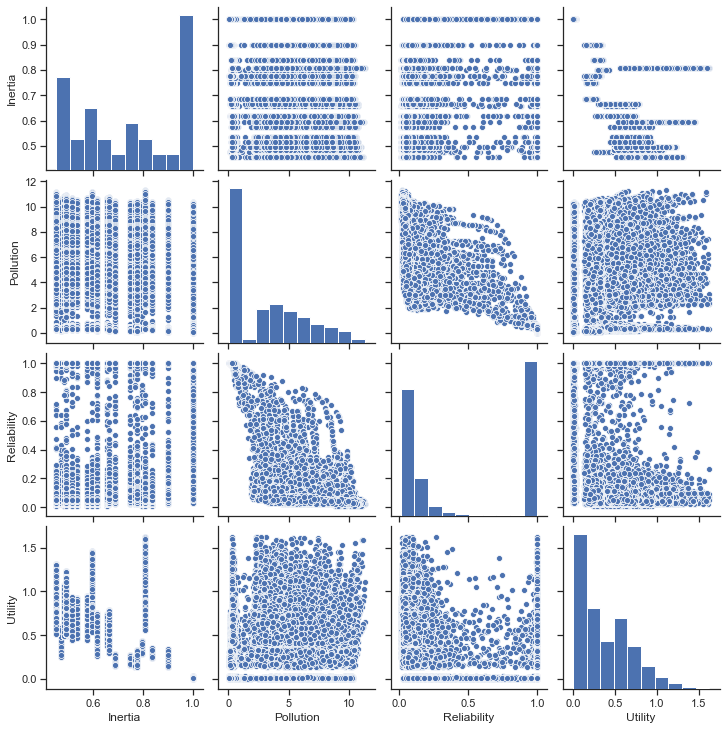

In [40]:
sns.set(style="ticks")
sns.pairplot(df[['Inertia','Pollution', 'Reliability','Utility']]) 

In [49]:
df = Lake45re_data

In [58]:
uutt = np.zeros((1,39))
for j in range(39):
    uutt[0,j] = df.loc[j*1000+4,'Utility']
uutt.max()

1.6614415043409023

In [59]:
ppoo = np.zeros((1,39))
for j in range(39):
    ppoo[0,j] = df.loc[j*1000+4,'Pollution']
ppoo.min()

0.05560194254038854

## Robustness

### A) Robustness comparison 

#### A.1) Mean/standard deviation (signal-to-noise ratio)

  \begin{equation}
             R_{ij} = \{\begin{array}{ll}
             \frac{\mu(f_{ijs}^* + 1}{\sigma(f_{ijs}^* + 1} ; & \text{if } f_i \text{ is to be maximized}; s=1..N \\
             (\mu(f_{ijs}^* + 1) \times (\sigma(f_{ijs}^* + 1) ; & \text{if } f_i \text{ is to be minimized}; s=1..N\\
             \end{array}
          \end{equation}
          where $\mu(f_{ijs}^*$ is the mean over the set of scenarios for outcome indicator $f_i$ in the case of implementing            the candidate solution $j$, and $\sigma$ is the standard deviation.
    
#### A.2) Max regret
The maximum regret of a candidate solution is the maximal difference across the scenarios between this candidate solution's performance and the zero-regret option's performance in each scenario. The following equation shows the formulation of maximum regret for candidate solution $j$ and outcome indicator $i$. In this formulation, $Z_{is}$ is the zero-regret value of outcome indicator $i$ in scenario $s$, which is assumed to be the best value obtained in this scenario with the optimal policy.

  \begin{equation}
         R_{ij} = \max_{s=1..N} \{ |f_{ijs}^* - Z_{is}| \} 
   \end{equation}

   \begin{equation}
         Z_{is} = \{\begin{array}{ll}
          \max_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be maximized} \\
          \min_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be minimized}\\
         \end{array}
  \end{equation}
    



### B) Domain criterion: In how many (percentage of) scenarios (out of 1000 randomly generated) 

#### B.1) Re > 0.95 ? 
#### B.2) Utility > 0.2 ?
#### B.3) Both a and b.

## A) Robustness comparison

In [4]:
nn = int(np.shape(Lake45re_data)[0]/1000) #64 #non-dominated solutions
ss=1000 # scenarios

In [5]:
# Mean/std deviation (signal Noise)
df = Lake45re_data
R_mean_std = [nn * [None] for i in range(4)]
Solution = []

for j in range(nn):
    R_mean_std[0][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Utility']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Utility']).std()+1)
    #(np.array(nUtility[j]).mean()+1)/(np.array(nUtility[j]).std()+1)            # Max
    R_mean_std[1][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).mean()+1)*(np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).std()+1)
    #(np.array(nPollution[j]).mean()+1)*(np.array(nPollution[j]).std()+1)        # Min
    R_mean_std[2][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).std()+1)
    #(np.array(nInertia[j]).mean()+1)/(np.array(nInertia[j]).std()+1)            # Max
    R_mean_std[3][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).std()+1)
    #(np.array(nReliability[j]).mean()+1)/(np.array(nReliability[j]).std()+1)    # Max
    Solution.append(j)

In [6]:
# Trade-offs between Utility and Reliability
# Each line represents one solution
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = R_mean_std[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
               dict(range = [1.25,2.1],
                label = 'Robustness of Inertia(↑)', values = R_mean_std[2]),
          
            dict(range = [20,9],
                label = 'Robustness of Pollution(↑)', values = R_mean_std[1]),
         
            dict(range = [.9,1.45],
                label = 'Robustness of Reliability(↑)', values = R_mean_std[3]),
              dict(range = [1,1.5],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↑)', values = R_mean_std[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [7]:
df = Lake45re_data
nnUtility = np.zeros((nn,ss))
nnPollution = np.zeros((nn,ss))
nnInertia = np.zeros((nn,ss))
nnReliability = np.zeros((nn,ss))

for p in range(ss):
    for i in range(nn):
        nnUtility[i][p] = df.loc[i*1000+p,'Utility']
        nnPollution[i][p] = df.loc[i*1000+p,'Pollution']
        nnInertia[i][p] = df.loc[i*1000+p,'Inertia']
        nnReliability[i][p] = df.loc[i*1000+p,'Reliability']
    

In [8]:
# Max Regret
z = [ss * [None] for i in range(4)]
Regret = [nn * [None] for i in range(4)]

for p in range(ss):
    z[0][p] = np.max(nnUtility, axis=0)[p] #nnUtility[solution(nn)][scenario(ss)]
    z[1][p] = np.min(nnPollution, axis=0)[p]
    z[2][p] = np.max(nnInertia, axis=0)[p]
    z[3][p] = np.max(nnReliability, axis=0)[p]

for j in range(nn):
    Regret[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(z[0]) ) )            # Max
    Regret[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(z[1]) ) )         # Min
    Regret[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(z[2]) ) )           # Max
    Regret[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(z[3]) ) )     # Max
 

In [9]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.75],
                label = 'Robustness of Inertia(↓)', values = Regret[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [13]:
print(min(Regret[2]), ',', max(Regret[2]))

0.0 , 0.6262626262626263


## B) Robustness analysis

In [37]:
# Calculating Pcrit
#b,q, and x
# for each solution in each scenario we may have different Pcrit
Pcrit = np.zeros((nn,ss))
for j in range(nn):
    for  p in range(ss):
        x = ait[j]
        bb = b[p]
        qq = q[p]
        Pcrit[j][p] = brentq(lambda x: x**qq/(1+x**qq) - bb*x, 0.01, 1.5)
        
#Pcrit

In [38]:
# Write objectives

with open('Pcrit(EkerBarth)_64solutions_random_rfps(15.10.2020)s4.csv', 'w', newline='') as f:
    objectives = ['Pcrit'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for p in range(ss):
            thewriter.writerow({'Pcrit' : Pcrit[j][p]
                               })

In [10]:
Pcritical = pd.read_csv('Pcrit(EkerBarth)_64solutions_random_rfps(15.10.2020)s4.csv')
#Pcritical.describe()

Pcriti = np.zeros((nn,ss))
ind = 0
for j in range(nn):
    for p in range(ss):
        Pcriti[j][p] = Pcritical['Pcrit'][ind]
        ind += 1
    
#Pcriti[49][999]

In [11]:
""" 
Robustness analysis --> B
Calculating how many scenarios has 
    B.1) reliability > 0.8 
    B.2) Utility > 0.2/0.1 ?
    B.3) Both a and b.

"""
n_reliabale_scen = np.zeros((nn,))
n_high_eco_scen = np.zeros((nn,))
n_both_scen = np.zeros((nn,))
n_high_inertia_scen = np.zeros((nn,))
n_low_pollution_scen = np.zeros((nn,))
#critical_scen = []


for i in range(nn): 
    nrs = 0
    nhes = 0
    nboth = 0
    nhi = 0
    nlp = 0
    for p in range(ss):
        if nnReliability[i][p]>.8: #A.1
            nrs += 1
        #else:
        #    critical_scen.append(np.array([p+1, b[p], q[p], mean[p], stdev[p], delta[p]]) )  
        if nnUtility[i][p]>0.2: #A.2
            nhes += 1
        if nnReliability[i][p]>0.8 and nnUtility[i][p]>0.2: #A.3
            nboth += 1
        if nnInertia[i][p]>0.99:
            nhi += 1   
        if nnPollution[i][p]<Pcriti[i][p]: #2.54
            nlp += 1
            
    n_reliabale_scen[i] = nrs   
    n_high_eco_scen[i] = nhes
    n_both_scen[i] = nboth
    n_high_inertia_scen[i] = nhi
    n_low_pollution_scen[i] = nlp
    

print('Number of scenarios with reliability of > 0.8 =', n_reliabale_scen)
print('Number of scenarios with utility of > 0.2 =',n_high_eco_scen)
print('Number of scenarios with reliability of > 0.8 and utility > 0.2 =',n_both_scen)
#print('Number of scenarios with inertia of > 0.99 =',n_high_inertia_scen)
print('Number of scenarios with pollution of < Critical point =',n_low_pollution_scen)
#print(critical_scen)

Number of scenarios with reliability of > 0.8 = [130. 758. 438. 153. 179. 226. 170. 155. 356. 364. 449. 400. 587. 619.
 587. 599. 772. 772. 770. 767. 762. 764. 775. 762. 763. 118. 202. 136.
 139. 213. 575. 217.]
Number of scenarios with utility of > 0.2 = [1000.    0. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000.
  462.  299.  432.  482.    0.    0.    0.    0.    0.    0.    0.    0.
    0. 1000. 1000. 1000. 1000. 1000.  485. 1000.]
Number of scenarios with reliability of > 0.8 and utility > 0.2 = [130.   0. 438. 153. 179. 226. 170. 155. 356. 364. 449. 400. 278. 188.
 258. 295.   0.   0.   0.   0.   0.   0.   0.   0.   0. 118. 202. 136.
 139. 213. 289. 217.]
Number of scenarios with pollution of < Critical point = [130. 745. 436. 152. 179. 225. 168. 153. 354. 359. 447. 396. 583. 613.
 584. 596. 761. 762. 759. 756. 754. 756. 763. 747. 754. 117. 201. 136.
 139. 212. 573. 215.]


In [39]:
rdc_reliability = np.sort(n_reliabale_scen)[::-1]/1000
rdc_reliability

array([0.777, 0.777, 0.776, 0.617, 0.547, 0.402, 0.29 , 0.285, 0.277,
       0.257, 0.248, 0.231, 0.223, 0.219, 0.21 , 0.207, 0.205, 0.205,
       0.201, 0.201, 0.192, 0.175, 0.175, 0.171, 0.17 , 0.169, 0.163,
       0.157, 0.156, 0.154, 0.148, 0.142, 0.135, 0.127, 0.126, 0.113,
       0.111, 0.111, 0.109, 0.106, 0.104])

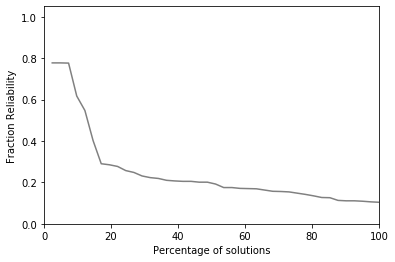

In [40]:
#Reliability robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_reliability, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Reliability") 
plt.show()

In [41]:
rdc_utility = np.sort(n_high_eco_scen)[::-1]/1000
rdc_utility

array([1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   , 1.   ,
       0.613, 0.374, 0.   , 0.   , 0.   ])

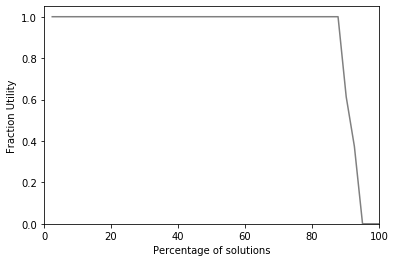

In [42]:
#Utility robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_utility, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Utility") 
plt.show()

In [43]:
rdc_both = np.sort(n_both_scen)[::-1]/1000
rdc_both

array([0.402, 0.346, 0.29 , 0.285, 0.277, 0.257, 0.248, 0.232, 0.231,
       0.223, 0.219, 0.21 , 0.207, 0.205, 0.205, 0.201, 0.201, 0.192,
       0.175, 0.175, 0.171, 0.17 , 0.169, 0.163, 0.157, 0.156, 0.154,
       0.148, 0.142, 0.135, 0.127, 0.126, 0.113, 0.111, 0.111, 0.109,
       0.106, 0.104, 0.   , 0.   , 0.   ])

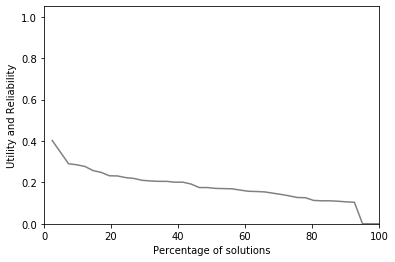

In [44]:
#Both
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_both, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Utility and Reliability") 
plt.show()

In [45]:
rdc_pollution = np.sort(n_low_pollution_scen)[::-1]/1000
rdc_pollution

array([0.766, 0.766, 0.766, 0.611, 0.539, 0.401, 0.29 , 0.283, 0.276,
       0.257, 0.248, 0.227, 0.219, 0.217, 0.21 , 0.204, 0.204, 0.203,
       0.199, 0.199, 0.19 , 0.173, 0.17 , 0.169, 0.169, 0.169, 0.163,
       0.157, 0.155, 0.153, 0.146, 0.142, 0.131, 0.127, 0.124, 0.112,
       0.111, 0.111, 0.108, 0.106, 0.1  ])

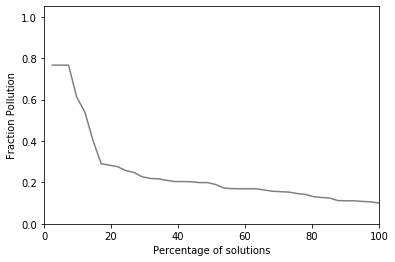

In [46]:
#Pollution
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_pollution, color = "gray")
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Pollution") 
plt.show()

In [47]:
rdc_inertia = np.sort(n_high_inertia_scen)[::-1]/1000
rdc_inertia

array([1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0.])

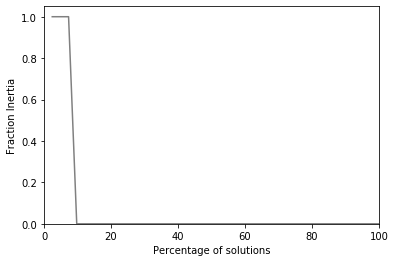

In [48]:
#Inertia
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_inertia, color = "gray") #greenyellow
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Inertia") 
plt.show()

In [12]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = n_high_eco_scen,
                   colorscale = [[0.1,'black'],[0.35,'purple'],[0.7,'red'],[.9,'gold']]),
        dimensions = list([
                    
            dict(range = [0,1],
                label = 'Fraction Pollution', values = n_low_pollution_scen/1000),
          
            dict(range = [0,1],
                label = 'Fraction Reliability', values = n_reliabale_scen/1000),
            
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Fraction Utility', values = n_high_eco_scen/1000),
            dict(range = [0,1],
                label = 'Fraction Inertia', values = n_high_inertia_scen/1000),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [40]:
# Write objectives

with open('Domain_64solutions_(28.10.2020)s4.csv', 'w', newline='') as f:
    objectives = ['rdc_u', 'rdc_rel', 'rdc_pol', 'rdc_in'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(64):
        thewriter.writerow({'rdc_u' : rdc_utility[j], 'rdc_rel' : rdc_reliability[j], 'rdc_pol' : rdc_pollution[j], 'rdc_in' : rdc_inertia[j]   
                               })

## Select solutions which are more robust (e.g. n_both_scen > 103)

In [54]:
# Choose the solutions which has the reliability of > 0.8 and utility > 0.2
n_both_scen

array([296.,   0., 163., 429., 111., 252.,   0., 100., 170., 300., 371.,
       111., 295., 107., 347., 375., 325., 160., 418., 141., 394., 155.,
       143., 192., 354., 193., 100., 125., 127., 281., 112.,  75., 195.,
       153., 248., 176., 334., 100., 141., 246., 203., 123., 179., 211.,
       123., 108., 171., 154., 377., 330., 270., 203., 185., 354., 151.,
       331., 134.,   0., 171., 176., 153.,   0., 142., 214.])

In [56]:
selected_ait = []
selected_U = []
selected_P = [] 
selected_I = []
selected_R = []

for i in range(nn):
    if n_both_scen[i] > 350:
        selected_ait.append(ait[i])
        selected_U.append(nnUtility[i])
        selected_P.append(nnPollution[i])
        selected_I.append(nnInertia[i])
        selected_R.append(nnReliability[i])
        #print(i, n_both_scen[i])
        

In [57]:
# The number of selected solutions
print('The number of selected solutions =', np.shape(selected_U)[0])

The number of selected solutions = 8


In [58]:
# Write objectives

with open('obective_values_4obj_s4(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(np.shape(selected_ait)[0]):
        for i in range(ss):
            thewriter.writerow({'Utility' : selected_U[j][i], 'Pollution' : selected_P[j][i], 'Inertia' : selected_I[j][i], 'Reliability' : selected_R[j][i], 'group' : j
                               })

In [59]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

Lake4550selected_data = pd.read_csv('obective_values_4obj_s4(EkerBart)_selected_solutions(15.10.2020)SLSQP.csv')
Lake4550selected_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000
mean,0.292777,2.977127,0.741162,0.552782,3.500000
std,0.104107,3.124842,0.102388,0.452764,2.291431
min,0.159123,0.113061,0.545455,0.010000,0.000000
25%,0.207799,0.244904,0.684343,0.080000,1.750000
50%,0.274065,0.880551,0.757576,0.889100,3.500000
75%,0.344478,5.432825,0.790404,1.000000,5.250000
max,0.705441,10.664339,0.919192,1.000000,7.000000


In [61]:
# The performances of the 6 selected solutions in all 1000 scenarios
df = Lake4550selected_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,11],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),
            dict(range = [0,7],
                label = 'Solution', values = df['group']),
            
        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

## Calculating the ideal points for all 1000 generated scenarios 

In [63]:
Lake45_1000ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_5scen(EkerBart)_1000_ideal_points(12.10.2020).csv')
Lake45_1000ideals.describe()

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
count,1000.000000,1000.000000,1000.0,1000.000000,1000.000000
mean,0.964190,1.602561,1.0,0.827922,499.500000
std,0.318529,2.899479,0.0,0.326612,288.819436
min,0.571224,0.016309,1.0,0.030000,0.000000
25%,0.693488,0.076118,1.0,1.000000,249.750000
50%,0.879524,0.123542,1.0,1.000000,499.500000
75%,1.183153,0.250321,1.0,1.000000,749.250000
max,1.734761,10.321020,1.0,1.000000,999.000000


In [64]:
dfi = Lake45_1000ideals

## As seen above, the ideal points for reliability in some scenarios are very close to 0 (min = 0.04).
## It means that, in those scenarios, there is no feasible solution with the reliability of higher than 0.8. 

# Scenario Analysis

## Therefore, we can remove these scenarios and solve a model with all 4 objective functions in the remaining 802 scenarios. The solutions for that model would have less conservatism (similar reliability values but with equal or better performances in other objectives).

In [228]:
# Removing unreliable scenarios
temp_reliable_scenarios = gen_scenarios
for scen in unreliable_scen:
    temp_reliable_scenarios = temp_reliable_scenarios.drop([scen], axis=0)
    
reliable_scenarios = temp_reliable_scenarios
#for i in reliable_scenarios.Scenario_num:
#    print(reliable_scenarios.Scenario_num[i-1])
reliable_scenarios

,Scenario_num,b,q,mean,std,delta
0,1,0.276000,3.049000,0.003900,0.003900,0.931000
1,2,0.135000,2.025500,0.003000,0.002430,0.961300
2,3,0.270400,2.478300,0.003900,0.003692,0.963100
3,4,0.100900,3.678900,0.003700,0.004599,0.931700
4,5,0.420000,2.000000,0.020000,0.001700,0.980000
...,...,...,...,...,...,...
995,996,0.416759,3.003769,0.021276,0.000890,0.969724
996,997,0.283442,3.440955,0.042422,0.002829,0.969020
997,998,0.231030,4.332915,0.040131,0.000754,0.963342
998,999,0.403392,2.785176,0.017296,0.002091,0.958116


In [229]:
new_b = reliable_scenarios.b
new_q = reliable_scenarios.q
new_mean = reliable_scenarios['mean'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
new_stdev = reliable_scenarios['std'] # The same reason as above
new_delta = reliable_scenarios.delta

In [230]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
rs = 792
#Number of objectives 
k = 4
# Number of meta-criteria
new_mc = rs*k

In [231]:
# Number of solution to be generate = n
nnn = 10

"""
  Setting the goals/ reference points
"""
ig =[[None]*nnn] 

ig[0][0] = np.array([-0.57, 0, -1, -1]) # Max reliability
ig[0][1] = np.array([-0.57, 10, -1, -0.04]) # Max Utility
#ig[0][2] = np.array([random.randint(-100,0)*.2, random.randint(0,80)*.2, random.randint(-10,0)*.2, random.randint(-100,-4)*.2])#np.array([-0.5, 0, -1, -1]) # Max Inercia
#ig[0][3] = np.array([random.randint(-100,0)*.2, random.randint(0,80)*.2, random.randint(-10,0)*.2, random.randint(-100,-4)*.2])#np.array([-100, 0, -0.5, -100]) # Min Pollution
ig[0][2] = np.array([-0.75, 5, -0.6, -0.8]) # Balance
ig[0][3] = np.array([-1.75, 11, -1, -0.04]) # Max Utility
ig[0][4] = np.array([-1.75, 1, -0.6, -0.8]) # Max Utility
ig[0][5] = np.array([-0.2, 0, -0.8, -1]) # Max reliability
ig[0][6] = np.array([-0.1, 0, -1, -1]) # Max reliability

# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS
                     
xlimits = np.array([[-2,0], # Utility 
                    [0,10], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1, -0.04]  # Reliability 
                   ]) 

sampling = LHS(xlimits=xlimits)
num = nnn-7
x00 = sampling(num)
                     
for i in range(num):
    ig[0][i+7] = x00[i]

def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n-1][i] 
    return g

In [232]:
"""
Solving the problem
As ASF only produce one Pareto optimal solution at a time
We need to solve the problem via different goals or weights (to generate more Pareto optimal solution via ASF) 
""" 
import time
start_time = time.time()

new_ait = [[None] for i in range (nnn) ] 
new_goals = [[None] for i in range(nnn) ] 

new_Utility = [[None] for i in range (nnn)] 
new_Pollution = [[None] for i in range (nnn)] 
new_Inertia = [[None] for i in range (nnn)] 
new_Reliability = [[None] for i in range (nnn)] 

for j in range(nnn):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    """
    print('n=',j+1)
    
    g = selected_goals(ig, j, rs, k)
    
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
               )

    # Decision variables (solutions)
    new_ait[j] = sol.x
    new_goals[j] = g
    
    # Scenarios
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in reliable_scenarios.Scenario_num:
        F = lake_problem(sol.x, b = new_b[p-1], q = new_q[p-1], mean = new_mean[p-1], stdev = new_stdev[p-1], delta = new_delta[p-1], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p,': b = ', new_b[p-1], ', q = ', new_q[p-1], ', mean = ', new_mean[p-1], ', stdev = ', new_stdev[p-1], ',delta = ', new_delta[p-1])
        print('f_1',p,' (Utility) =', -F[0])
        print('f_2',p,' (max_P) =', F[1])
        print('f_3',p,' (inertia) =', -F[2])
        print('f_4',p,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    new_Utility[j] = temp_Utility
    new_Pollution[j] = temp_Pollution
    new_Inertia[j] = temp_Inertia
    new_Reliability[j] = temp_Reliability
    
print("--- %s seconds ---" % (time.time() - start_time)) 

n= 1


IndexError: list index out of range

In [ ]:
# Write objectives
import csv

with open('obective_values_4obj_802scen(Barth)_50sol.csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nnn):
        for i in range(rs):
            thewriter.writerow({'Utility' : new_Utility[j][i], 'Pollution' : new_Pollution[j][i], 'Inertia' : new_Inertia[j][i], 'Reliability' : new_Reliability[j][i], 'group' : j
                               })

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

Lake480250_data = pd.read_csv('obective_values_4obj_802scen(Barth)_50sol.csv')
Lake480250_data.describe()

In [ ]:
import plotly.graph_objects as go


#df = Lake48025_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold'],]),
        dimensions = list([
            dict(range = [0,1],
                label = 'Inertia(↑)', values = df['Inertia']),
            dict(range = [0,11],
                label = 'Pollution(↓)', values = df['Pollution']),
            
            dict(range = [0,1],
                label = 'Reliability(↑)', values = df['Reliability']),
            dict(range = [0,.4],
                #constraintrange = [4,8],
                label = 'Utility(↑)', values = df['Utility']),
            dict(range = [0,4],
                label = 'Solution', values = df['group']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()